In [1]:
import numpy as np
import matplotlib.pyplot as plt
import csv

Loading and Exploring the Dataset

In [2]:
def load_dataset(file_path):
    
    """
    Load Dataset 1 from a CSV file.
    Assumes that the first column is the input feature and the last column is the target variable.

    Parameters:
    - file_path: Path to the CSV file

    returns:
    - X: Feature vector (n_samples, 1).
    - y: Target vector (n_samples, ).
    
    """

    data = []
    with open(file_path, 'r') as csvfile:
        reader = csv.reader(csvfile)
        for row in reader:
            data.append([float(item) for item in row])
        
    data = np.array(data)
    X = data[:, 0].reshape(-1, 1)   # First column as feature
    y = data[:, -1]                 # Last column as target
    return X, y

dataset1_path = './UnivariateData/6.csv'

X, y = load_dataset(dataset1_path)

# Display first few samples
print("First 5 samples of Dataset 1:")
for i in range(5):
    print(f"X: {X[i][0]}, y: {y[i]}")

First 5 samples of Dataset 1:
X: 0.987, y: 6.8979
X: 0.925, y: 5.9258
X: 0.511, y: 1.8809
X: 0.238, y: 0.55075
X: 0.59, y: 2.4825


Train-Test Split (Sequential)

In [3]:
def train_test_split(X, y, test_size=0.3):

    n_samples = X.shape[0]
    split_idx = int(n_samples * (1 - test_size))
    X_train = X[:split_idx]
    y_train = y[:split_idx]
    X_test = X[split_idx:]
    y_test = y[split_idx:]
    return X_train, X_test, y_train, y_test

# Perform the split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

Polynomial Feature Expansion

In [4]:
def polynomial_features(X, degree):
    
    """
    Generate polynomial features up to a specified degree.

    Parameters:
    - X: Original feature matrix (n_samples, 1).
    - degree: Degree of the polynomials.

    returns:
    - X_poly: Polynomial feature matrix (n_samples, degree + 1).

    """

    X_poly = np.ones((X.shape[0], degree + 1))      # Initialize with ones for the bias term
    for d in range(1, degree+1):
        X_poly[:, d] = X[:, 0] ** d
    
    return X_poly

Ridge Regression Implementation

In [5]:
def ridge_regression(X, y, lambda_reg):
    
    """
    Perform Ridge (L2) regularized linear regression.

    Parameters:
    - X: Design matrix (n_samples, n_features)
    - y: Target vector (n_samples, ).
    - lambda_reg: Regularization parameter.

    returns:
    - weights: Weight vector (n_features, ).
    """

    n_features = X.shape[1]
    I = np.identity(n_features)
    A = X.T @ X + lambda_reg * I
    b = X.T @ y
    weights = np.linalg.solve(A, b)
    return weights

Cross-Validation for Hyperparameter Selection (Sequential Folds)

In [6]:
def mean_squared_error(y_true, y_pred):
    """
    Compute Mean Squared Error between true and predicted values.
    
    Parameters:
    - y_true: True target values.
    - y_pred: Predicted target values.
    
    Returns:
    - mse: Mean Squared Error.
    """
    return np.mean((y_true - y_pred) ** 2)

def single_split_validation(X_train, y_train, X_test, y_test, degrees, lambda_regs):
    """
    Evaluate different polynomial degrees and lambda values using the test set as the validation set.
    
    Parameters:
    - X_train: Training feature matrix.
    - y_train: Training target vector.
    - X_test: Test feature matrix (used as the validation set).
    - y_test: Test target vector.
    - degrees: List of polynomial degrees to evaluate.
    - lambda_regs: List of lambda values to evaluate.
    
    Returns:
    - best_degree: Degree with the lowest MSE on the test set.
    - best_lambda: Lambda with the lowest MSE on the test set.
    - results: Dictionary with MSE for each degree-lambda combination.
    """
    results = {}
    best_mse = float('inf')
    best_degree = None
    best_lambda = None

    for degree in degrees:
        for lambda_reg in lambda_regs:
            # Expand features for polynomial degree
            X_train_poly = polynomial_features(X_train, degree)
            X_test_poly = polynomial_features(X_test, degree)
            
            # Train Ridge Regression on the full training set
            weights = ridge_regression(X_train_poly, y_train, lambda_reg)
            
            # Predict on training and test sets
            y_pred_train = X_train_poly @ weights
            y_pred_test = X_test_poly @ weights
            
            # Compute MSE on training and test sets
            mse_train = mean_squared_error(y_train, y_pred_train)
            mse_test = mean_squared_error(y_test, y_pred_test)
            
            results[(degree, lambda_reg)] = {'train_mse': mse_train, 'test_mse': mse_test}
            print(f"Degree: {degree}, Lambda: {lambda_reg}, Train MSE: {mse_train:.4f}, Test MSE: {mse_test:.4f}")

            # Track the best parameters based on test MSE
            if mse_test < best_mse:
                best_mse = mse_test
                best_degree = degree
                best_lambda = lambda_reg

    print(f"\nBest Hyperparameters -> Degree: {best_degree}, Lambda: {best_lambda}, Test MSE: {best_mse:.4f}")
    return best_degree, best_lambda, results

# Example usage
# Assuming you have defined polynomial_features and ridge_regression functions
# and you have split your data into X_train, y_train, X_test, y_test.

# Define hyperparameter grids
degrees = list(range(2, 10))        # Degree 2 to 9
lambda_regs = [0.0, 0.01, 0.1, 0.5, 1.0]   # Regularization parameters

# Perform single split validation
best_degree, best_lambda, results = single_split_validation(X_train, y_train, X_test, y_test, degrees, lambda_regs)

Degree: 2, Lambda: 0.0, Train MSE: 0.0114, Test MSE: 0.0122
Degree: 2, Lambda: 0.01, Train MSE: 0.0114, Test MSE: 0.0122
Degree: 2, Lambda: 0.1, Train MSE: 0.0116, Test MSE: 0.0125
Degree: 2, Lambda: 0.5, Train MSE: 0.0142, Test MSE: 0.0155
Degree: 2, Lambda: 1.0, Train MSE: 0.0191, Test MSE: 0.0208
Degree: 3, Lambda: 0.0, Train MSE: 0.0033, Test MSE: 0.0032
Degree: 3, Lambda: 0.01, Train MSE: 0.0033, Test MSE: 0.0032
Degree: 3, Lambda: 0.1, Train MSE: 0.0038, Test MSE: 0.0037
Degree: 3, Lambda: 0.5, Train MSE: 0.0044, Test MSE: 0.0045
Degree: 3, Lambda: 1.0, Train MSE: 0.0048, Test MSE: 0.0049
Degree: 4, Lambda: 0.0, Train MSE: 0.0032, Test MSE: 0.0031
Degree: 4, Lambda: 0.01, Train MSE: 0.0032, Test MSE: 0.0031
Degree: 4, Lambda: 0.1, Train MSE: 0.0032, Test MSE: 0.0031
Degree: 4, Lambda: 0.5, Train MSE: 0.0033, Test MSE: 0.0031
Degree: 4, Lambda: 1.0, Train MSE: 0.0033, Test MSE: 0.0032
Degree: 5, Lambda: 0.0, Train MSE: 0.0032, Test MSE: 0.0030
Degree: 5, Lambda: 0.01, Train MSE: 0

In [7]:
def plot_approximated_function_train_test(X_train, y_train, X_test, y_test, subset_size, degree, lambda_reg):
    """
    Plot the approximated polynomial regression function separately for training and test data.
    
    Parameters:
    - X_train: Full training feature matrix
    - y_train: Full training target values
    - X_test: Full test feature matrix (unchanged)
    - y_test: Full test target values (unchanged)
    - subset_size: Size of the training subset to be used
    - degree: Degree of the polynomial to fit
    - lambda_reg: Regularization parameter (lambda value)
    """
    # Use the specified subset of the training data
    X_train_subset = X_train[:subset_size]
    y_train_subset = y_train[:subset_size]
    
    # Generate polynomial features for the training subset
    X_poly_train = polynomial_features(X_train_subset, degree)
    
    # Train the model with ridge regression
    weights = ridge_regression(X_poly_train, y_train_subset, lambda_reg)
    
    # Adjust X_plot range to match data points
    X_min, X_max = min(X_train.min(), X_test.min()), max(X_train.max(), X_test.max())

    # Generate polynomial features for a smooth curve across the range of X values
    # X_plot = np.linspace(min(X_train.min(), X_test.min()) - 1, max(X_train.max(), X_test.max()) + 1, 500).reshape(-1, 1)

    X_plot = np.linspace(X_min, X_max, 500).reshape(-1, 1)
    X_poly_plot = polynomial_features(X_plot, degree)
    y_plot = X_poly_plot @ weights
    
    # Plot for Training Data (using subset)
    plt.figure(figsize=(10, 6))
    plt.scatter(X_train_subset, y_train_subset, color='blue', label='Training Data (Subset)')
    plt.plot(X_plot, y_plot, color='red', label=f'Polynomial Degree {degree}, Lambda={lambda_reg}')
    plt.title(f'Approximated Function on Training Data (Subset Size: {subset_size}, Degree: {degree}, Lambda: {lambda_reg})')
    plt.xlabel('Feature X')
    plt.ylabel('Target y')
    plt.legend()
    plt.grid(True)
    plt.show()
    
    # Plot for Test Data (full set)
    plt.figure(figsize=(10, 6))
    plt.scatter(X_test, y_test, color='green', label='Test Data')
    plt.plot(X_plot, y_plot, color='red', label=f'Polynomial Degree {degree}, Lambda={lambda_reg}')
    plt.title(f'Approximated Function on Test Data (Degree: {degree}, Lambda: {lambda_reg})')
    plt.xlabel('Feature X')
    plt.ylabel('Target y')
    plt.legend()
    plt.grid(True)
    plt.show()


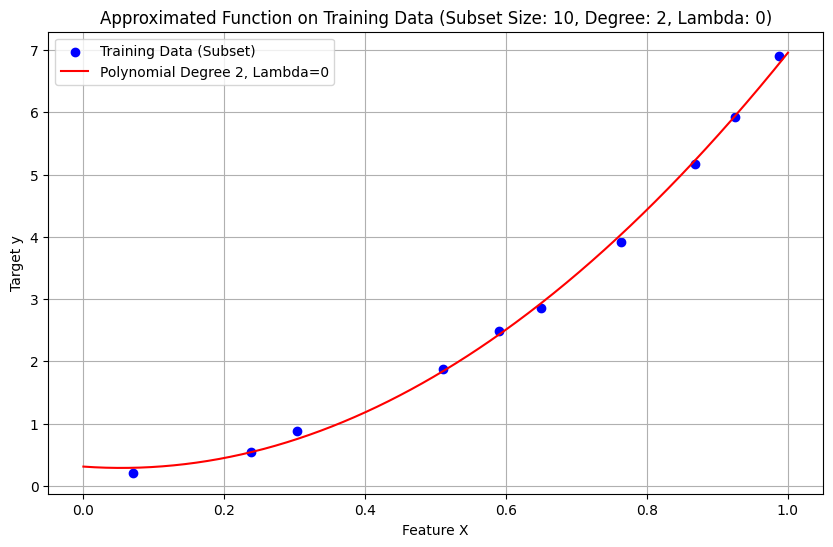

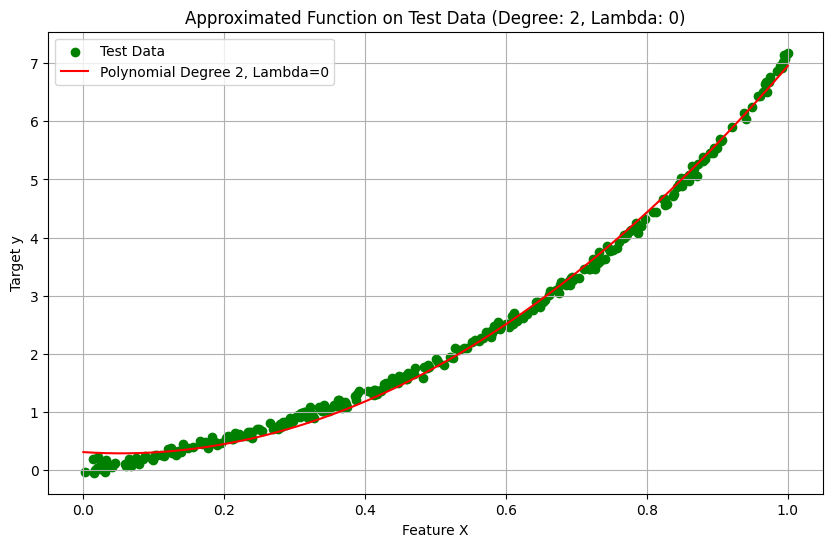

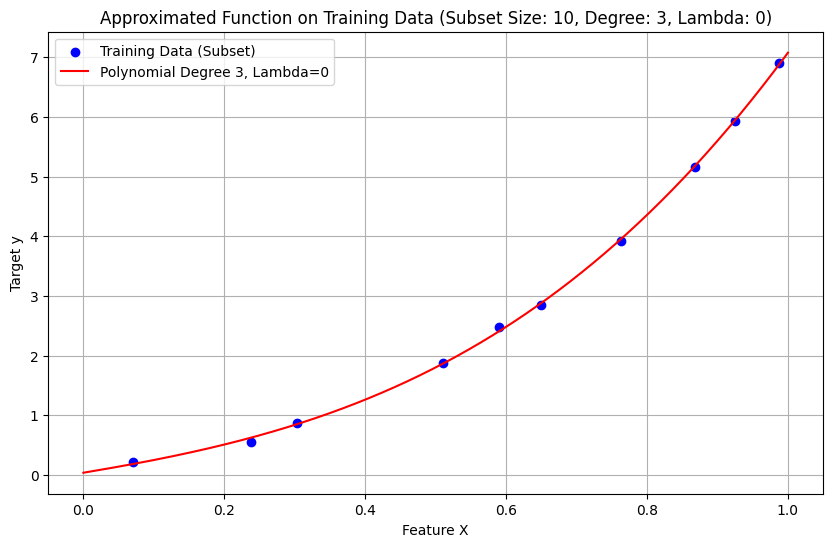

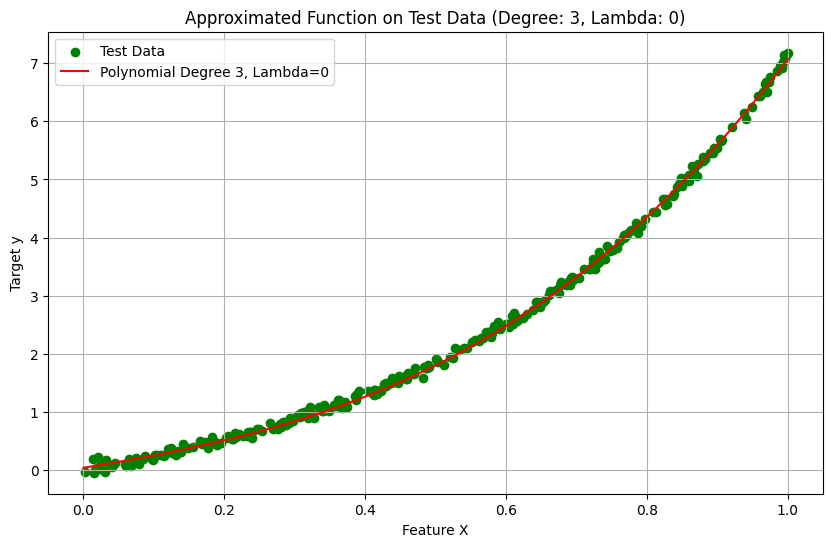

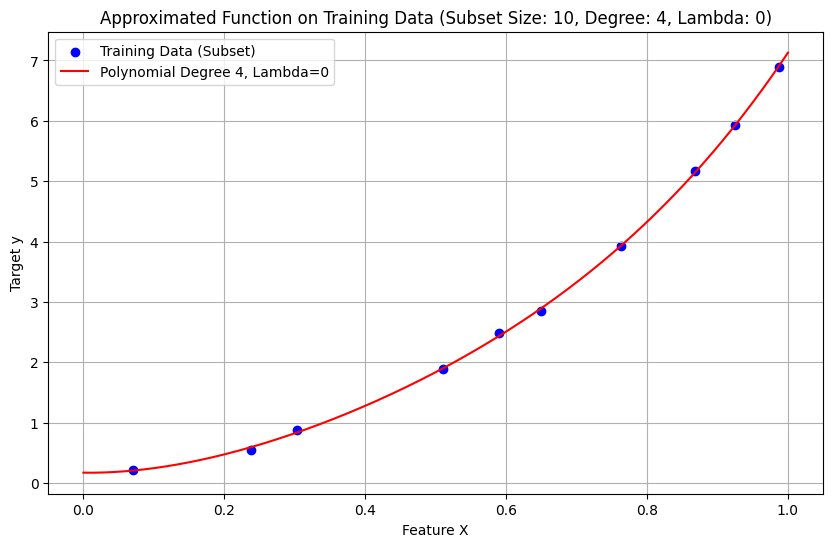

...

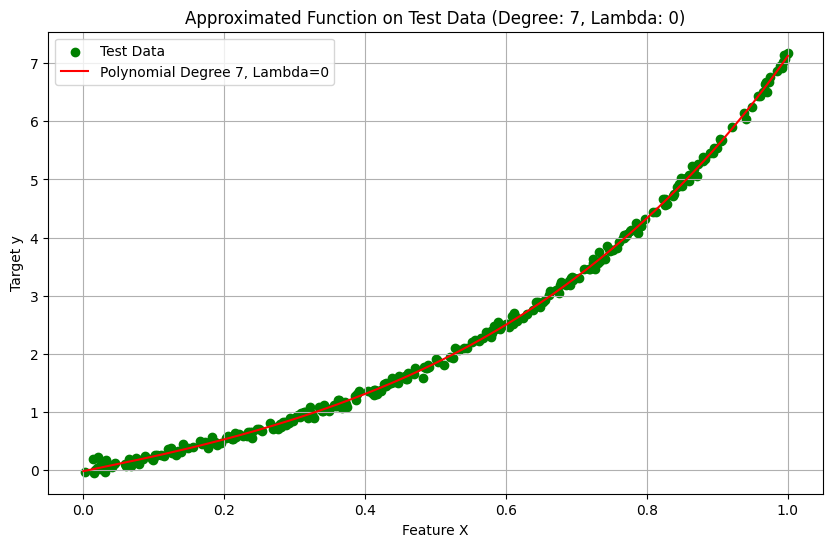

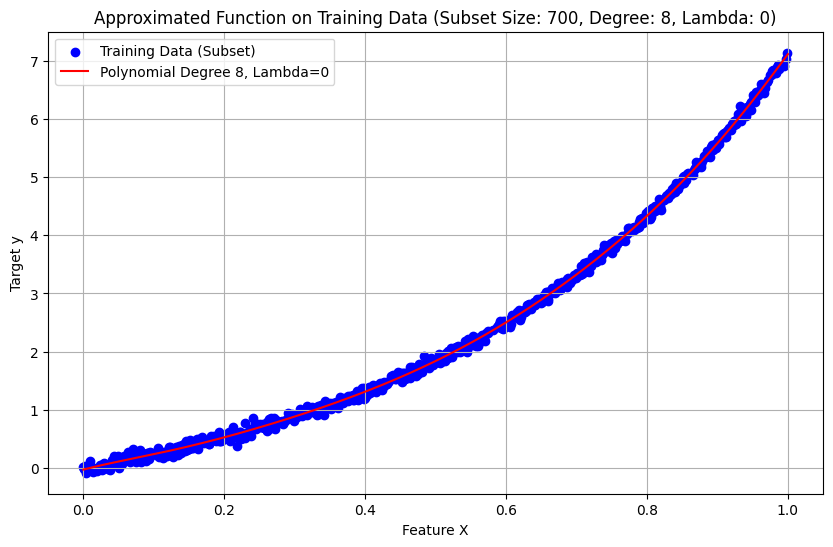

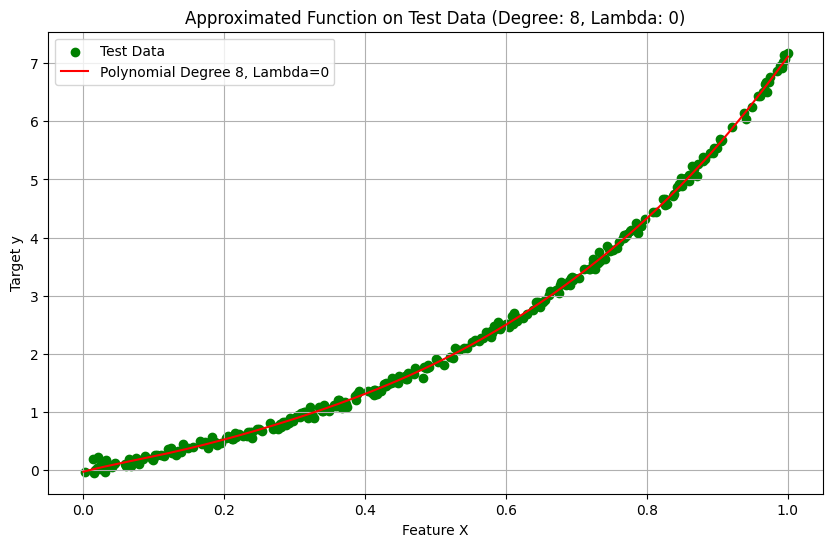

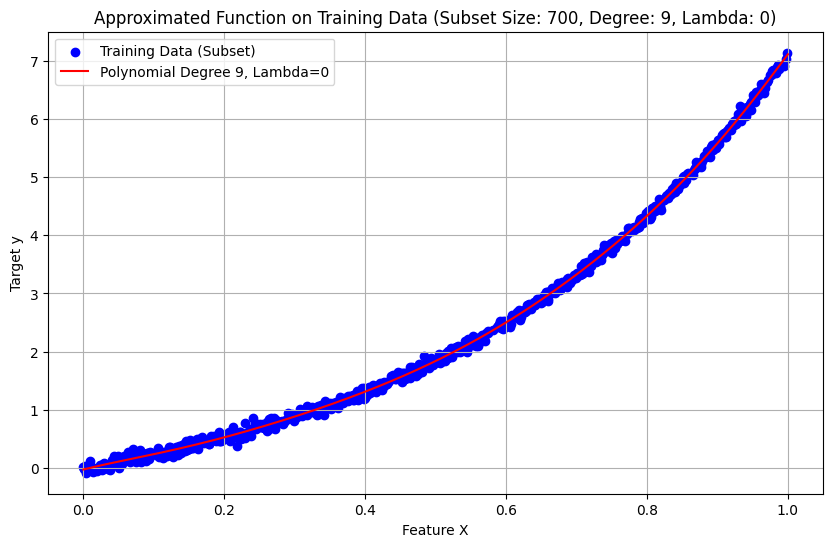

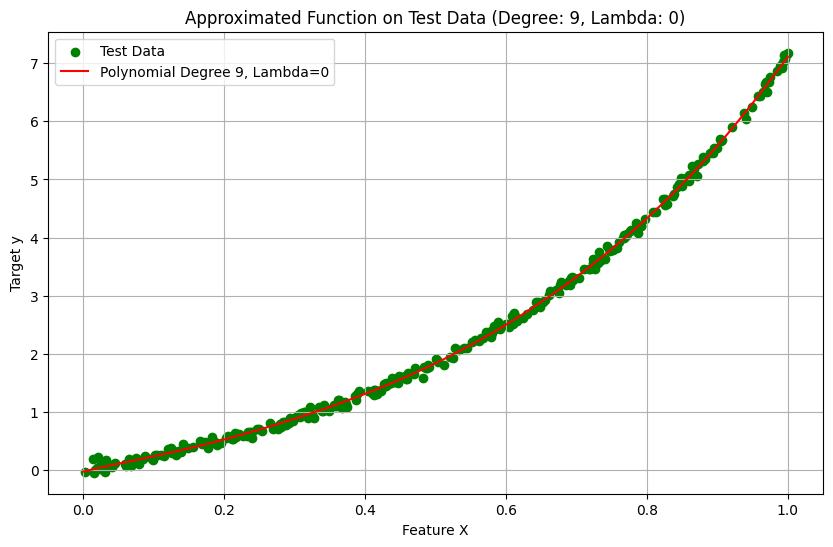

Overfitting detected: Subset Size=10, Degree=8, Training MSE=0.0003, Test MSE=0.7311
Overfitting detected: Subset Size=10, Degree=9, Training MSE=0.0000, Test MSE=41.4848


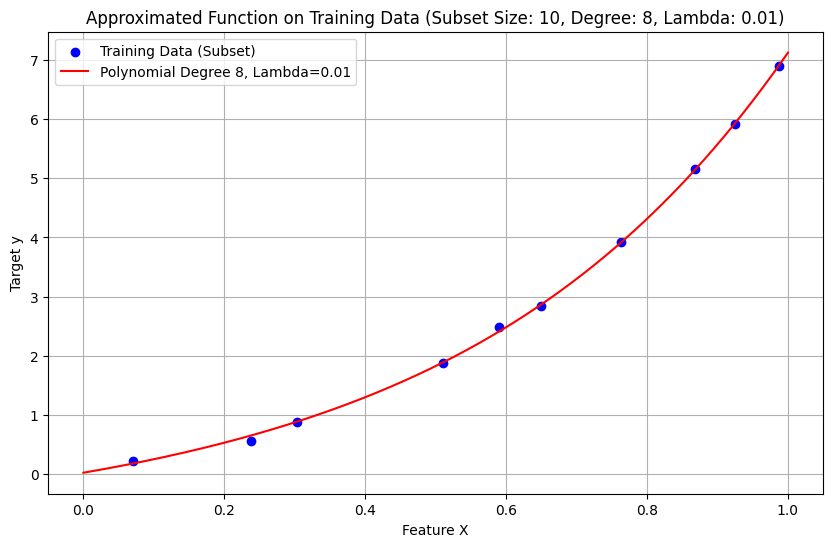

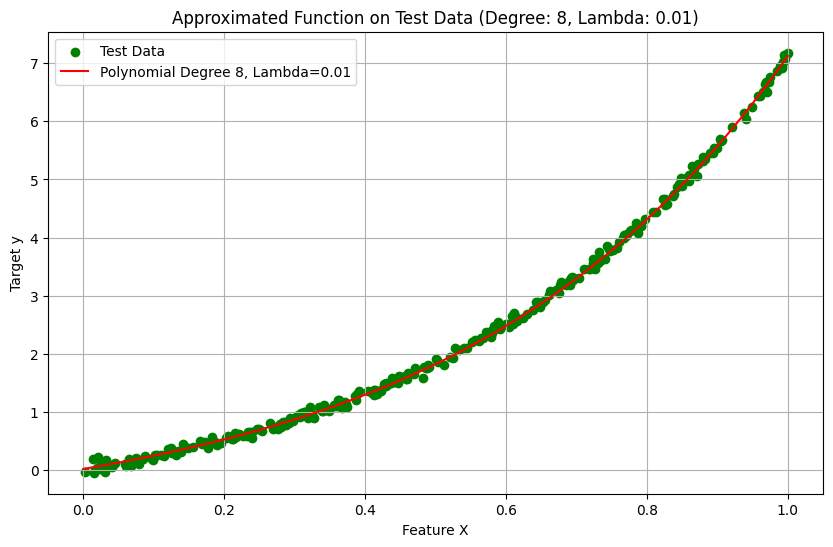

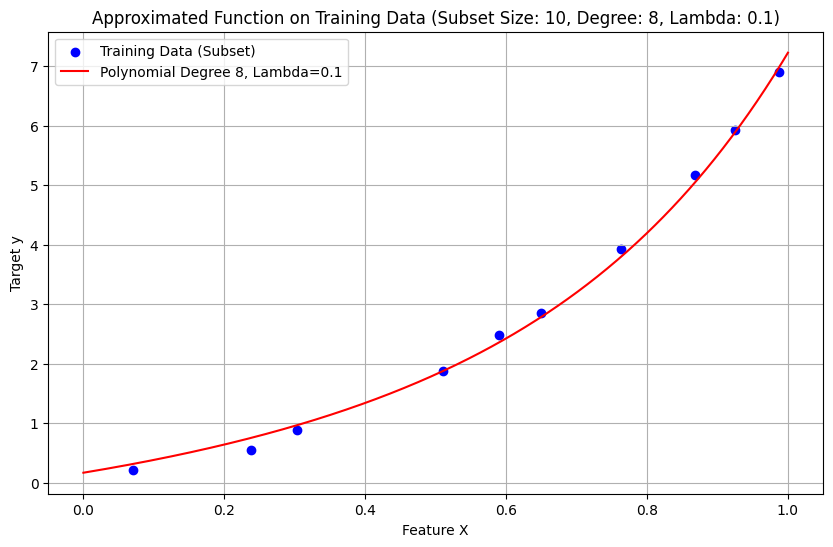

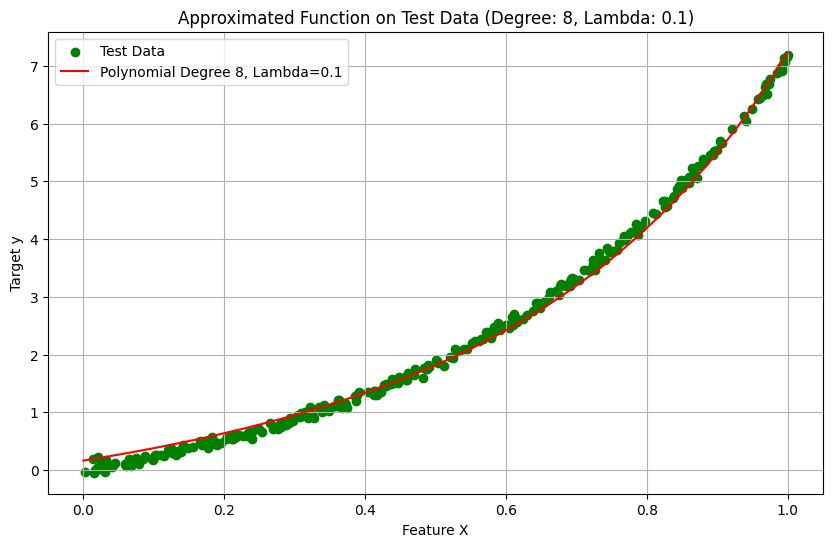

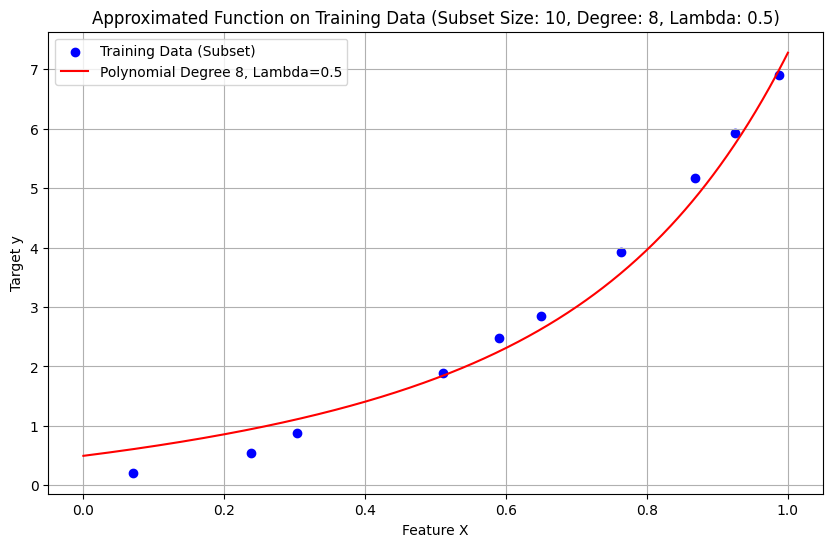

...

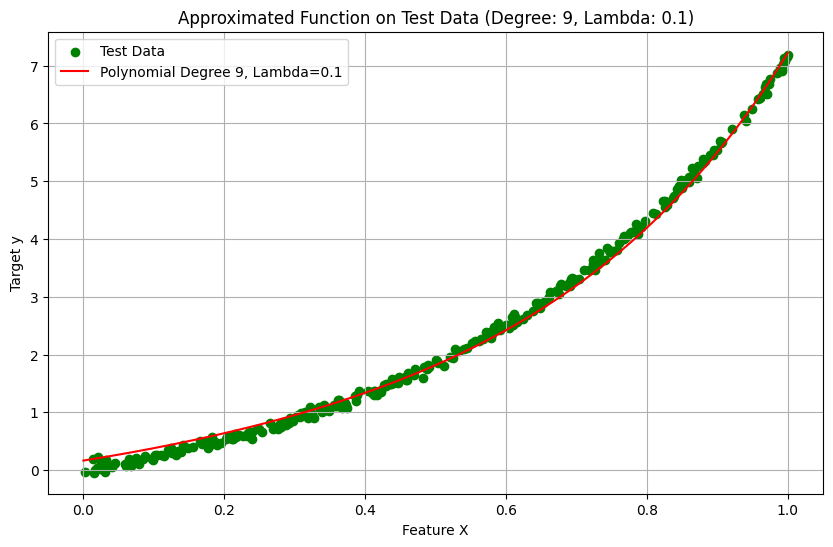

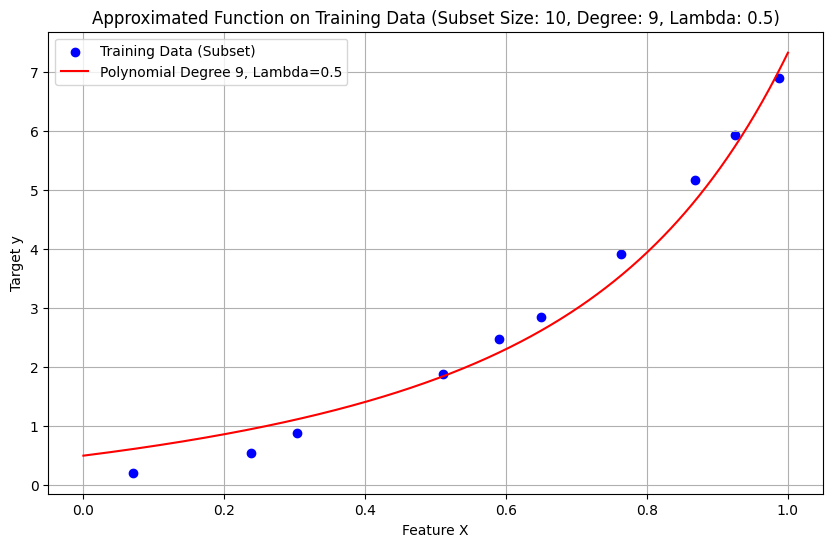

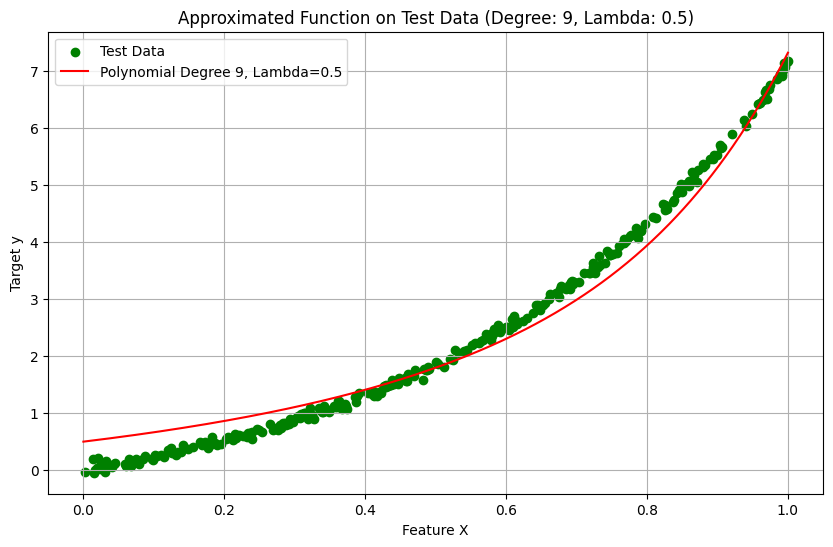

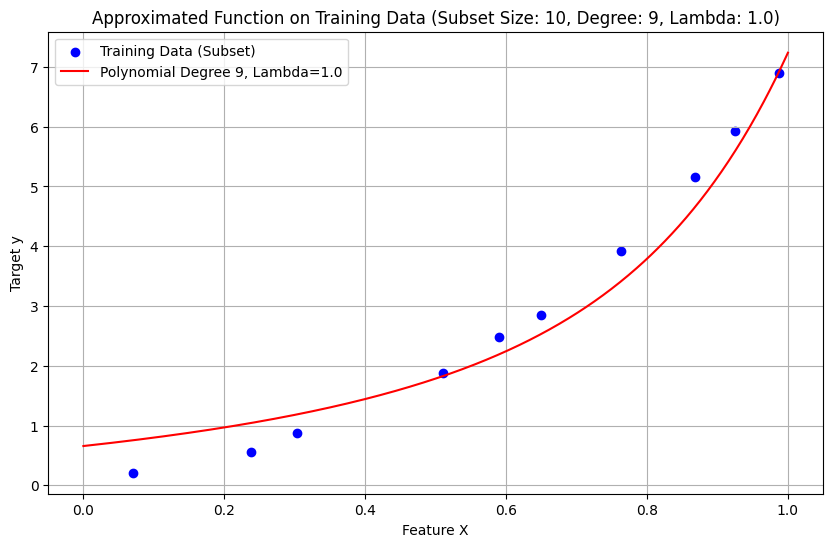

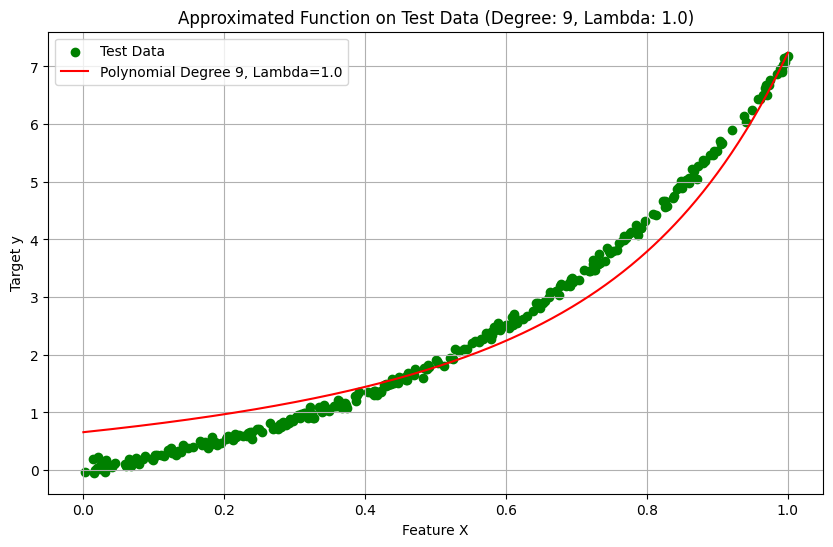

In [8]:
def identify_overfitting_degrees(X_train, y_train, X_test, y_test, subset_size, degrees, threshold=0.1):
    """
    Identify polynomial degrees that show overfitting by comparing training and test MSE.

    Parameters:
    - X_train, y_train: Training data (subset).
    - X_test, y_test: Full test data.
    - subset_size: Size of the training subset to use.
    - degrees: List of polynomial degrees to evaluate.
    - threshold: MSE gap threshold to determine overfitting.

    Returns:
    - overfitting_degrees: List of degrees where overfitting is detected.
    """
    overfitting_degrees = []
    X_train_subset = X_train[:subset_size]
    y_train_subset = y_train[:subset_size]

    for degree in degrees:
        # Generate polynomial features for the current degree
        X_poly_train = polynomial_features(X_train_subset, degree)
        X_poly_test = polynomial_features(X_test, degree)
        
        # Train the non-regularized model (lambda = 0)
        weights = ridge_regression(X_poly_train, y_train_subset, 0)
        
        # Predict and calculate MSE for training and test sets
        y_train_pred = X_poly_train @ weights
        y_test_pred = X_poly_test @ weights
        mse_train = mean_squared_error(y_train_subset, y_train_pred)
        mse_test = mean_squared_error(y_test, y_test_pred)
        
        # Check if there is a significant MSE gap (overfitting)
        if mse_test - mse_train > threshold:
            overfitting_degrees.append(degree)
            print(f"Overfitting detected: Subset Size={subset_size}, Degree={degree}, Training MSE={mse_train:.4f}, Test MSE={mse_test:.4f}")
    
    return overfitting_degrees

# Example usage to identify overfitting degrees for each subset size
subset_sizes = [10, 50, 100, 700]
degrees = range(2, 10)
overfitting_degrees_by_subset = {}


for subset_size in subset_sizes:
    for degree in degrees:
        # Plot the training curve without regularization (lambda = 0)
        plot_approximated_function_train_test(X_train, y_train, X_test, y_test, subset_size, degree, lambda_reg=0)

for subset_size in subset_sizes:
    overfitting_degrees = identify_overfitting_degrees(X_train, y_train, X_test, y_test, subset_size, degrees)
    overfitting_degrees_by_subset[subset_size] = overfitting_degrees

# Plotting only for overfitting cases
lambda_values = [0.01, 0.1, 0.5, 1.0]

for subset_size, overfitting_degrees in overfitting_degrees_by_subset.items():
    for degree in overfitting_degrees:
        for lambda_reg in lambda_values:
            plot_approximated_function_train_test(X_train, y_train, X_test, y_test, subset_size, degree, lambda_reg)


In [9]:
def plot_approximated_function_with_weights(X_train, y_train, X_test, y_test, subset_size, degree, lambda_reg):
    """
    Plot the approximated polynomial regression function and display weights for each case.
    
    Parameters:
    - X_train: Full training feature matrix
    - y_train: Full training target values
    - X_test: Full test feature matrix (unchanged)
    - y_test: Full test target values (unchanged)
    - subset_size: Size of the training subset to be used
    - degree: Degree of the polynomial to fit
    - lambda_reg: Regularization parameter (lambda value)
    """
    # Use the specified subset of the training data
    X_train_subset = X_train[:subset_size]
    y_train_subset = y_train[:subset_size]
    
    # Generate polynomial features for the training subset
    X_poly_train = polynomial_features(X_train_subset, degree)
    
    # Train the model with ridge regression
    weights = ridge_regression(X_poly_train, y_train_subset, lambda_reg)
    
    # Display the weights
    print(f"\nWeights for Subset Size: {subset_size}, Degree: {degree}, Lambda: {lambda_reg}")
    for i, weight in enumerate(weights):
        print(f"Weight for x^{i}: {weight}")

    # Generate polynomial features for plotting
    X_min, X_max = min(X_train.min(), X_test.min()), max(X_train.max(), X_test.max())
    X_plot = np.linspace(X_min, X_max, 500).reshape(-1, 1)
    X_poly_plot = polynomial_features(X_plot, degree)
    y_plot = X_poly_plot @ weights
    
    # Plot for Training Data (using subset)
    plt.figure(figsize=(10, 6))
    plt.scatter(X_train_subset, y_train_subset, color='blue', label='Training Data (Subset)')
    plt.plot(X_plot, y_plot, color='red', label=f'Polynomial Degree {degree}, Lambda={lambda_reg}')
    plt.title(f'Approximated Function on Training Data (Subset Size: {subset_size}, Degree: {degree}, Lambda: {lambda_reg})')
    plt.xlabel('Feature X')
    plt.ylabel('Target y')
    plt.legend()
    plt.grid(True)
    plt.xlim(X_min, X_max)
    plt.show()
    
    # Plot for Test Data (full set)
    plt.figure(figsize=(10, 6))
    plt.scatter(X_test, y_test, color='green', label='Test Data')
    plt.plot(X_plot, y_plot, color='red', label=f'Polynomial Degree {degree}, Lambda={lambda_reg}')
    plt.title(f'Approximated Function on Test Data (Degree: {degree}, Lambda: {lambda_reg})')
    plt.xlabel('Feature X')
    plt.ylabel('Target y')
    plt.legend()
    plt.grid(True)
    plt.xlim(X_min, X_max)
    plt.show()



Weights for Subset Size: 10, Degree: 2, Lambda: 0.0
Weight for x^0: 0.30945117789518084
Weight for x^1: -0.7981926676874286
Weight for x^2: 7.4447229645169495


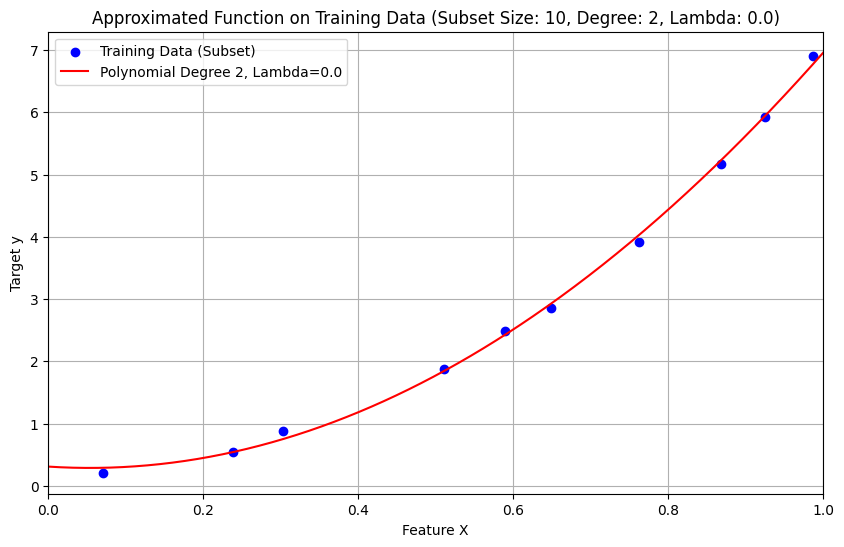

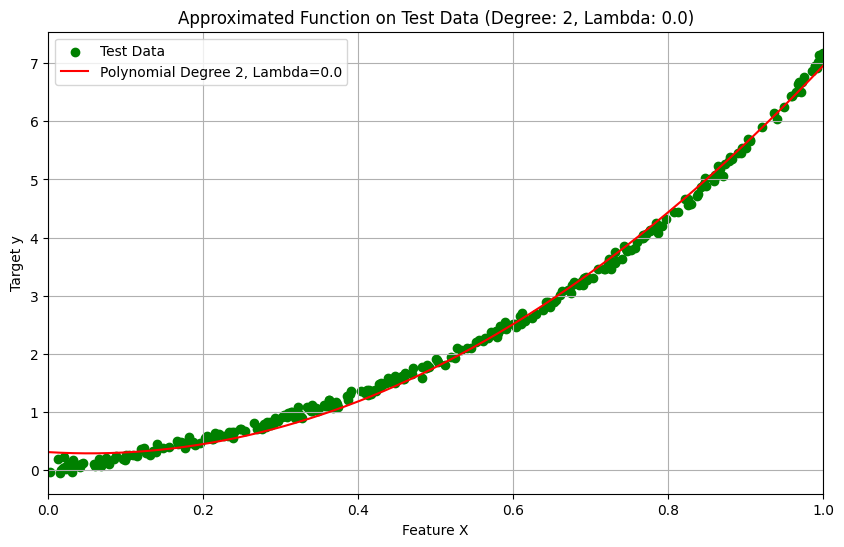


Weights for Subset Size: 10, Degree: 2, Lambda: 0.01
Weight for x^0: 0.09320751800741502
Weight for x^1: 0.3461684670943152
Weight for x^2: 6.388013883271377


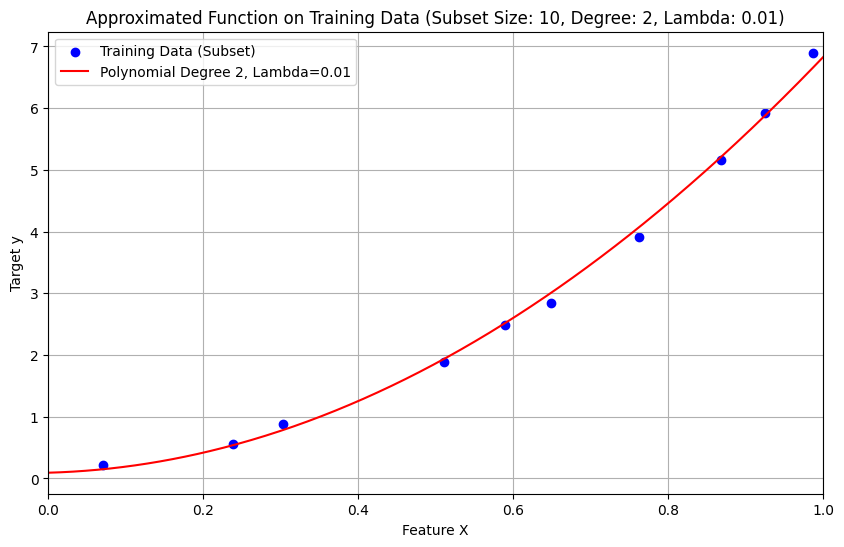

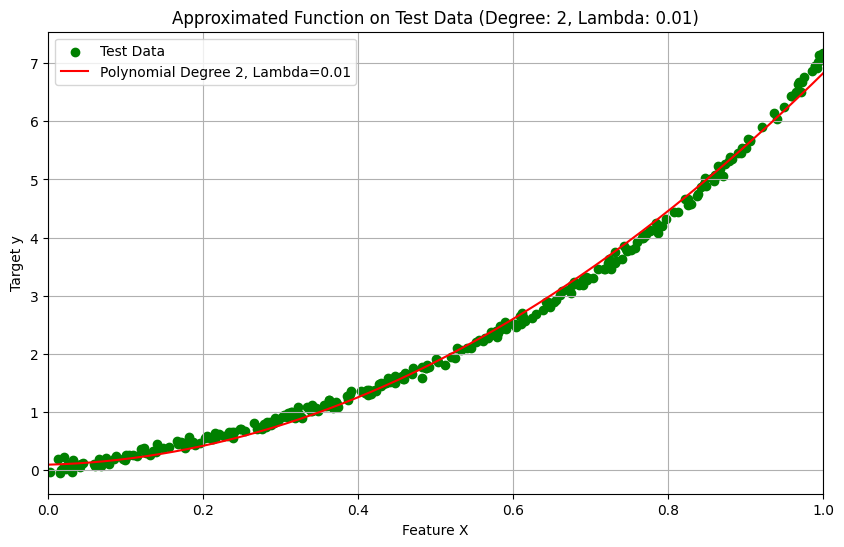


Weights for Subset Size: 10, Degree: 2, Lambda: 0.1
Weight for x^0: -0.16787464154716017
Weight for x^1: 2.3107681898259536
Weight for x^2: 4.325057996351155


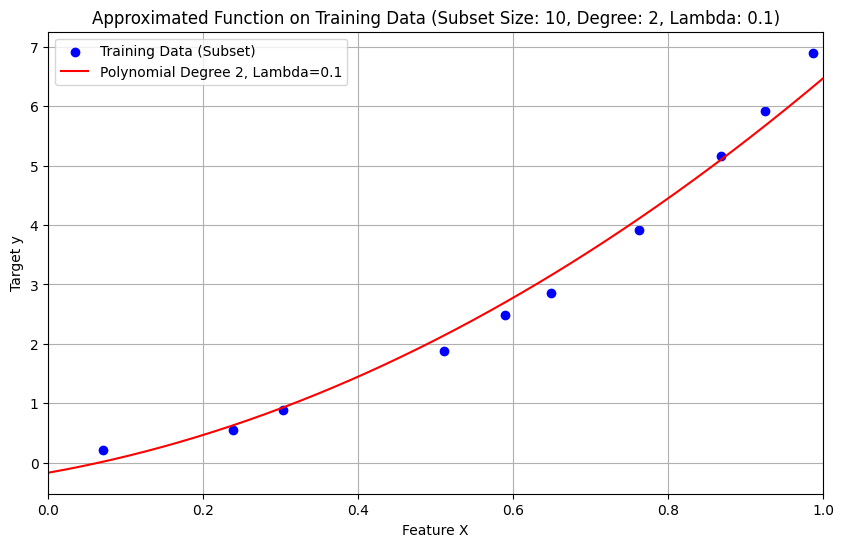

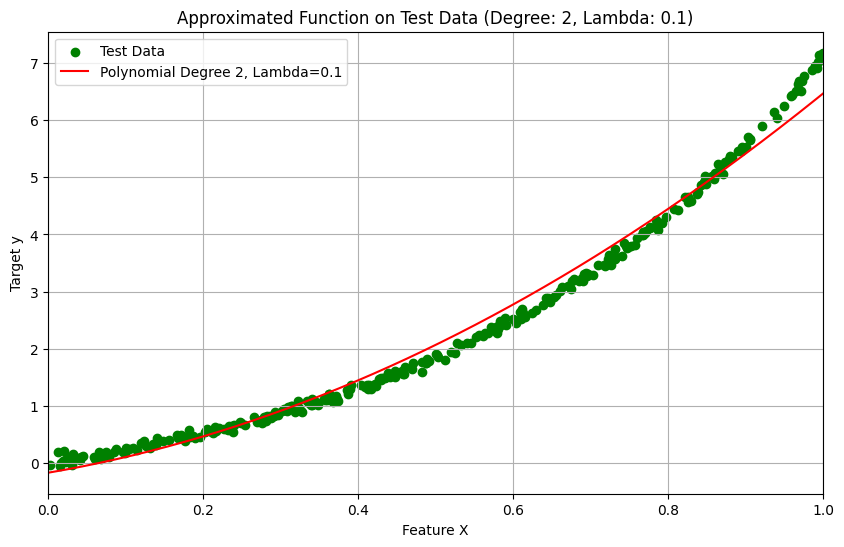


Weights for Subset Size: 10, Degree: 2, Lambda: 0.5
Weight for x^0: 0.22131548263423606
Weight for x^1: 2.493612439962938
Weight for x^2: 3.1526766413743488


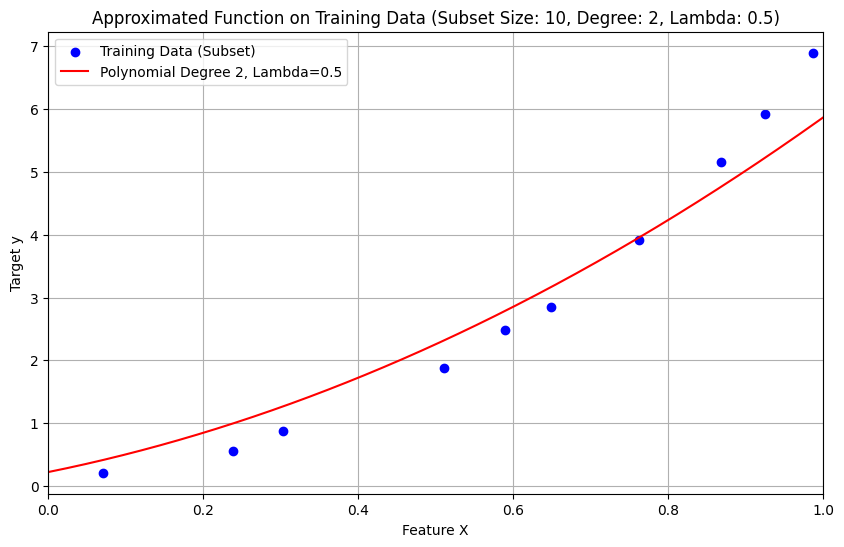

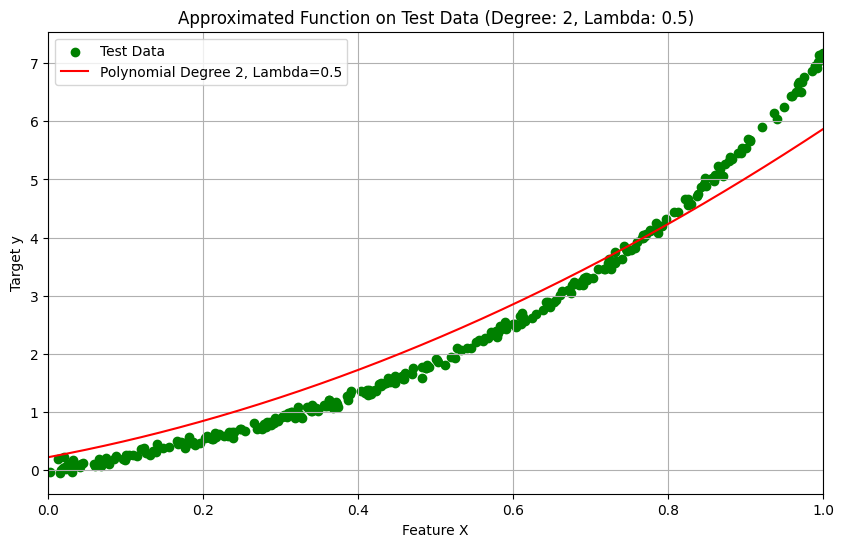


Weights for Subset Size: 10, Degree: 2, Lambda: 1.0
Weight for x^0: 0.5630054374719768
Weight for x^1: 2.245770019681651
Weight for x^2: 2.5995448515746347


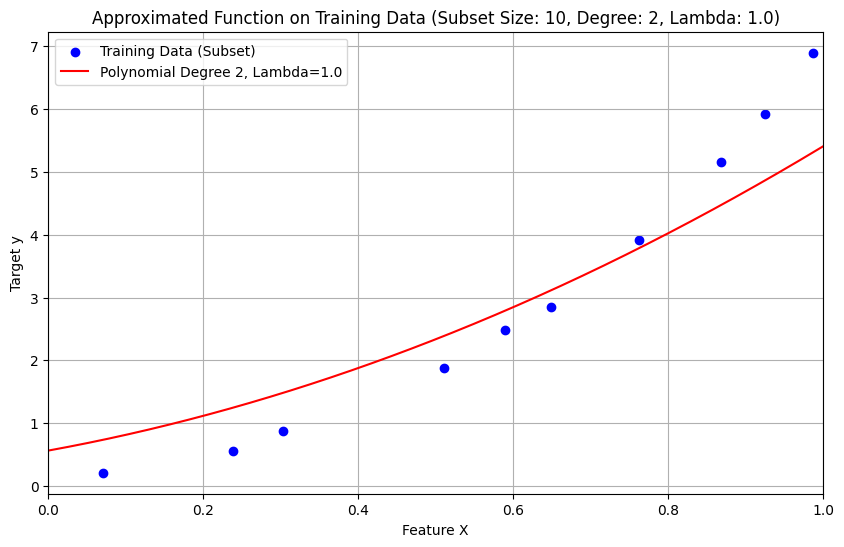

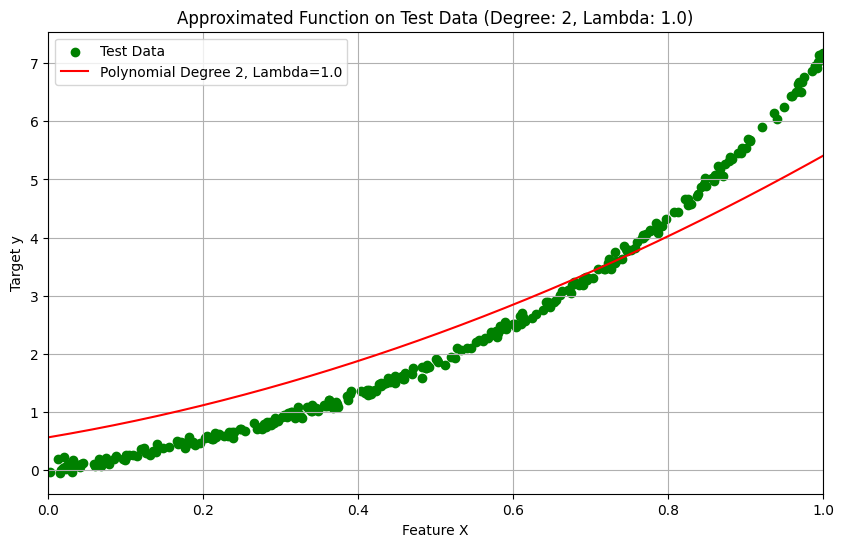


Weights for Subset Size: 10, Degree: 3, Lambda: 0.0
Weight for x^0: 0.03970525250251065
Weight for x^1: 1.9708064442224331
Weight for x^2: 1.1606141695654604
Weight for x^3: 3.9024805162223406


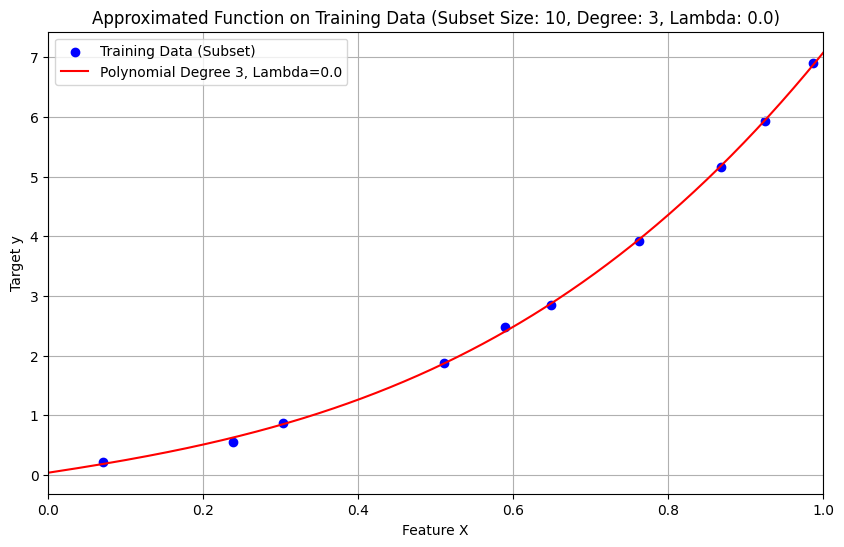

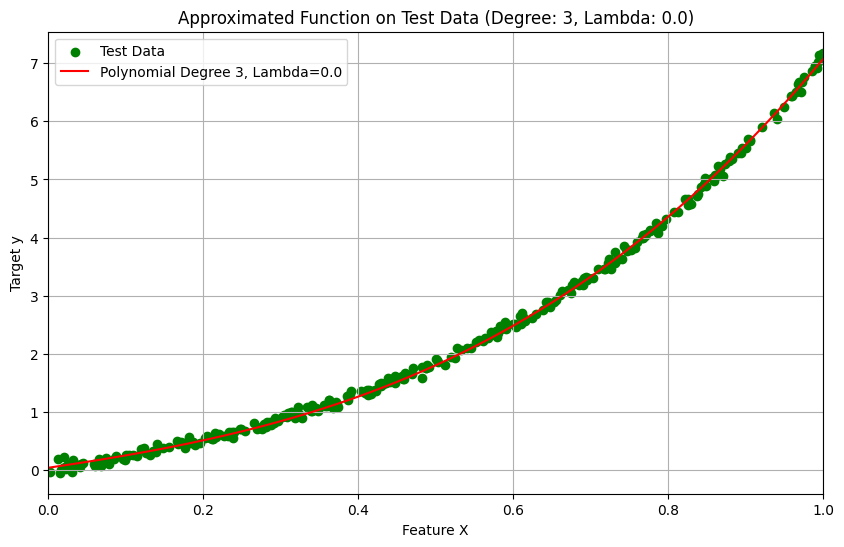


Weights for Subset Size: 10, Degree: 3, Lambda: 0.01
Weight for x^0: 0.08006428443564823
Weight for x^1: 1.5015583457079502
Weight for x^2: 2.3850974916325063
Weight for x^3: 3.0582097066105467


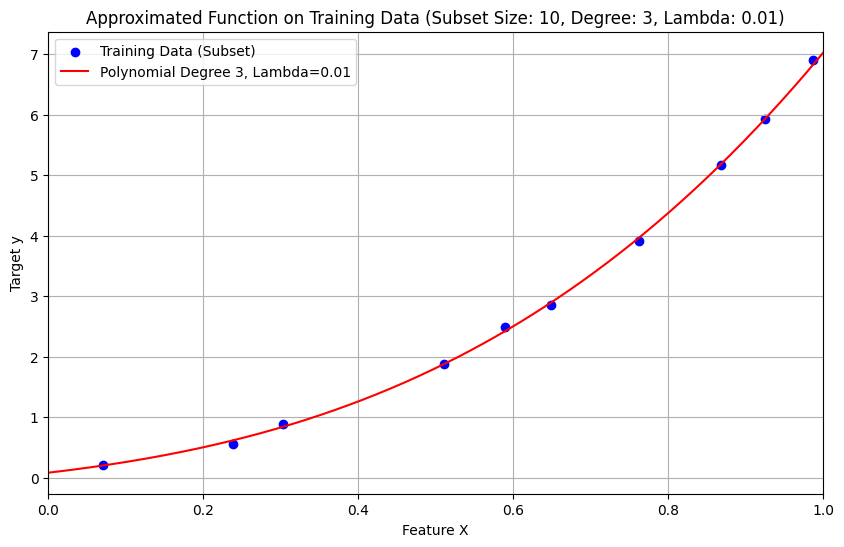

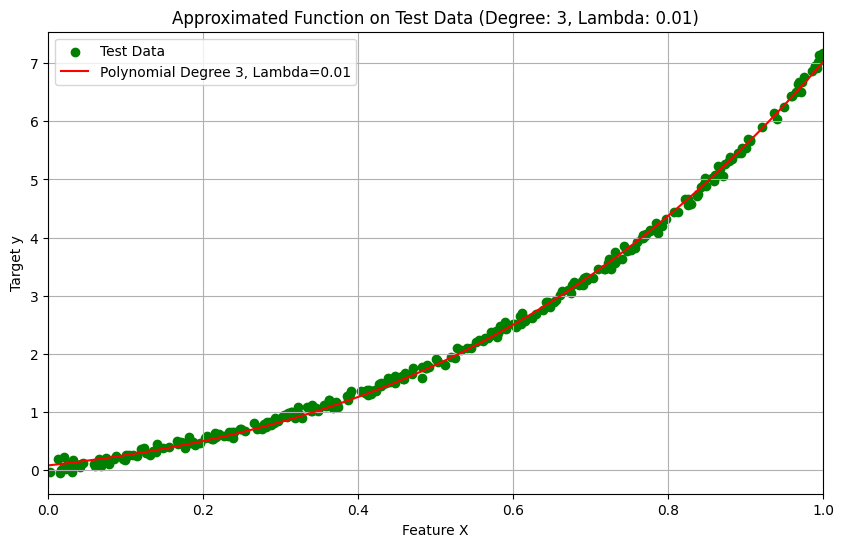


Weights for Subset Size: 10, Degree: 3, Lambda: 0.1
Weight for x^0: 0.07350564635790147
Weight for x^1: 1.7697078458187152
Weight for x^2: 2.382046944891192
Weight for x^3: 2.627071721936055


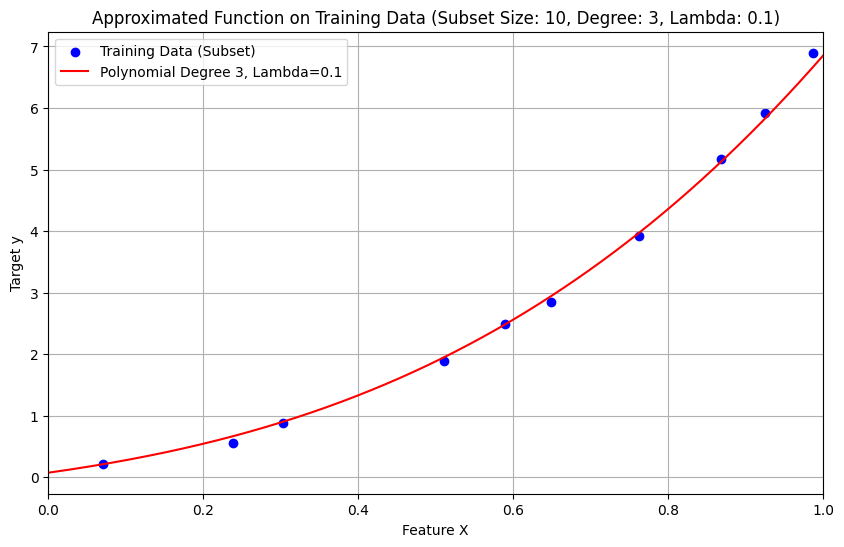

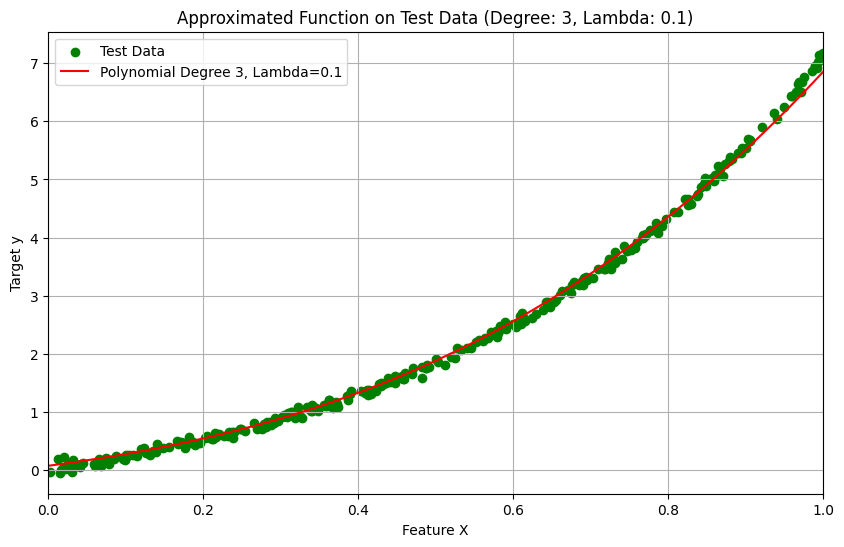


Weights for Subset Size: 10, Degree: 3, Lambda: 0.5
Weight for x^0: 0.3163552889792226
Weight for x^1: 1.811177546550851
Weight for x^2: 2.114536236116991
Weight for x^3: 2.153251751968408


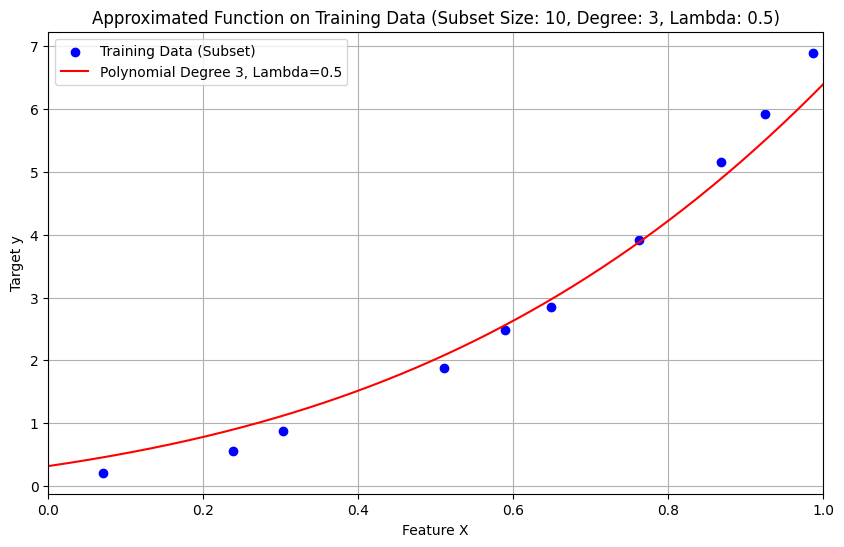

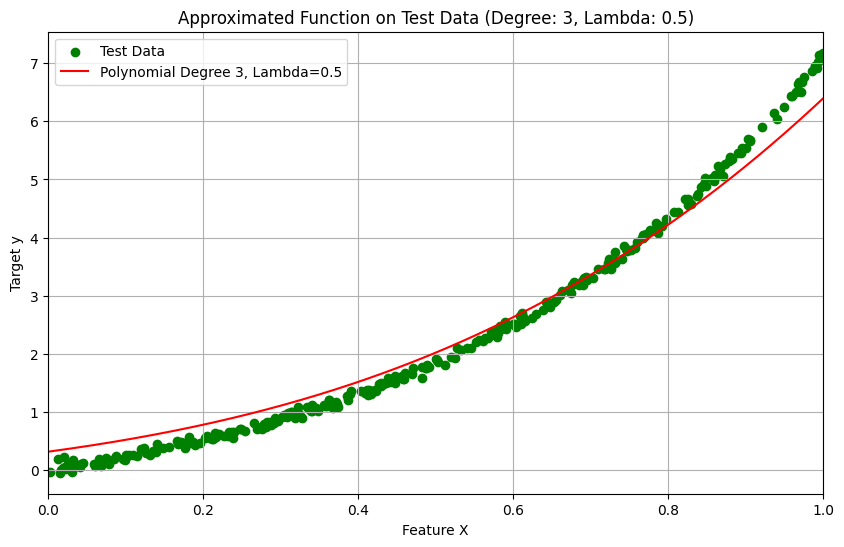


Weights for Subset Size: 10, Degree: 3, Lambda: 1.0
Weight for x^0: 0.5437616757158559
Weight for x^1: 1.7017694605365843
Weight for x^2: 1.8819874844565683
Weight for x^3: 1.8673226609567337


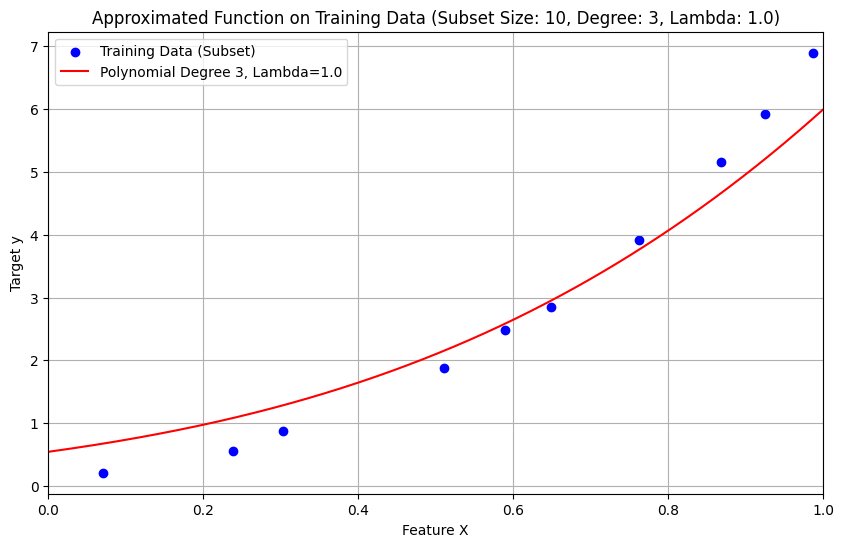

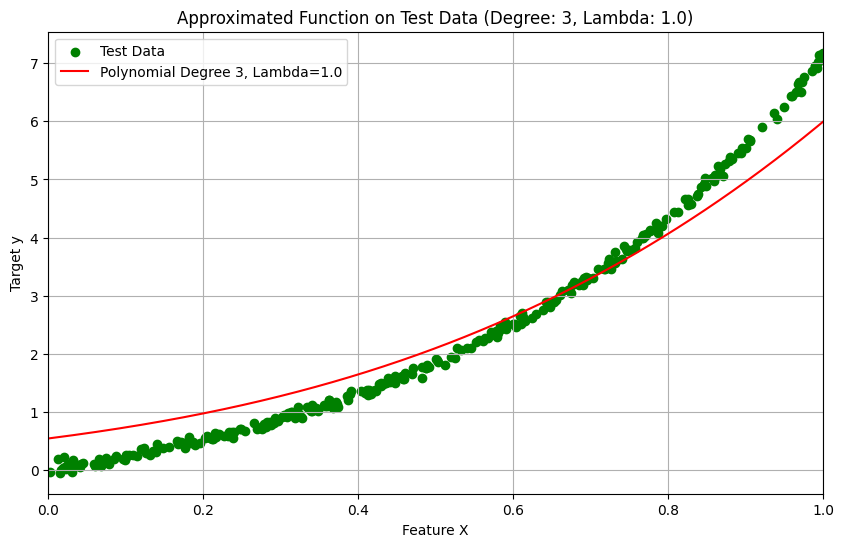


Weights for Subset Size: 10, Degree: 4, Lambda: 0.0
Weight for x^0: 0.16993624887064848
Weight for x^1: -0.1596472726066345
Weight for x^2: 9.92698290401372
Weight for x^3: -8.980747058981258
Weight for x^4: 6.1715877953415


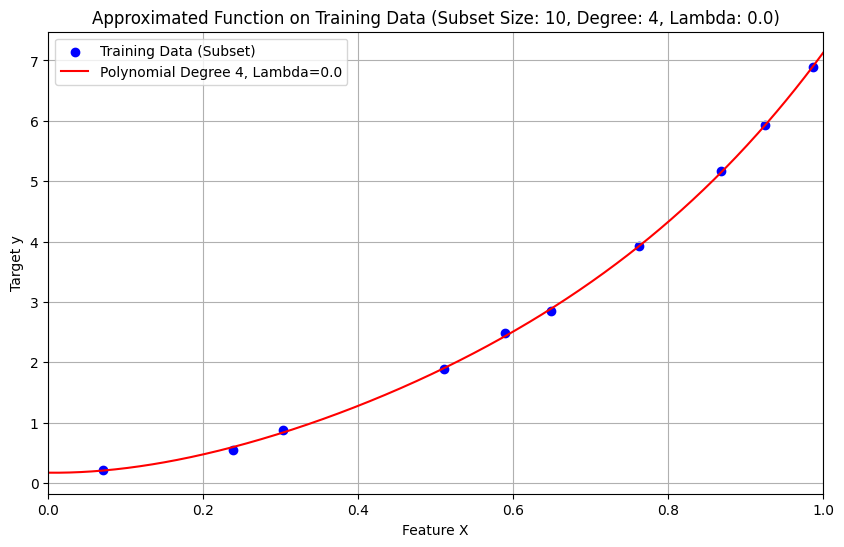

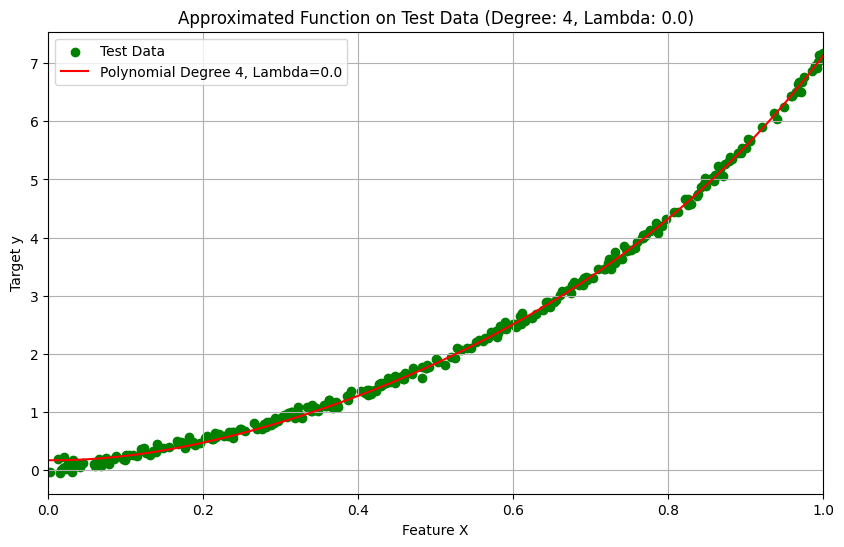


Weights for Subset Size: 10, Degree: 4, Lambda: 0.01
Weight for x^0: 0.03709590047505022
Weight for x^1: 1.942352962363205
Weight for x^2: 2.042724632019731
Weight for x^3: 1.6897161444800217
Weight for x^4: 1.3866061918198134


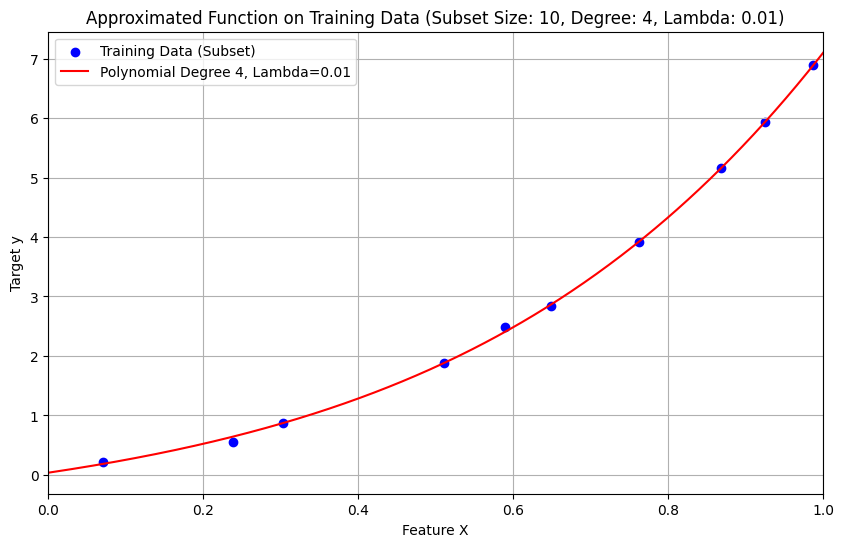

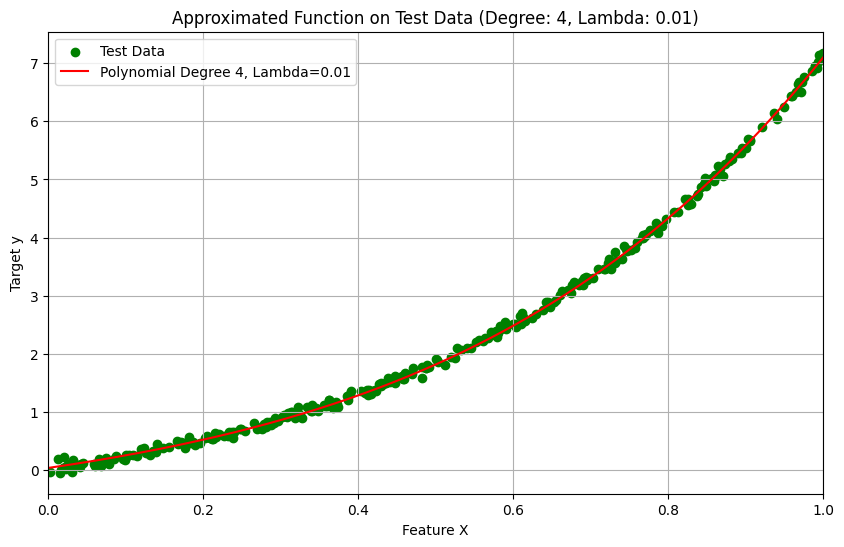


Weights for Subset Size: 10, Degree: 4, Lambda: 0.1
Weight for x^0: 0.1455679908067241
Weight for x^1: 1.8099896178318753
Weight for x^2: 1.866652428893909
Weight for x^3: 1.699319125497215
Weight for x^4: 1.5264640314403342


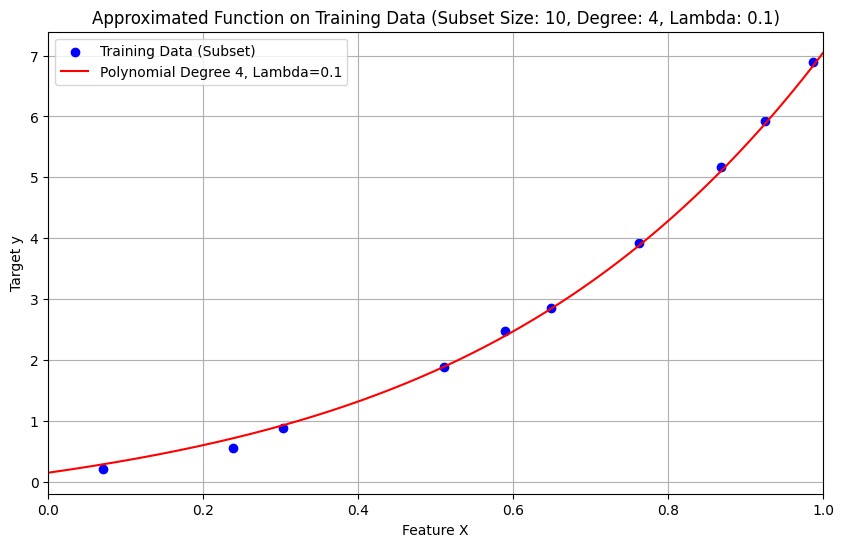

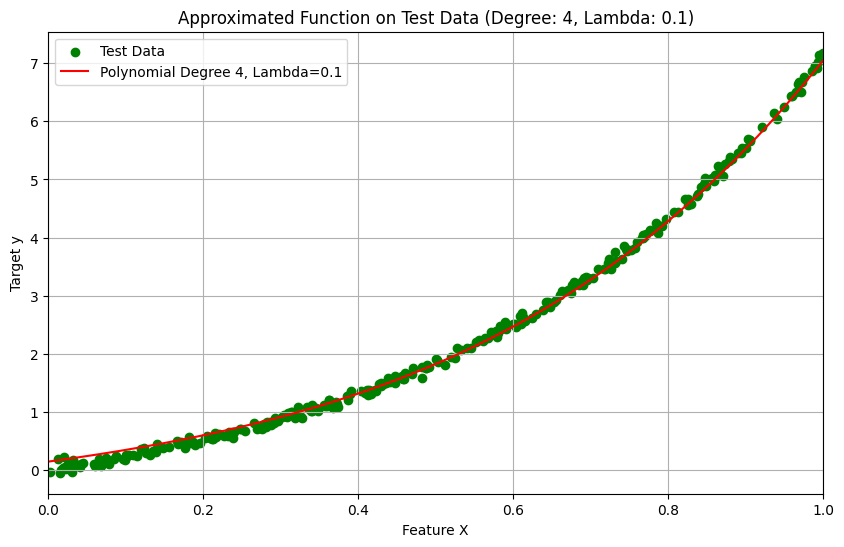


Weights for Subset Size: 10, Degree: 4, Lambda: 0.5
Weight for x^0: 0.3936153301979652
Weight for x^1: 1.5825577375244948
Weight for x^2: 1.6734083605228975
Weight for x^3: 1.5937079602114463
Weight for x^4: 1.4896817844709684


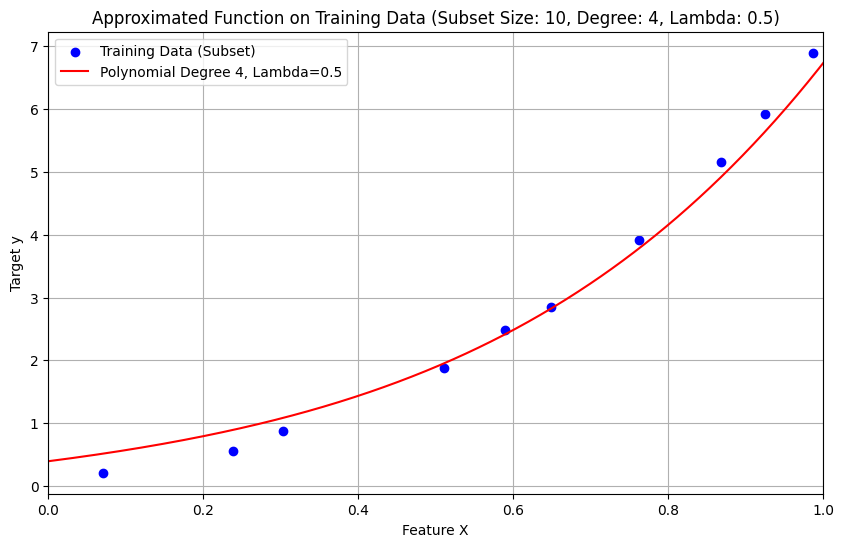

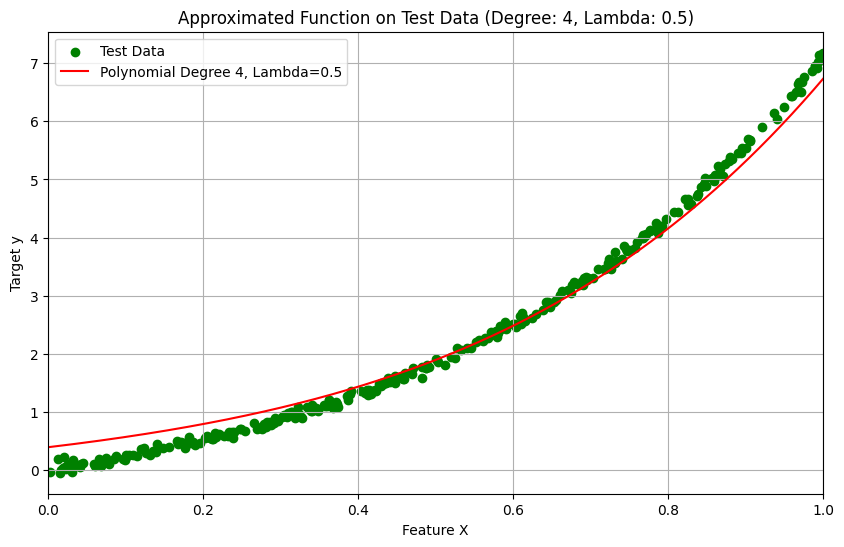


Weights for Subset Size: 10, Degree: 4, Lambda: 1.0
Weight for x^0: 0.5699299686383729
Weight for x^1: 1.468266810007111
Weight for x^2: 1.5290856611071924
Weight for x^3: 1.4584973570220516
Weight for x^4: 1.3683875311826148


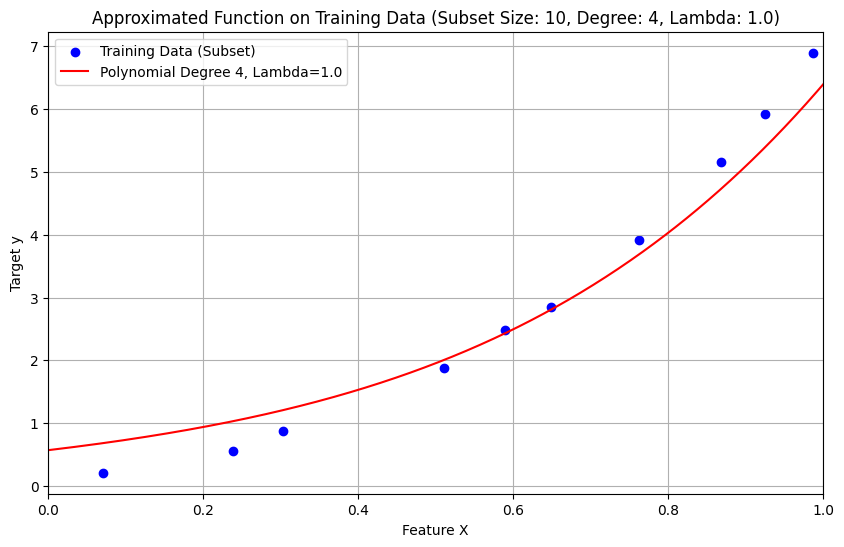

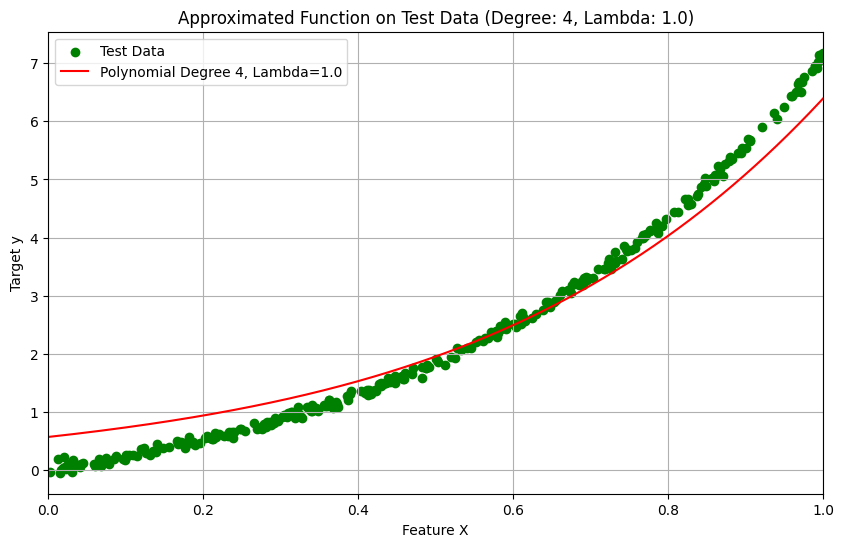


Weights for Subset Size: 10, Degree: 5, Lambda: 0.0
Weight for x^0: 0.3457063666902297
Weight for x^1: -3.8783893633457915
Weight for x^2: 31.421539787825747
Weight for x^3: -58.952945881641575
Weight for x^4: 56.69072611629626
Weight for x^5: -18.525124372090243


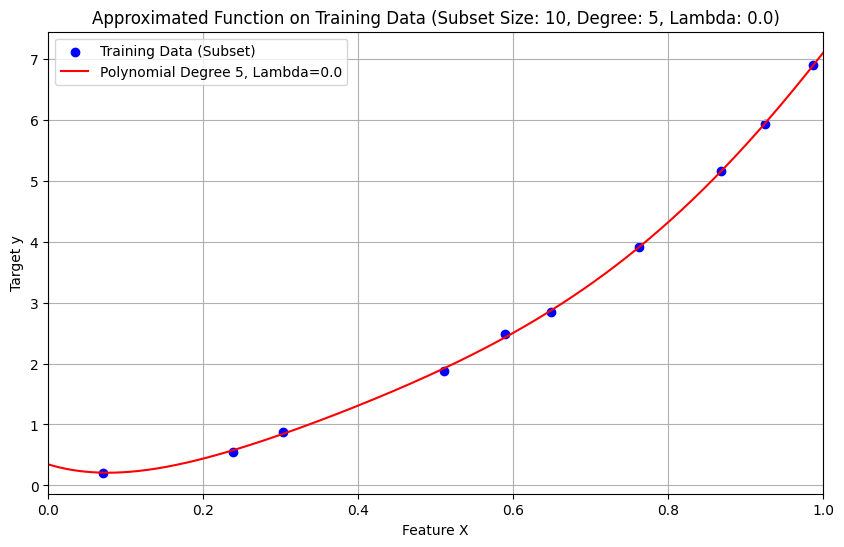

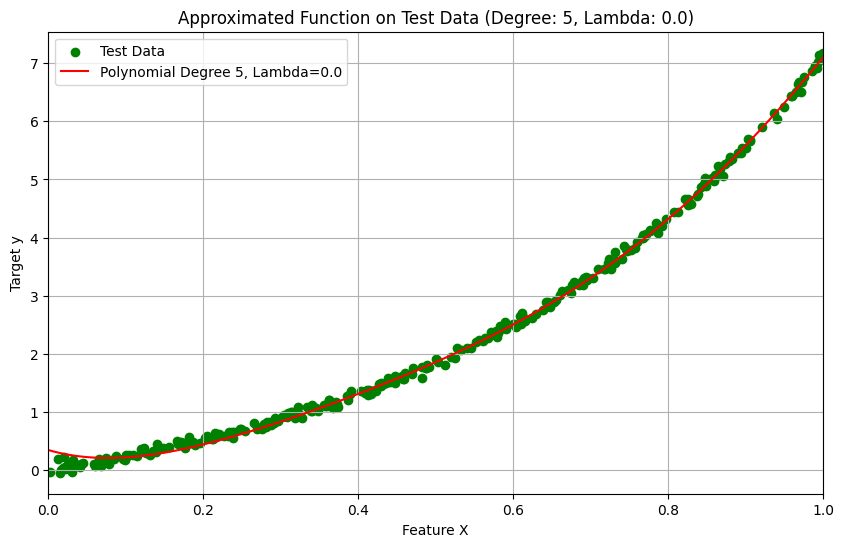


Weights for Subset Size: 10, Degree: 5, Lambda: 0.01
Weight for x^0: 0.021686117538974772
Weight for x^1: 2.0436541487513864
Weight for x^2: 2.072735907125473
Weight for x^3: 1.4932155633416828
Weight for x^4: 0.949087453172991
Weight for x^5: 0.5451774274680553


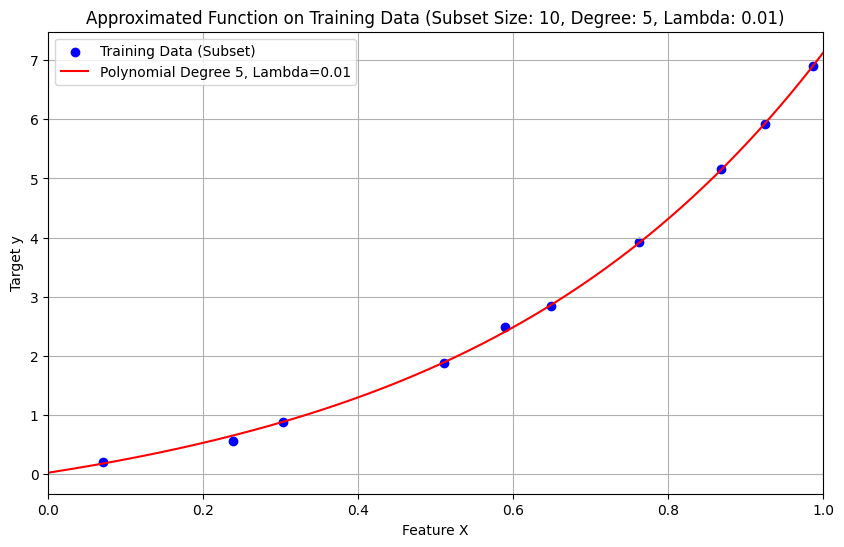

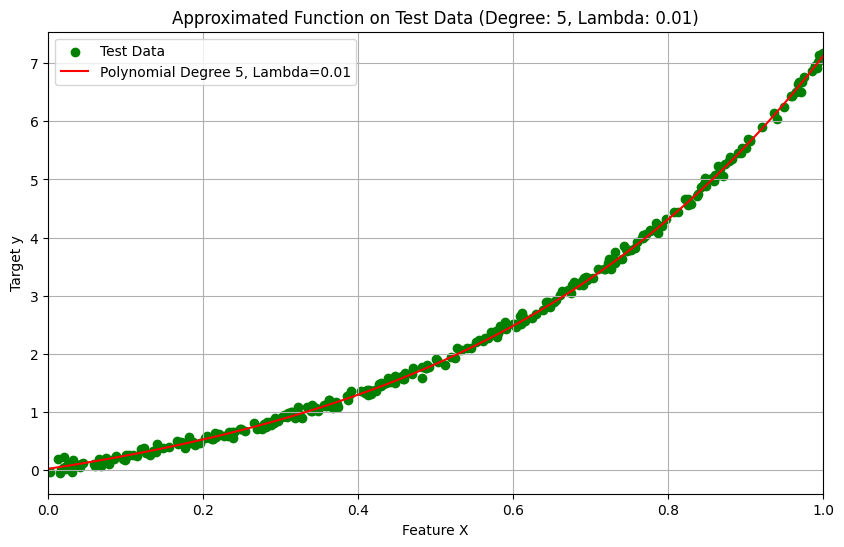


Weights for Subset Size: 10, Degree: 5, Lambda: 0.1
Weight for x^0: 0.16314944748924204
Weight for x^1: 1.8909776174965047
Weight for x^2: 1.7412514007982736
Weight for x^3: 1.395851681535935
Weight for x^4: 1.0950277243081192
Weight for x^5: 0.8621443663435082


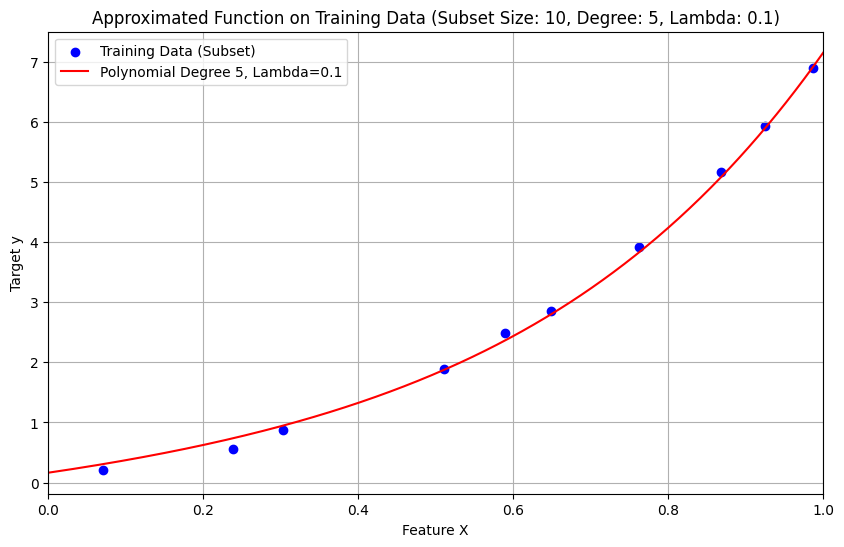

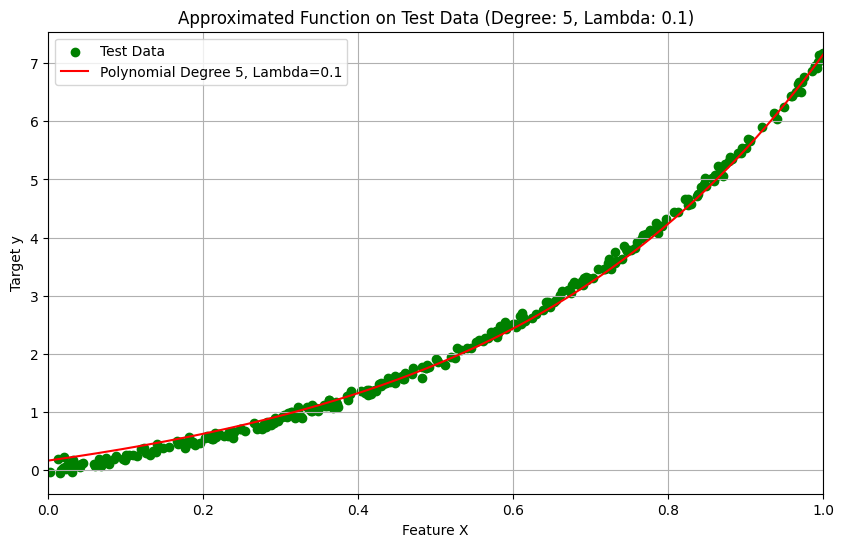


Weights for Subset Size: 10, Degree: 5, Lambda: 0.5
Weight for x^0: 0.4420069649269815
Weight for x^1: 1.5092138096521814
Weight for x^2: 1.4772952592870054
Weight for x^3: 1.3190293932226418
Weight for x^4: 1.167556806945281
Weight for x^5: 1.0409912837240172


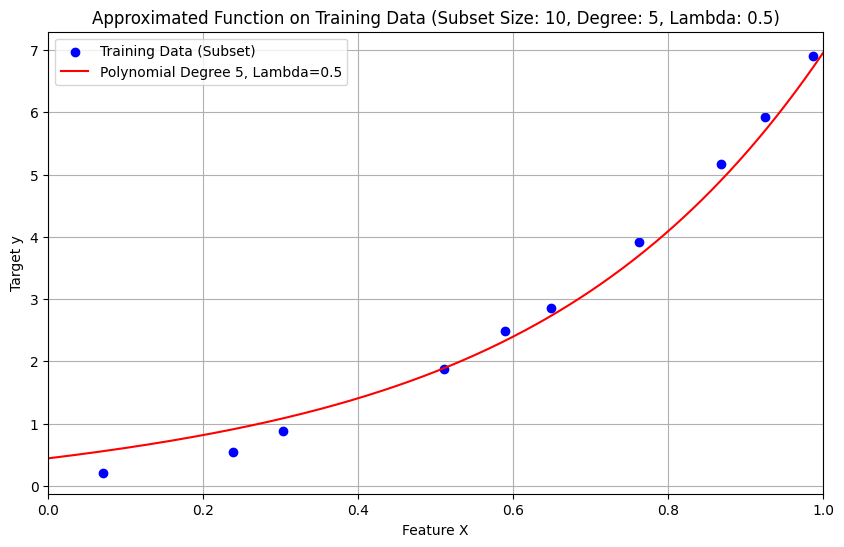

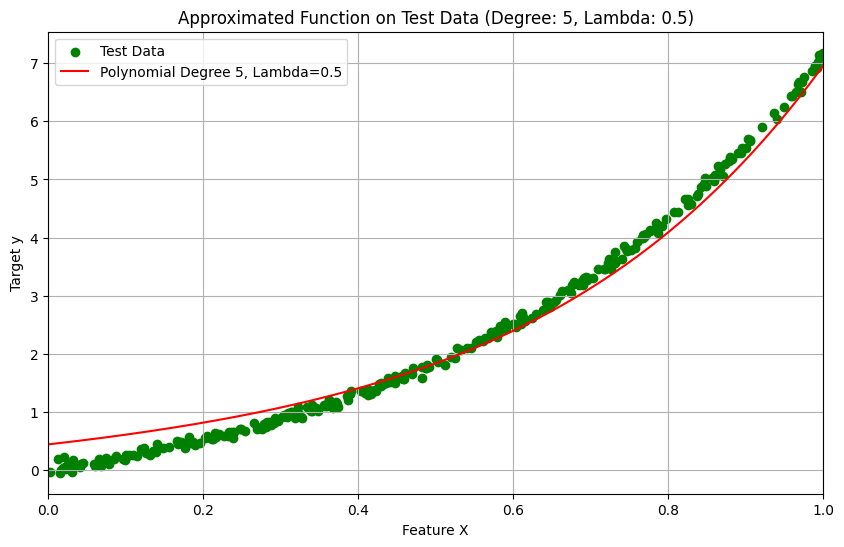


Weights for Subset Size: 10, Degree: 5, Lambda: 1.0
Weight for x^0: 0.5985757094232261
Weight for x^1: 1.363215887894724
Weight for x^2: 1.3452852587531752
Weight for x^3: 1.2314656831239055
Weight for x^4: 1.1181841026008519
Weight for x^5: 1.0202807952599868


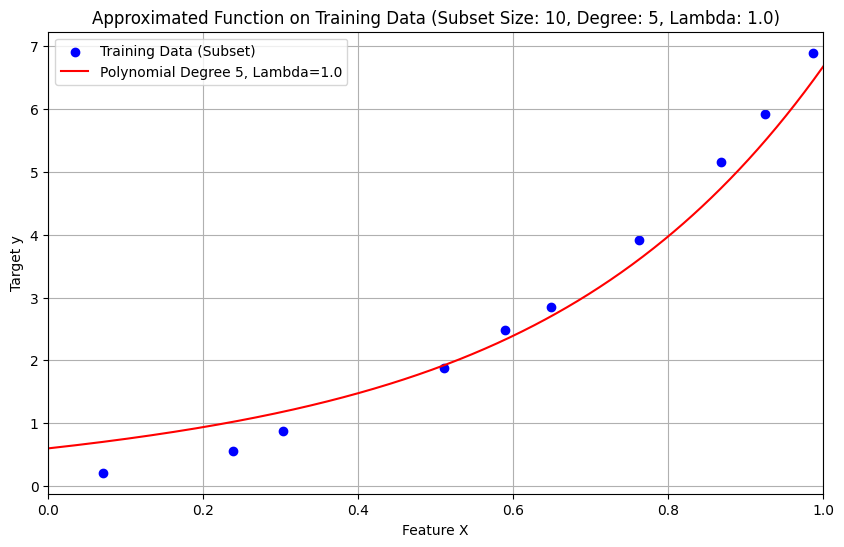

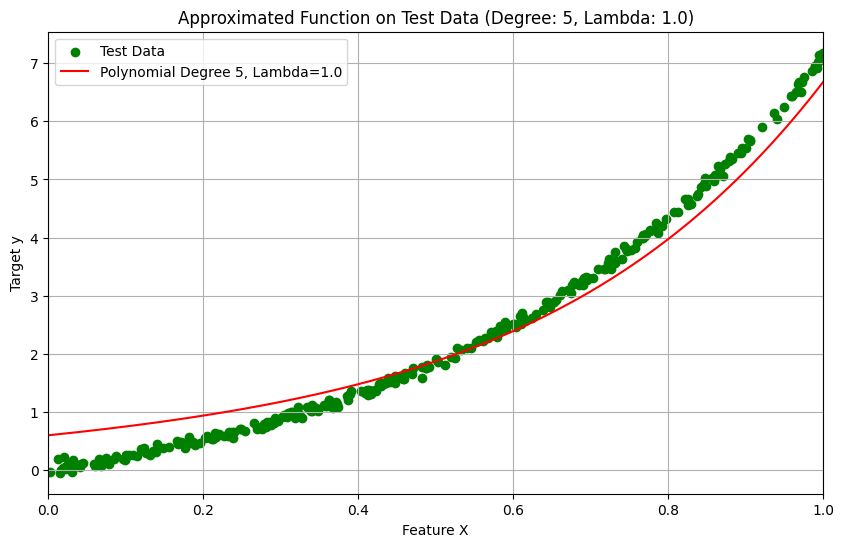


Weights for Subset Size: 10, Degree: 6, Lambda: 0.0
Weight for x^0: 0.7090879110488586
Weight for x^1: -12.401060520062279
Weight for x^2: 91.6826718322615
Weight for x^3: -248.50768491736383
Weight for x^4: 354.10896873815216
Weight for x^5: -246.49972607378905
Weight for x^6: 68.02947556301349


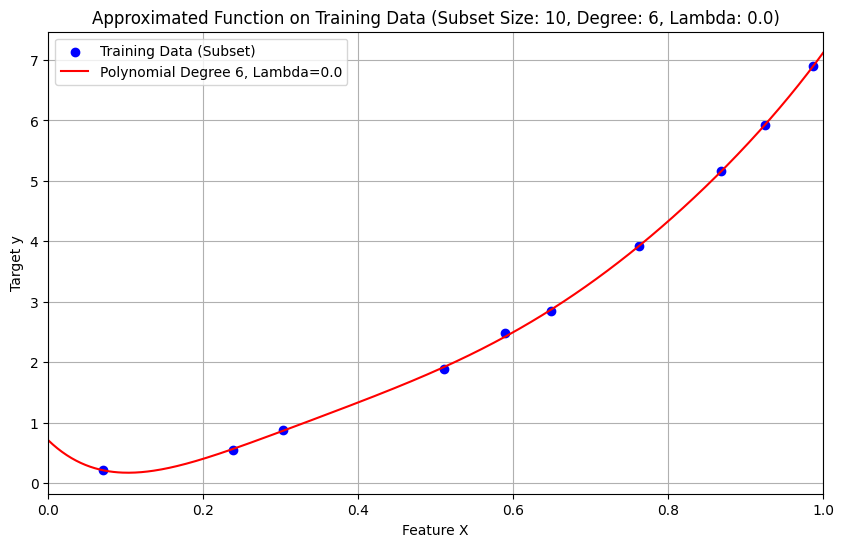

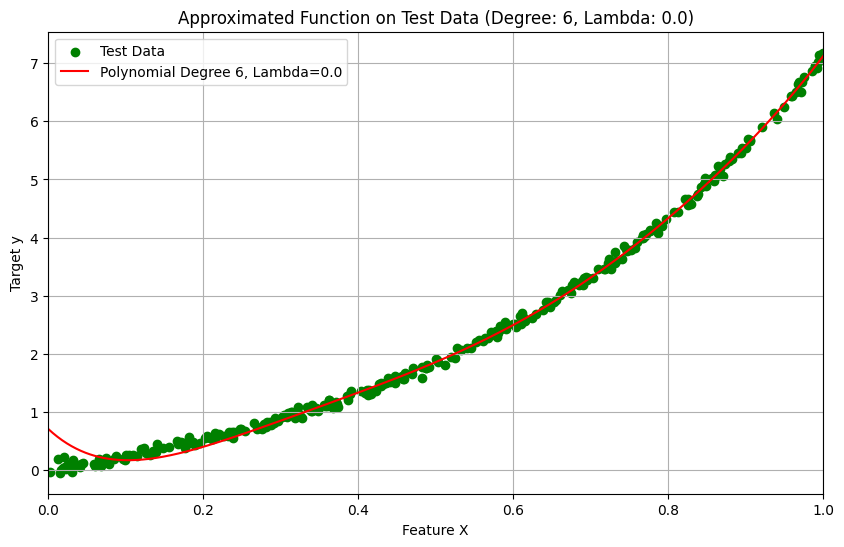


Weights for Subset Size: 10, Degree: 6, Lambda: 0.01
Weight for x^0: 0.01907868782122879
Weight for x^1: 2.054629985551557
Weight for x^2: 2.0912010363859763
Weight for x^3: 1.4825495677575629
Weight for x^4: 0.8981394971731796
Weight for x^5: 0.45402397701239594
Weight for x^6: 0.13218964272337133


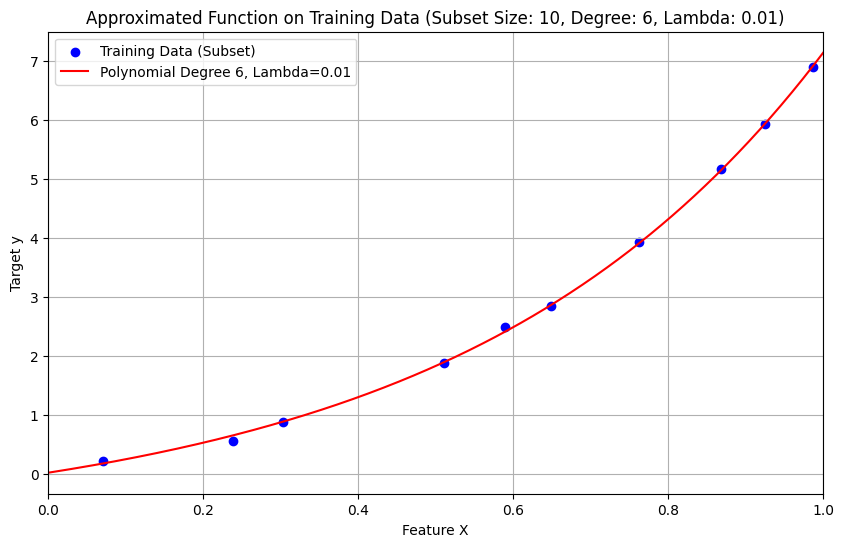

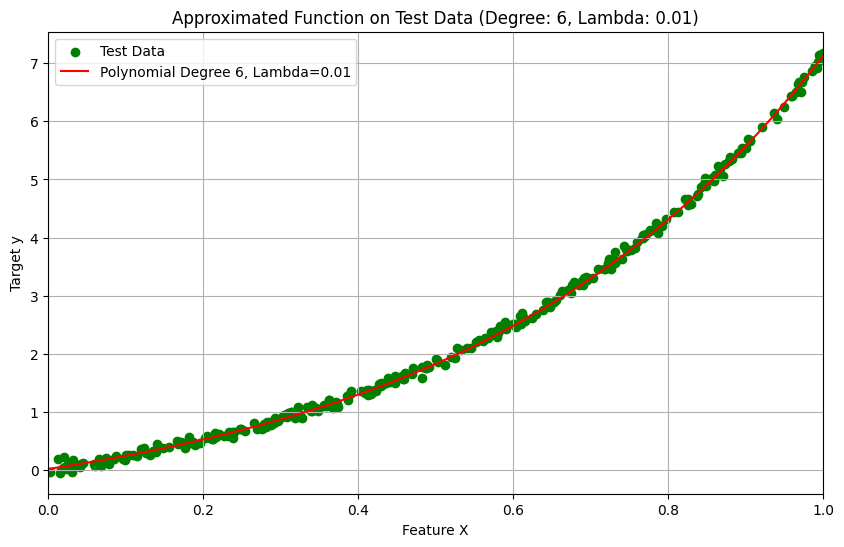


Weights for Subset Size: 10, Degree: 6, Lambda: 0.1
Weight for x^0: 0.16571864981802925
Weight for x^1: 1.9395749061805185
Weight for x^2: 1.718523119239305
Weight for x^3: 1.3014501509031018
Weight for x^4: 0.9440776742361582
Weight for x^5: 0.668972807094722
Weight for x^6: 0.46066576413477534


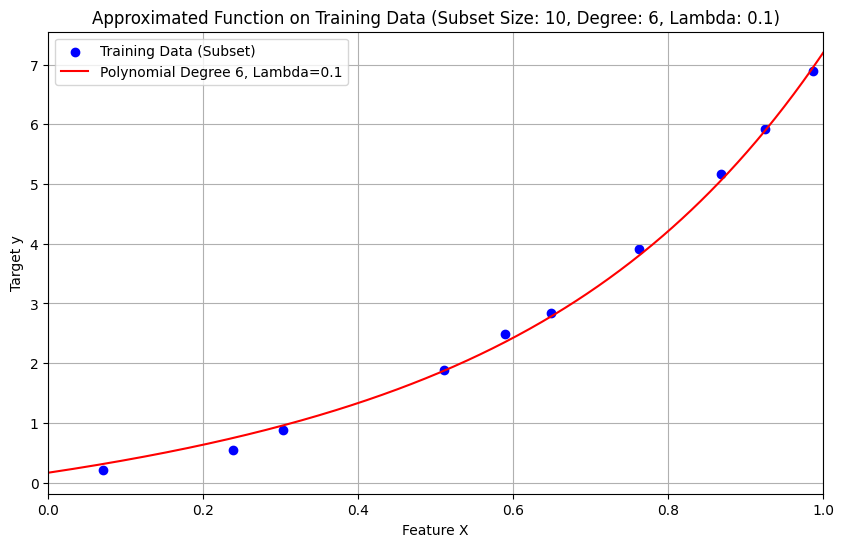

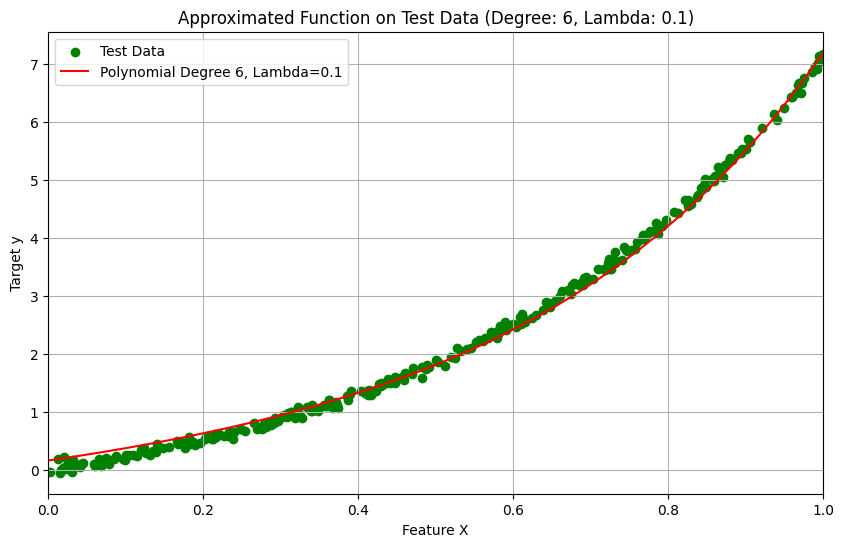


Weights for Subset Size: 10, Degree: 6, Lambda: 0.5
Weight for x^0: 0.4703079355264895
Weight for x^1: 1.4904777498903878
Weight for x^2: 1.3883872454966657
Weight for x^3: 1.1803709098608137
Weight for x^4: 0.9962653950366501
Weight for x^5: 0.8487522027600986
Weight for x^6: 0.7320280350802644


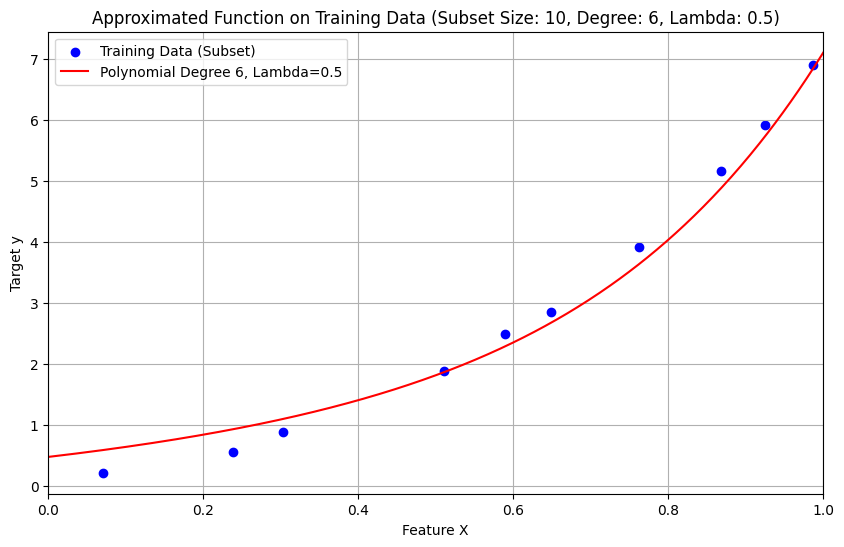

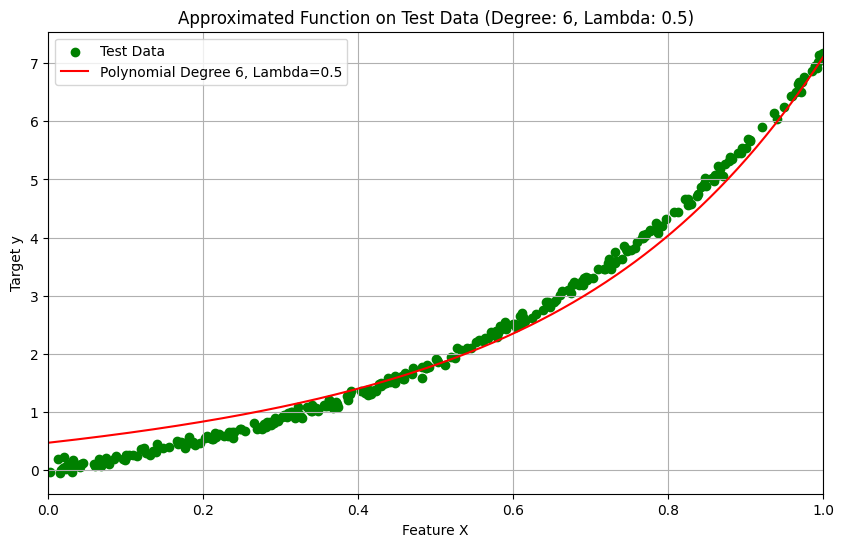


Weights for Subset Size: 10, Degree: 6, Lambda: 1.0
Weight for x^0: 0.6213771925945365
Weight for x^1: 1.3152000426886743
Weight for x^2: 1.2458012317829268
Weight for x^3: 1.1005761574606767
Weight for x^4: 0.9686173755114627
Weight for x^5: 0.8598943665822902
Weight for x^6: 0.771427976700697


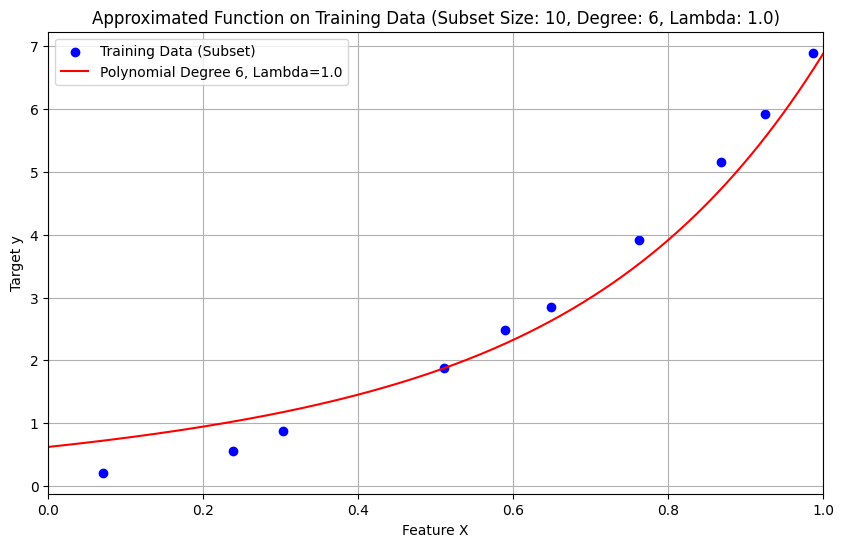

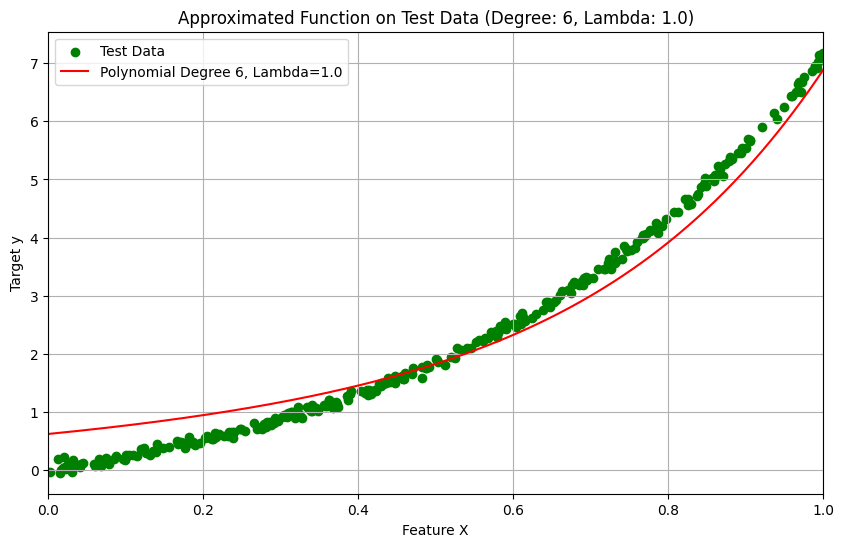


Weights for Subset Size: 10, Degree: 7, Lambda: 0.0
Weight for x^0: 1.3777242029693384
Weight for x^1: -29.80847406689183
Weight for x^2: 241.9138947190601
Weight for x^3: -867.8754695819932
Weight for x^4: 1729.1609538095015
Weight for x^5: -1931.1133011512532
Weight for x^6: 1139.894616797168
Weight for x^7: -276.4507642248146


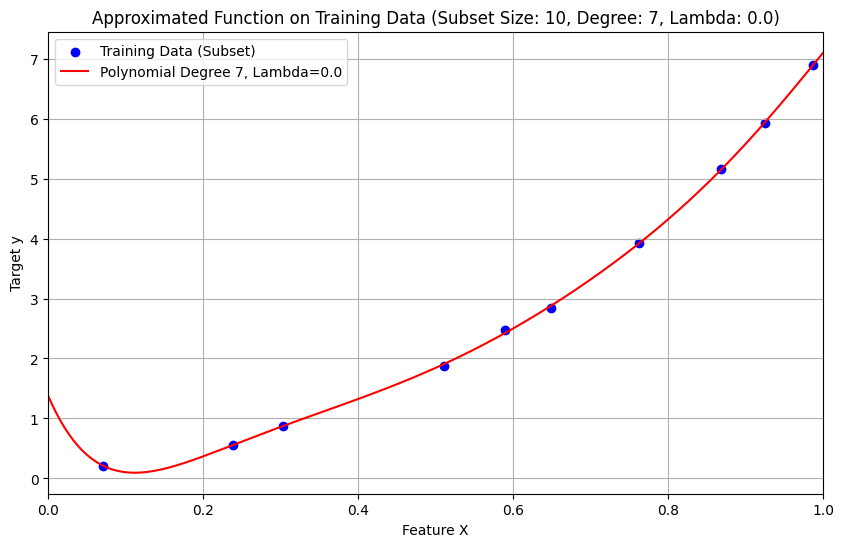

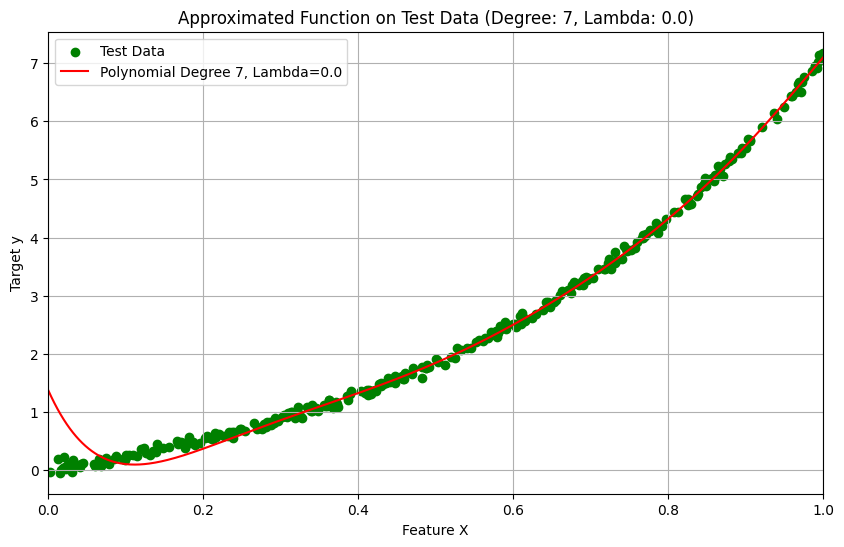


Weights for Subset Size: 10, Degree: 7, Lambda: 0.01
Weight for x^0: 0.019713629556905365
Weight for x^1: 2.053776654575837
Weight for x^2: 2.0830733536316384
Weight for x^3: 1.4799207199197142
Weight for x^4: 0.9067792848759496
Weight for x^5: 0.47555391692247956
Weight for x^6: 0.16633493595773355
Weight for x^7: -0.05584258129257782


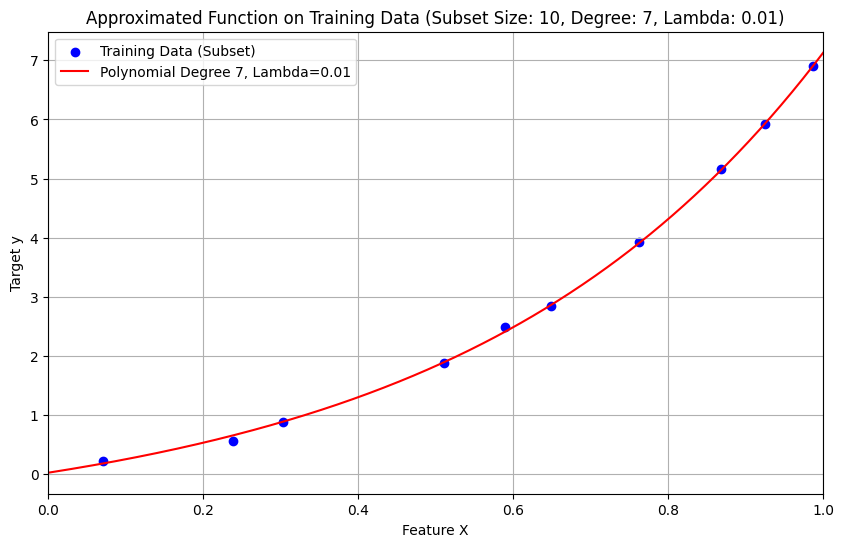

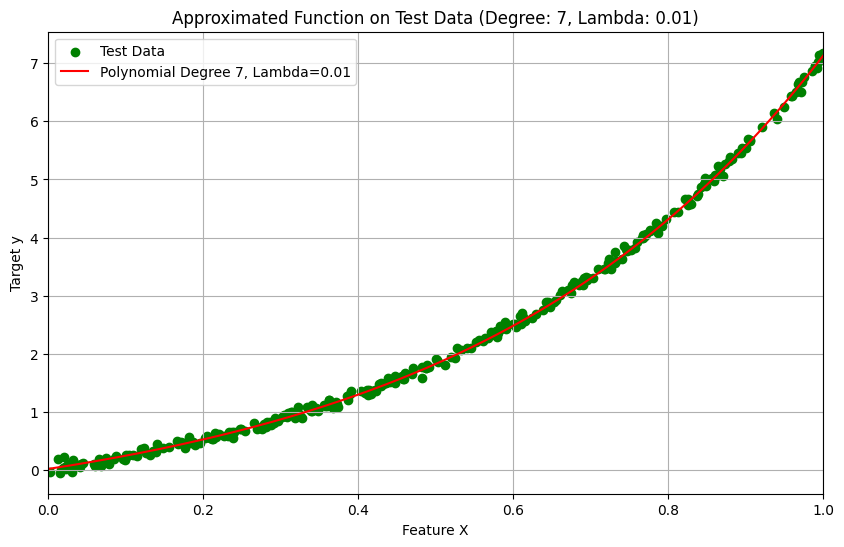


Weights for Subset Size: 10, Degree: 7, Lambda: 0.1
Weight for x^0: 0.16518132597377666
Weight for x^1: 1.9604744191578525
Weight for x^2: 1.7186512254038169
Weight for x^3: 1.2766989810692442
Weight for x^4: 0.897785346822779
Weight for x^5: 0.6053857783951224
Weight for x^6: 0.3835041833798385
Weight for x^7: 0.21396824919943508


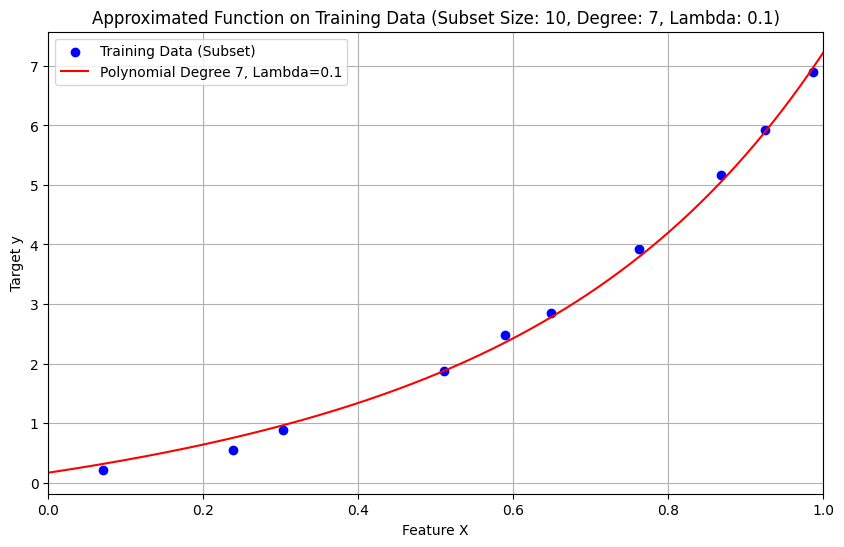

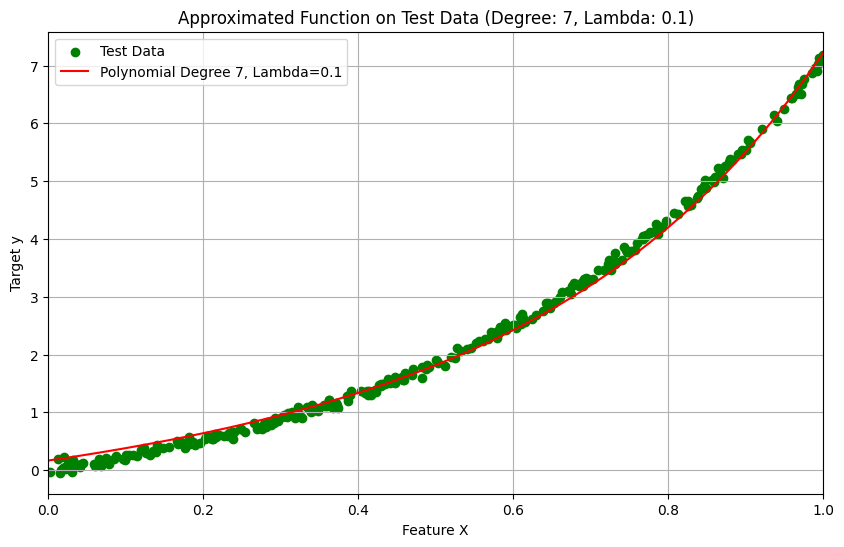


Weights for Subset Size: 10, Degree: 7, Lambda: 0.5
Weight for x^0: 0.48636907839857946
Weight for x^1: 1.4901664362837628
Weight for x^2: 1.3482425774628548
Weight for x^3: 1.1094537861099403
Weight for x^4: 0.9038205118541222
Weight for x^5: 0.7415543286703496
Weight for x^6: 0.6147897881258545
Weight for x^7: 0.5147813476943172


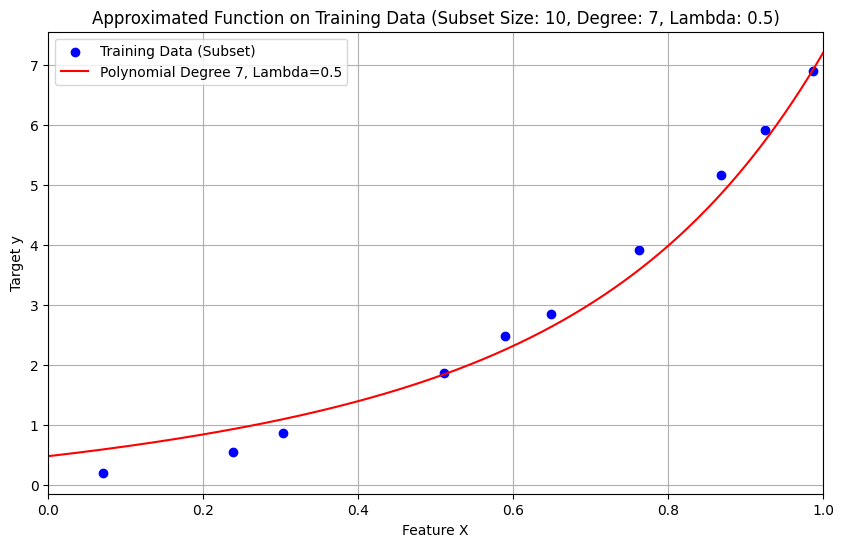

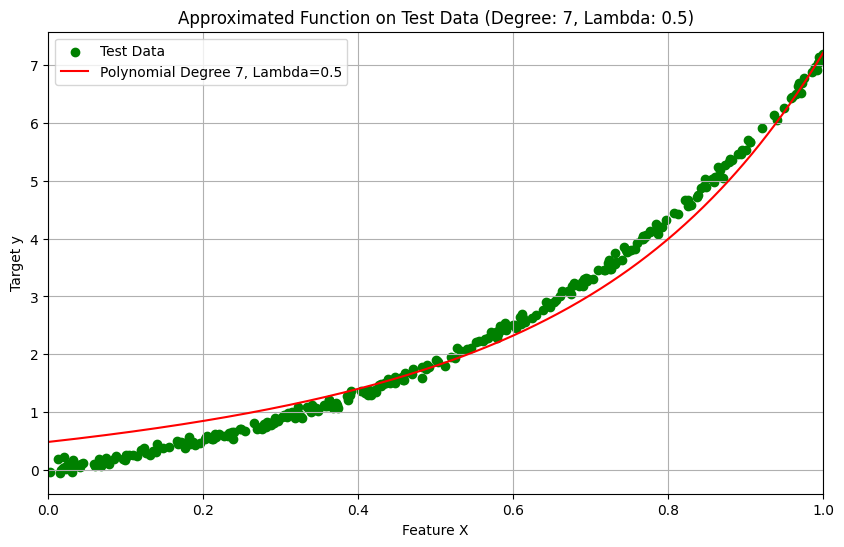


Weights for Subset Size: 10, Degree: 7, Lambda: 1.0
Weight for x^0: 0.6379647009717359
Weight for x^1: 1.2936364678548848
Weight for x^2: 1.1905700372694175
Weight for x^3: 1.0230686166788576
Weight for x^4: 0.8768773231193736
Weight for x^5: 0.7591759563777922
Weight for x^6: 0.6651572689882329
Weight for x^7: 0.5892724562487938


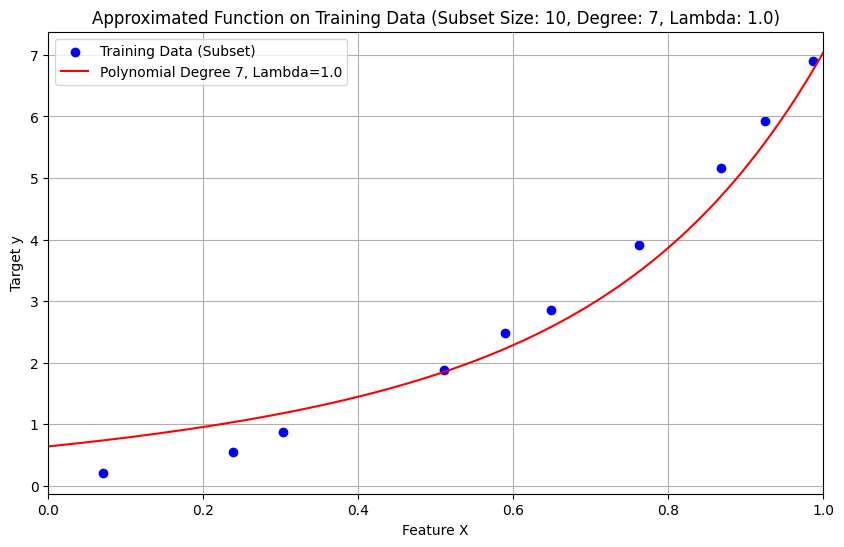

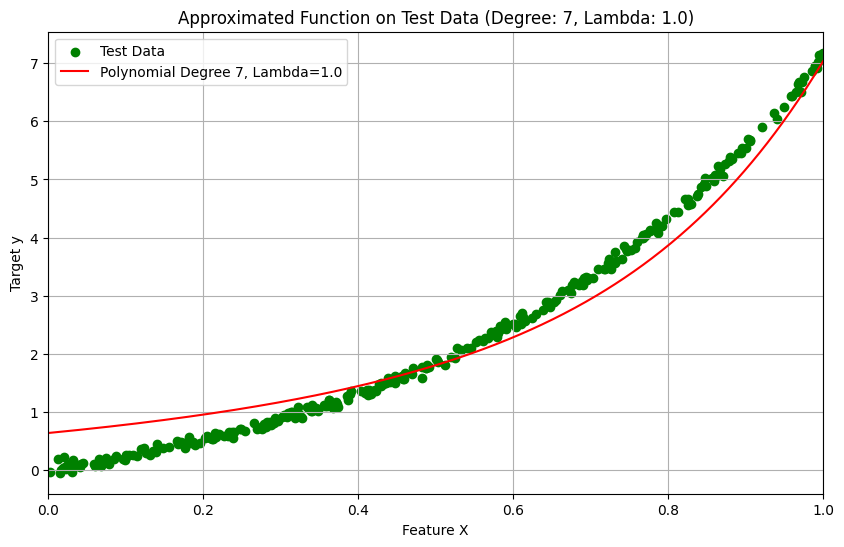


Weights for Subset Size: 10, Degree: 8, Lambda: 0.0
Weight for x^0: 7.215784703312306
Weight for x^1: -194.87819421552635
Weight for x^2: 1886.9094747119414
Weight for x^3: -9062.179596061007
Weight for x^4: 24848.017417606192
Weight for x^5: -40565.49067656166
Weight for x^6: 39024.52404281442
Weight for x^7: -20415.716628830873
Weight for x^8: 4478.788160161203


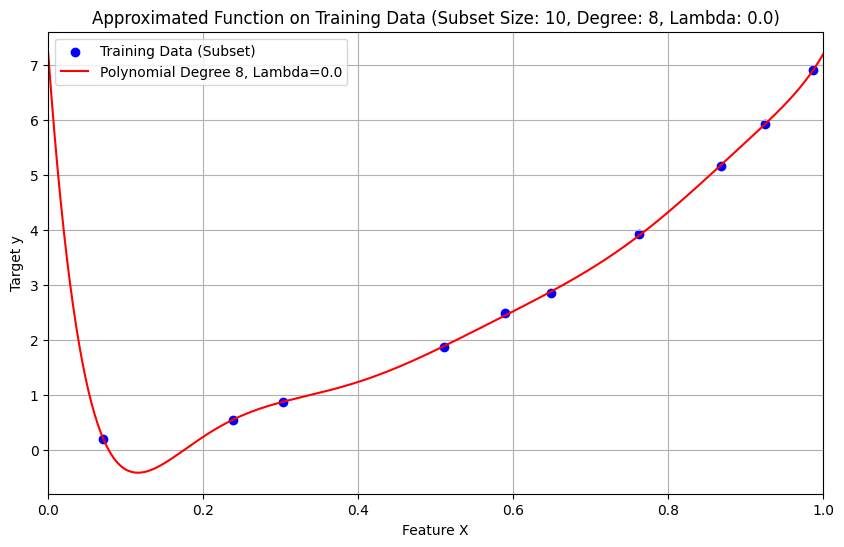

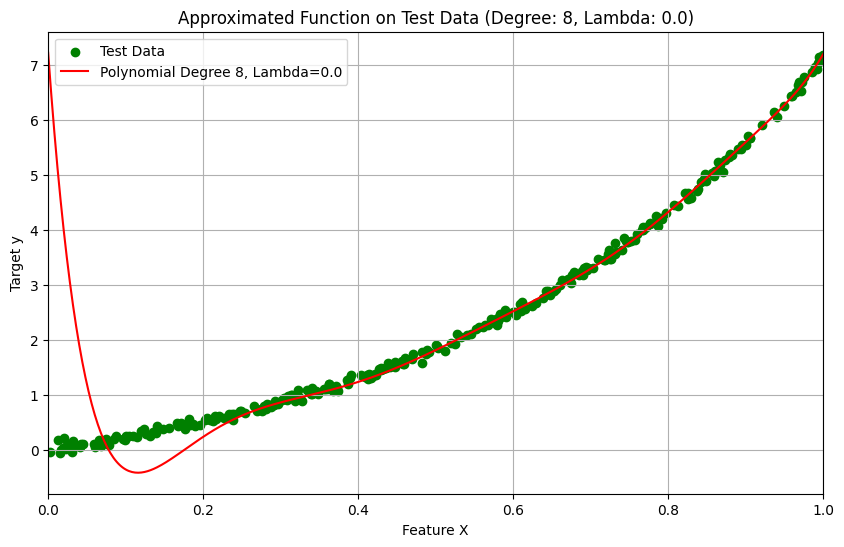


Weights for Subset Size: 10, Degree: 8, Lambda: 0.01
Weight for x^0: 0.020332306510275965
Weight for x^1: 2.0569288893738062
Weight for x^2: 2.0673469840257024
Weight for x^3: 1.4672475882967138
Weight for x^4: 0.9102160727595763
Weight for x^5: 0.5006421015111127
Weight for x^6: 0.2144110810311713
Weight for x^7: 0.014424536176829149
Weight for x^8: -0.1276143694619999


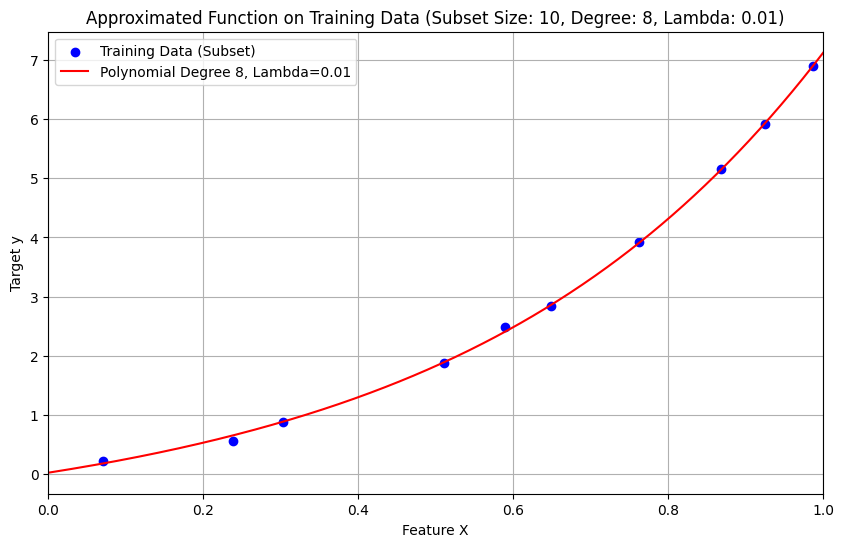

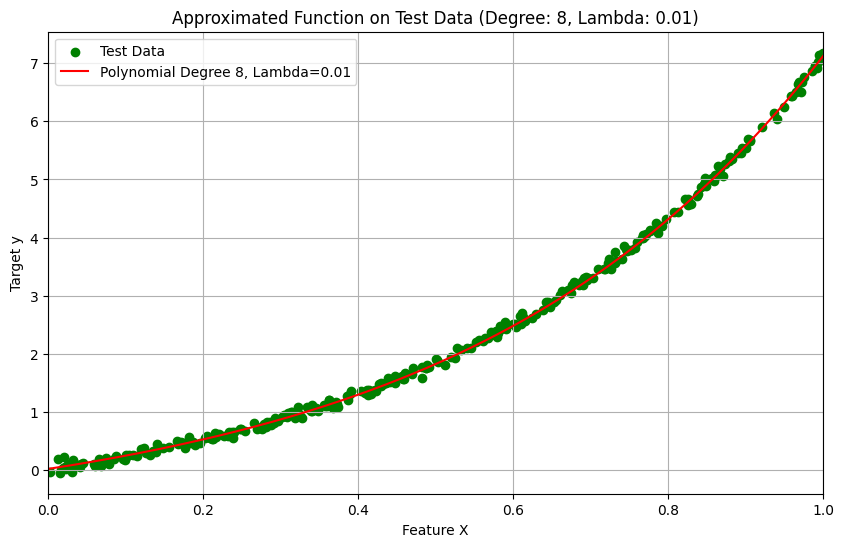


Weights for Subset Size: 10, Degree: 8, Lambda: 0.1
Weight for x^0: 0.16476559534525165
Weight for x^1: 1.9655672480862343
Weight for x^2: 1.7202786194922253
Weight for x^3: 1.273096848471674
Weight for x^4: 0.8891862351478858
Weight for x^5: 0.5924888514242969
Weight for x^6: 0.367040432306784
Weight for x^7: 0.19458608396040566
Weight for x^8: 0.06093433343164028


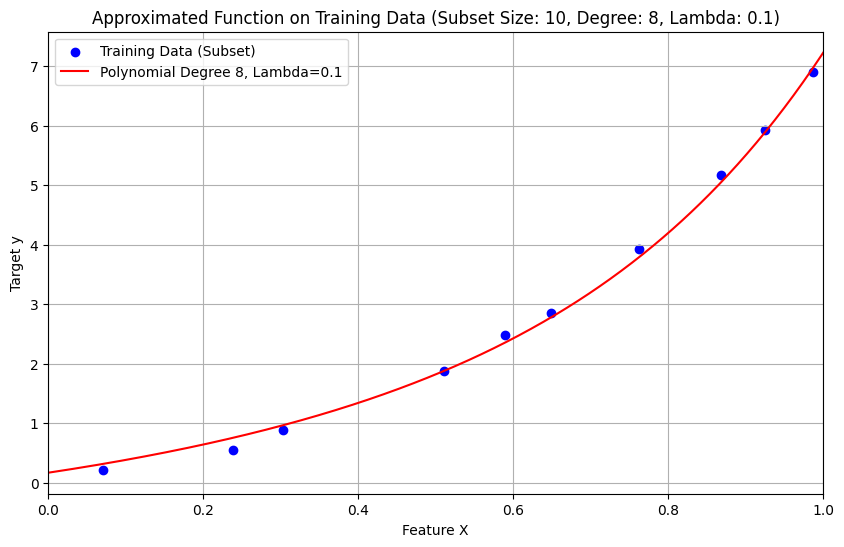

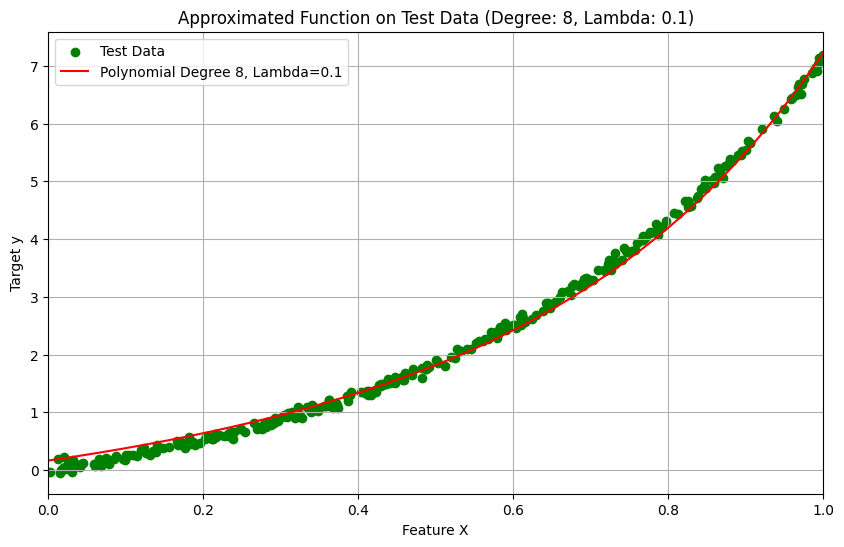


Weights for Subset Size: 10, Degree: 8, Lambda: 0.5
Weight for x^0: 0.49525659348427
Weight for x^1: 1.4949908382456334
Weight for x^2: 1.330739391501972
Weight for x^3: 1.0733016888326132
Weight for x^4: 0.8538823825479751
Weight for x^5: 0.6816644266726491
Weight for x^6: 0.5477438106827909
Weight for x^7: 0.44259289405732427
Weight for x^8: 0.35882764170908066


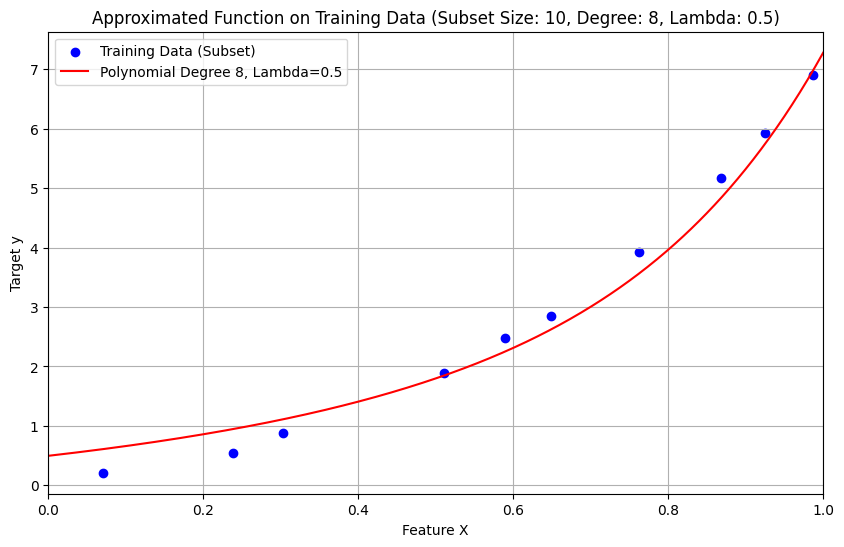

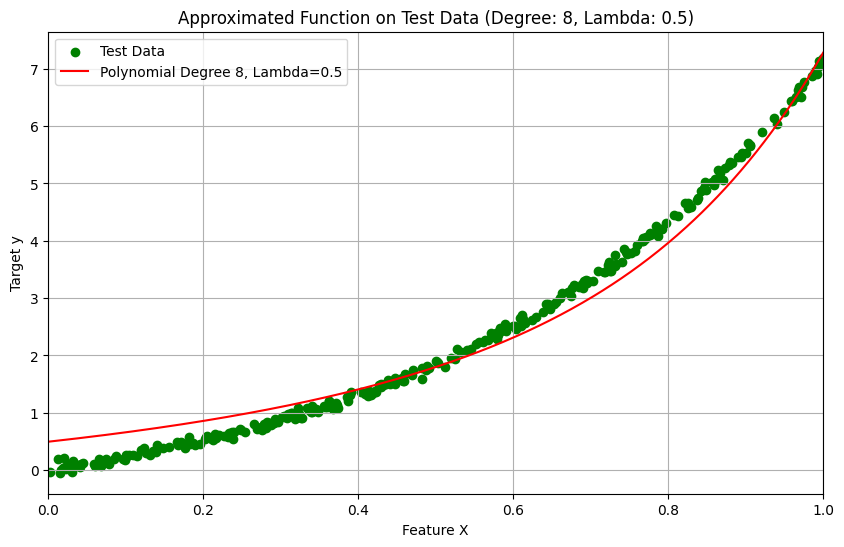


Weights for Subset Size: 10, Degree: 8, Lambda: 1.0
Weight for x^0: 0.6495958625486364
Weight for x^1: 1.2846298797660918
Weight for x^2: 1.1594823614440946
Weight for x^3: 0.9763485834826452
Weight for x^4: 0.8195952747893163
Weight for x^5: 0.6948182479178223
Weight for x^6: 0.5960862776140105
Weight for x^7: 0.5171018660885772
Weight for x^8: 0.4529633313695482


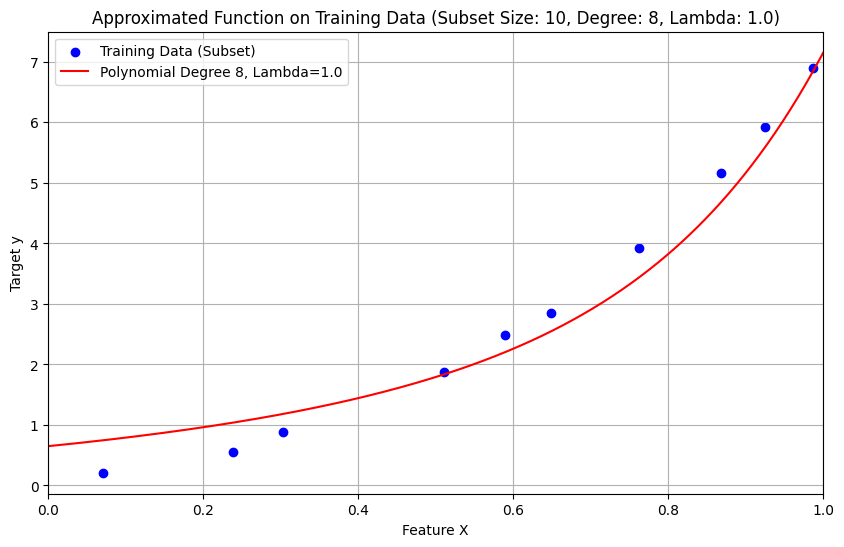

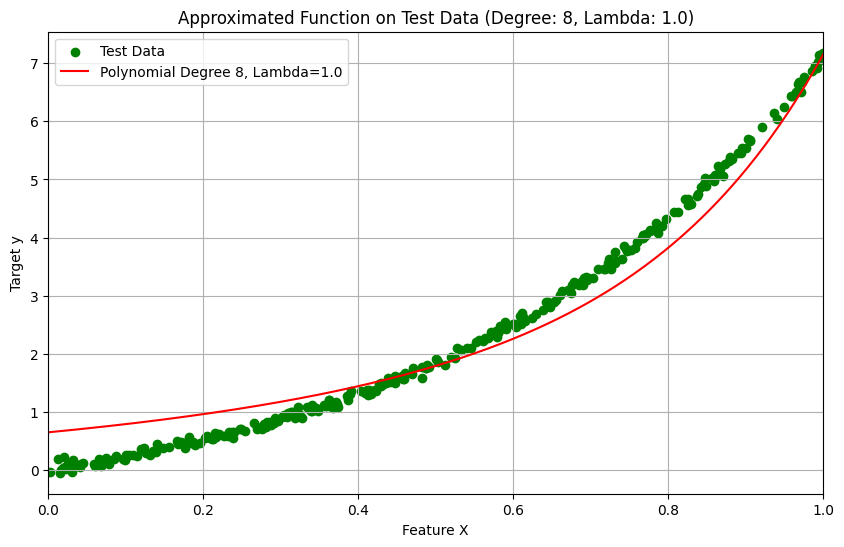


Weights for Subset Size: 10, Degree: 9, Lambda: 0.0
Weight for x^0: 57.17294523953369
Weight for x^1: -1680.6622454149099
Weight for x^2: 18021.05289604607
Weight for x^3: -99487.66610566994
Weight for x^4: 322794.05708325765
Weight for x^5: -650844.4008368069
Weight for x^6: 826301.3859177564
Weight for x^7: -643024.0687539949
Weight for x^8: 280318.635735046
Weight for x^9: -52448.4950276136


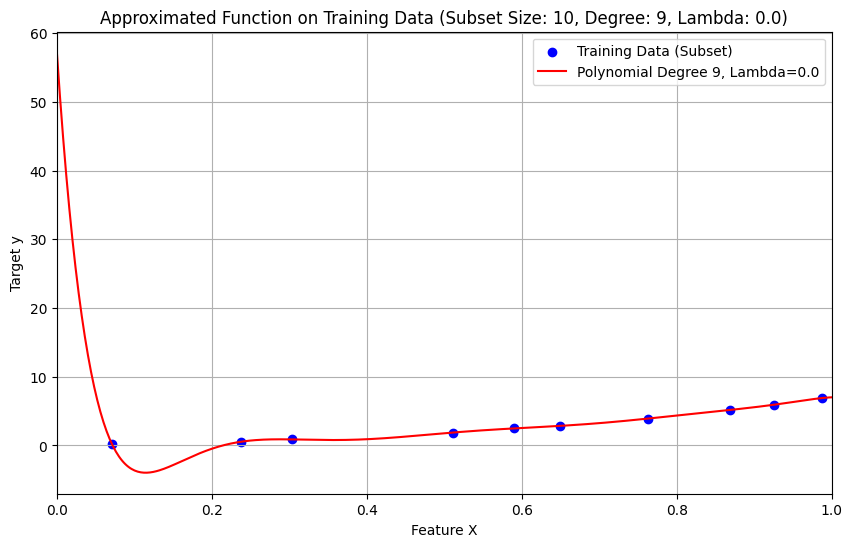

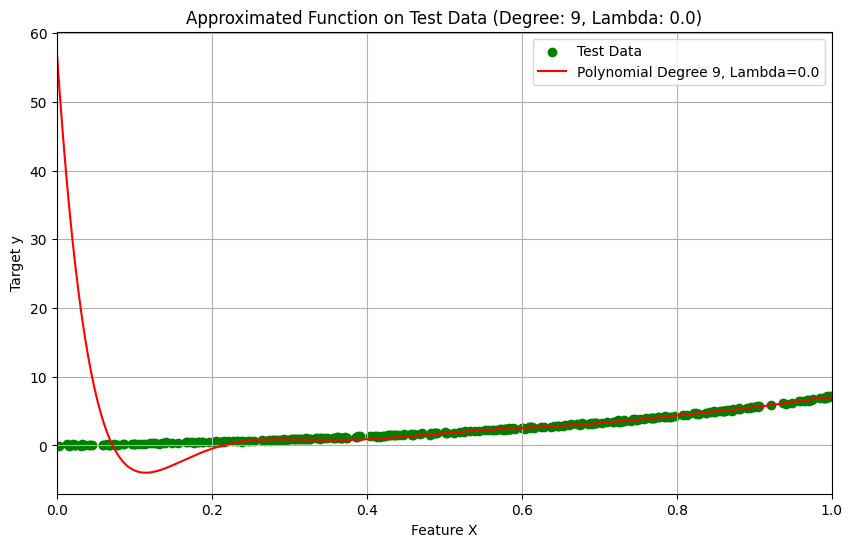


Weights for Subset Size: 10, Degree: 9, Lambda: 0.01
Weight for x^0: 0.020377325778866216
Weight for x^1: 2.0633779773665393
Weight for x^2: 2.054010867273521
Weight for x^3: 1.451154303603312
Weight for x^4: 0.9044247909997046
Weight for x^5: 0.5120316364612855
Weight for x^6: 0.24570779285937272
Weight for x^7: 0.06596278387806226
Weight for x^8: -0.05676429890144379
Weight for x^9: -0.14196243370279496


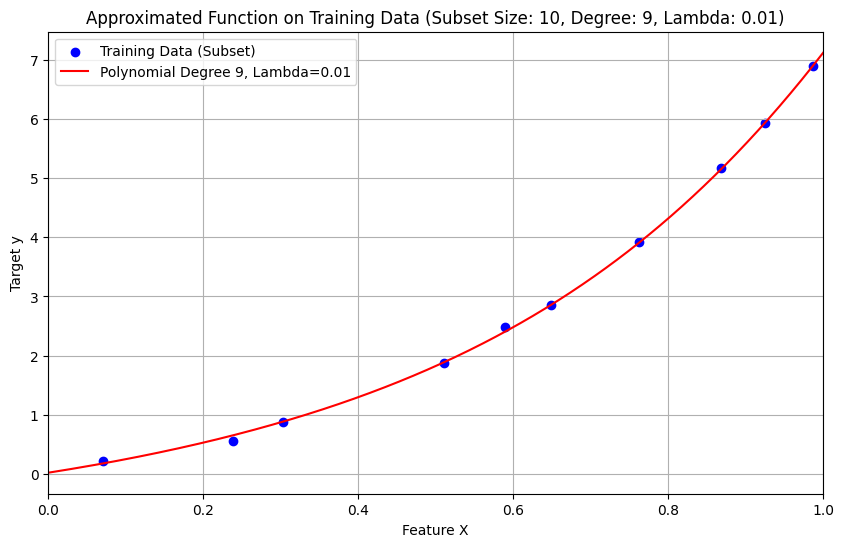

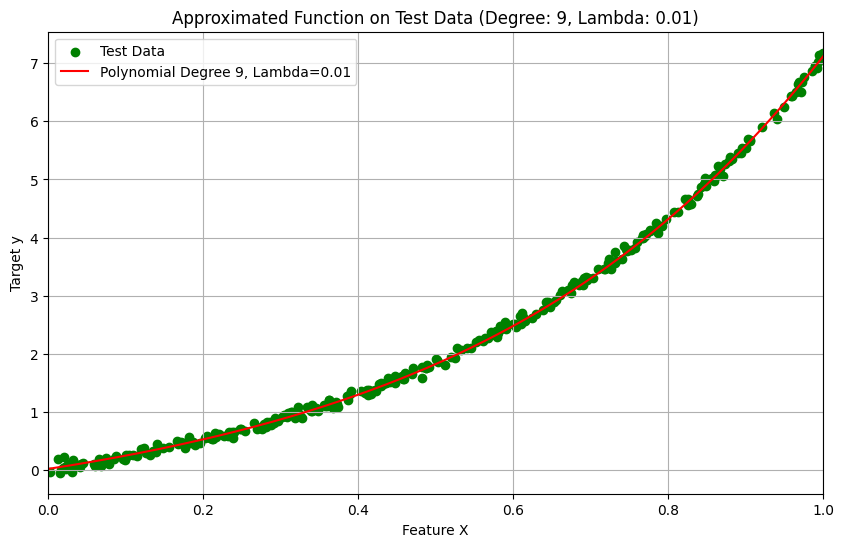


Weights for Subset Size: 10, Degree: 9, Lambda: 0.1
Weight for x^0: 0.1650645035693392
Weight for x^1: 1.963284253185727
Weight for x^2: 1.7189515635839085
Weight for x^3: 1.2738454337121687
Weight for x^4: 0.8921499854183373
Weight for x^5: 0.5974914536935609
Weight for x^6: 0.3738221396495717
Weight for x^7: 0.202883649111798
Weight for x^8: 0.07050764773417587
Weight for x^9: -0.03343608566251223


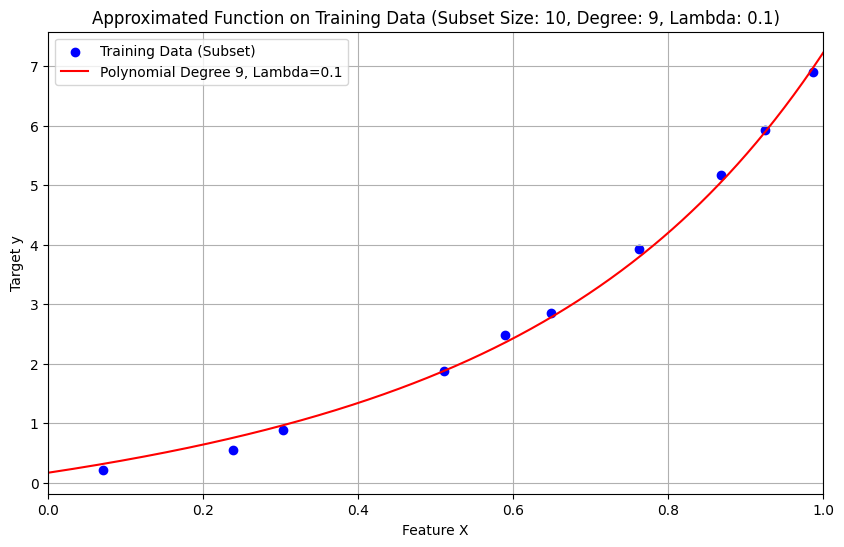

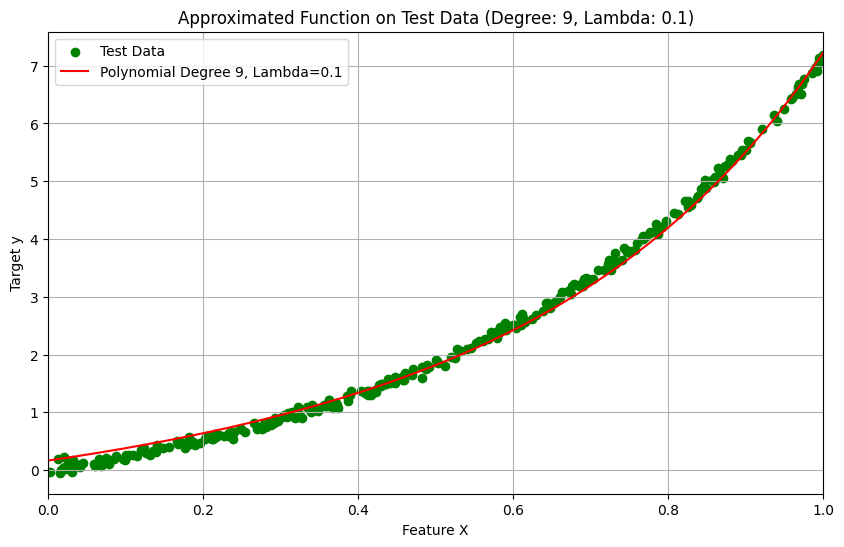


Weights for Subset Size: 10, Degree: 9, Lambda: 0.5
Weight for x^0: 0.5000097145951866
Weight for x^1: 1.5001843584956451
Weight for x^2: 1.3237263734570097
Weight for x^3: 1.055296394309912
Weight for x^4: 0.8273351744853091
Weight for x^5: 0.6486722659338907
Weight for x^6: 0.5099118159021265
Weight for x^7: 0.4011227256113528
Weight for x^8: 0.3146208012002733
Weight for x^9: 0.24485219336338496


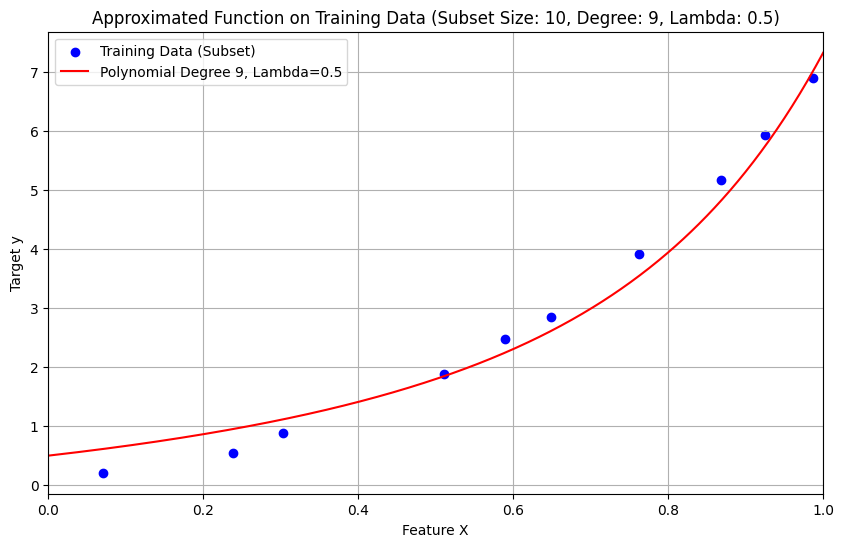

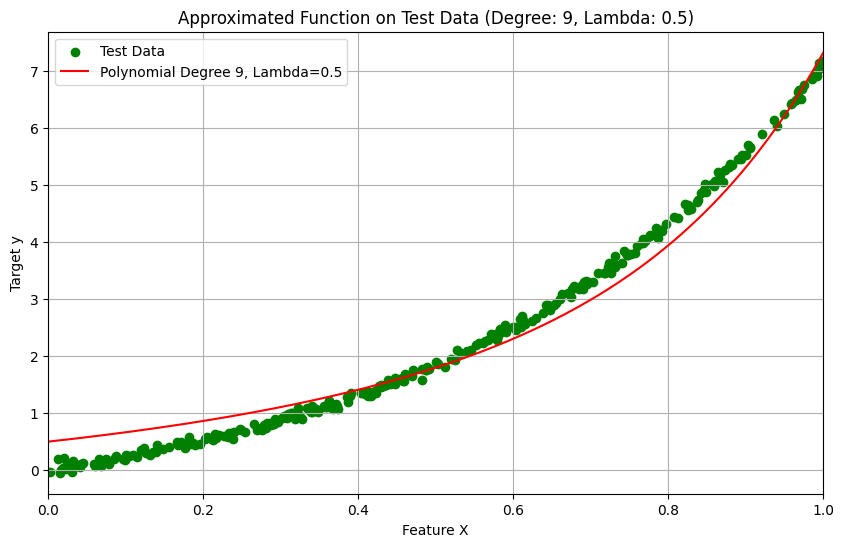


Weights for Subset Size: 10, Degree: 9, Lambda: 1.0
Weight for x^0: 0.6575938862279235
Weight for x^1: 1.2815861015980308
Weight for x^2: 1.141943666873752
Weight for x^3: 0.9479145225513904
Weight for x^4: 0.7834465046876791
Weight for x^5: 0.653253252302671
Weight for x^6: 0.5507193316440793
Weight for x^7: 0.46907116273099736
Weight for x^8: 0.40308196689629616
Weight for x^9: 0.3489608608193672


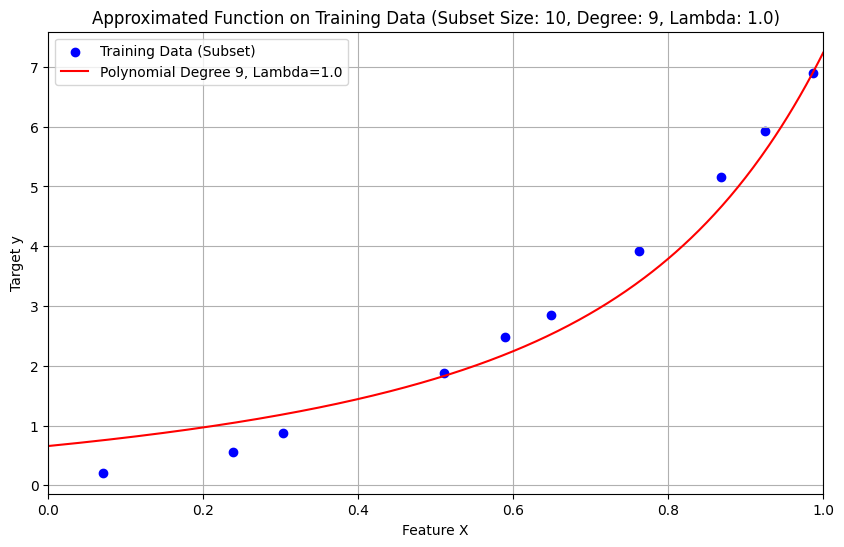

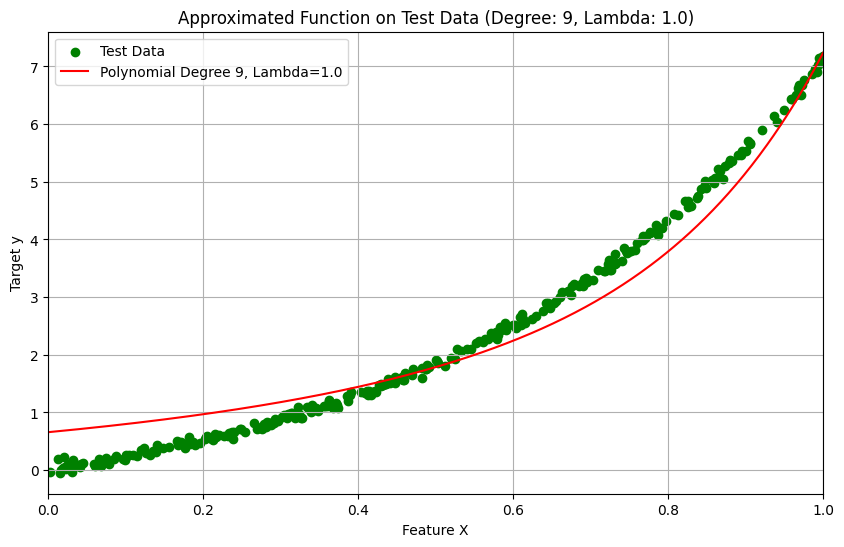


Weights for Subset Size: 50, Degree: 2, Lambda: 0.0
Weight for x^0: 0.23645890974003364
Weight for x^1: -0.3114030396641199
Weight for x^2: 6.962861639280532


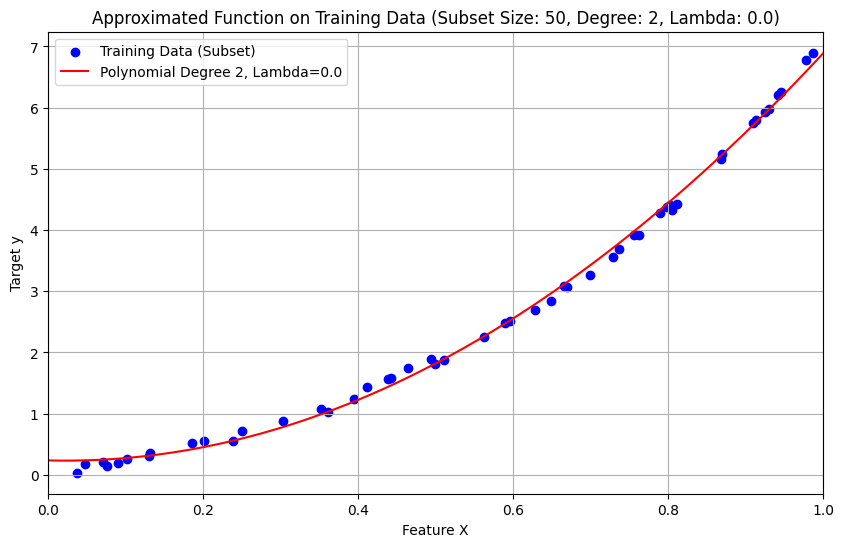

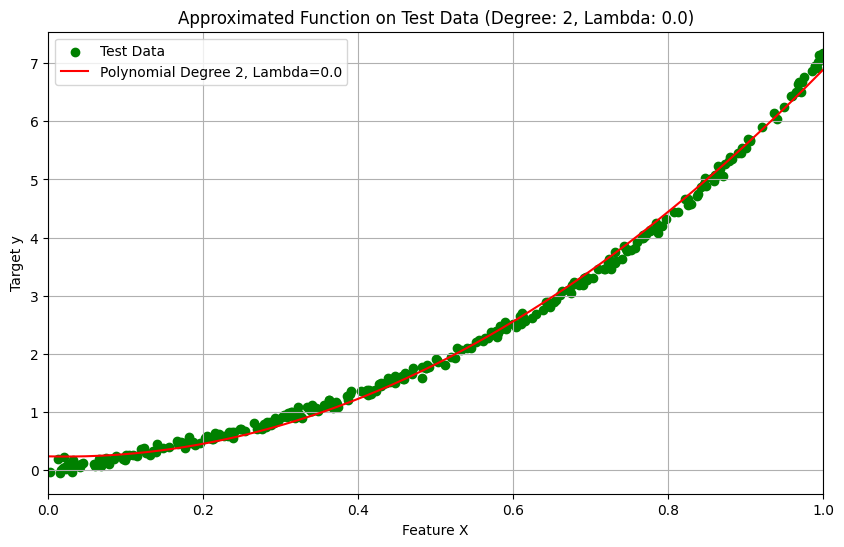


Weights for Subset Size: 50, Degree: 2, Lambda: 0.01
Weight for x^0: 0.19337815311324727
Weight for x^1: -0.057231513693055416
Weight for x^2: 6.714742211450086


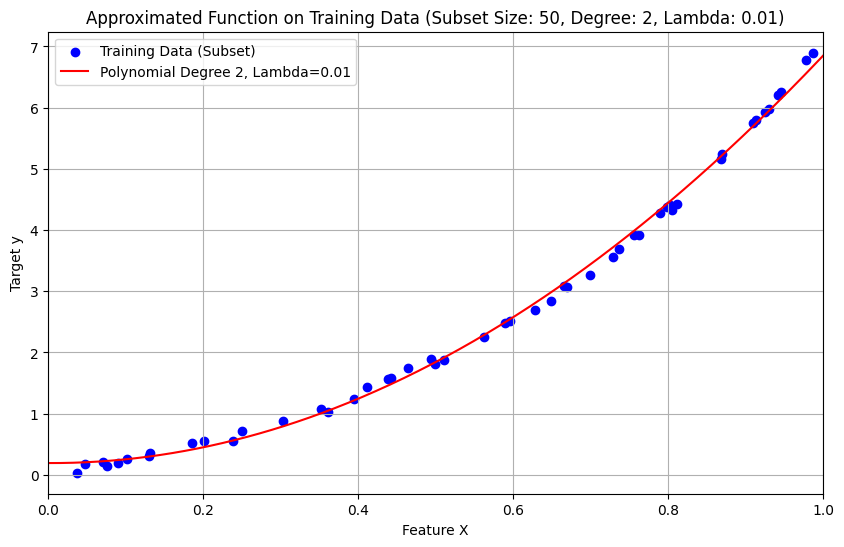

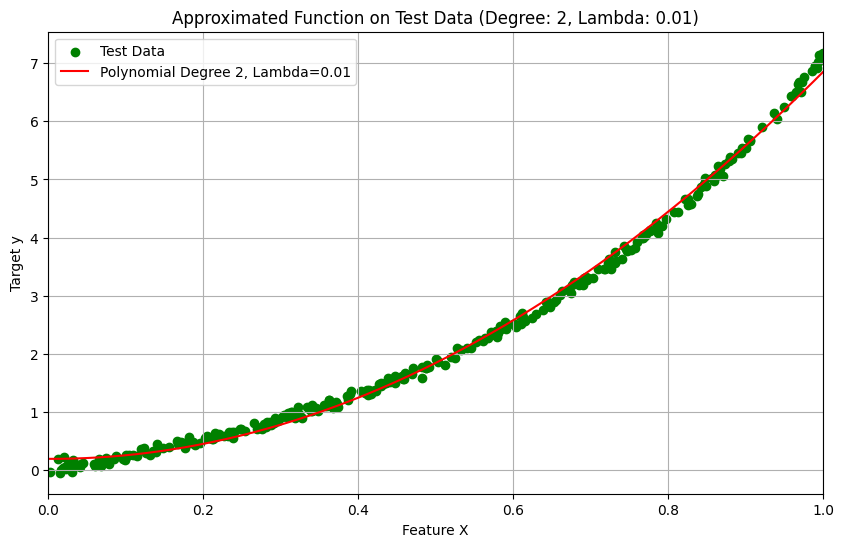


Weights for Subset Size: 50, Degree: 2, Lambda: 0.1
Weight for x^0: -0.011459188190888814
Weight for x^1: 1.2212512592347429
Weight for x^2: 5.437019791663262


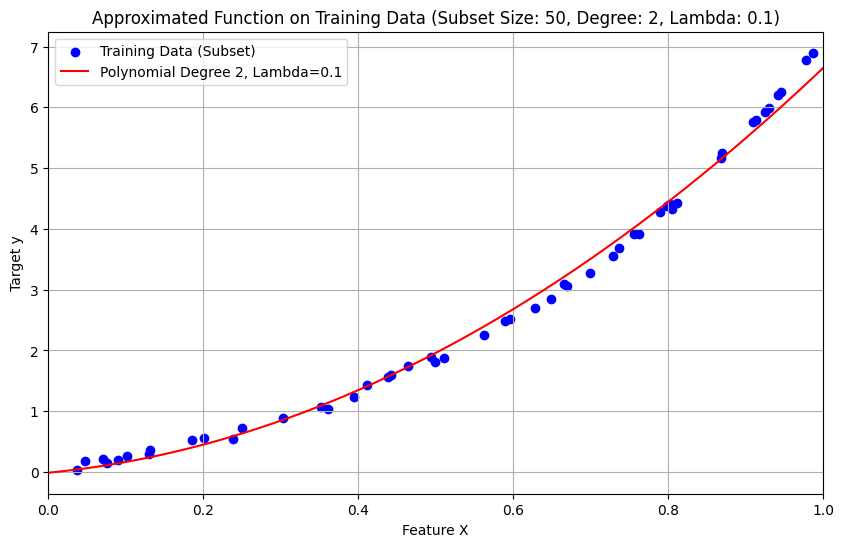

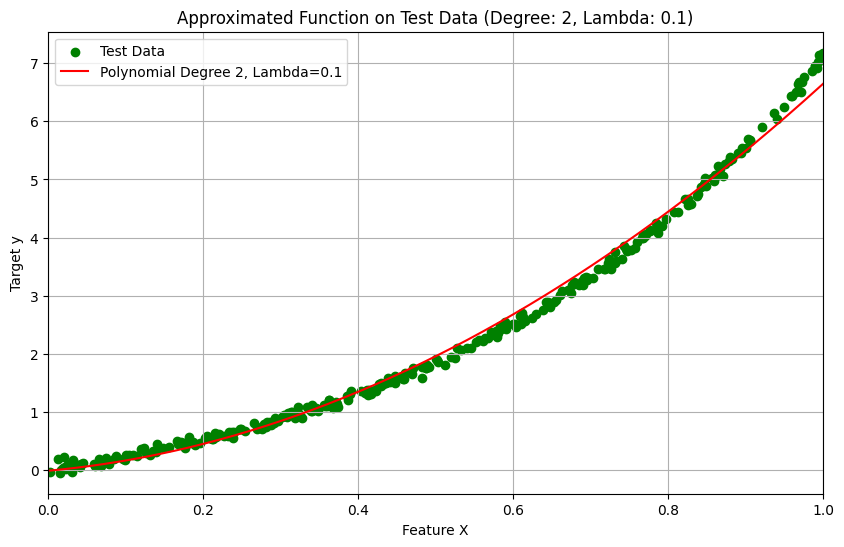


Weights for Subset Size: 50, Degree: 2, Lambda: 0.5
Weight for x^0: -0.11045696276802756
Weight for x^1: 2.3842550941740974
Weight for x^2: 4.053907263790008


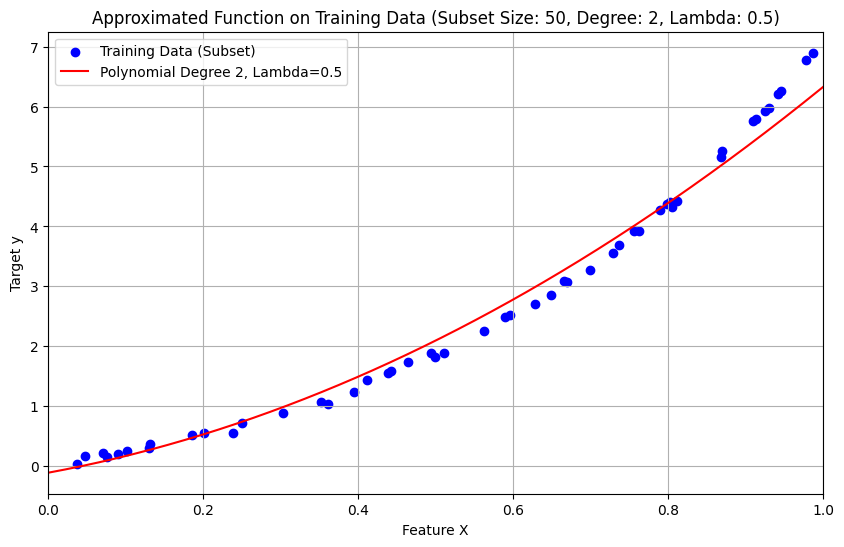

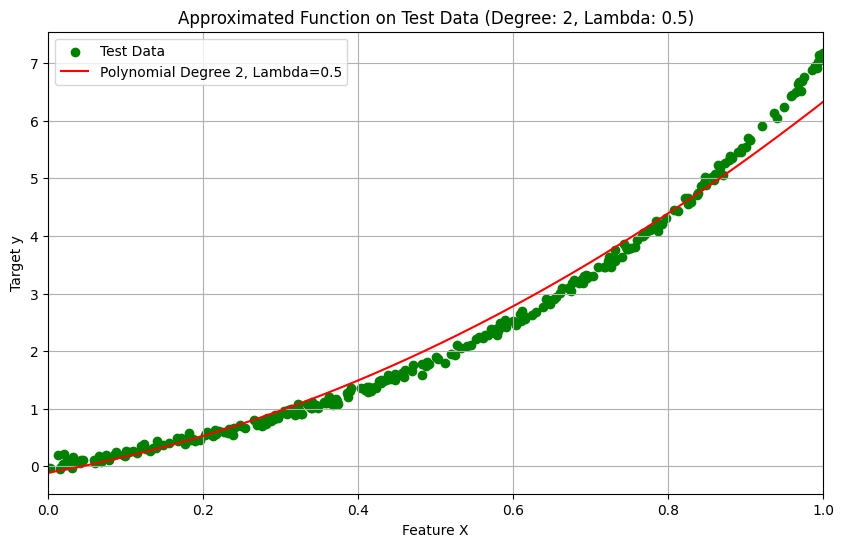


Weights for Subset Size: 50, Degree: 2, Lambda: 1.0
Weight for x^0: -0.0235463540426706
Weight for x^1: 2.571429541549156
Weight for x^2: 3.5661518398307206


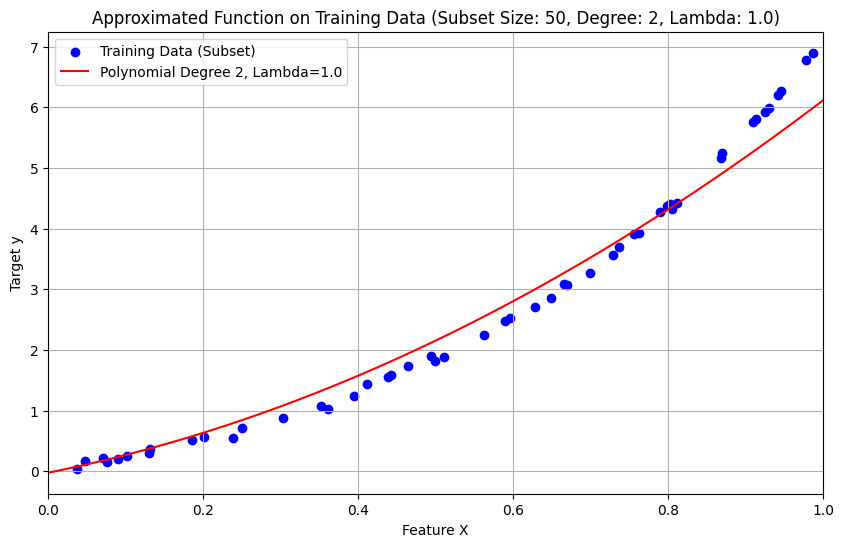

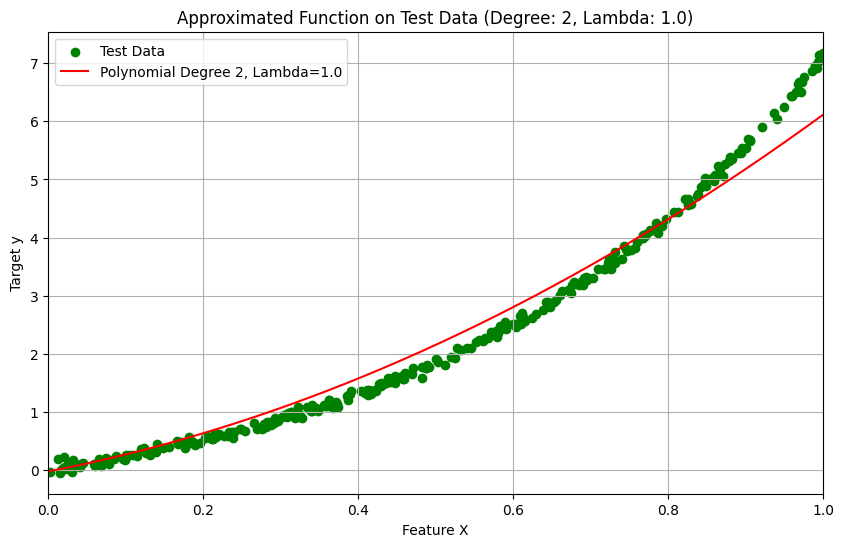


Weights for Subset Size: 50, Degree: 3, Lambda: 0.0
Weight for x^0: -0.028728908782697432
Weight for x^1: 2.7599443792730054
Weight for x^2: -0.4020174310774106
Weight for x^3: 4.764895462343731


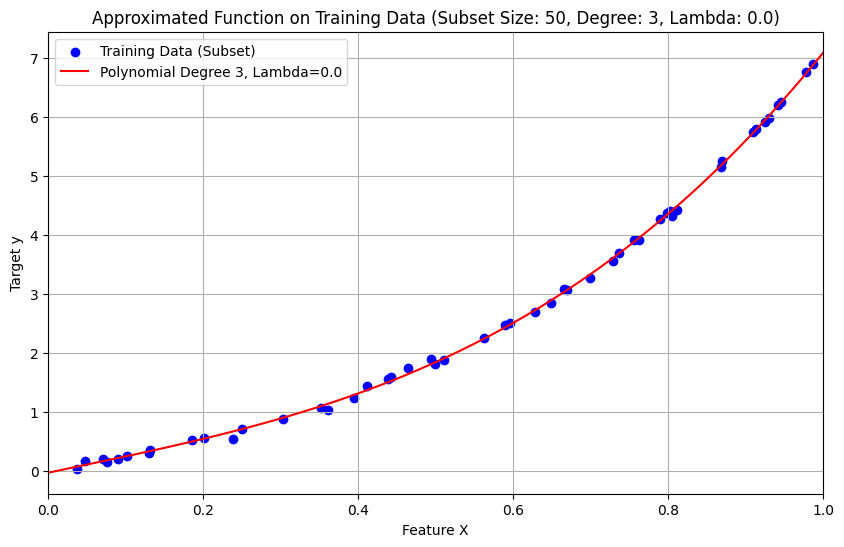

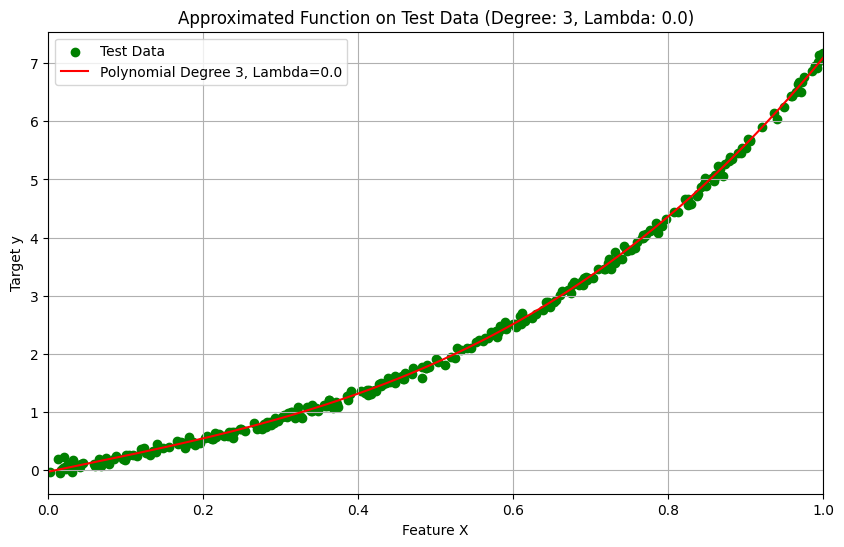


Weights for Subset Size: 50, Degree: 3, Lambda: 0.01
Weight for x^0: 0.049780236284529426
Weight for x^1: 1.8817613738716863
Weight for x^2: 1.681178603045521
Weight for x^3: 3.4226621689800774


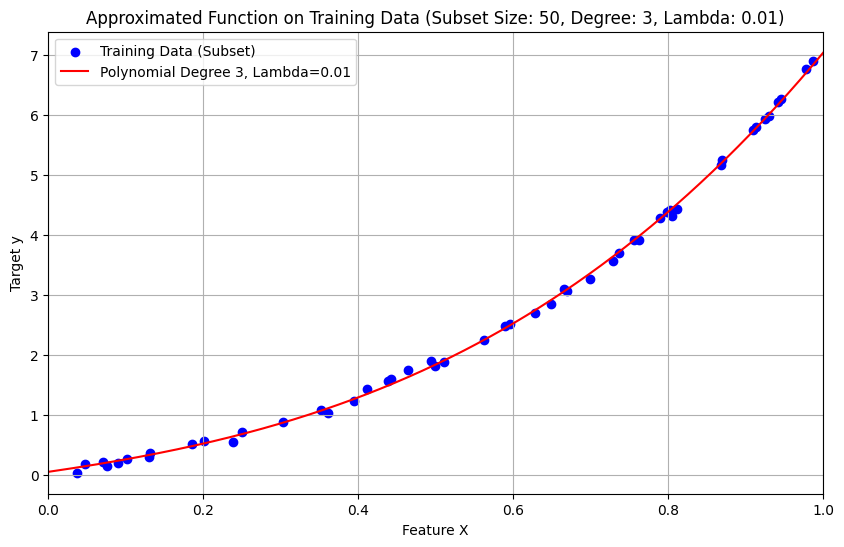

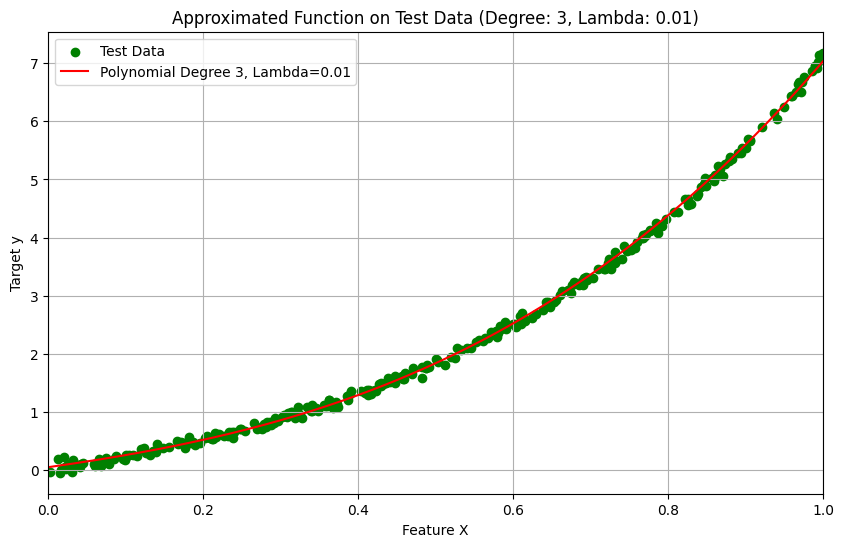


Weights for Subset Size: 50, Degree: 3, Lambda: 0.1
Weight for x^0: 0.06075536783875151
Weight for x^1: 1.7083080066178045
Weight for x^2: 2.355276138464917
Weight for x^3: 2.8351593685674334


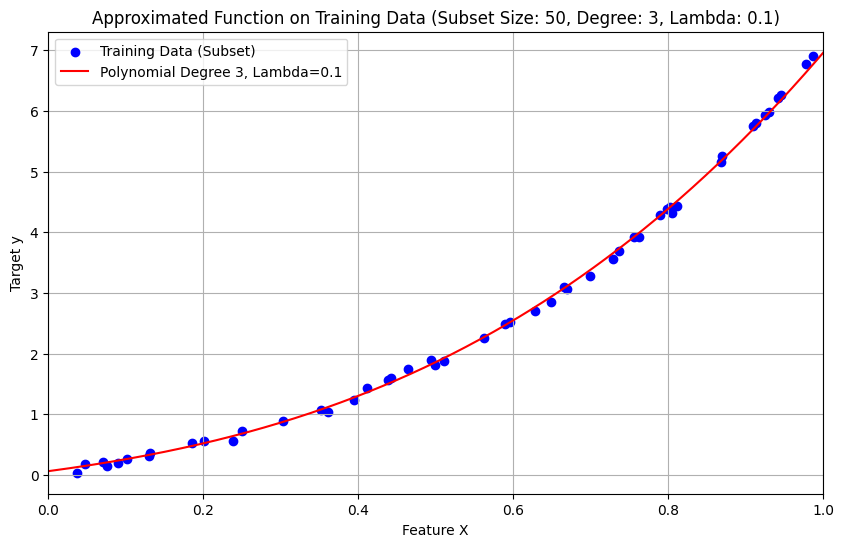

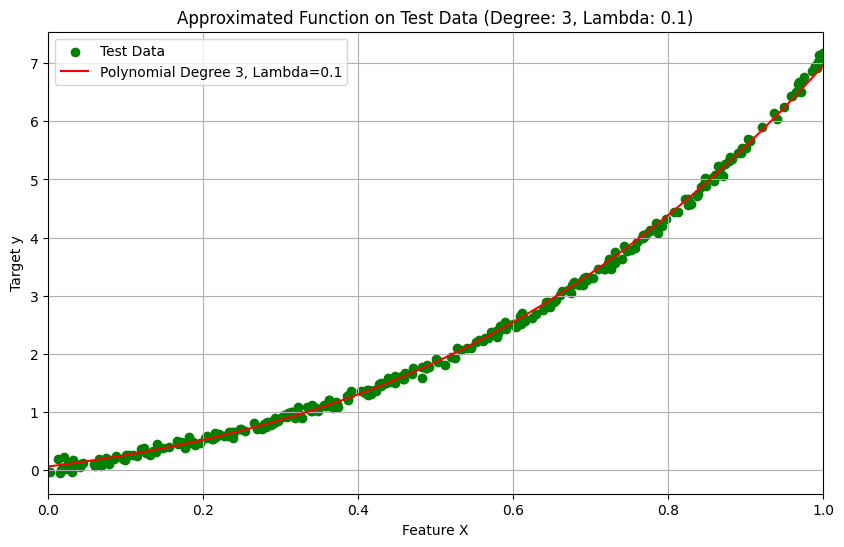


Weights for Subset Size: 50, Degree: 3, Lambda: 0.5
Weight for x^0: 0.07784374297483102
Weight for x^1: 1.8813081243199619
Weight for x^2: 2.342124431560269
Weight for x^3: 2.4810254633358735


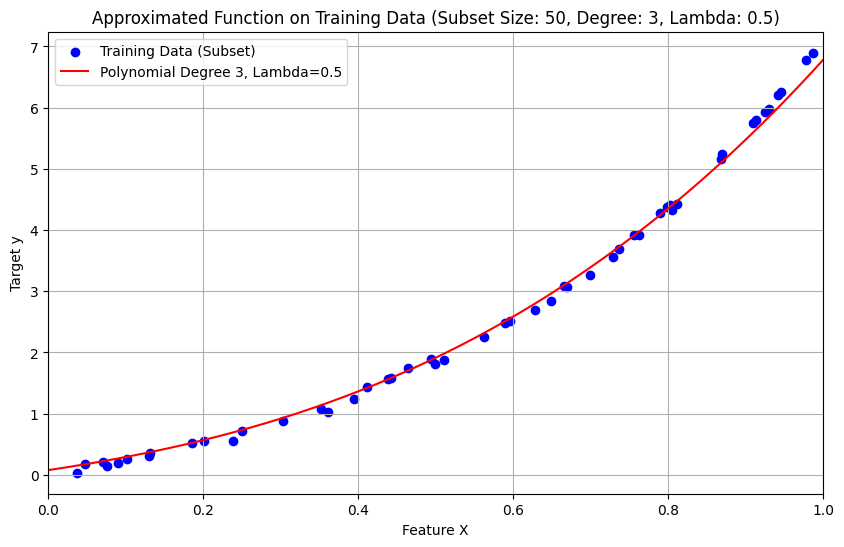

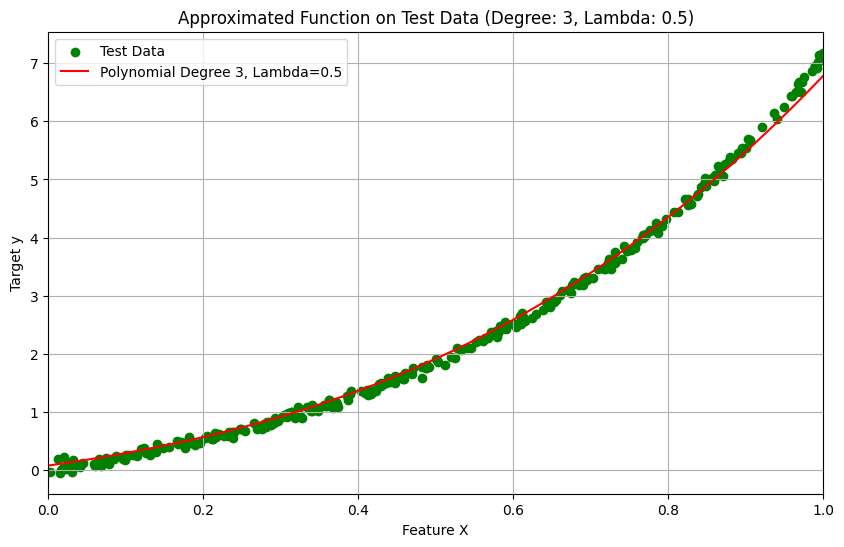


Weights for Subset Size: 50, Degree: 3, Lambda: 1.0
Weight for x^0: 0.14001087855854877
Weight for x^1: 1.9243512396776776
Weight for x^2: 2.2599822455376555
Weight for x^3: 2.297937463381017


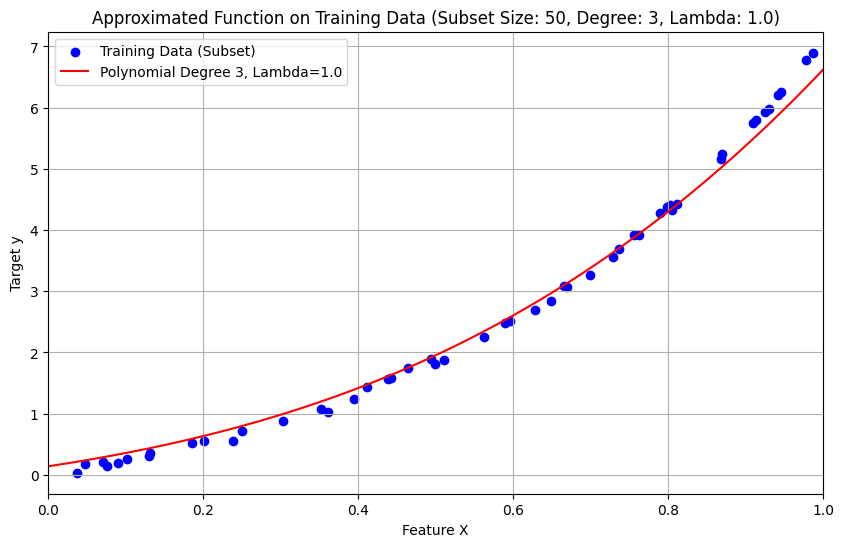

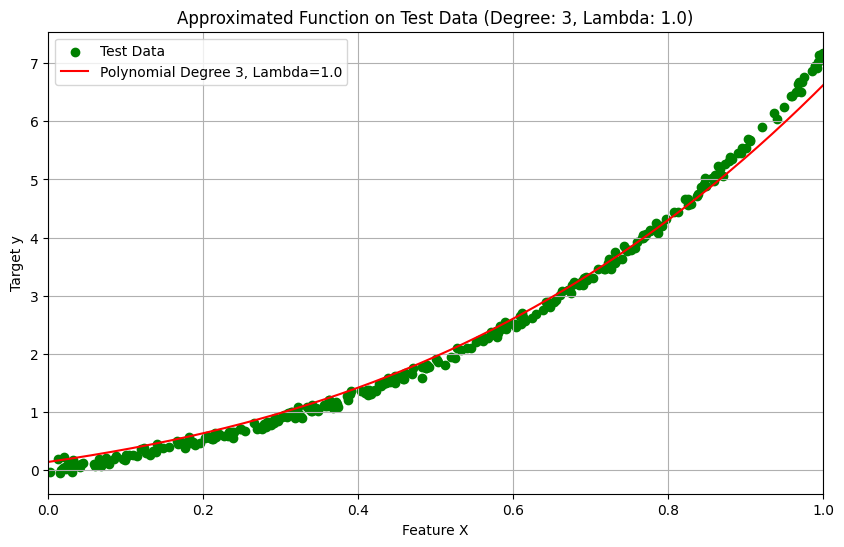


Weights for Subset Size: 50, Degree: 4, Lambda: 0.0
Weight for x^0: 0.03370572044657934
Weight for x^1: 1.6968409557759239
Weight for x^2: 3.981652391761167
Weight for x^3: -1.6829939022804012
Weight for x^4: 3.1018984649516876


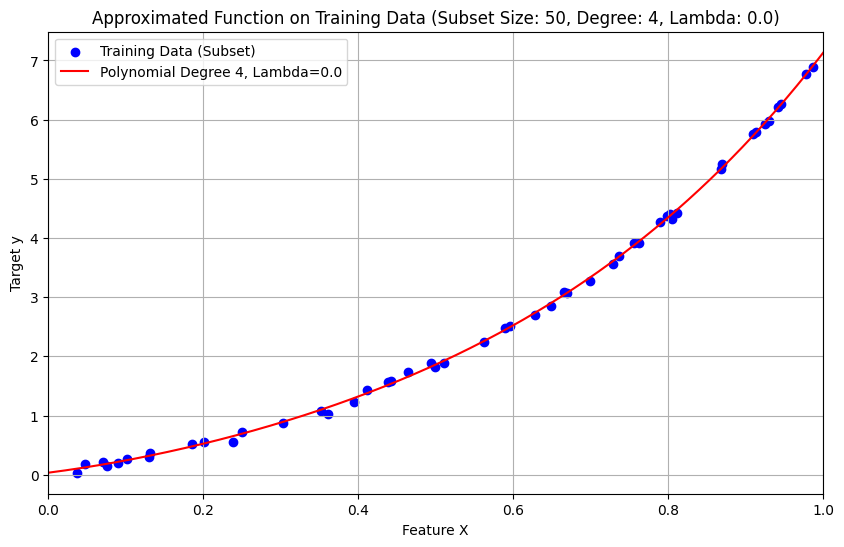

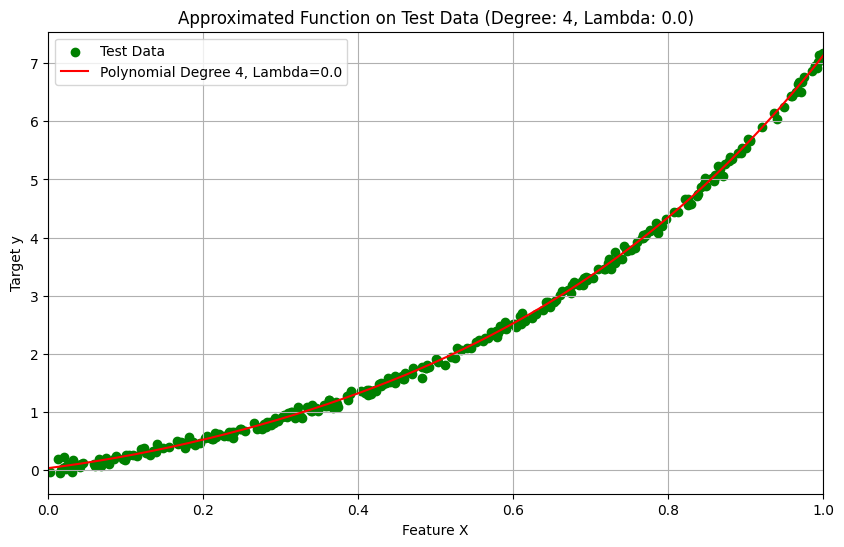


Weights for Subset Size: 50, Degree: 4, Lambda: 0.01
Weight for x^0: 0.010569121607059345
Weight for x^1: 2.179560973150897
Weight for x^2: 1.850312926004033
Weight for x^3: 1.5593155094589894
Weight for x^4: 1.5092050308905454


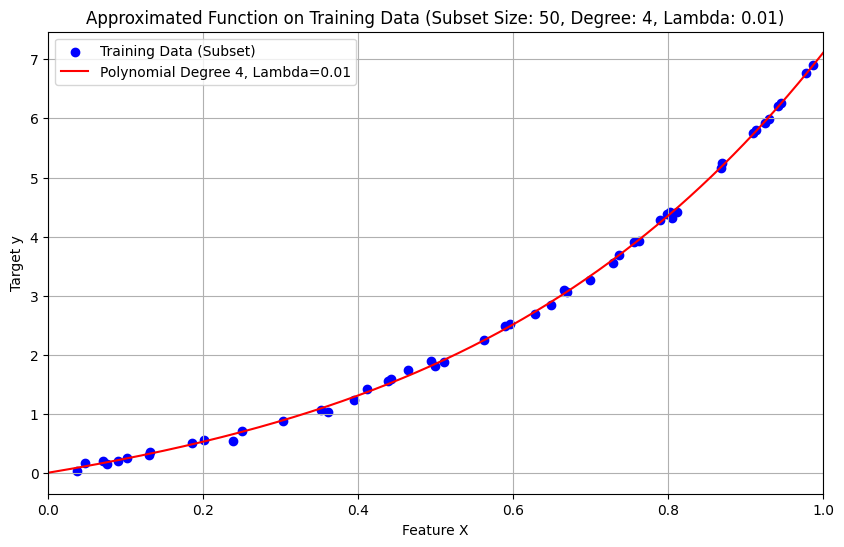

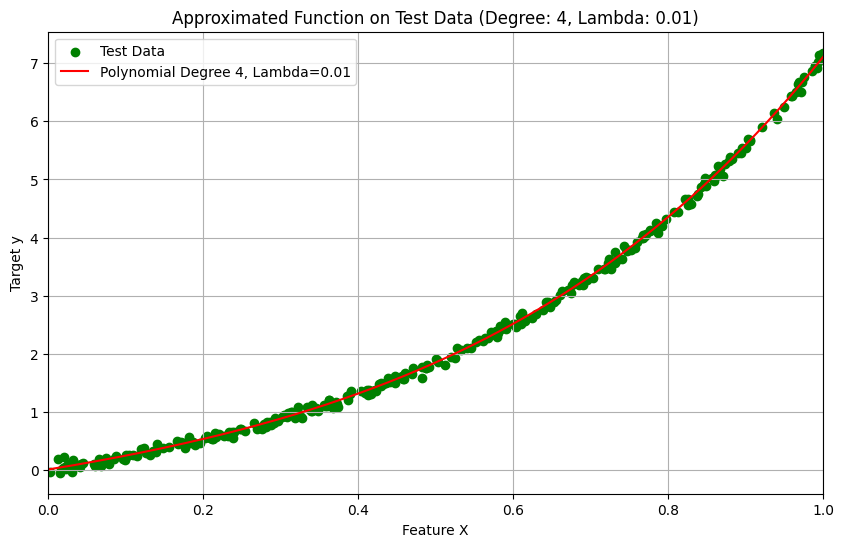


Weights for Subset Size: 50, Degree: 4, Lambda: 0.1
Weight for x^0: 0.04545550427142933
Weight for x^1: 2.0619631697326115
Weight for x^2: 1.9075862242906412
Weight for x^3: 1.6422074770425301
Weight for x^4: 1.4377841870914831


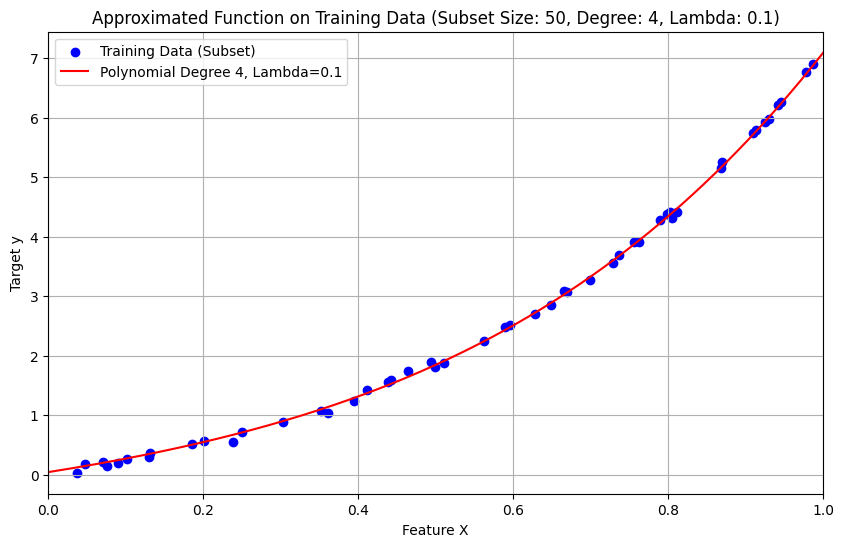

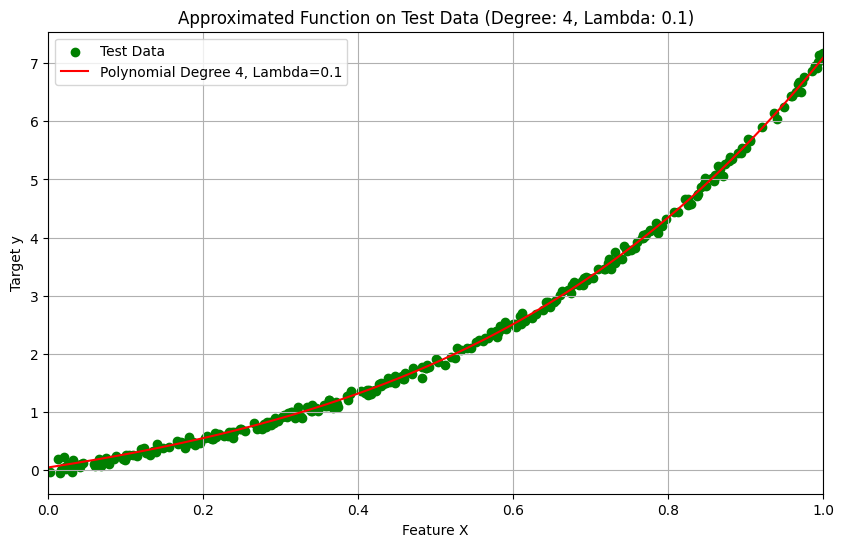


Weights for Subset Size: 50, Degree: 4, Lambda: 0.5
Weight for x^0: 0.13658151532505647
Weight for x^1: 1.90237081483746
Weight for x^2: 1.8611687065171085
Weight for x^3: 1.659515449117848
Weight for x^4: 1.4714051054689694


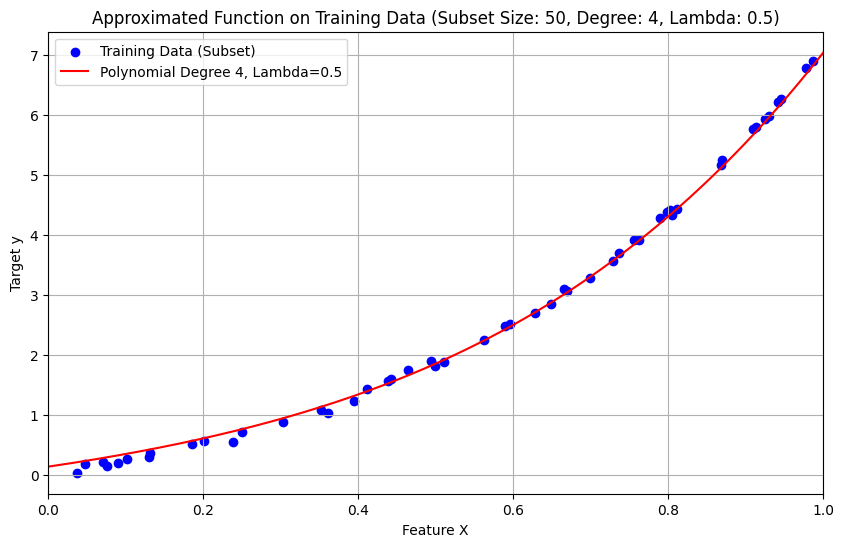

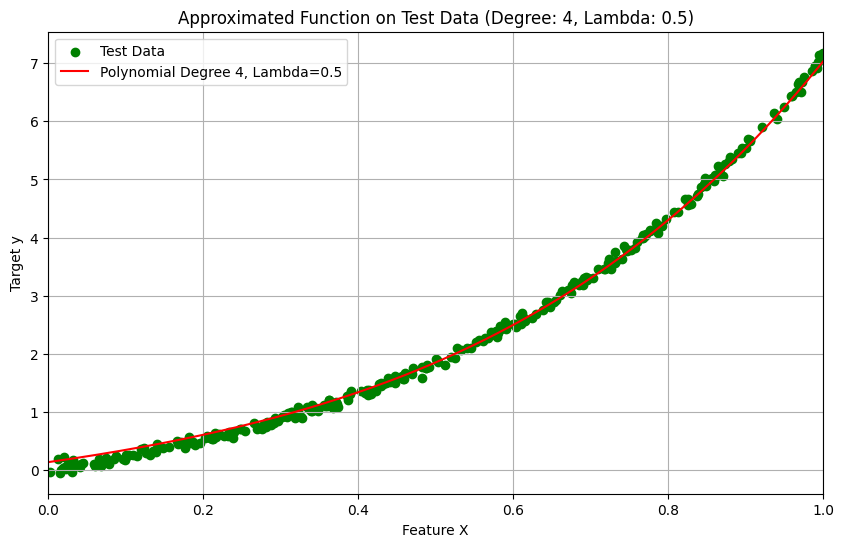


Weights for Subset Size: 50, Degree: 4, Lambda: 1.0
Weight for x^0: 0.21638238818523886
Weight for x^1: 1.8051886066788239
Weight for x^2: 1.8038791835172183
Weight for x^3: 1.637692403007506
Weight for x^4: 1.4706997807972437


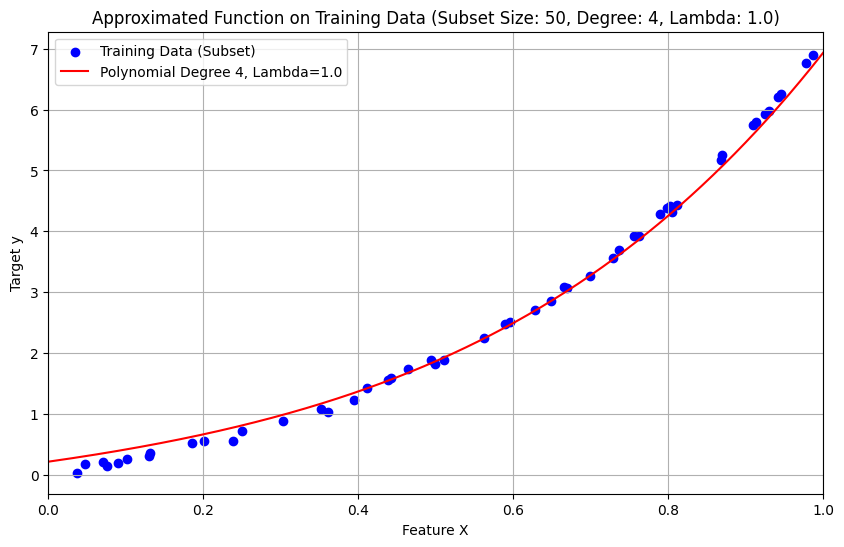

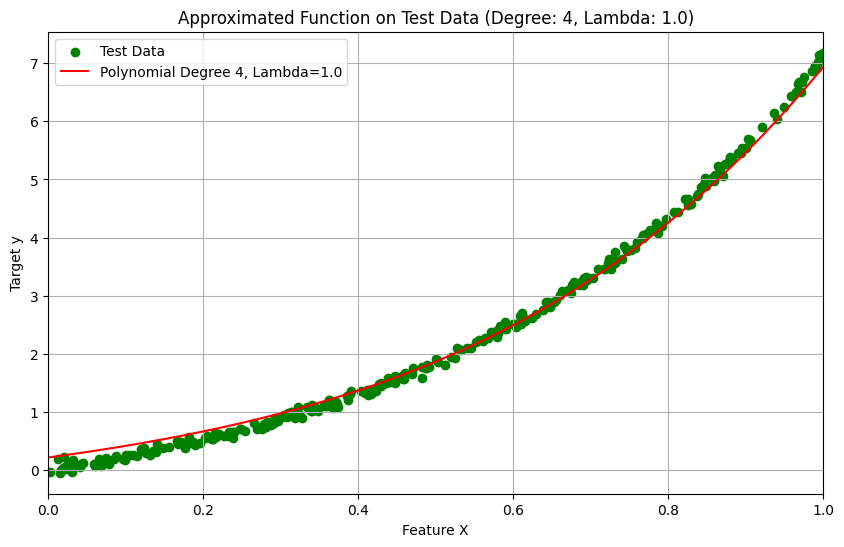


Weights for Subset Size: 50, Degree: 5, Lambda: 0.0
Weight for x^0: 0.034402204224444406
Weight for x^1: 1.6810539736413
Weight for x^2: 4.080785942490998
Weight for x^3: -1.9323624003393807
Weight for x^4: 3.372406350666736
Weight for x^5: -0.10557566943474954


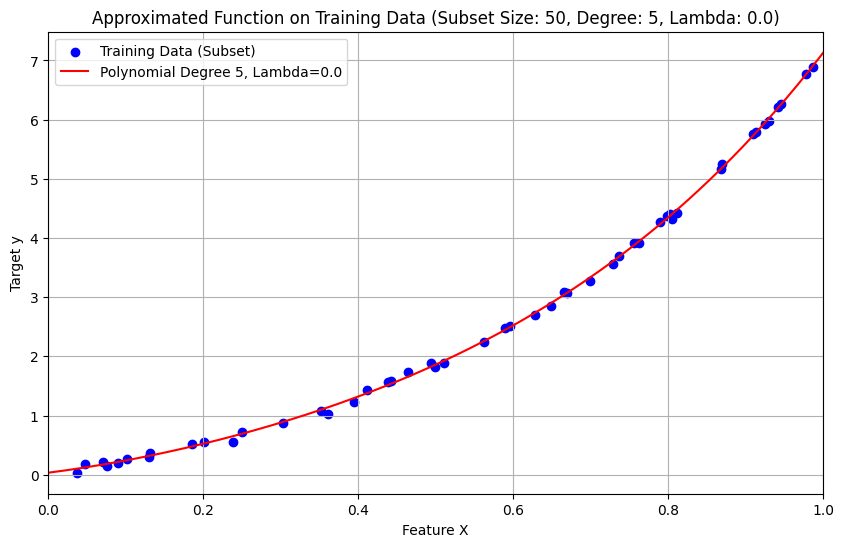

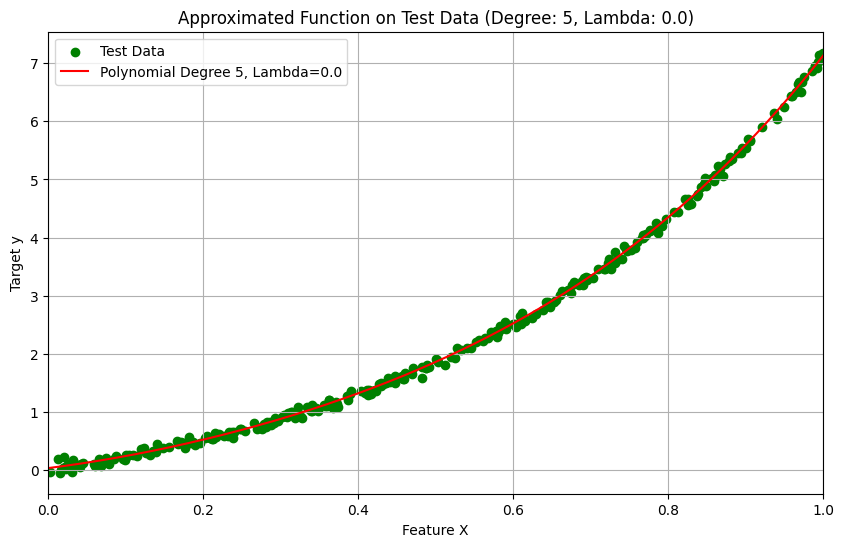


Weights for Subset Size: 50, Degree: 5, Lambda: 0.01
Weight for x^0: 0.006495280409690561
Weight for x^1: 2.1706779130017257
Weight for x^2: 2.0443426704756233
Weight for x^3: 1.443349714472668
Weight for x^4: 0.921941831804904
Weight for x^5: 0.5447646554809517


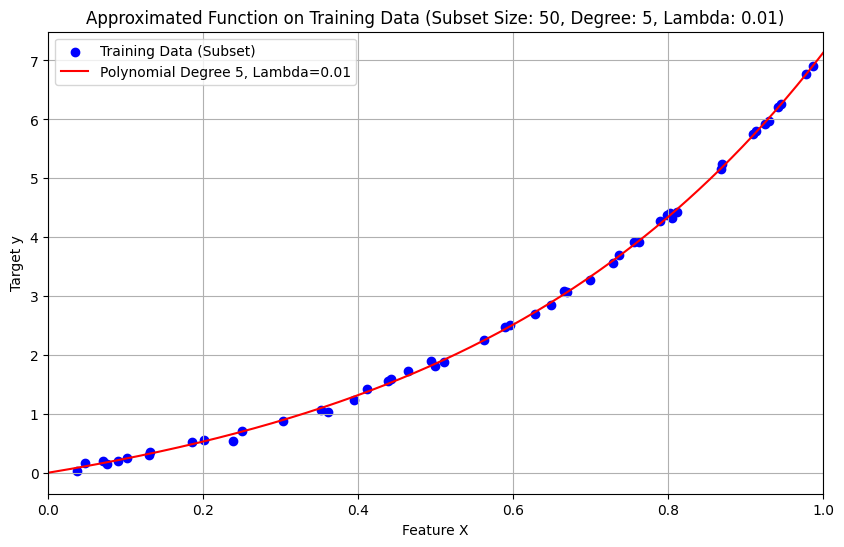

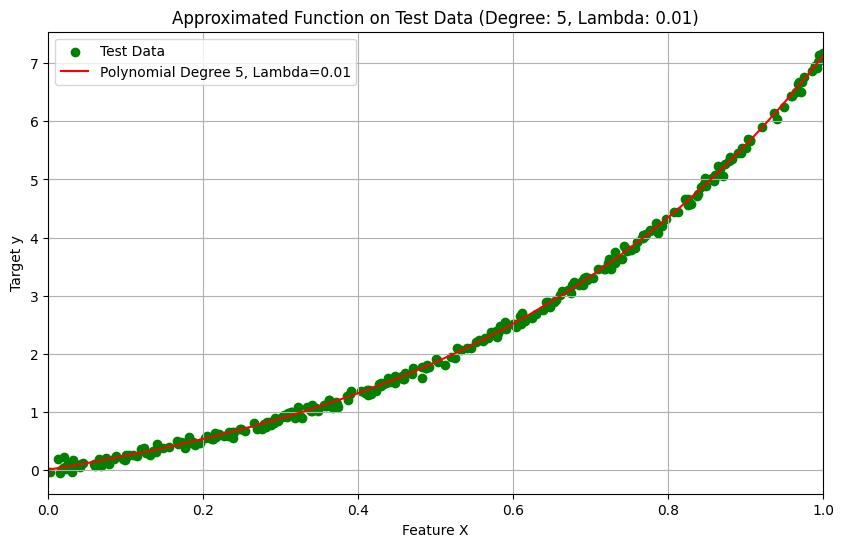


Weights for Subset Size: 50, Degree: 5, Lambda: 0.1
Weight for x^0: 0.032948636786500826
Weight for x^1: 2.1893599383716027
Weight for x^2: 1.8782483490439945
Weight for x^3: 1.3889580025231933
Weight for x^4: 0.985694748203517
Weight for x^5: 0.6809361130883301


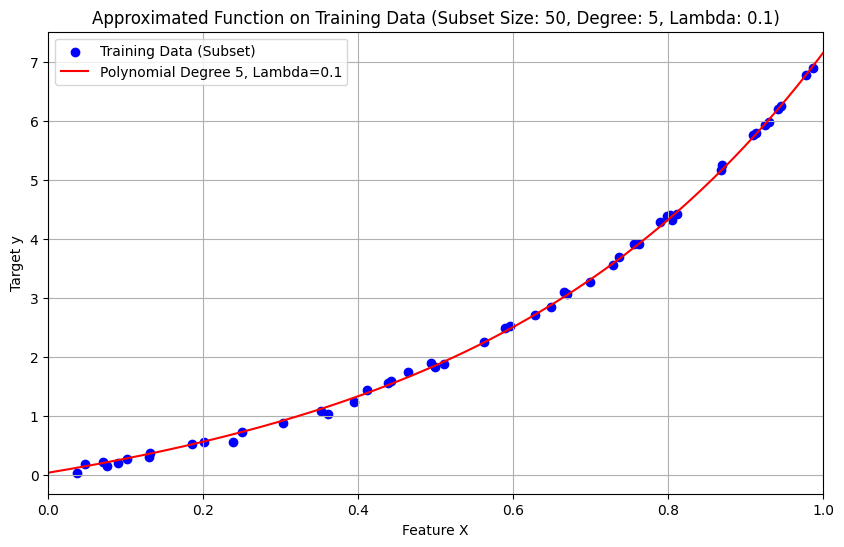

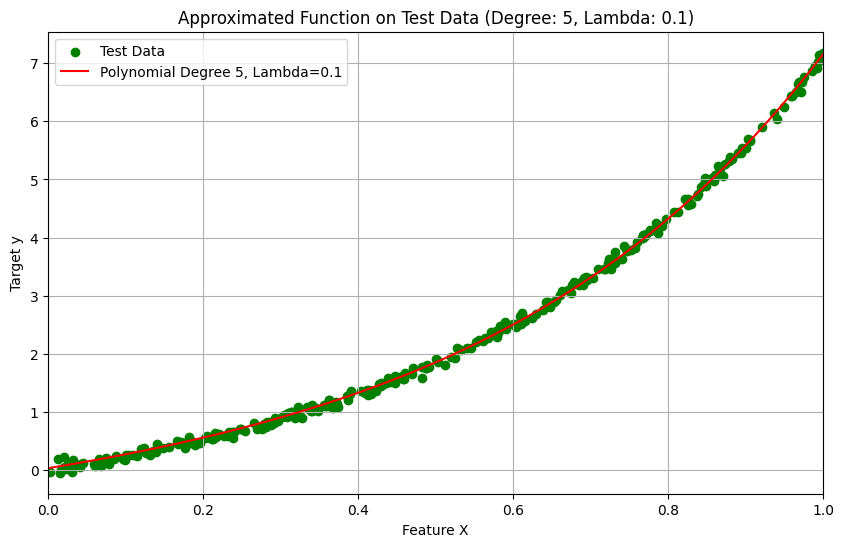


Weights for Subset Size: 50, Degree: 5, Lambda: 0.5
Weight for x^0: 0.1520227420016706
Weight for x^1: 1.9707304926103373
Weight for x^2: 1.733462388285544
Weight for x^3: 1.3752715074128277
Weight for x^4: 1.081068443932366
Weight for x^5: 0.8554625366520473


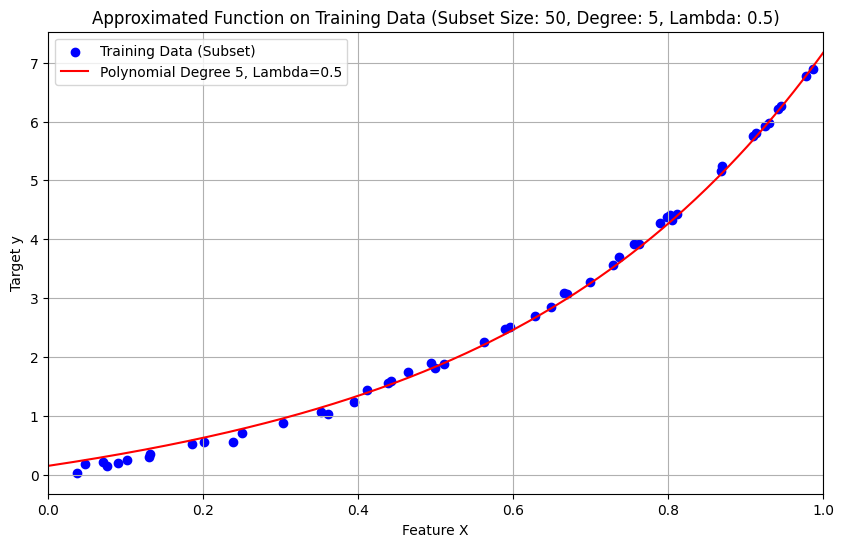

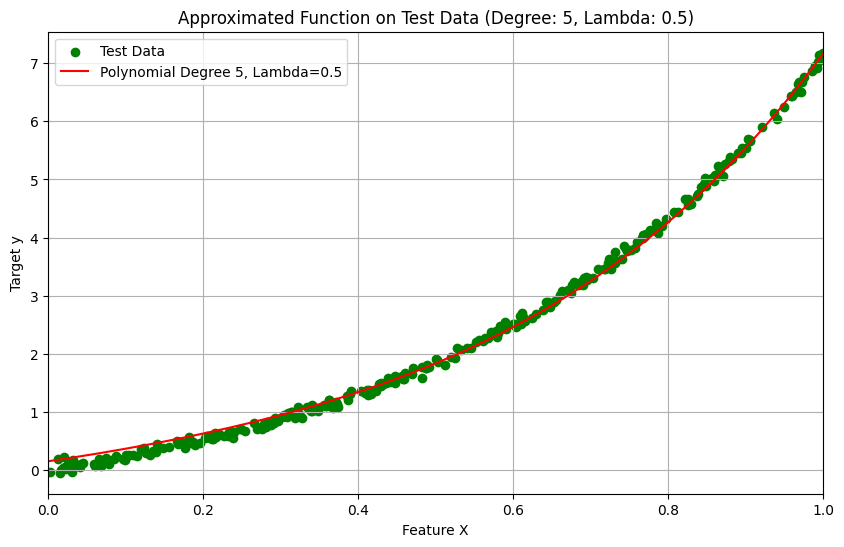


Weights for Subset Size: 50, Degree: 5, Lambda: 1.0
Weight for x^0: 0.24872369403693703
Weight for x^1: 1.807983344695796
Weight for x^2: 1.6438134859231919
Weight for x^3: 1.3632361178960244
Weight for x^4: 1.1249500108698114
Weight for x^5: 0.9371644612829672


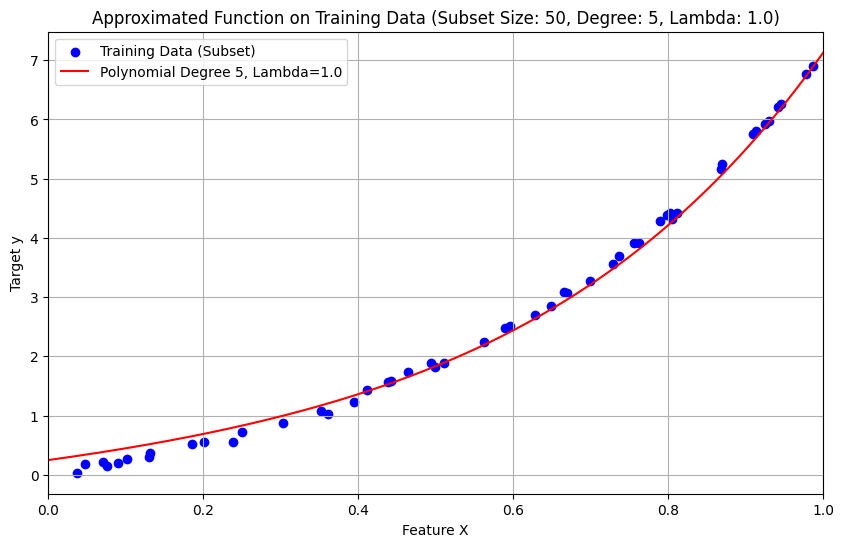

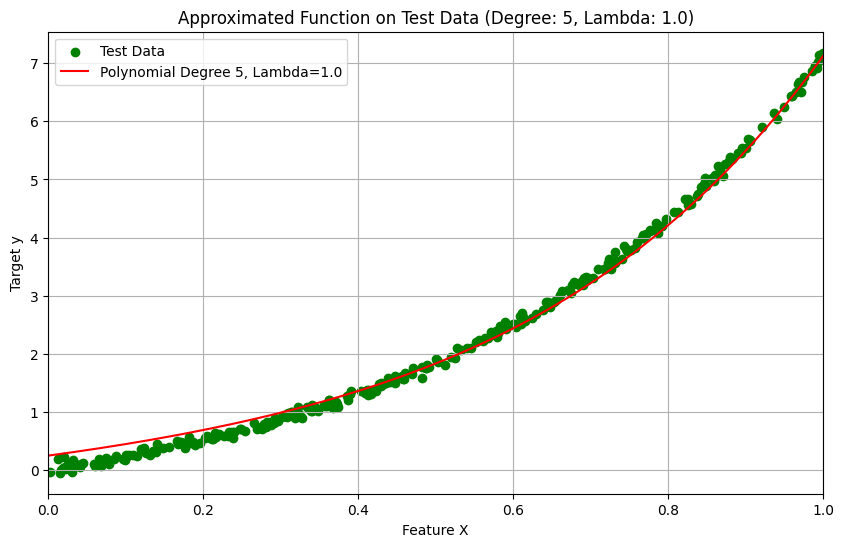


Weights for Subset Size: 50, Degree: 6, Lambda: 0.0
Weight for x^0: -0.07138310179403845
Weight for x^1: 4.688043589670534
Weight for x^2: -21.728072405922433
Weight for x^3: 92.58847345822268
Weight for x^4: -163.6256035122393
Weight for x^5: 140.67254064017263
Weight for x^6: -45.43930197169628


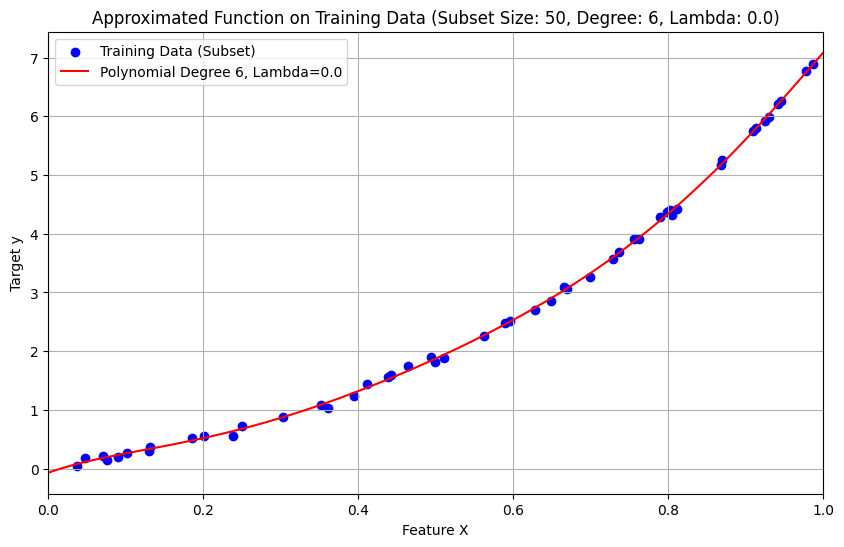

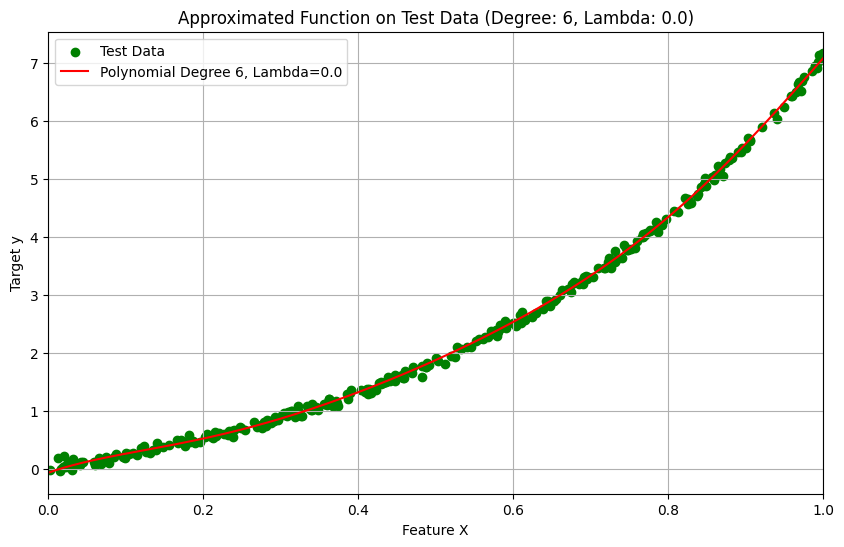


Weights for Subset Size: 50, Degree: 6, Lambda: 0.01
Weight for x^0: 0.006700880113931185
Weight for x^1: 2.1609393360750944
Weight for x^2: 2.0774021058277774
Weight for x^3: 1.4548337020829394
Weight for x^4: 0.8807816126483747
Weight for x^5: 0.4434244605199761
Weight for x^6: 0.11169187554768106


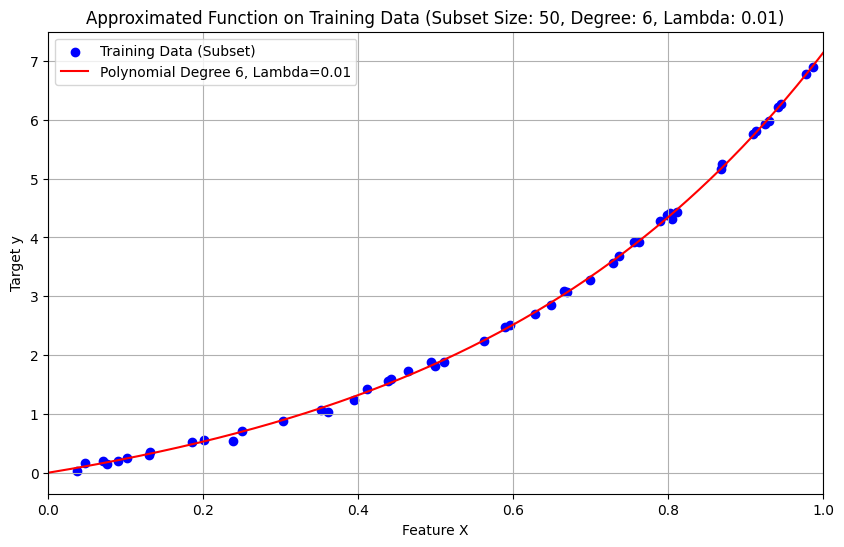

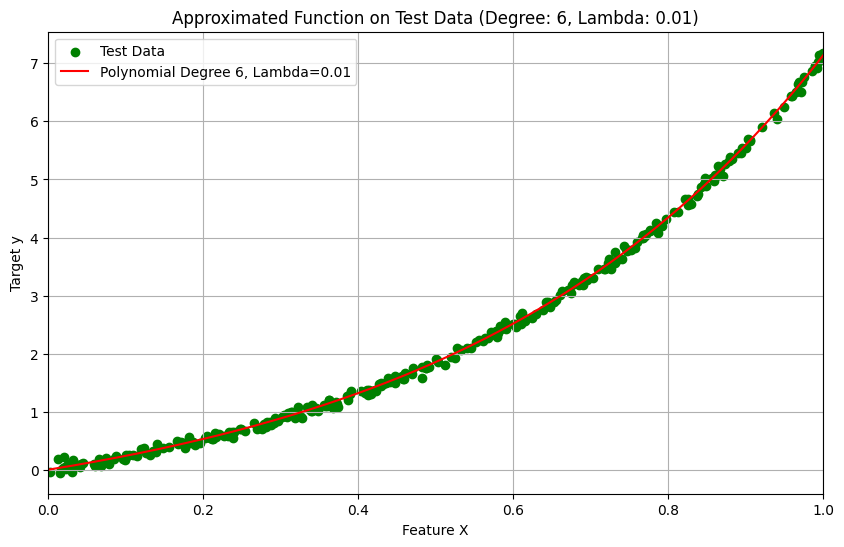


Weights for Subset Size: 50, Degree: 6, Lambda: 0.1
Weight for x^0: 0.028305877698726053
Weight for x^1: 2.221219656162944
Weight for x^2: 1.8939033406678
Weight for x^3: 1.350211002655976
Weight for x^4: 0.8884897136838502
Weight for x^5: 0.5329570815776667
Weight for x^6: 0.26423818725450193


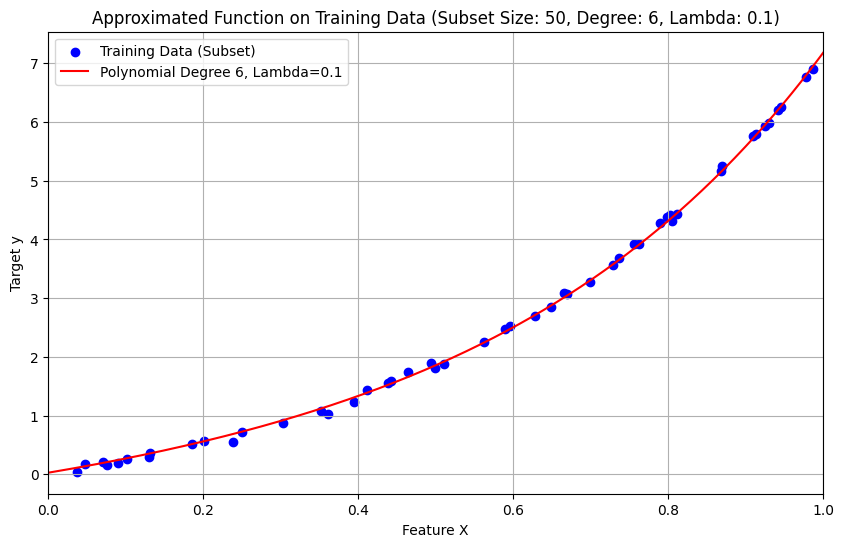

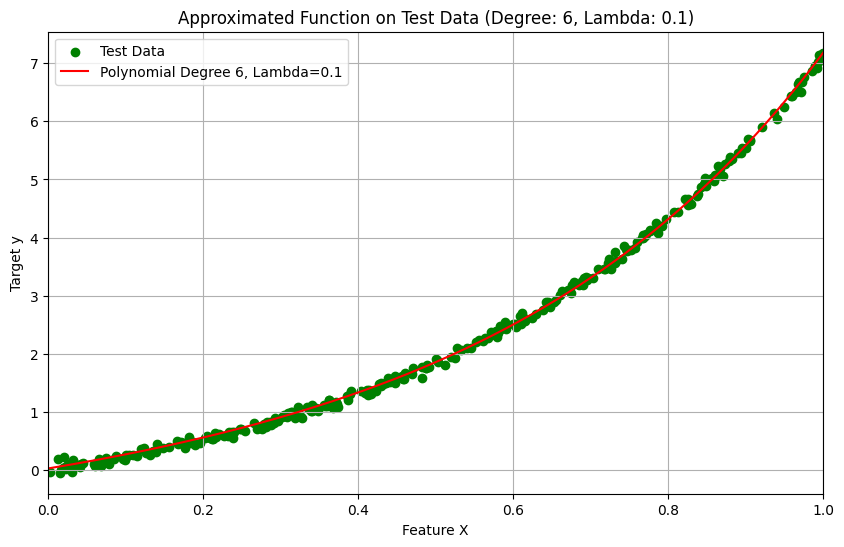


Weights for Subset Size: 50, Degree: 6, Lambda: 0.5
Weight for x^0: 0.15470994919069153
Weight for x^1: 2.0153239354823436
Weight for x^2: 1.7060491412773768
Weight for x^3: 1.2803441501870392
Weight for x^4: 0.935288366445293
Weight for x^5: 0.673635869118131
Weight for x^6: 0.47668888995244246


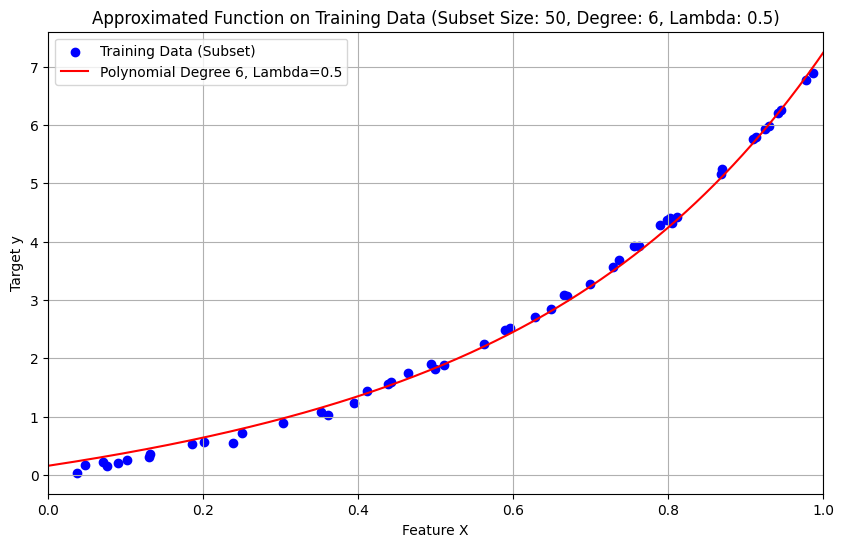

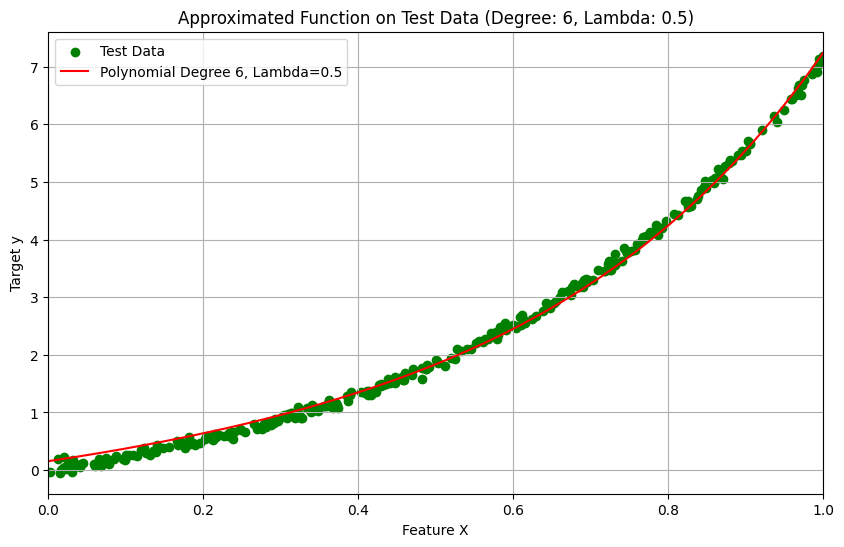


Weights for Subset Size: 50, Degree: 6, Lambda: 1.0
Weight for x^0: 0.26159629264717194
Weight for x^1: 1.8306148271113534
Weight for x^2: 1.5901737618205916
Weight for x^3: 1.2489484278747922
Weight for x^4: 0.9690711800728167
Weight for x^5: 0.7539650102120312
Weight for x^6: 0.5895832051376945


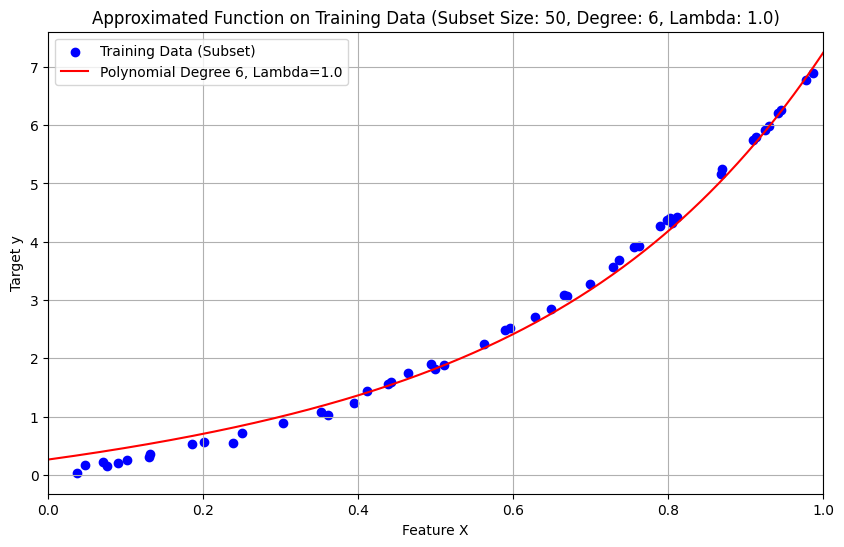

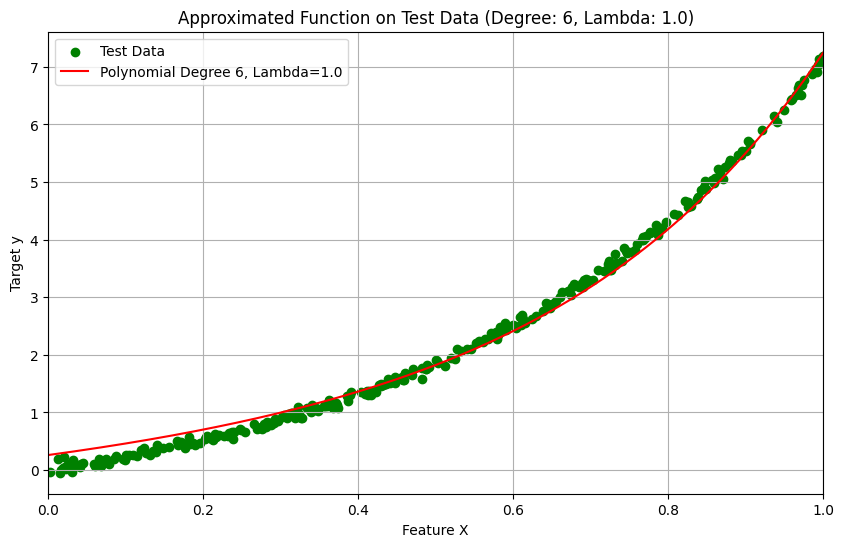


Weights for Subset Size: 50, Degree: 7, Lambda: 0.0
Weight for x^0: -0.13324719371120466
Weight for x^1: 6.814634938906972
Weight for x^2: -45.29382866255401
Weight for x^3: 209.77907891183358
Weight for x^4: -463.3143511266887
Weight for x^5: 550.3118983541316
Weight for x^6: -329.8274248477955
Weight for x^7: 78.76873210295147


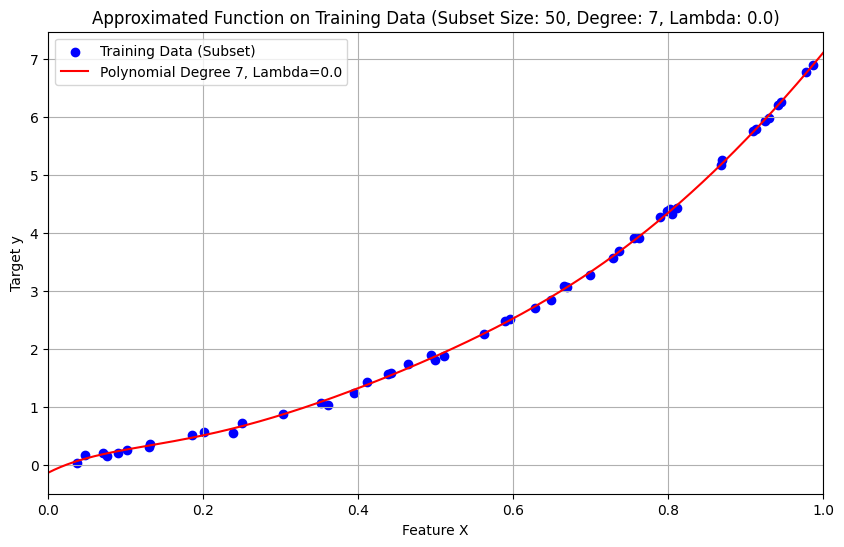

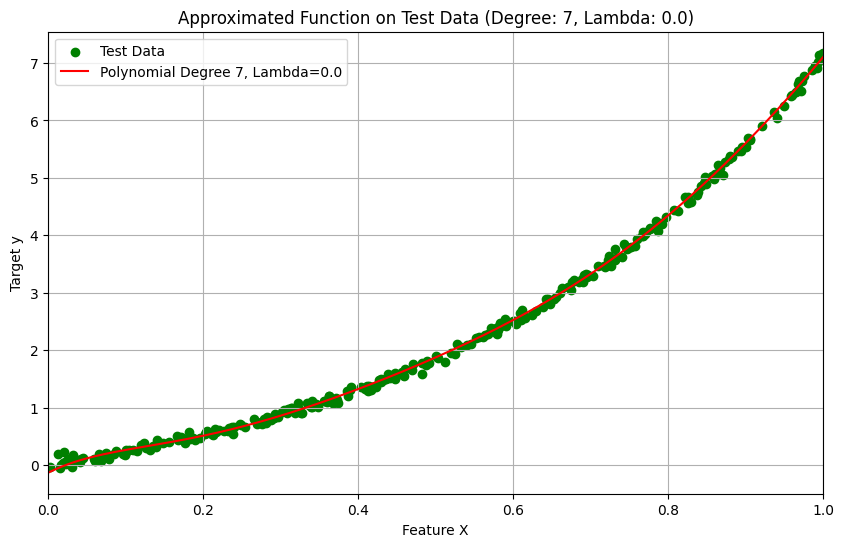


Weights for Subset Size: 50, Degree: 7, Lambda: 0.01
Weight for x^0: 0.006306569631925733
Weight for x^1: 2.1679020057669955
Weight for x^2: 2.0633127089316248
Weight for x^3: 1.442076866341508
Weight for x^4: 0.8855865991003663
Weight for x^5: 0.47276588754618354
Weight for x^6: 0.16692945550349422
Weight for x^7: -0.07172087861619847


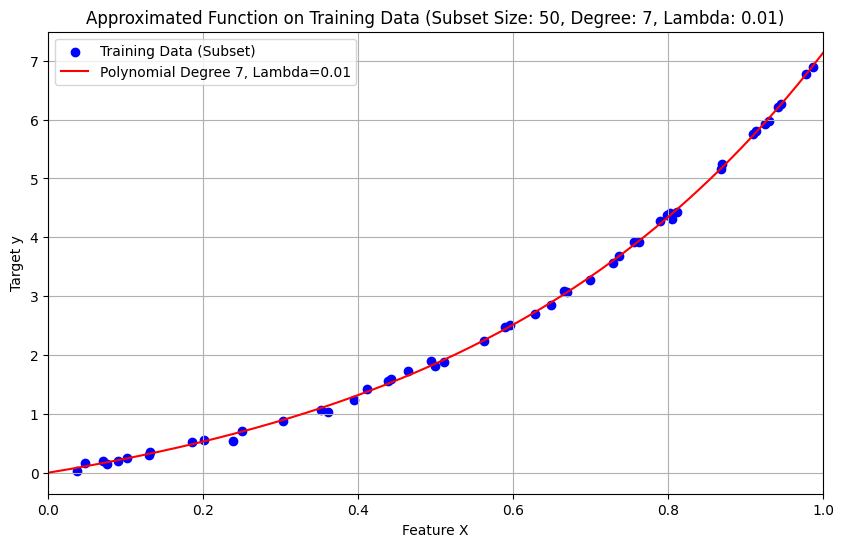

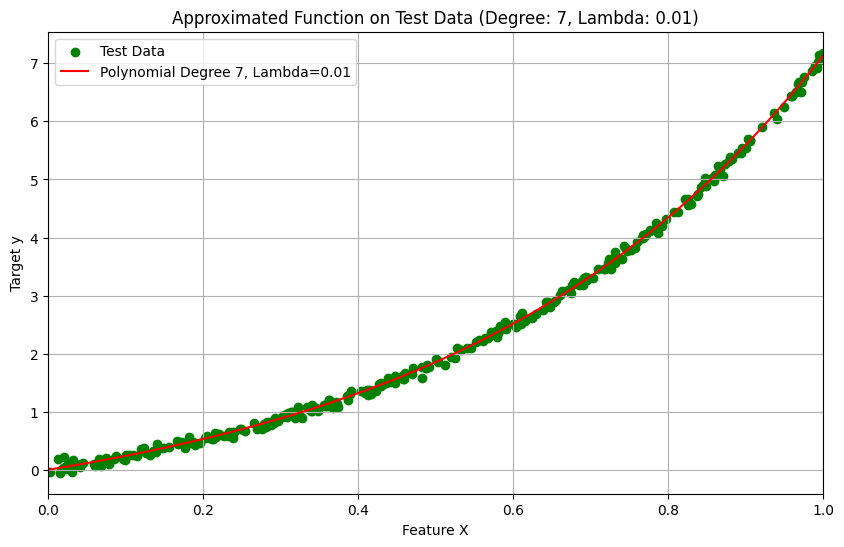


Weights for Subset Size: 50, Degree: 7, Lambda: 0.1
Weight for x^0: 0.02776164775269493
Weight for x^1: 2.223809461423381
Weight for x^2: 1.8974600072109653
Weight for x^3: 1.34905913741305
Weight for x^4: 0.8810858741295653
Weight for x^5: 0.5195756539834008
Weight for x^6: 0.2457436133331419
Weight for x^7: 0.038118723565835524


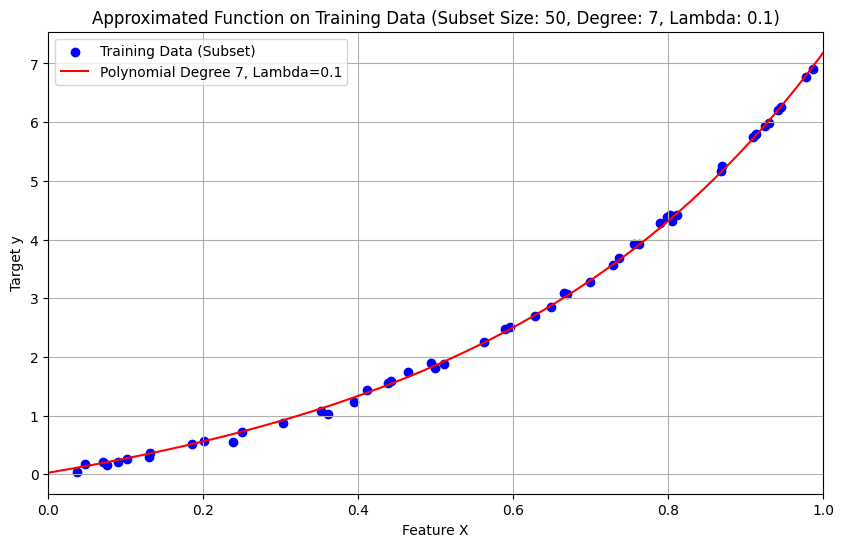

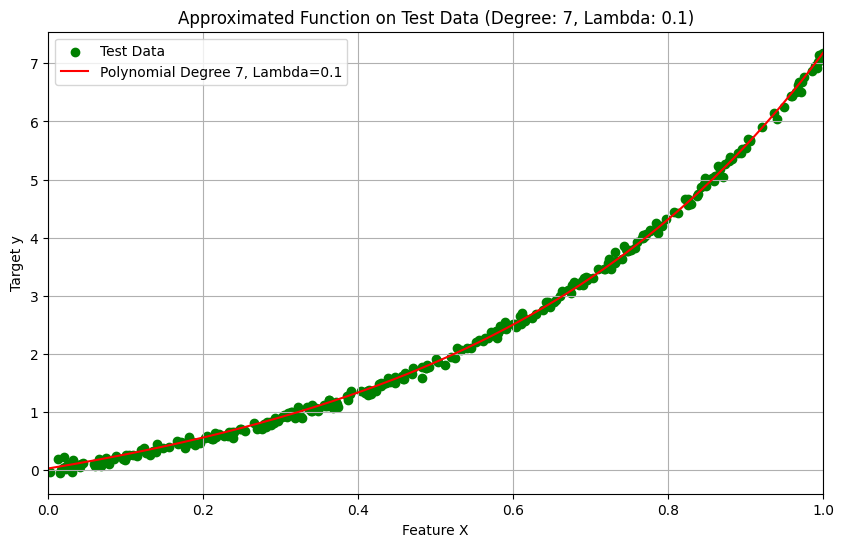


Weights for Subset Size: 50, Degree: 7, Lambda: 0.5
Weight for x^0: 0.15440249894869443
Weight for x^1: 2.0366519088747532
Weight for x^2: 1.7040171080923154
Weight for x^3: 1.252193328022025
Weight for x^4: 0.8854943163304156
Weight for x^5: 0.6073295146614748
Weight for x^6: 0.3982670735250985
Weight for x^7: 0.24046488419978926


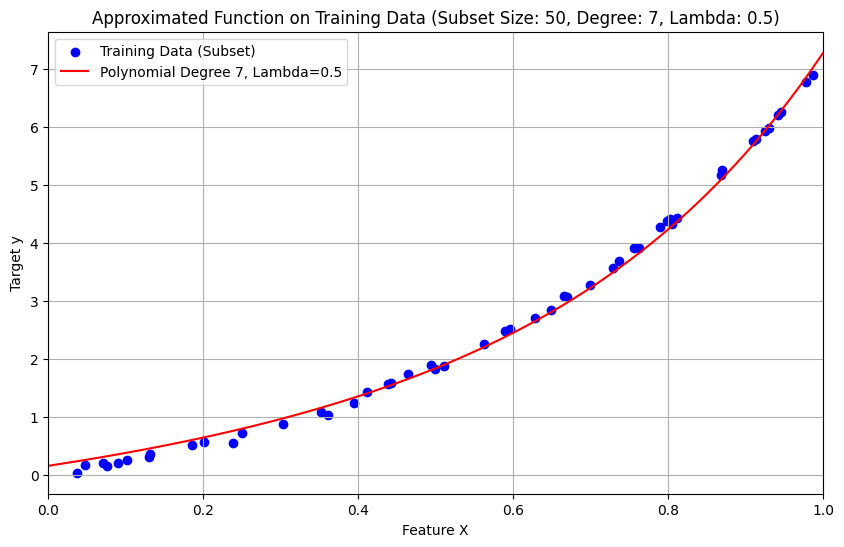

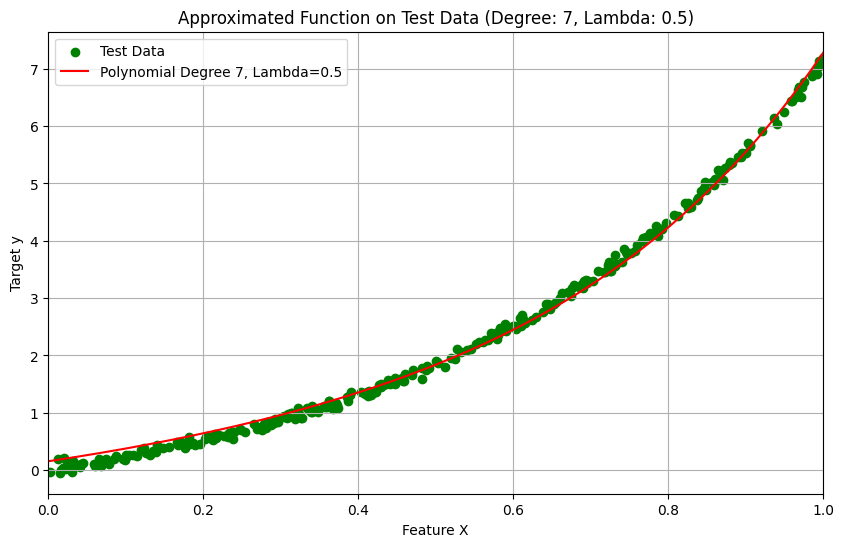


Weights for Subset Size: 50, Degree: 7, Lambda: 1.0
Weight for x^0: 0.26629471975770636
Weight for x^1: 1.8492679772232195
Weight for x^2: 1.5745078844041385
Weight for x^3: 1.2026446783311848
Weight for x^4: 0.9000487724881575
Weight for x^5: 0.6689245490684508
Weight for x^6: 0.49358344851558955
Weight for x^7: 0.3597471975135392


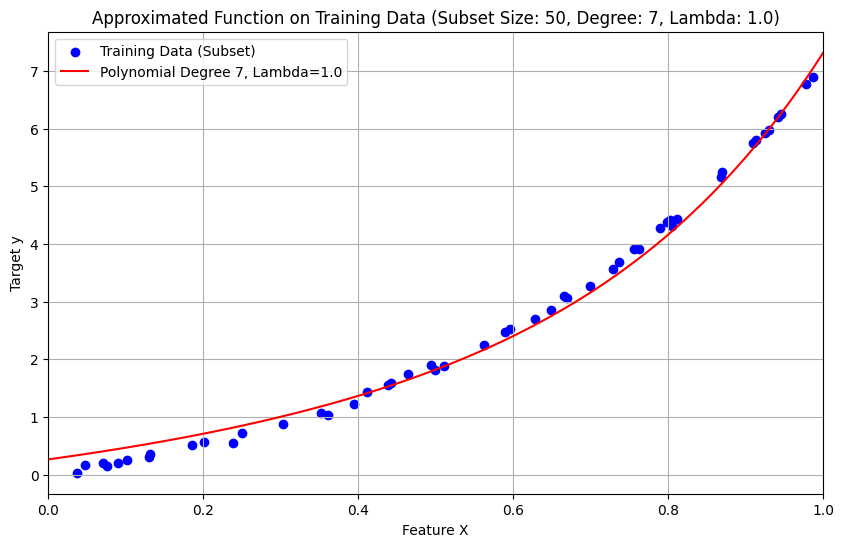

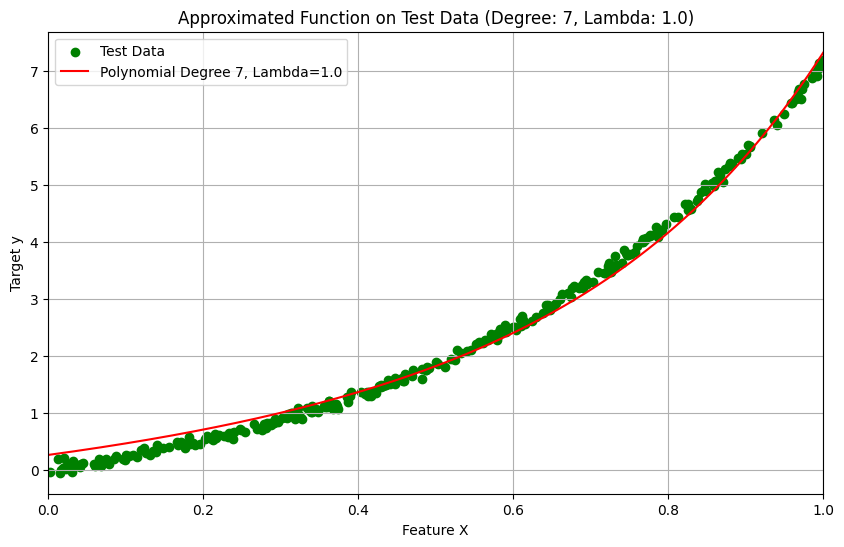


Weights for Subset Size: 50, Degree: 8, Lambda: 0.0
Weight for x^0: 0.039641049721837
Weight for x^1: -0.2883785605161341
Weight for x^2: 53.46322211598217
Weight for x^3: -428.9536894576612
Weight for x^4: 1745.2911210519392
Weight for x^5: -3784.8542735132683
Weight for x^6: 4509.509117132172
Weight for x^7: -2782.0701942623496
Weight for x^8: 695.0147126985457


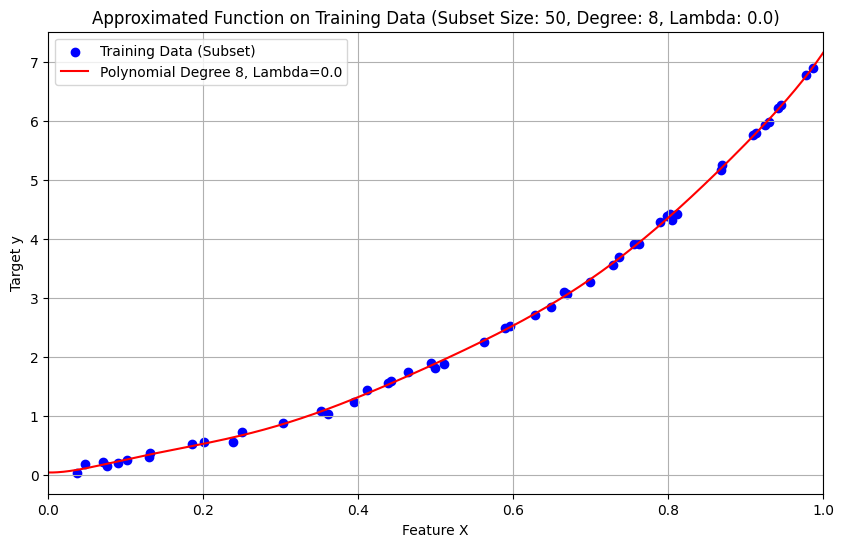

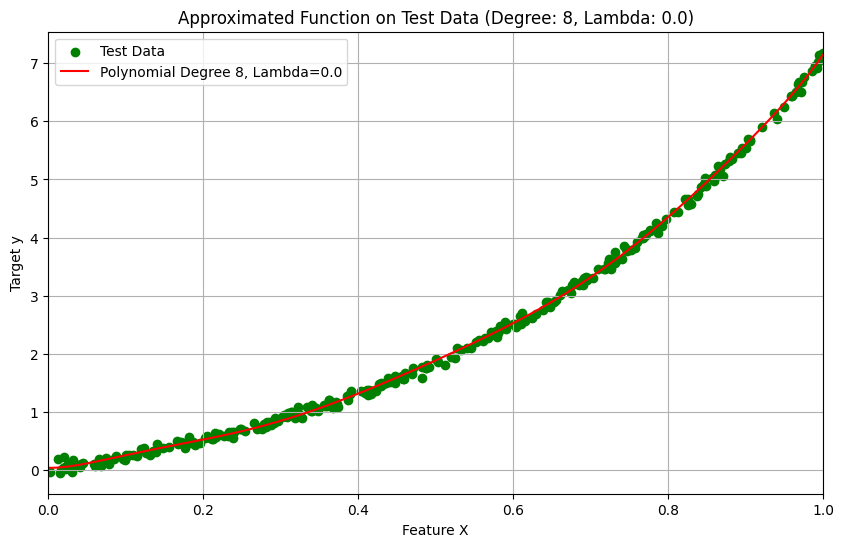


Weights for Subset Size: 50, Degree: 8, Lambda: 0.01
Weight for x^0: 0.005418120123709516
Weight for x^1: 2.1796439782313026
Weight for x^2: 2.0479047233087115
Weight for x^3: 1.418159397637919
Weight for x^4: 0.8770215588625097
Weight for x^5: 0.4938516727914346
Weight for x^6: 0.2237367809240813
Weight for x^7: 0.02179915881123559
Weight for x^8: -0.13946018762010887


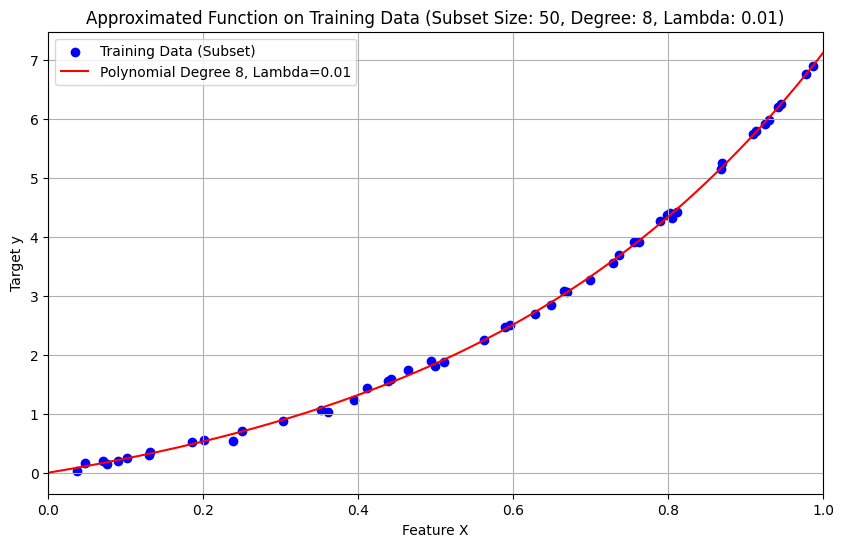

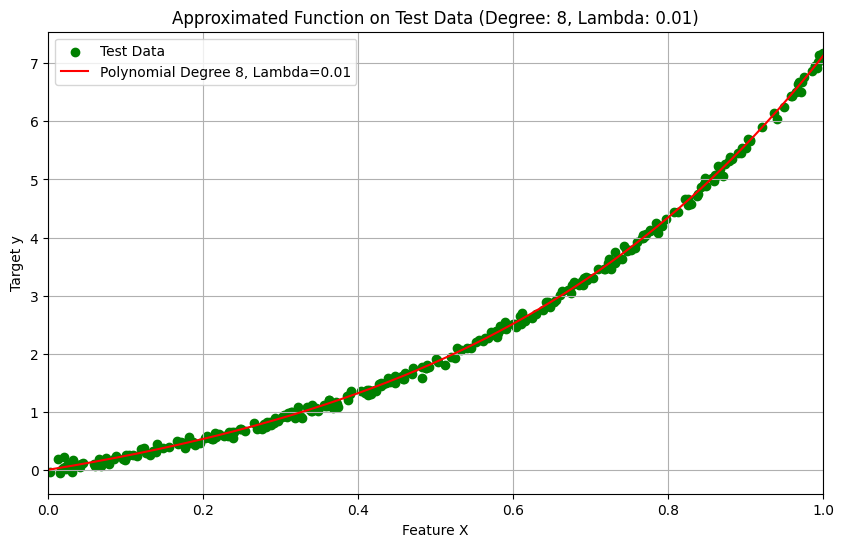


Weights for Subset Size: 50, Degree: 8, Lambda: 0.1
Weight for x^0: 0.02861292723852963
Weight for x^1: 2.221352528429278
Weight for x^2: 1.8896692576599794
Weight for x^3: 1.3467400841200738
Weight for x^4: 0.8882821296551401
Weight for x^5: 0.5367746999992282
Weight for x^6: 0.2720330557672387
Weight for x^7: 0.07215680515963138
Weight for x^8: -0.07982624470790851


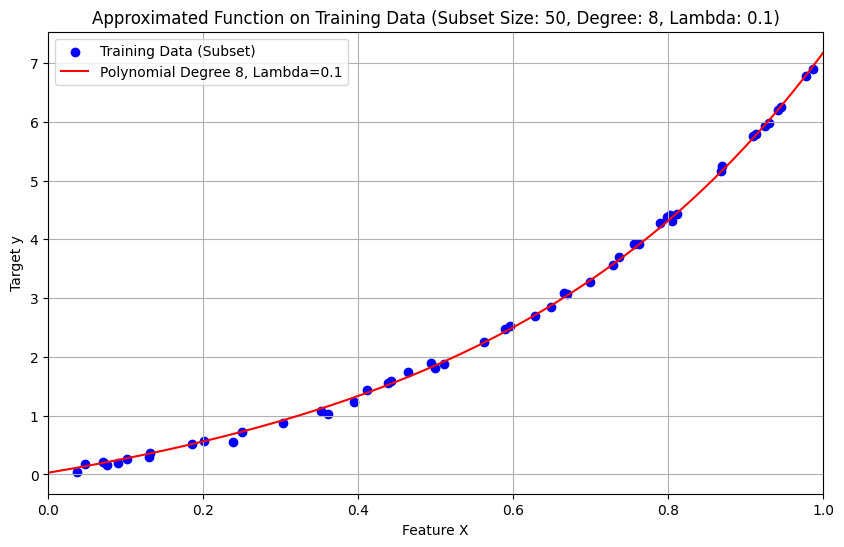

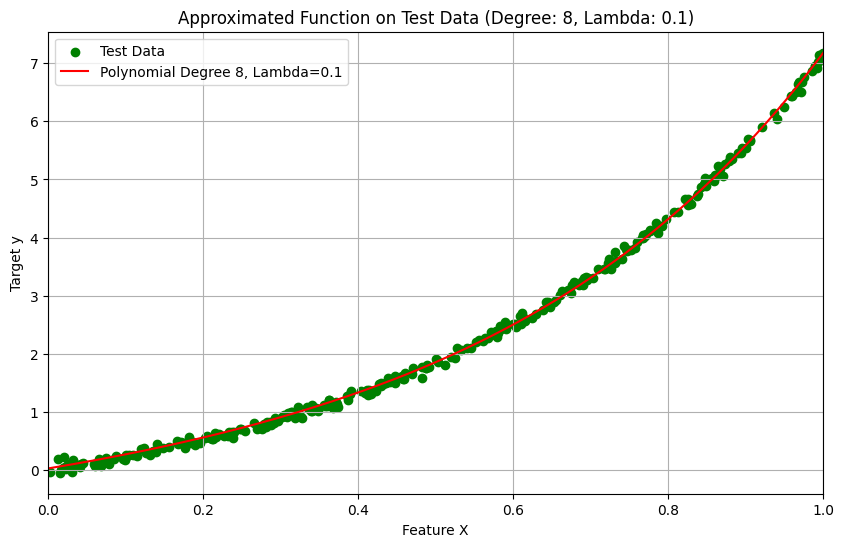


Weights for Subset Size: 50, Degree: 8, Lambda: 0.5
Weight for x^0: 0.15394152975895758
Weight for x^1: 2.043796277844889
Weight for x^2: 1.7056601841025139
Weight for x^3: 1.2462298194465802
Weight for x^4: 0.8726205855342831
Weight for x^5: 0.5888389447217885
Weight for x^6: 0.3754255005679103
Weight for x^7: 0.2143483729328453
Weight for x^8: 0.09195096740446254


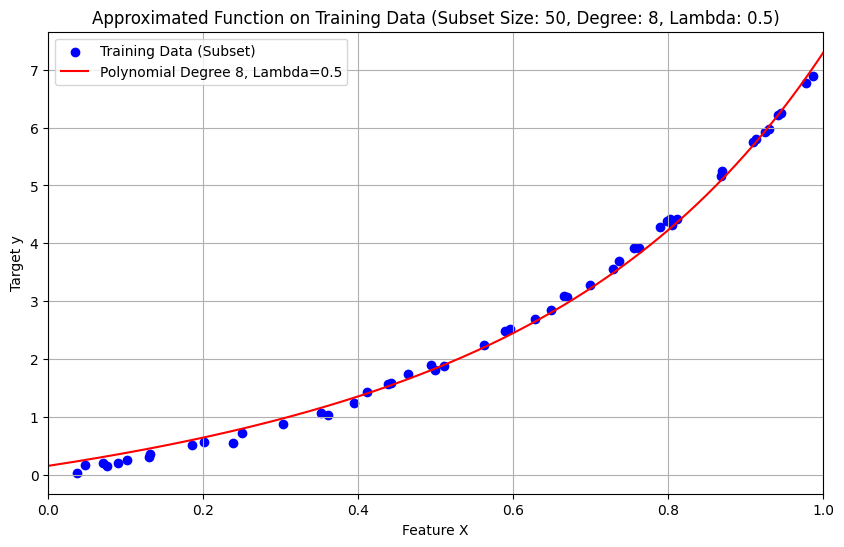

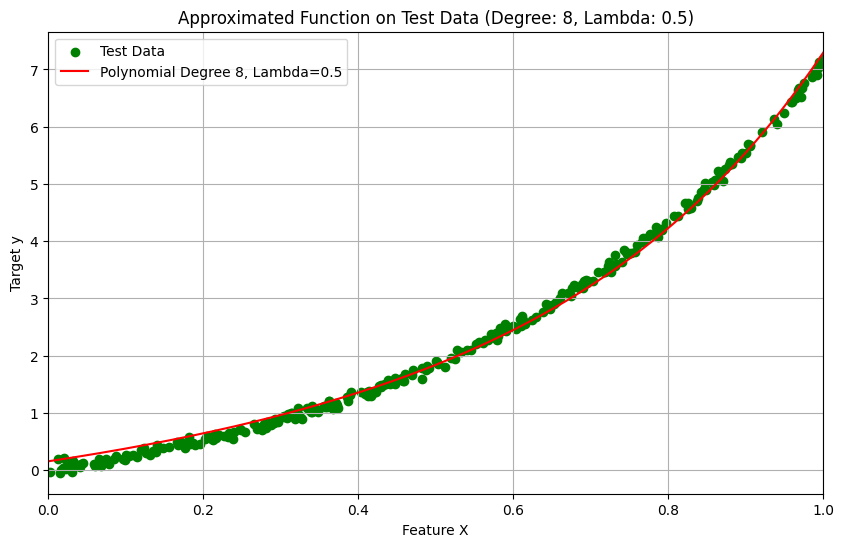


Weights for Subset Size: 50, Degree: 8, Lambda: 1.0
Weight for x^0: 0.267750365955881
Weight for x^1: 1.8605878131266727
Weight for x^2: 1.5714727876038643
Weight for x^3: 1.185220628594716
Weight for x^4: 0.8711939135508556
Weight for x^5: 0.6315400065055381
Weight for x^6: 0.45002770524195485
Weight for x^7: 0.31183964303577694
Weight for x^8: 0.20577108997623222


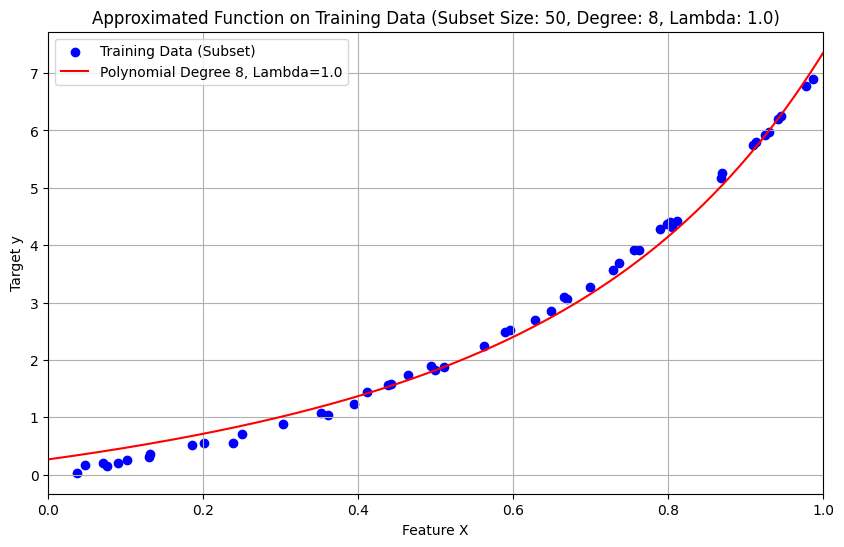

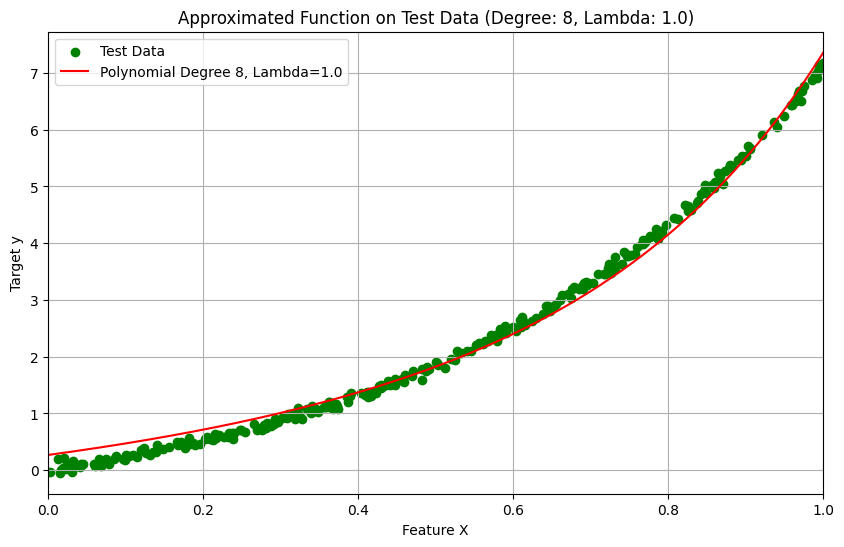


Weights for Subset Size: 50, Degree: 9, Lambda: 0.0
Weight for x^0: 0.09621855063357572
Weight for x^1: -2.933062031493569
Weight for x^2: 96.92005384557375
Weight for x^3: -772.856309045241
Weight for x^4: 3252.6439345580234
Weight for x^5: -7704.461762234905
Weight for x^6: 10698.895789392964
Weight for x^7: -8603.352749920396
Weight for x^8: 3691.9113908951904
Weight for x^9: -649.7258373380599


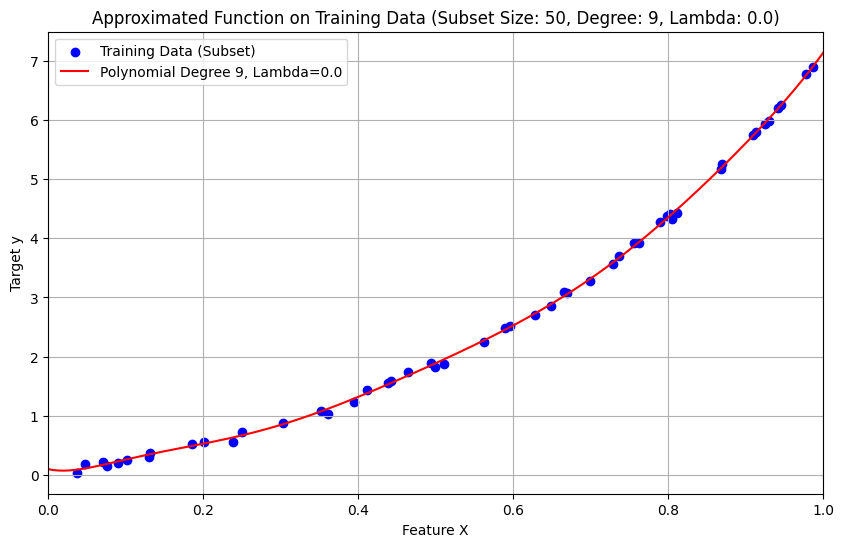

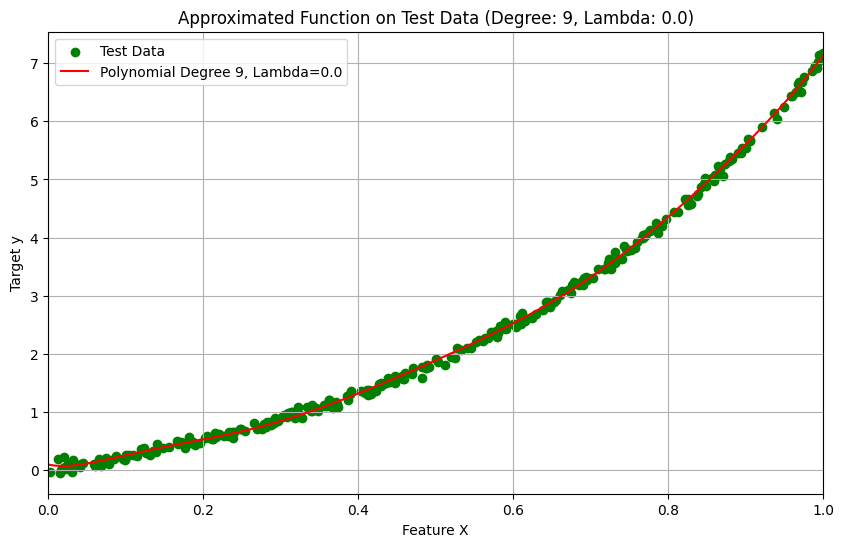


Weights for Subset Size: 50, Degree: 9, Lambda: 0.01
Weight for x^0: 0.004514884671815302
Weight for x^1: 2.1894244685909765
Weight for x^2: 2.040922576127218
Weight for x^3: 1.397030773788411
Weight for x^4: 0.860227043560344
Weight for x^5: 0.49601027062422065
Weight for x^6: 0.25316306723605264
Weight for x^7: 0.08202020369202243
Weight for x^8: -0.04796088297853156
Weight for x^9: -0.15288513407995963


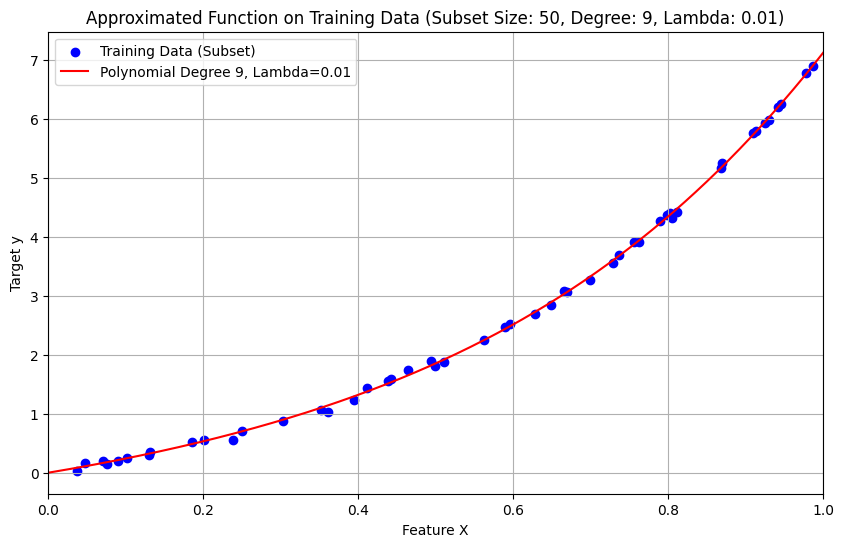

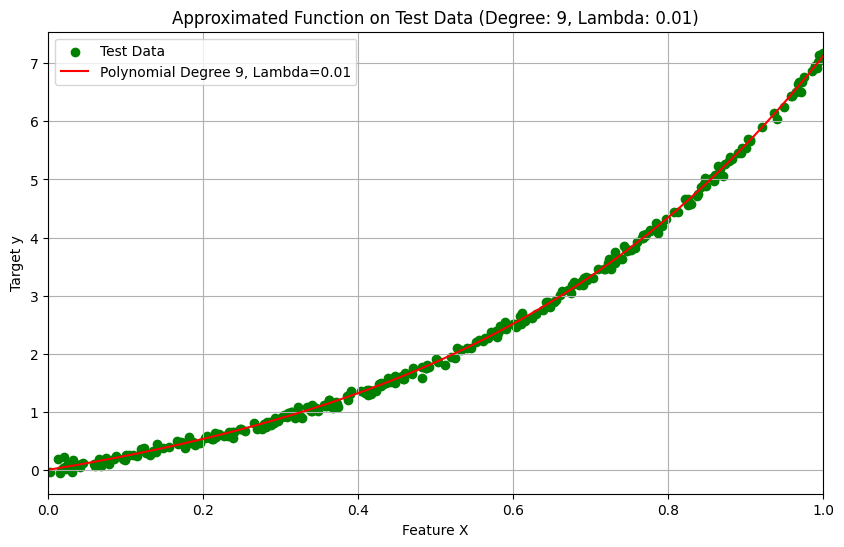


Weights for Subset Size: 50, Degree: 9, Lambda: 0.1
Weight for x^0: 0.029629927891192183
Weight for x^1: 2.2205362574138188
Weight for x^2: 1.8774917676850835
Weight for x^3: 1.3389361064343148
Weight for x^4: 0.8920310907532164
Weight for x^5: 0.553967634622273
Weight for x^6: 0.3021881203170411
Weight for x^7: 0.11387281888496505
Weight for x^8: -0.02820350577951934
Weight for x^9: -0.13625225517038583


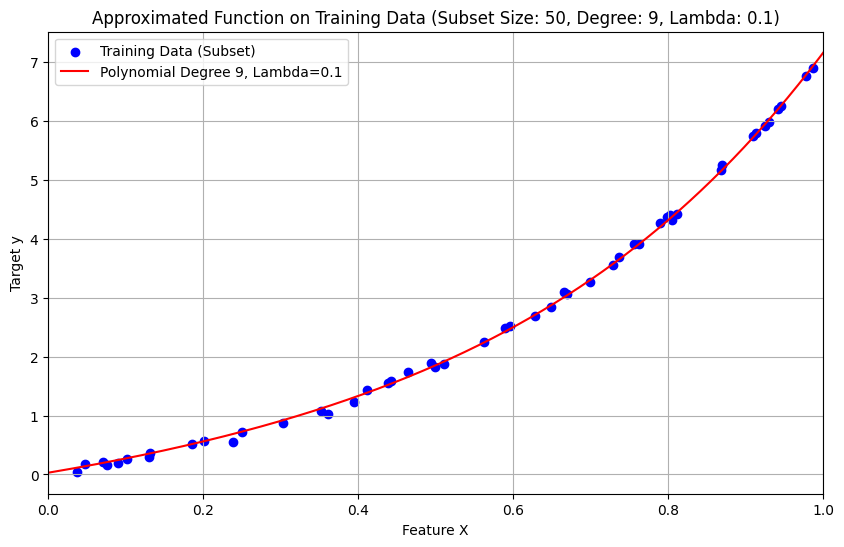

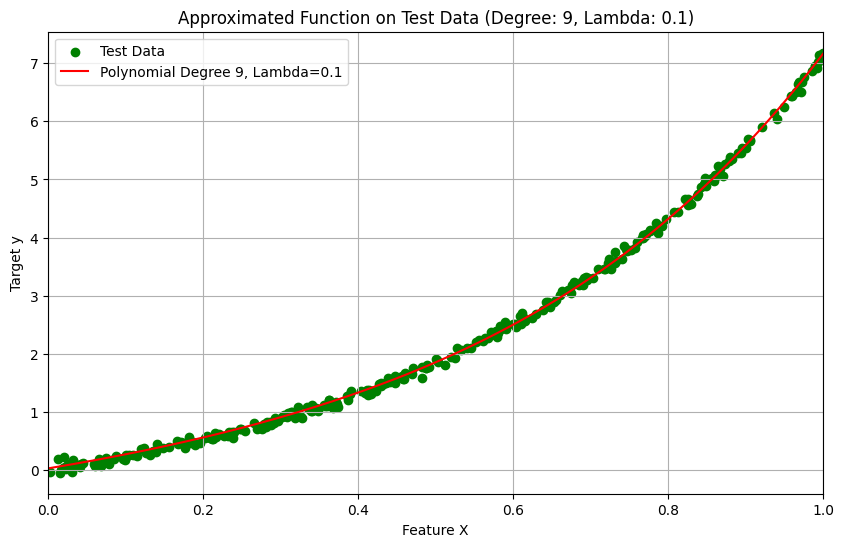


Weights for Subset Size: 50, Degree: 9, Lambda: 0.5
Weight for x^0: 0.15395060133275434
Weight for x^1: 2.0437101401277227
Weight for x^2: 1.7056186800273607
Weight for x^3: 1.2462706434393134
Weight for x^4: 0.8727435140815399
Weight for x^5: 0.5890325831621444
Weight for x^6: 0.375676498473094
Weight for x^7: 0.21464444274502525
Weight for x^8: 0.09228169417868302
Weight for x^9: -0.0013173055925050556


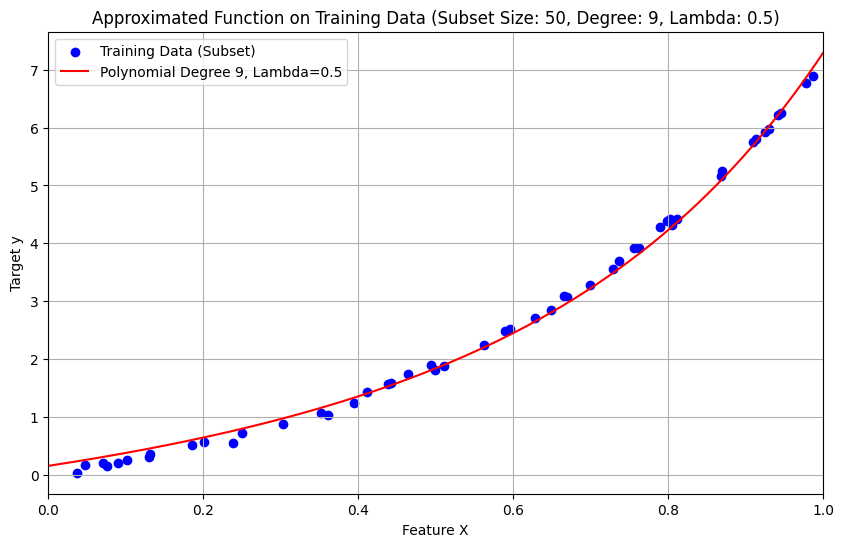

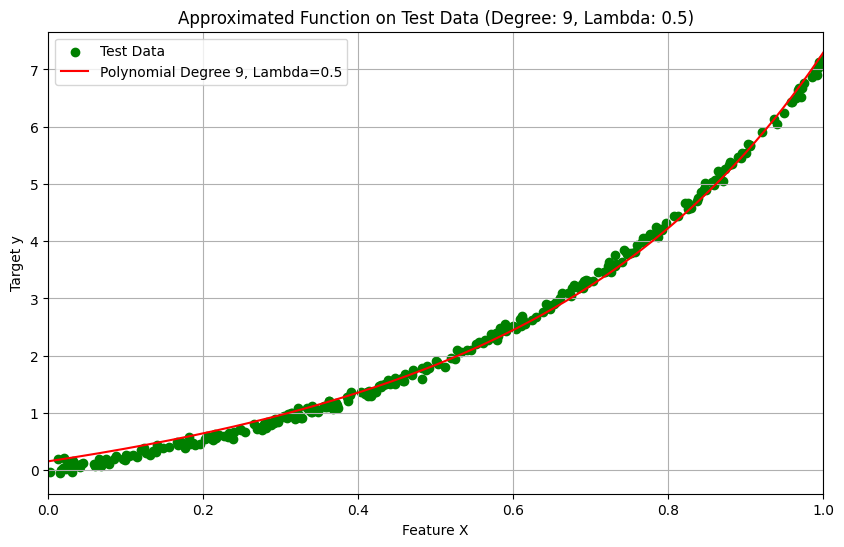


Weights for Subset Size: 50, Degree: 9, Lambda: 1.0
Weight for x^0: 0.2680563221163305
Weight for x^1: 1.8660071025983425
Weight for x^2: 1.571765045526757
Weight for x^3: 1.1797025098506722
Weight for x^4: 0.8607552018087705
Weight for x^5: 0.6172464888072975
Weight for x^6: 0.43281816296707465
Weight for x^7: 0.29247500849190833
Weight for x^8: 0.18484902880513124
Weight for x^9: 0.10166083195812736


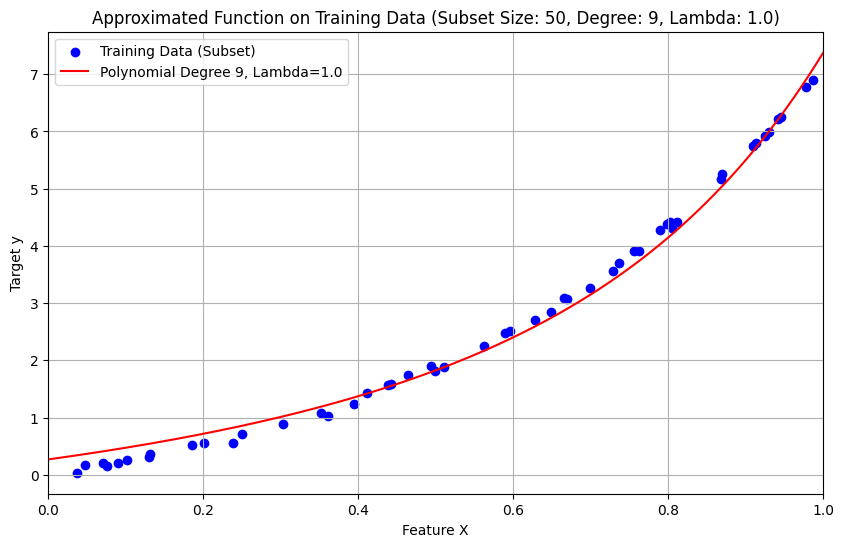

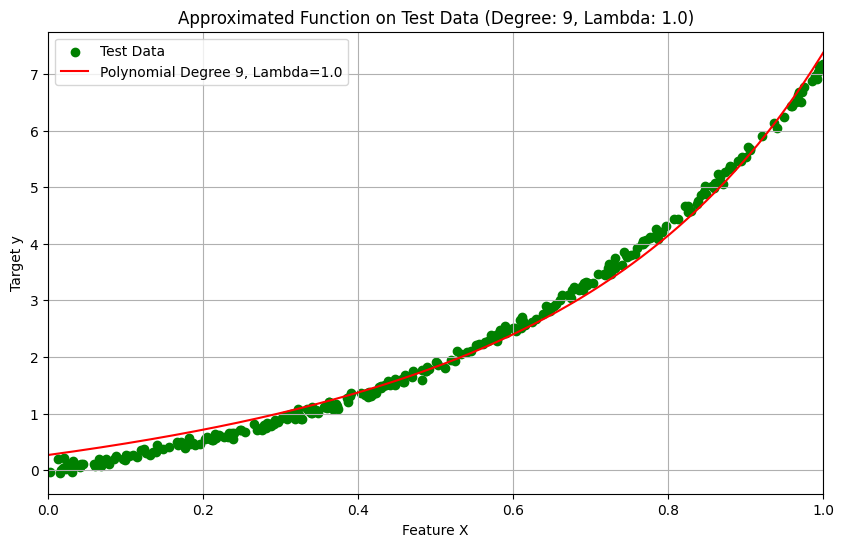


Weights for Subset Size: 100, Degree: 2, Lambda: 0.0
Weight for x^0: 0.1853199663368757
Weight for x^1: -0.04415130495276962
Weight for x^2: 6.7479761664662465


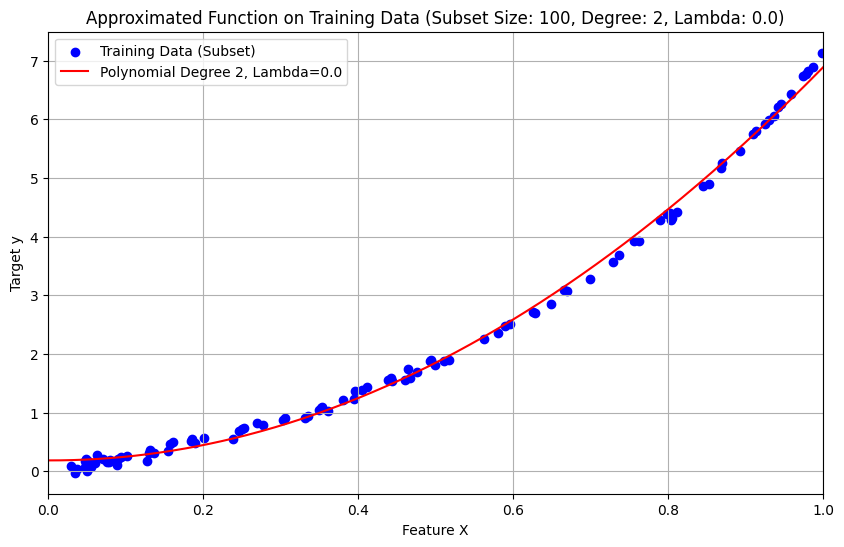

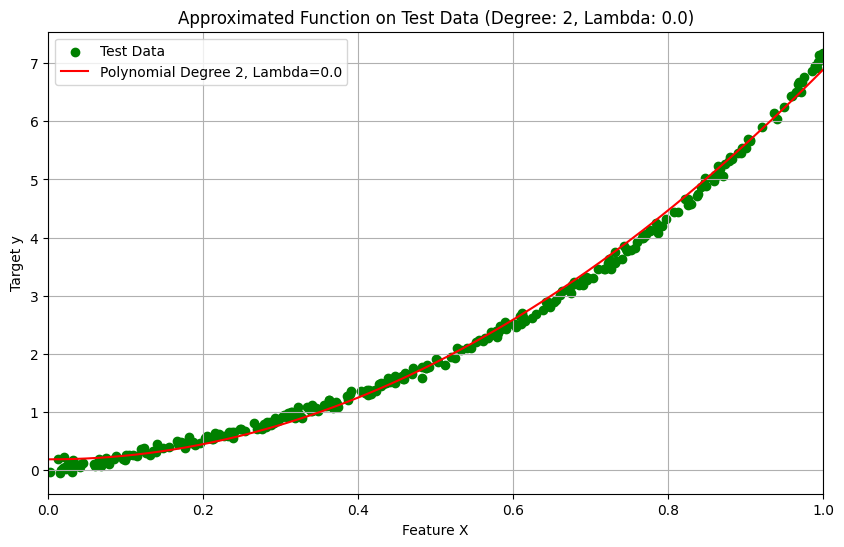


Weights for Subset Size: 100, Degree: 2, Lambda: 0.01
Weight for x^0: 0.16944574661814657
Weight for x^1: 0.06271419984425468
Weight for x^2: 6.640415121641289


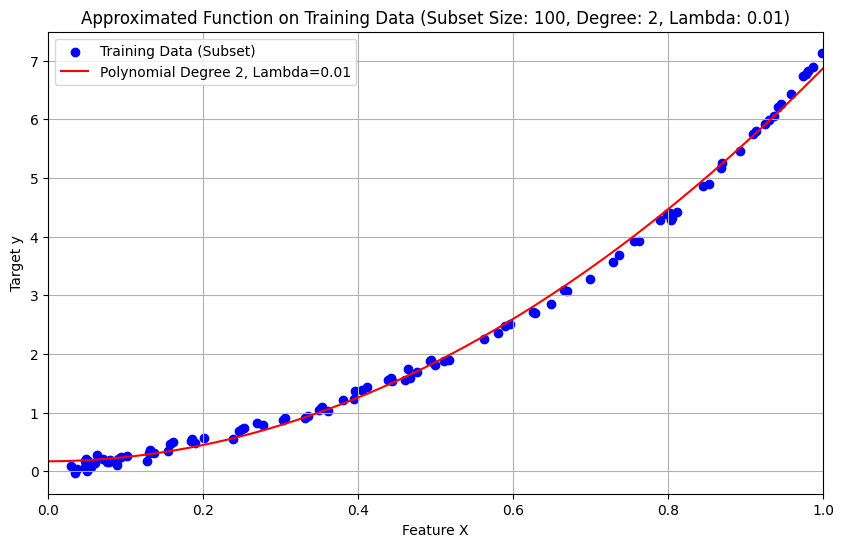

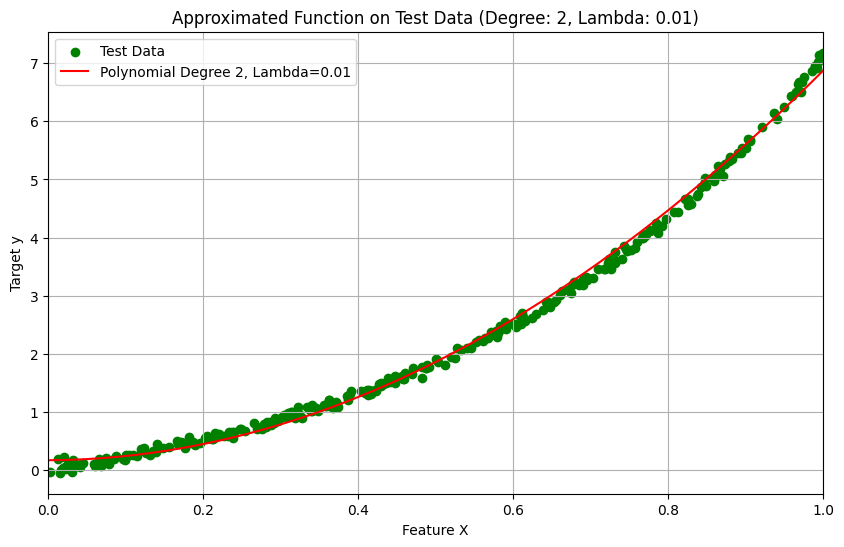


Weights for Subset Size: 100, Degree: 2, Lambda: 0.1
Weight for x^0: 0.06528718715960496
Weight for x^1: 0.7806044323968174
Weight for x^2: 5.910012965429681


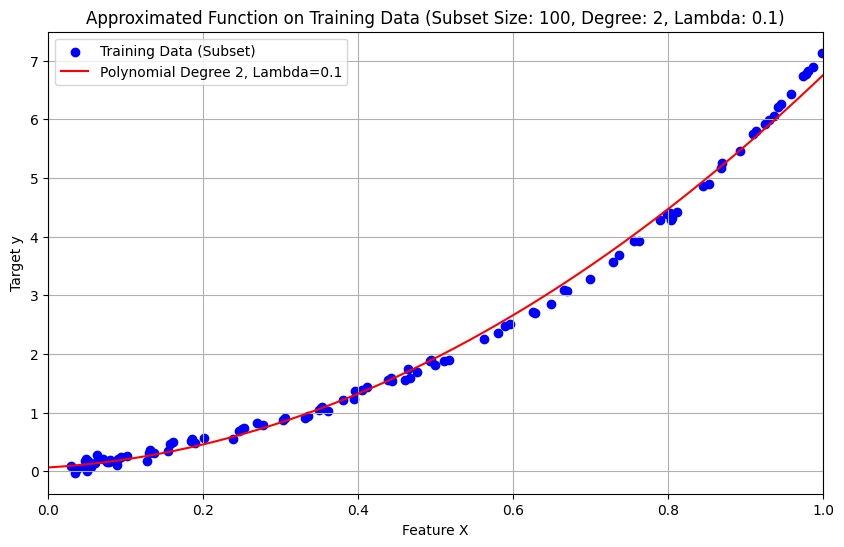

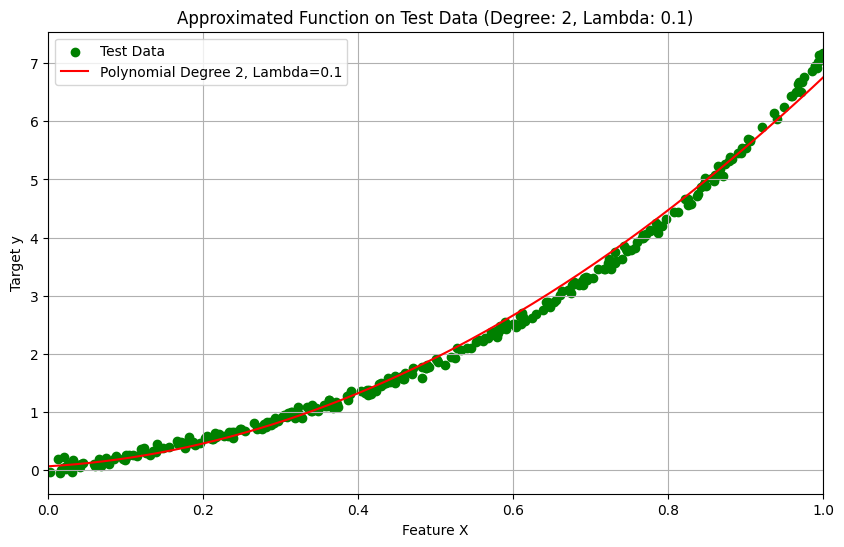


Weights for Subset Size: 100, Degree: 2, Lambda: 0.5
Weight for x^0: -0.08251216405289642
Weight for x^1: 1.979510819008204
Weight for x^2: 4.6071095361964565


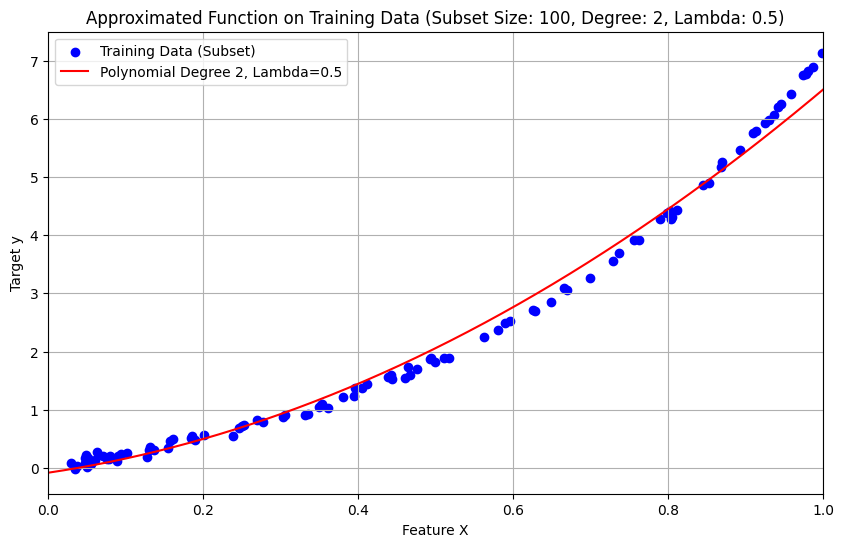

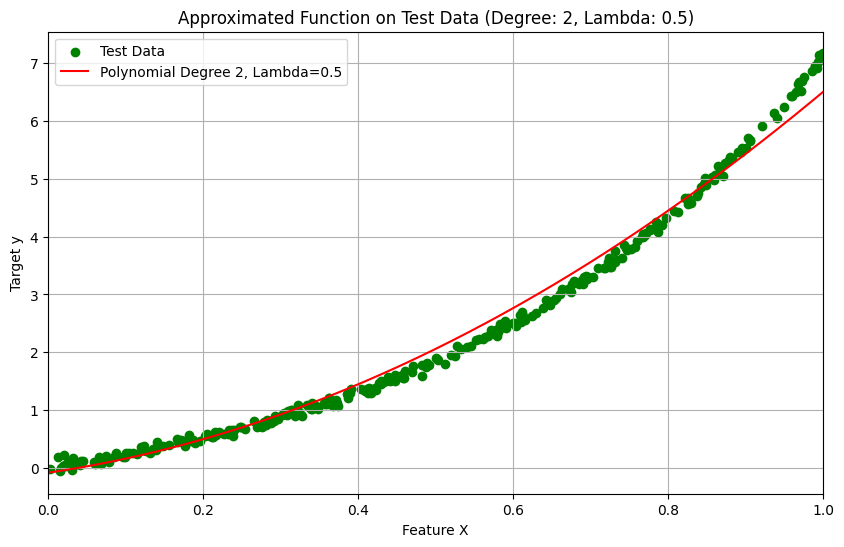


Weights for Subset Size: 100, Degree: 2, Lambda: 1.0
Weight for x^0: -0.09769733588488537
Weight for x^1: 2.390227307489406
Weight for x^2: 4.046960094699166


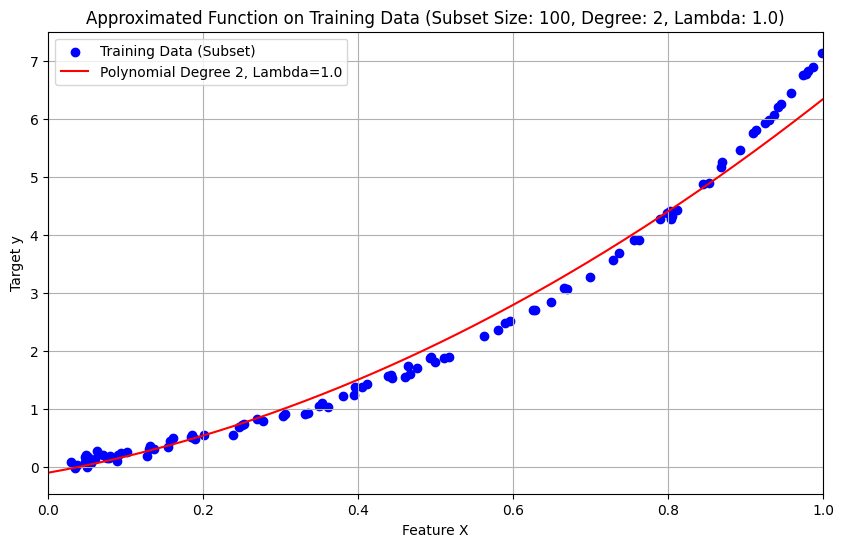

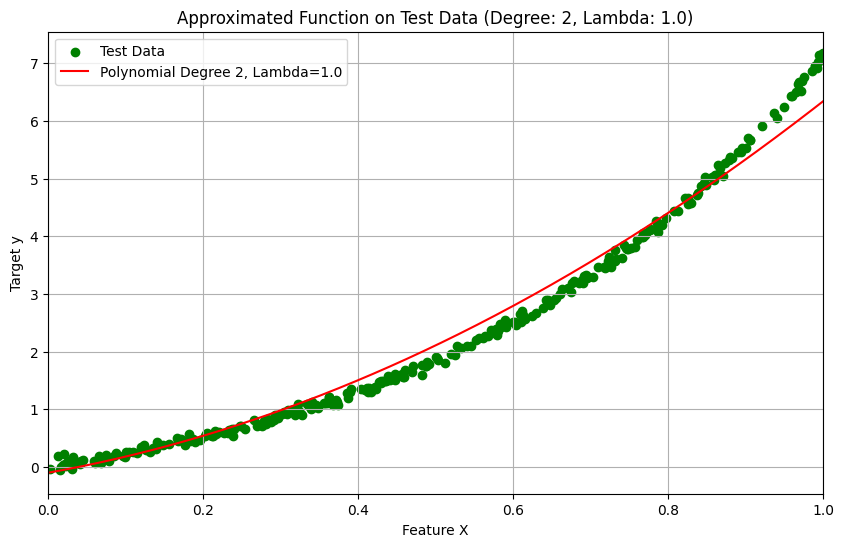


Weights for Subset Size: 100, Degree: 3, Lambda: 0.0
Weight for x^0: -0.03974327967583065
Weight for x^1: 2.8658796232033006
Weight for x^2: -0.7244852750667037
Weight for x^3: 5.002336706175321


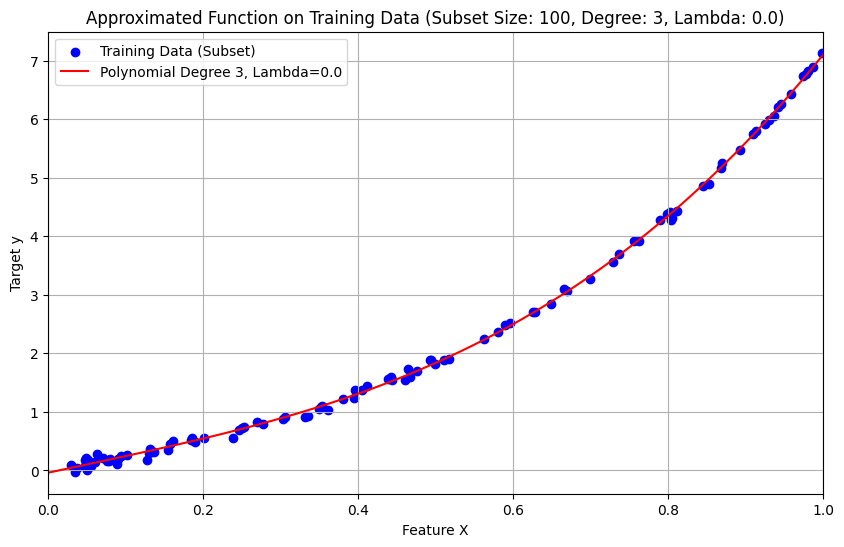

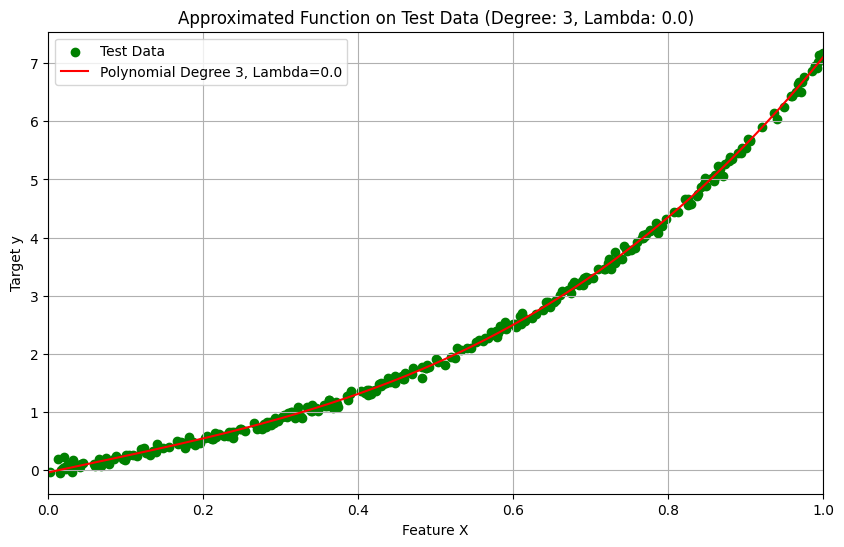


Weights for Subset Size: 100, Degree: 3, Lambda: 0.01
Weight for x^0: 0.014511618401401886
Weight for x^1: 2.193343279976914
Weight for x^2: 0.9661540182972793
Weight for x^3: 3.8837623082202093


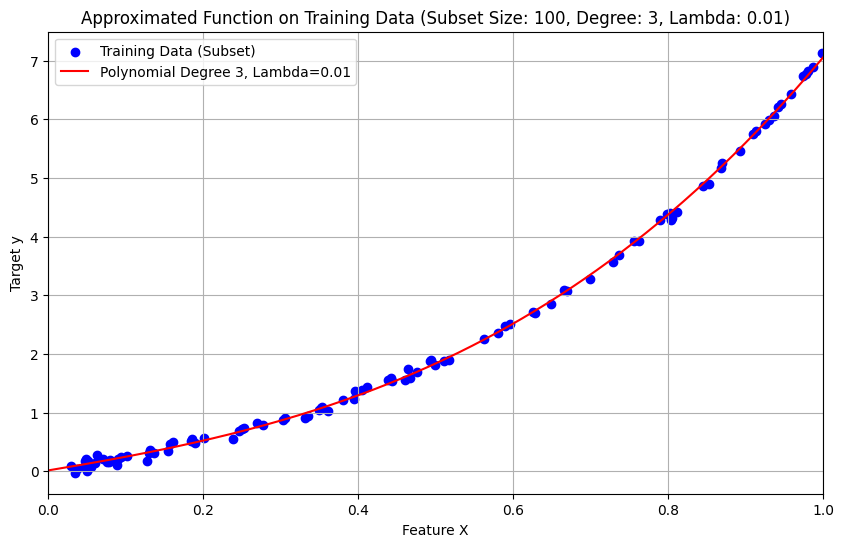

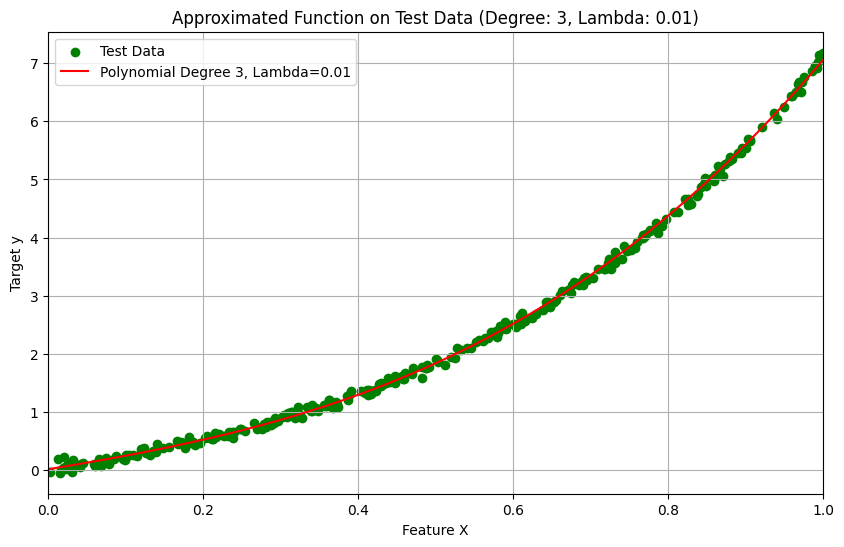


Weights for Subset Size: 100, Degree: 3, Lambda: 0.1
Weight for x^0: 0.04765597339800406
Weight for x^1: 1.7491805370641418
Weight for x^2: 2.221772810333184
Weight for x^3: 2.976443153457352


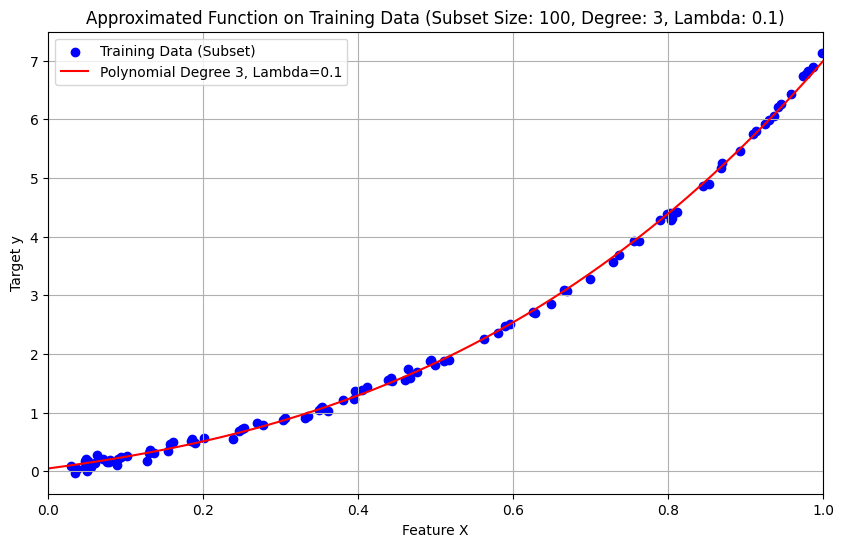

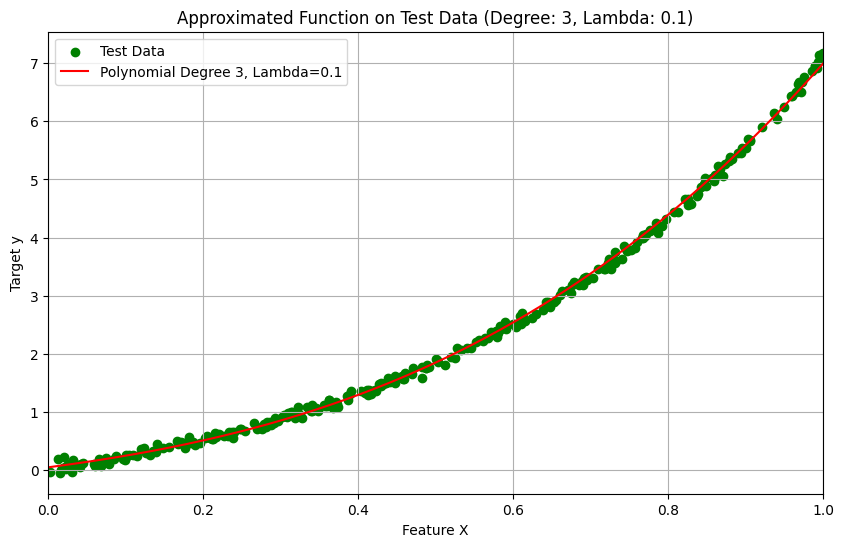


Weights for Subset Size: 100, Degree: 3, Lambda: 0.5
Weight for x^0: 0.04328733378430224
Weight for x^1: 1.8384733688050163
Weight for x^2: 2.370204587438621
Weight for x^3: 2.6306157796130867


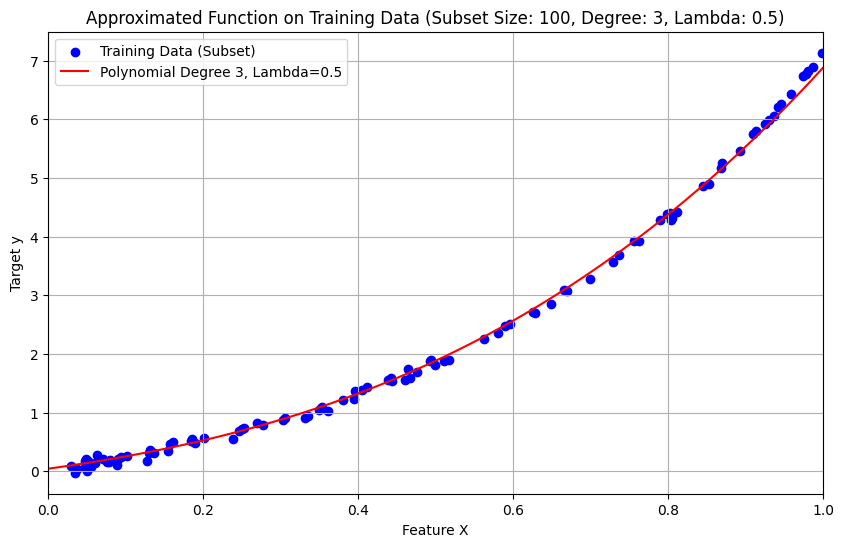

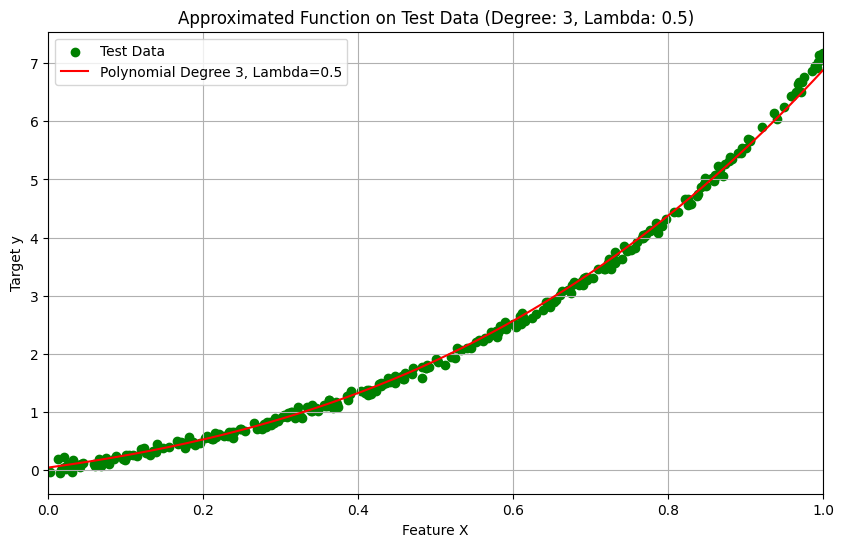


Weights for Subset Size: 100, Degree: 3, Lambda: 1.0
Weight for x^0: 0.05571433161056414
Weight for x^1: 1.9163625990040596
Weight for x^2: 2.3396094135056424
Weight for x^3: 2.4668157435896036


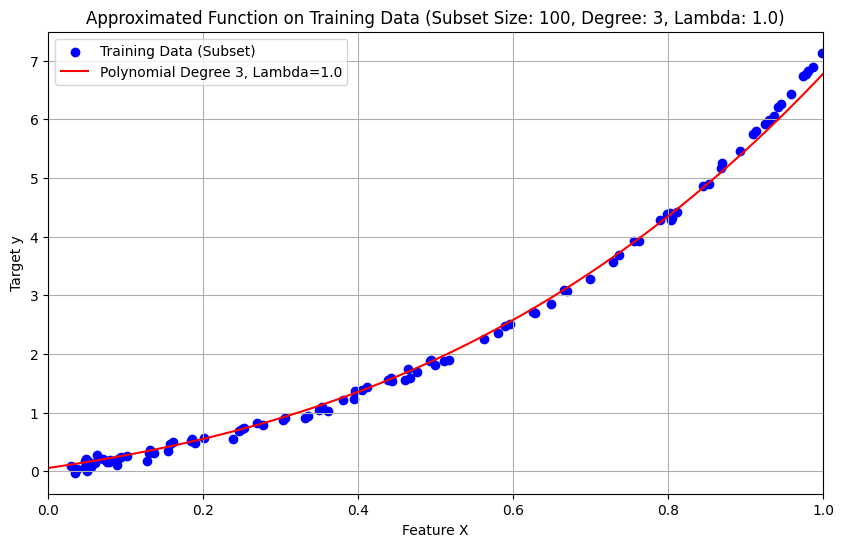

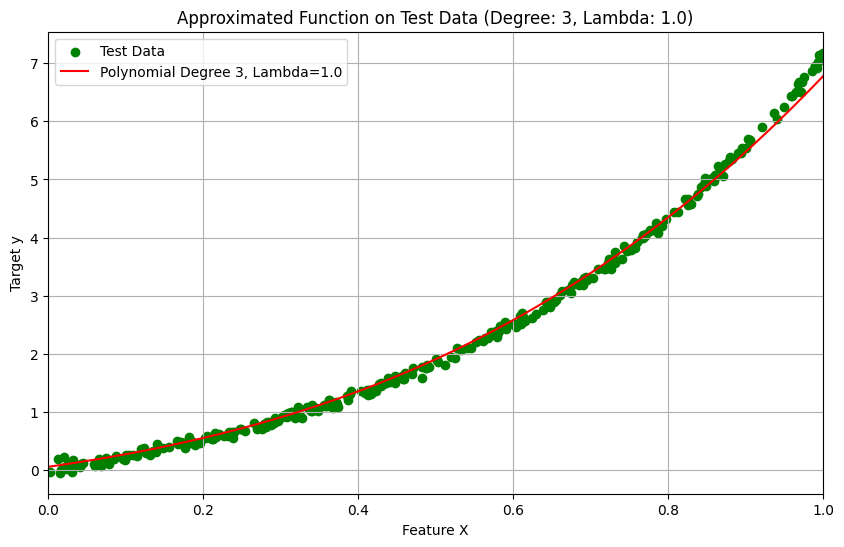


Weights for Subset Size: 100, Degree: 4, Lambda: 0.0
Weight for x^0: 0.004172475322424276
Weight for x^1: 2.0451770907984335
Weight for x^2: 2.8575508594518424
Weight for x^3: -0.4529545618166954
Weight for x^4: 2.68050726228637


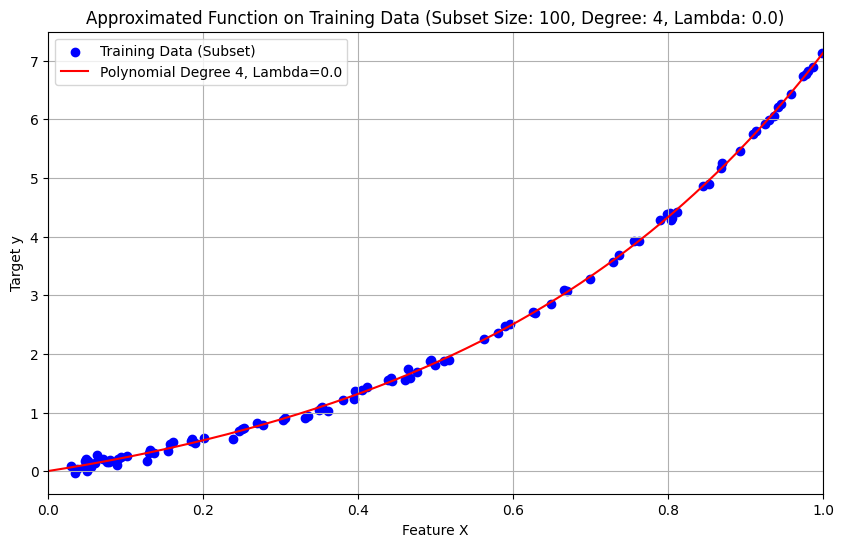

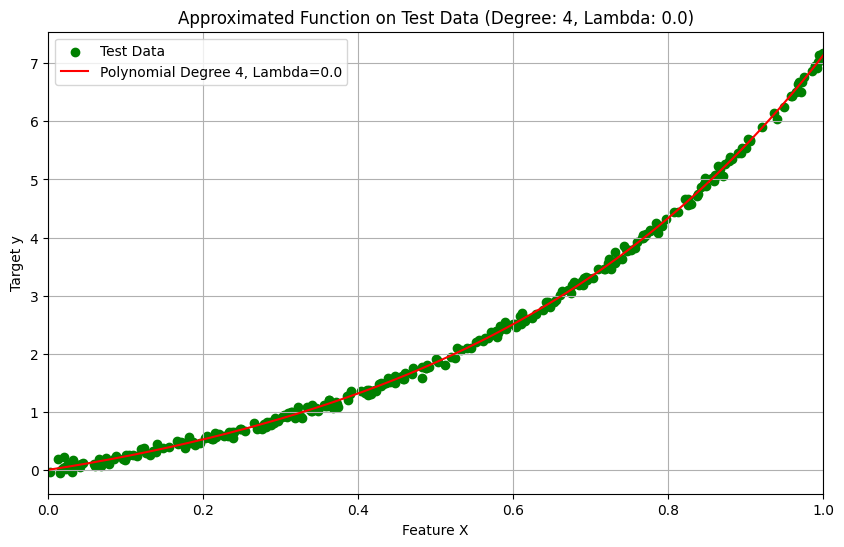


Weights for Subset Size: 100, Degree: 4, Lambda: 0.01
Weight for x^0: -0.005457341905899872
Weight for x^1: 2.2841120943001445
Weight for x^2: 1.6744600069304472
Weight for x^3: 1.4827733512016925
Weight for x^4: 1.6834472487803325


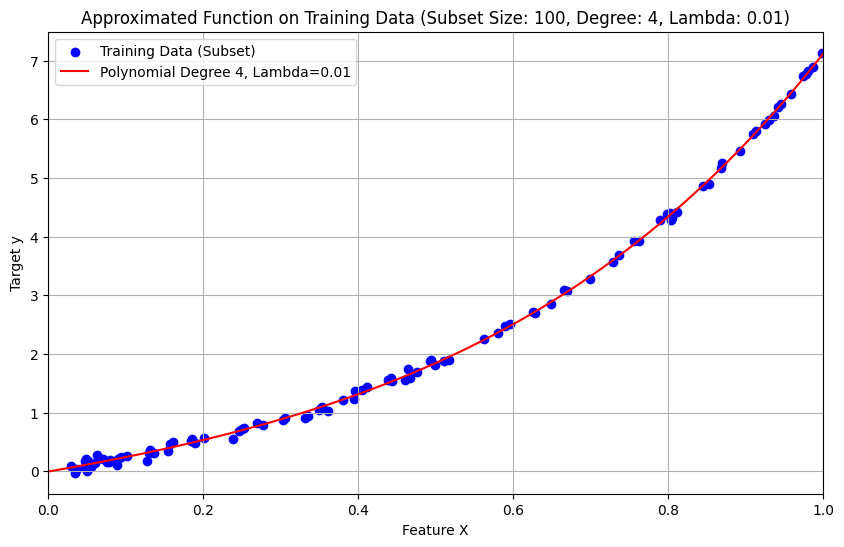

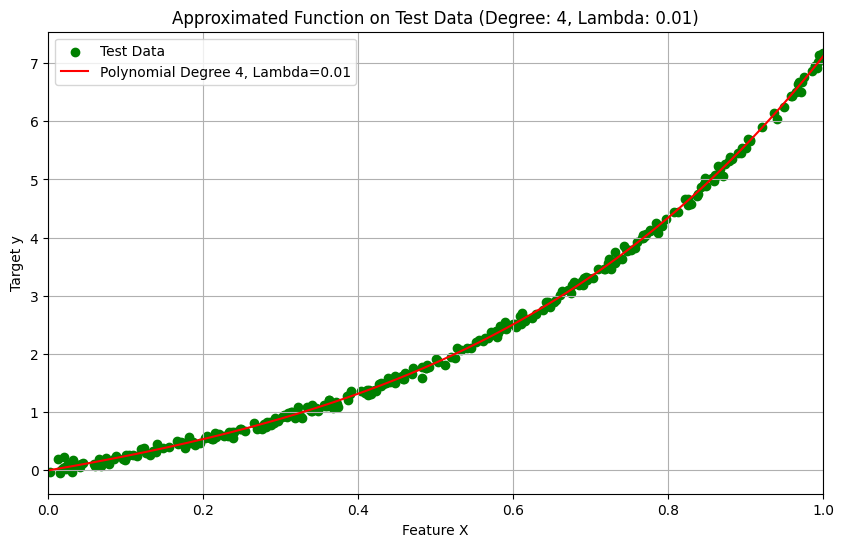


Weights for Subset Size: 100, Degree: 4, Lambda: 0.1
Weight for x^0: 0.01700468057358513
Weight for x^1: 2.140633656088132
Weight for x^2: 1.8346055842374964
Weight for x^3: 1.6085027871213893
Weight for x^4: 1.5011959048872763


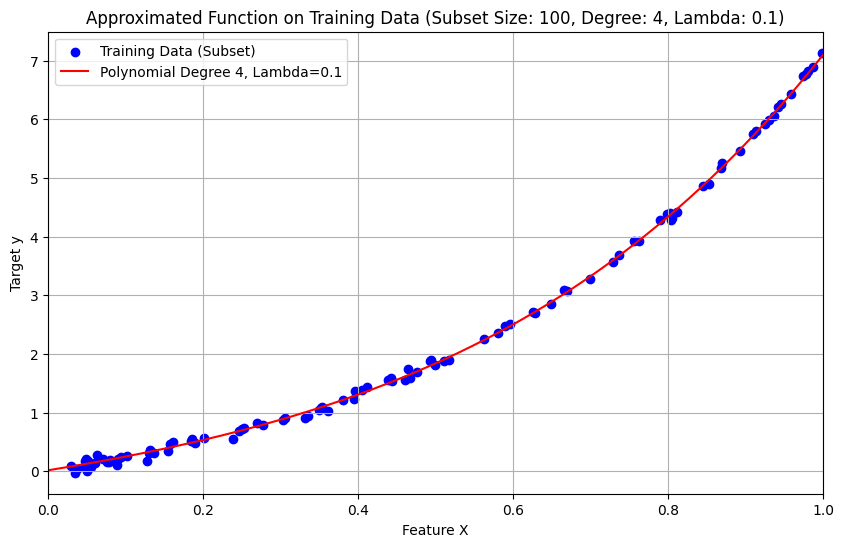

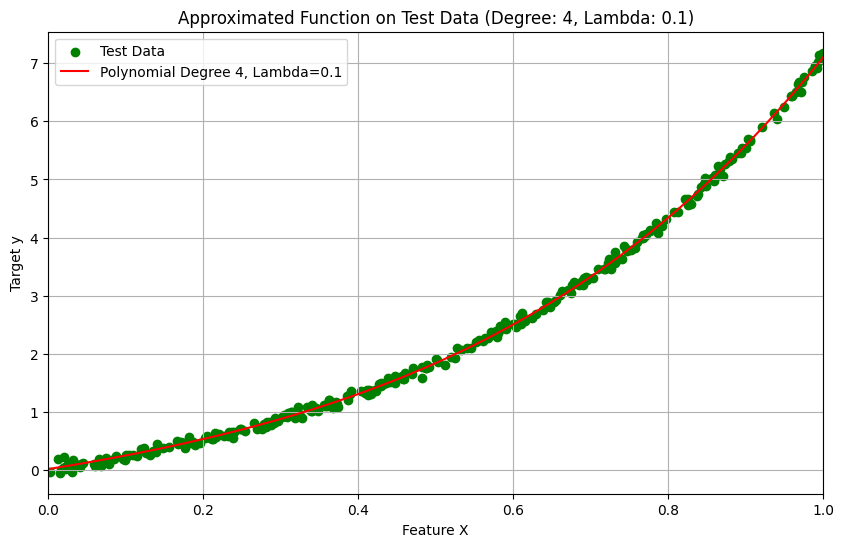


Weights for Subset Size: 100, Degree: 4, Lambda: 0.5
Weight for x^0: 0.06076629271496964
Weight for x^1: 2.011584401634222
Weight for x^2: 1.8692179963995539
Weight for x^3: 1.6480358587678214
Weight for x^4: 1.475975122876334


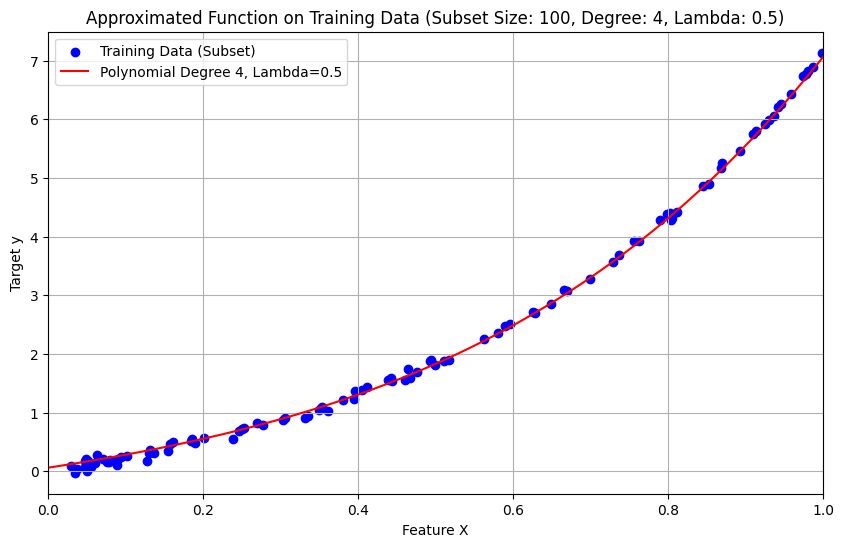

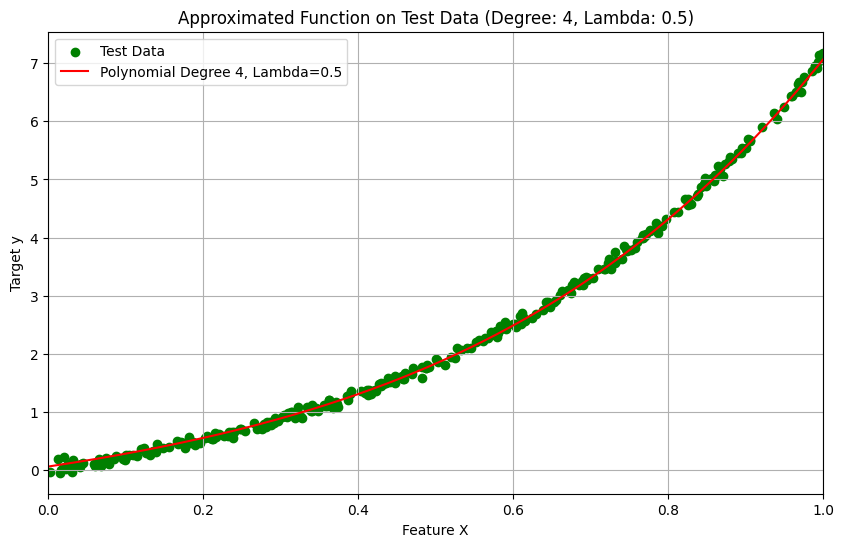


Weights for Subset Size: 100, Degree: 4, Lambda: 1.0
Weight for x^0: 0.10065330489236385
Weight for x^1: 1.9327116005029272
Weight for x^2: 1.8475038418825187
Weight for x^3: 1.65101030464943
Weight for x^4: 1.4837637139410689


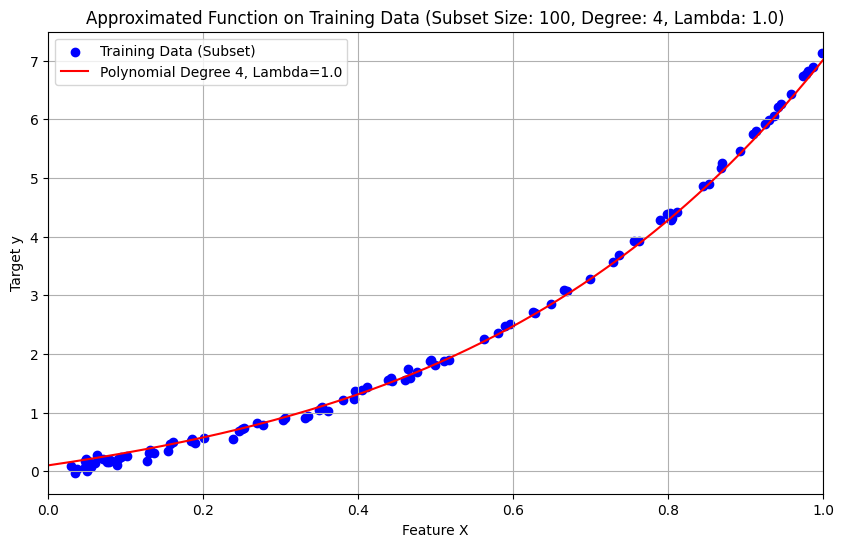

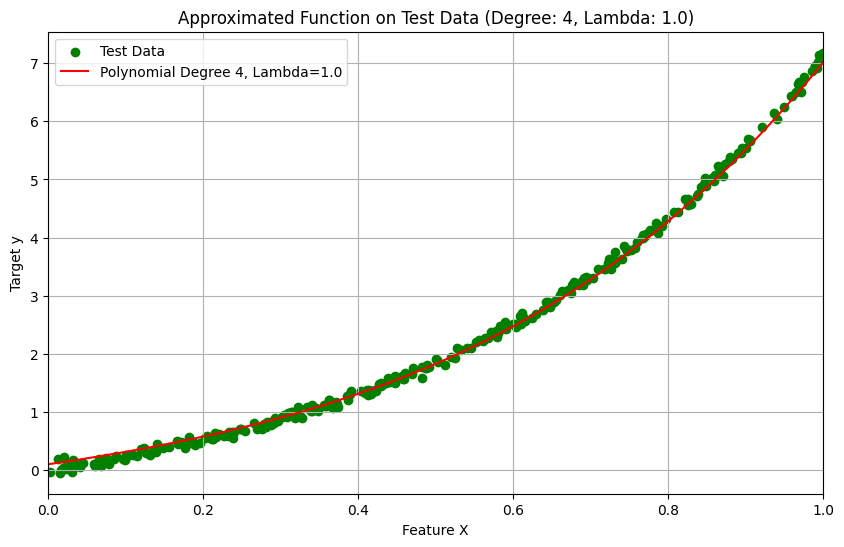


Weights for Subset Size: 100, Degree: 5, Lambda: 0.0
Weight for x^0: -0.02712339622955284
Weight for x^1: 2.8187585626356846
Weight for x^2: -2.2640176683495623
Weight for x^3: 12.882881854345072
Weight for x^4: -12.09427290594506
Weight for x^5: 5.836196266812485


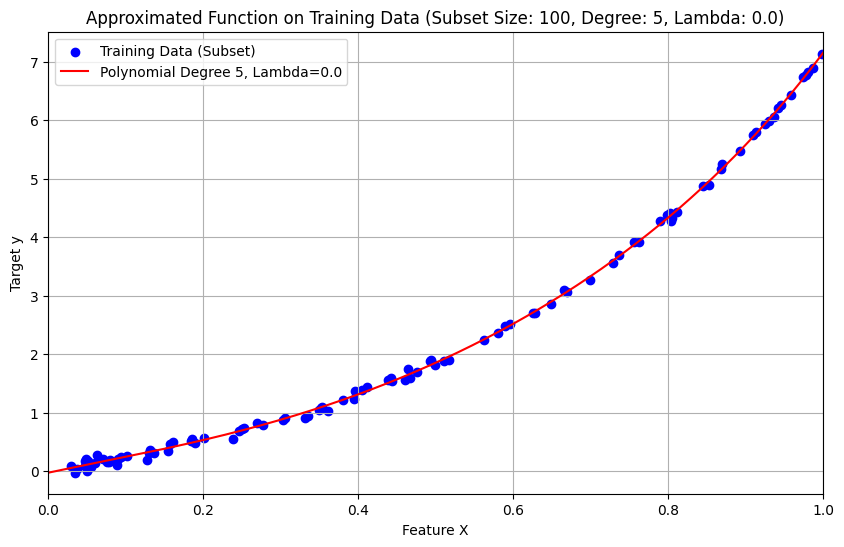

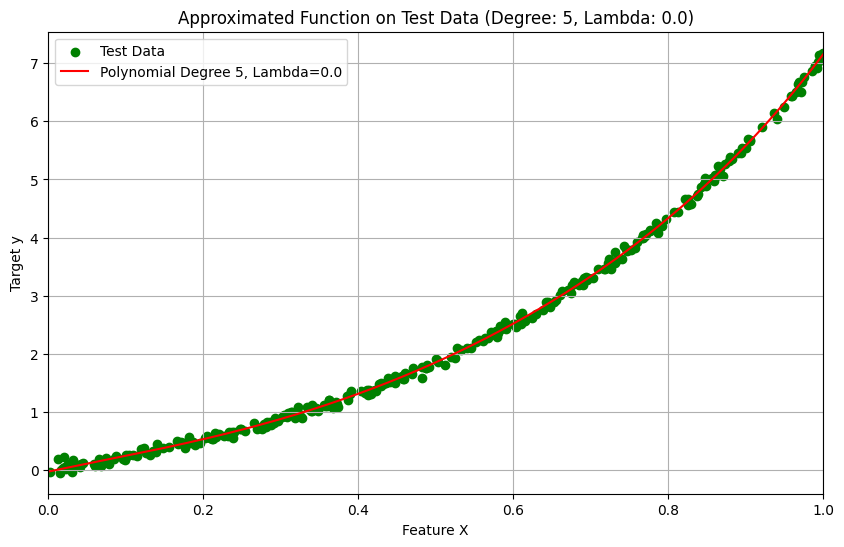


Weights for Subset Size: 100, Degree: 5, Lambda: 0.01
Weight for x^0: -0.0037957921481580207
Weight for x^1: 2.217992259271196
Weight for x^2: 1.9738362144897788
Weight for x^3: 1.397949918114806
Weight for x^4: 0.9196204135731957
Weight for x^5: 0.631668158541416


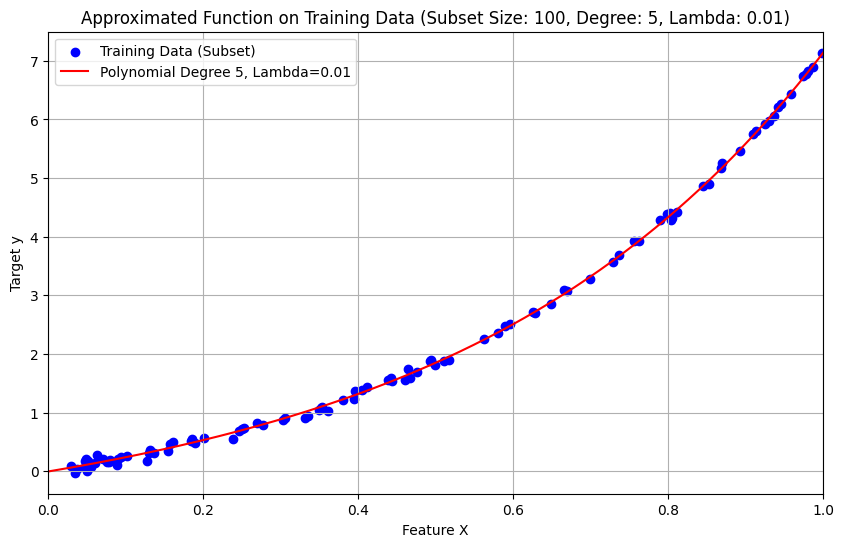

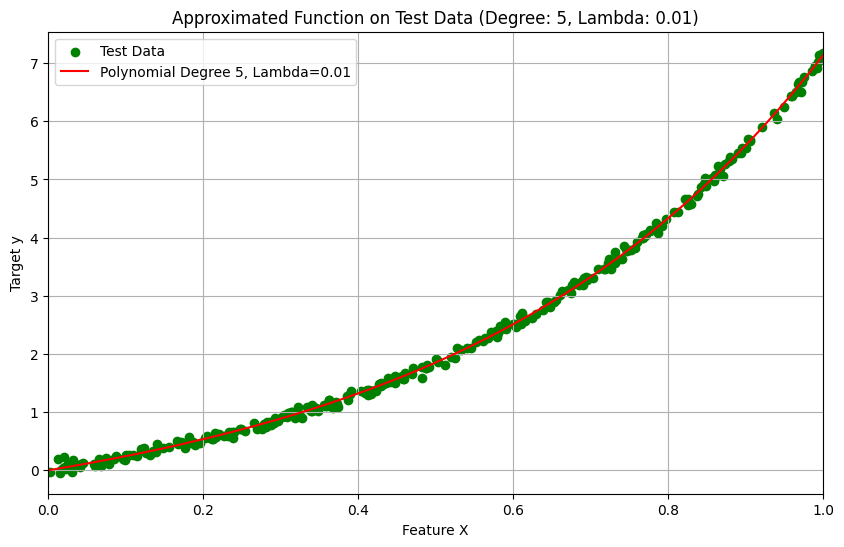


Weights for Subset Size: 100, Degree: 5, Lambda: 0.1
Weight for x^0: 0.00495991256268401
Weight for x^1: 2.2398672615085284
Weight for x^2: 1.8645023416243849
Weight for x^3: 1.3681748887425225
Weight for x^4: 0.9775115907248068
Weight for x^5: 0.6935776386461788


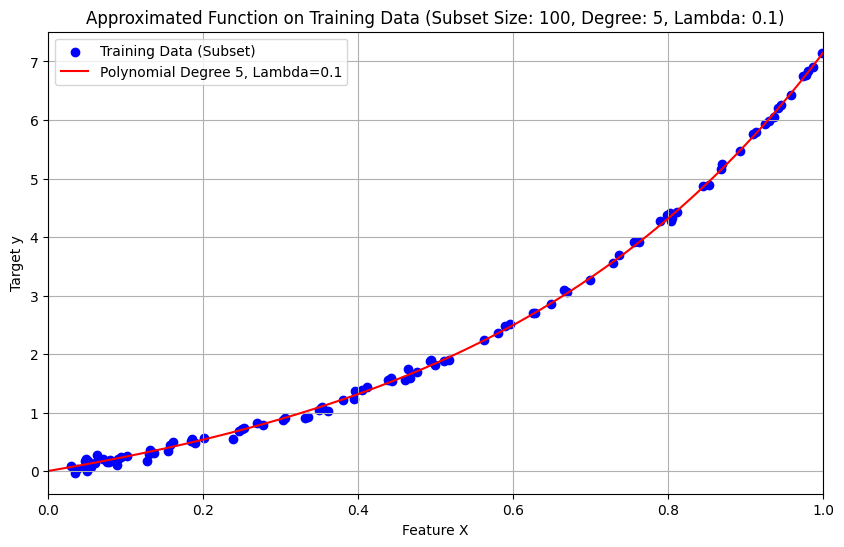

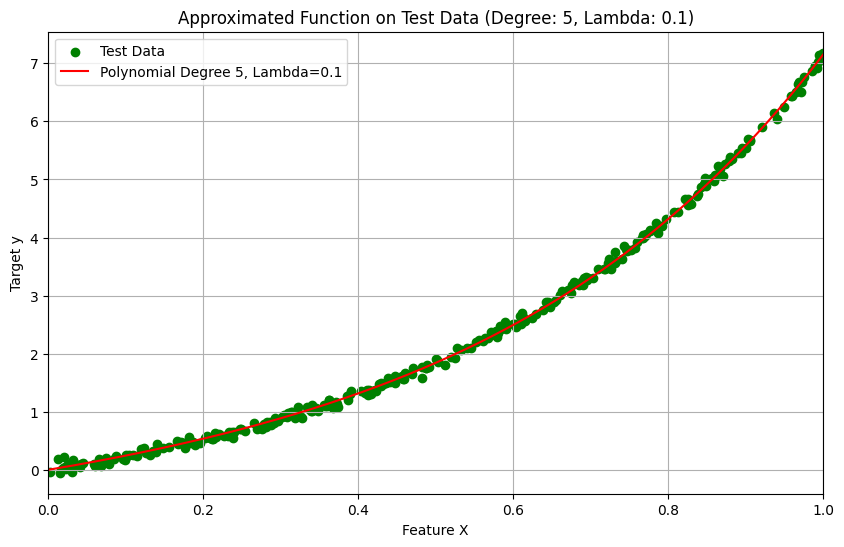


Weights for Subset Size: 100, Degree: 5, Lambda: 0.5
Weight for x^0: 0.05866180300603615
Weight for x^1: 2.120724270651359
Weight for x^2: 1.7674952497469945
Weight for x^3: 1.3552948586210483
Weight for x^4: 1.0429154374389205
Weight for x^5: 0.8147807483850392


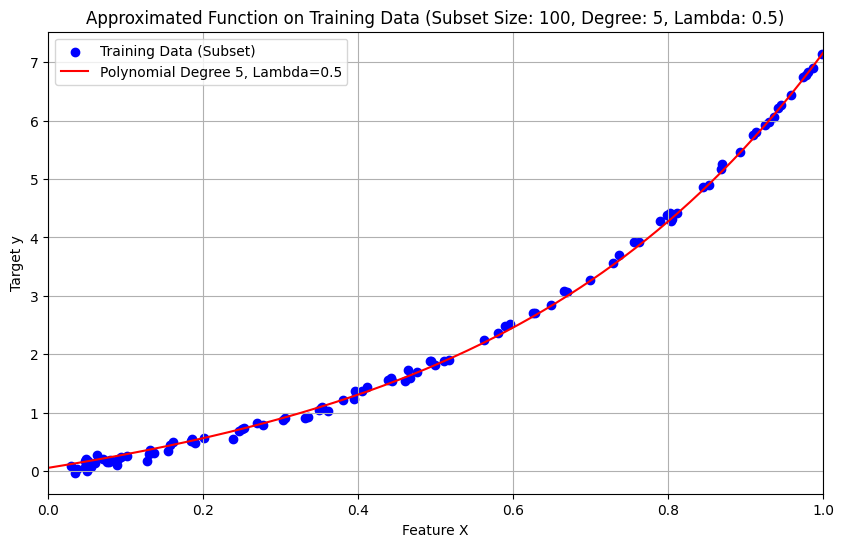

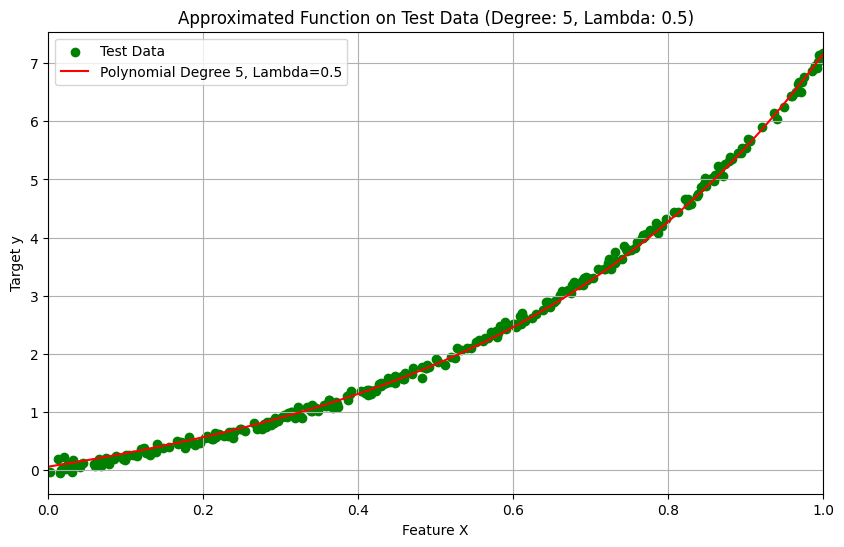


Weights for Subset Size: 100, Degree: 5, Lambda: 1.0
Weight for x^0: 0.11183902945473921
Weight for x^1: 1.9953286760188527
Weight for x^2: 1.7070396852030612
Weight for x^3: 1.3570606973981862
Weight for x^4: 1.088424477915808
Weight for x^5: 0.8892232431229204


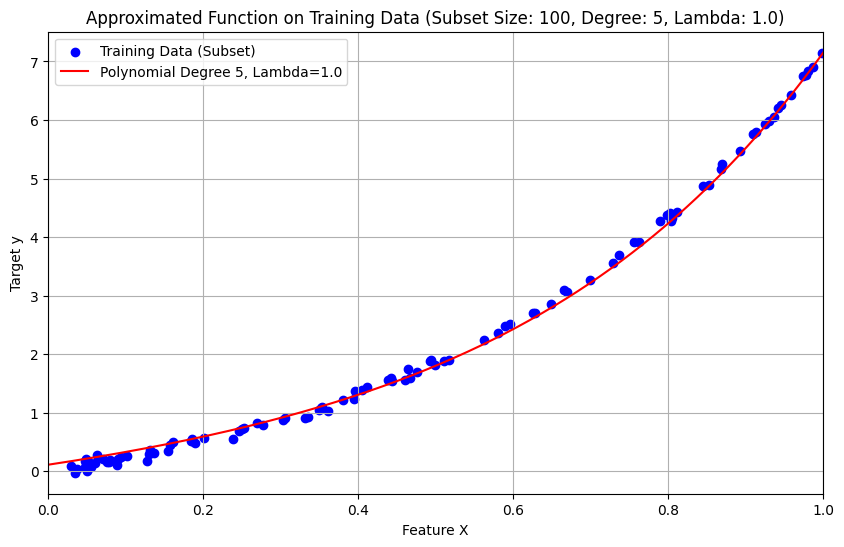

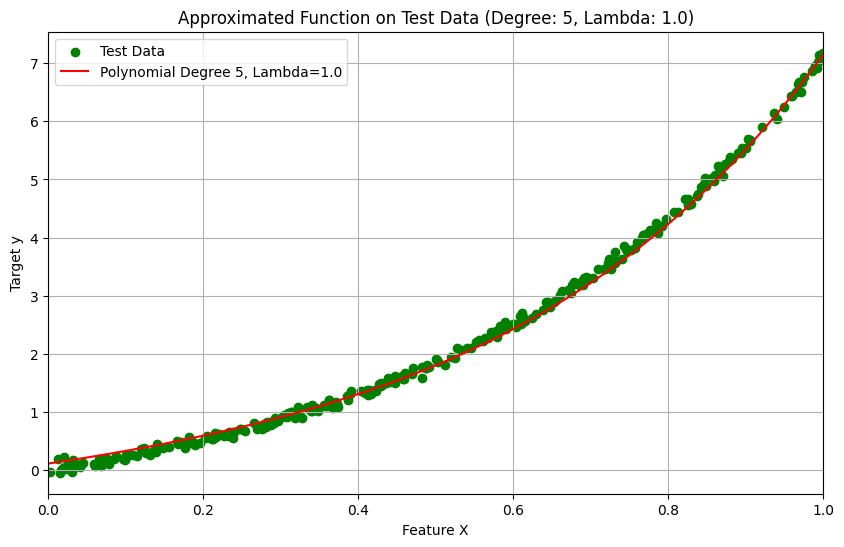


Weights for Subset Size: 100, Degree: 6, Lambda: 0.0
Weight for x^0: -0.04433929641029323
Weight for x^1: 3.34279858131223
Weight for x^2: -6.959673363723267
Weight for x^3: 30.647954553742192
Weight for x^4: -44.26245814327339
Weight for x^5: 33.447486097920795
Weight for x^6: -9.026722527943452


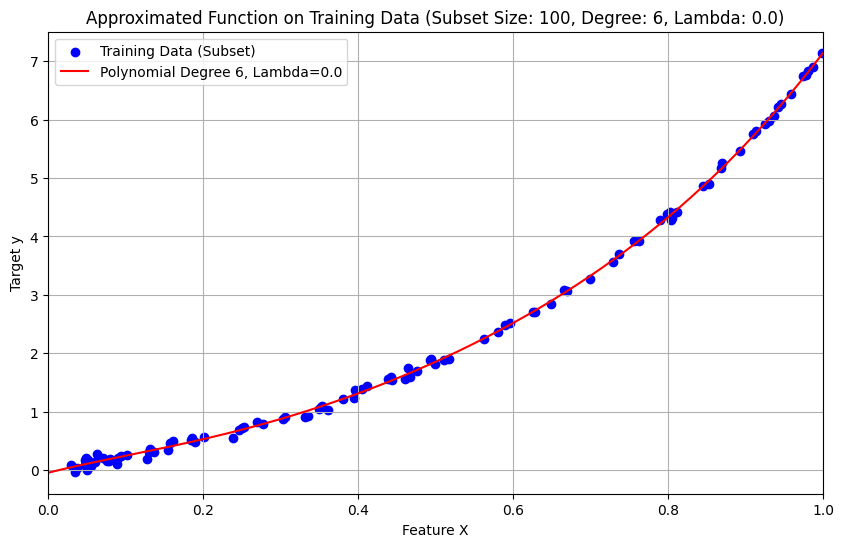

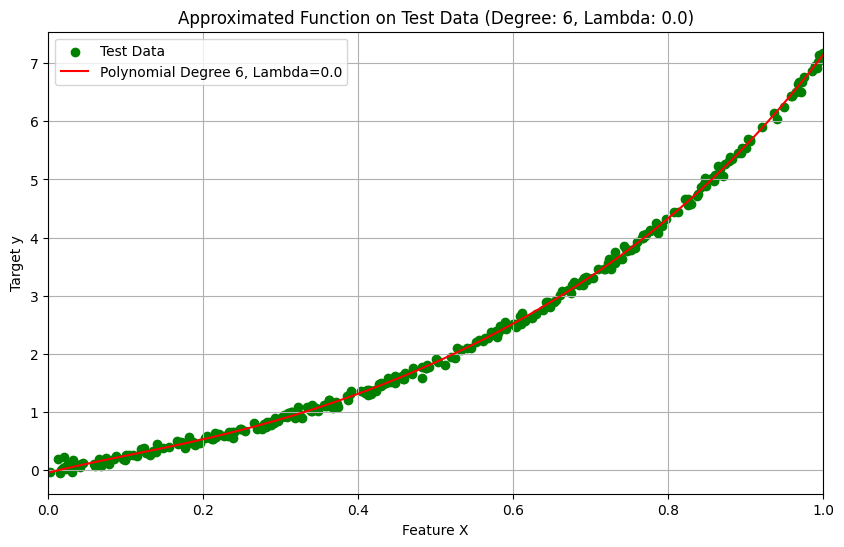


Weights for Subset Size: 100, Degree: 6, Lambda: 0.01
Weight for x^0: -0.002563717845724185
Weight for x^1: 2.1958971959796254
Weight for x^2: 2.029448136078179
Weight for x^3: 1.4314444556827894
Weight for x^4: 0.8570580746848945
Weight for x^5: 0.44408573342993163
Weight for x^6: 0.18661663994738958


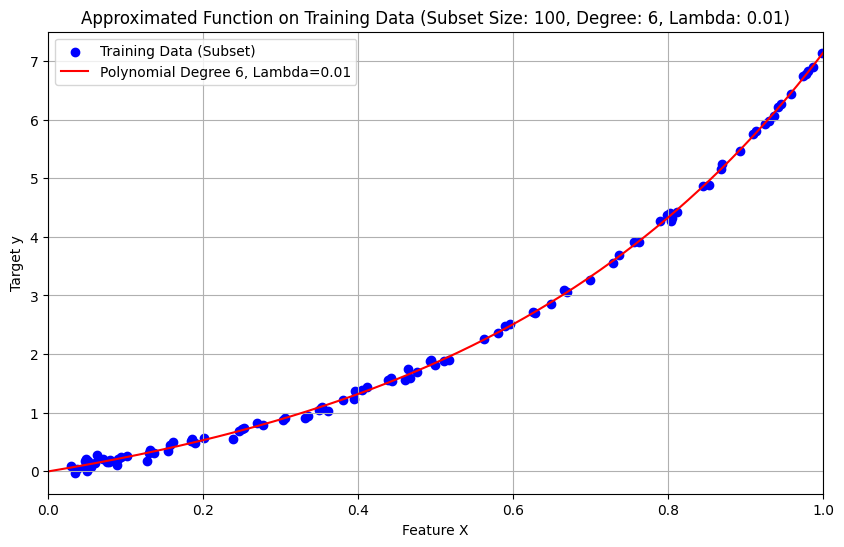

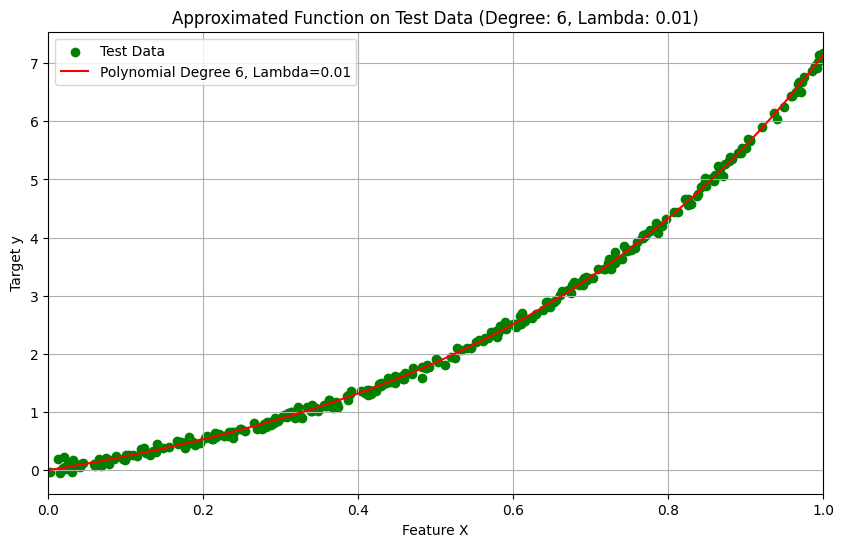


Weights for Subset Size: 100, Degree: 6, Lambda: 0.1
Weight for x^0: 0.0019945688165850725
Weight for x^1: 2.25435905453847
Weight for x^2: 1.8992774800145729
Weight for x^3: 1.346389395895139
Weight for x^4: 0.8798159786441913
Weight for x^5: 0.5238984877765992
Weight for x^6: 0.2591484862883054


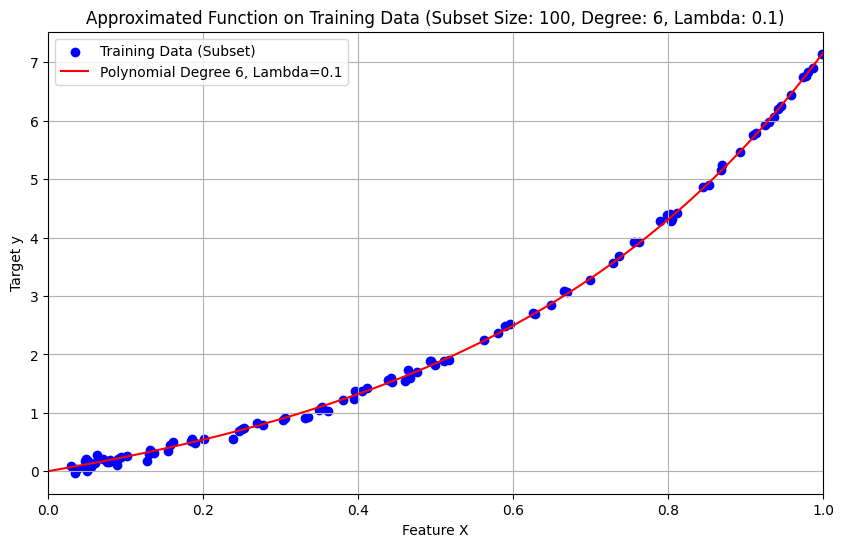

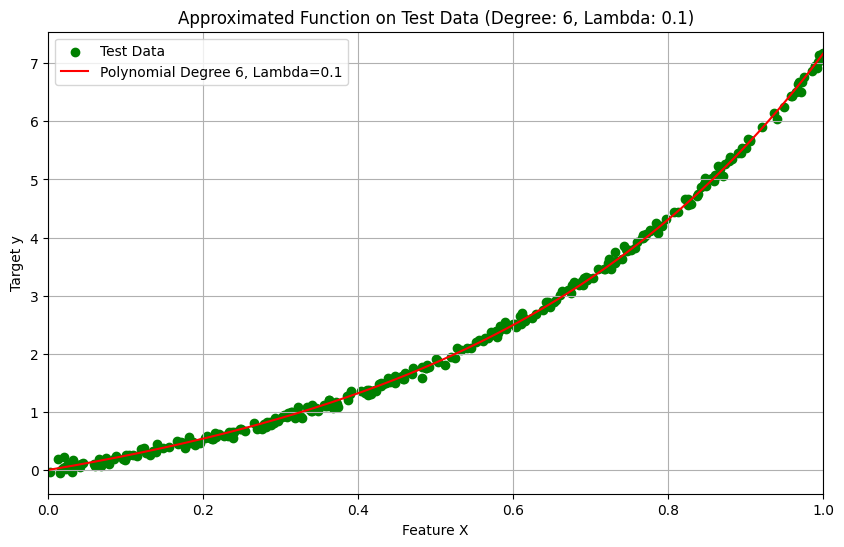


Weights for Subset Size: 100, Degree: 6, Lambda: 0.5
Weight for x^0: 0.055203182168666
Weight for x^1: 2.169370751885075
Weight for x^2: 1.7573287301689011
Weight for x^3: 1.274056144664771
Weight for x^4: 0.9014103071888079
Weight for x^5: 0.626539488222424
Weight for x^6: 0.4231228926757965


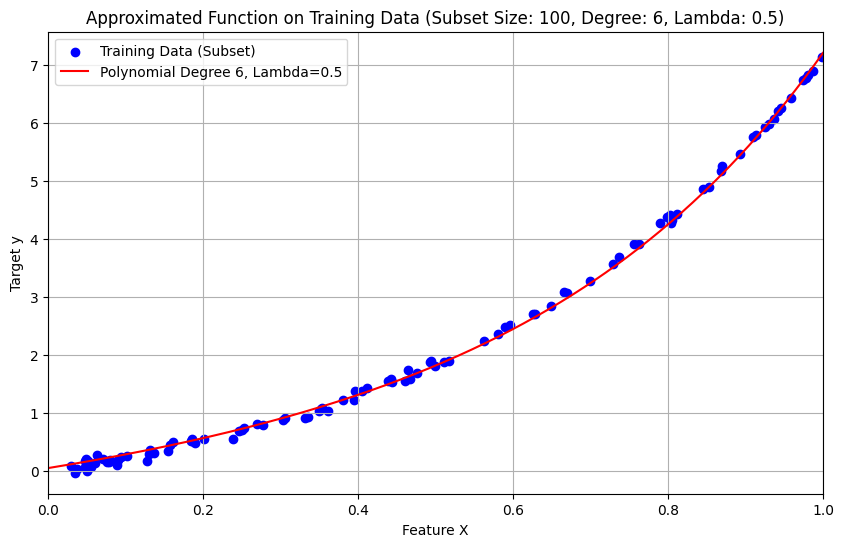

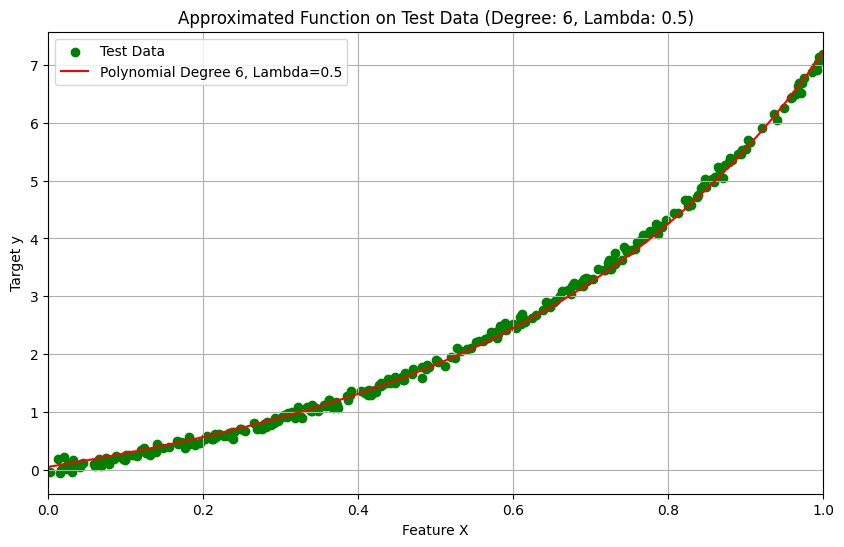


Weights for Subset Size: 100, Degree: 6, Lambda: 1.0
Weight for x^0: 0.1133812990090154
Weight for x^1: 2.038449035711082
Weight for x^2: 1.672200882077207
Weight for x^3: 1.2522837263415756
Weight for x^4: 0.9317940056136217
Weight for x^5: 0.695678112876737
Weight for x^6: 0.5201172454288423


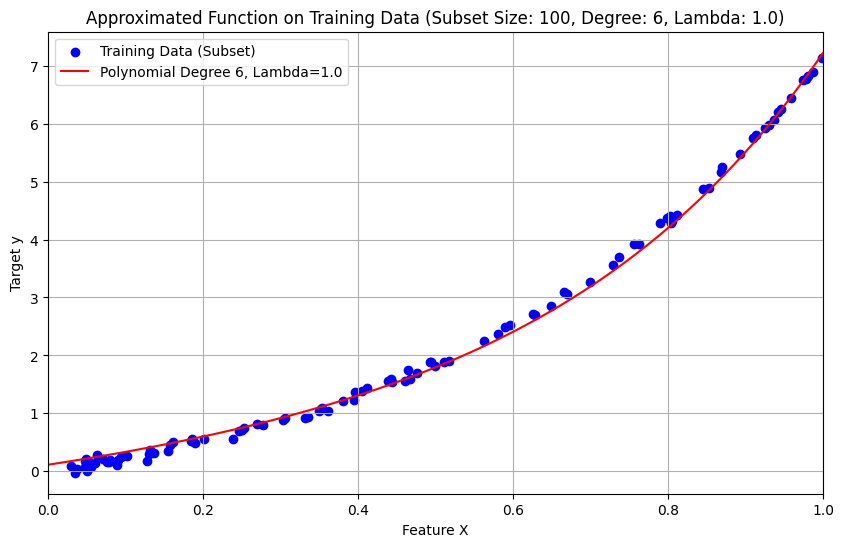

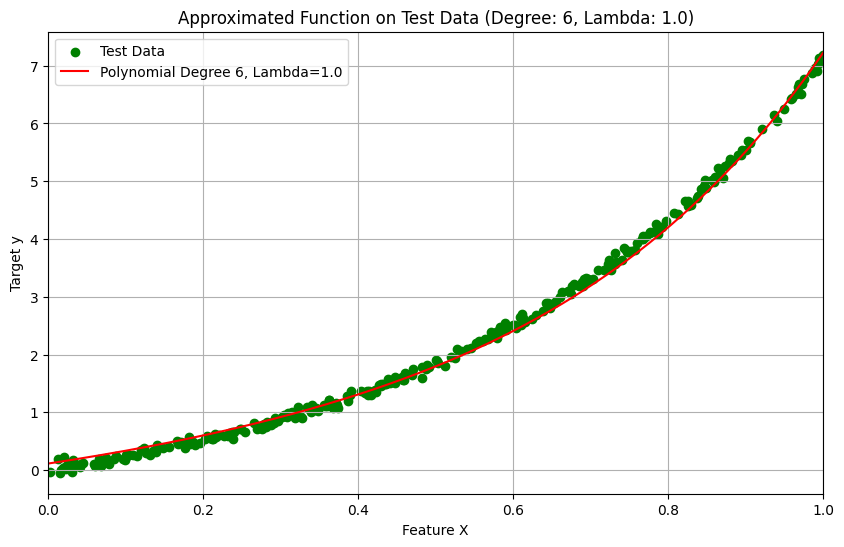


Weights for Subset Size: 100, Degree: 7, Lambda: 0.0
Weight for x^0: -0.02936418329450447
Weight for x^1: 2.801950465535549
Weight for x^2: -0.765488362900937
Weight for x^3: -0.9755724719328978
Weight for x^4: 38.31515201892751
Weight for x^5: -81.26190680446383
Weight for x^6: 71.58107481684434
Weight for x^7: -22.525420419496154


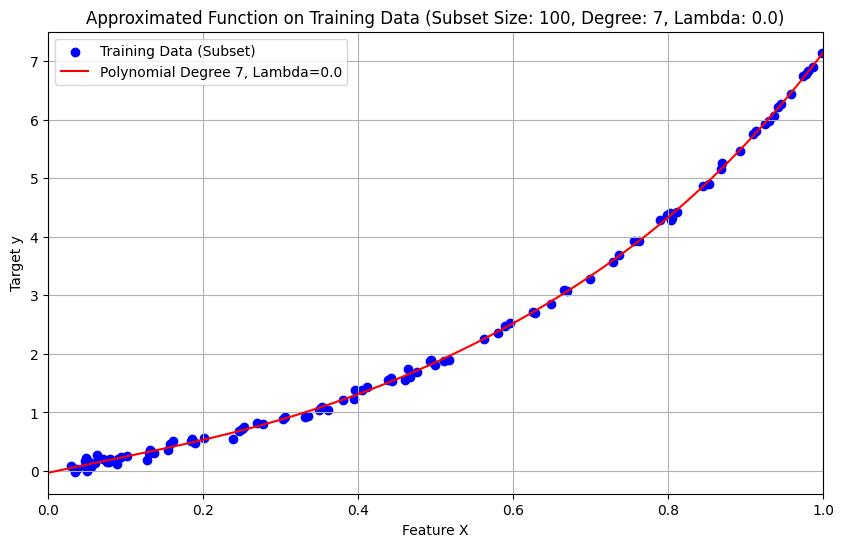

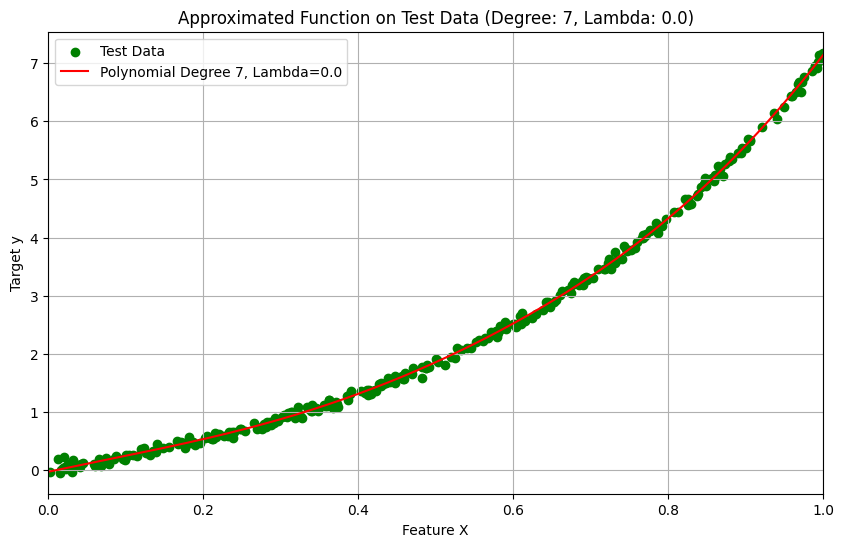


Weights for Subset Size: 100, Degree: 7, Lambda: 0.01
Weight for x^0: -0.002442314945674989
Weight for x^1: 2.1941938761831006
Weight for x^2: 2.0320890075877345
Weight for x^3: 1.435542224861242
Weight for x^4: 0.8571116638909273
Weight for x^5: 0.43680610901800687
Weight for x^6: 0.17071526514822485
Weight for x^7: 0.018411147730450023


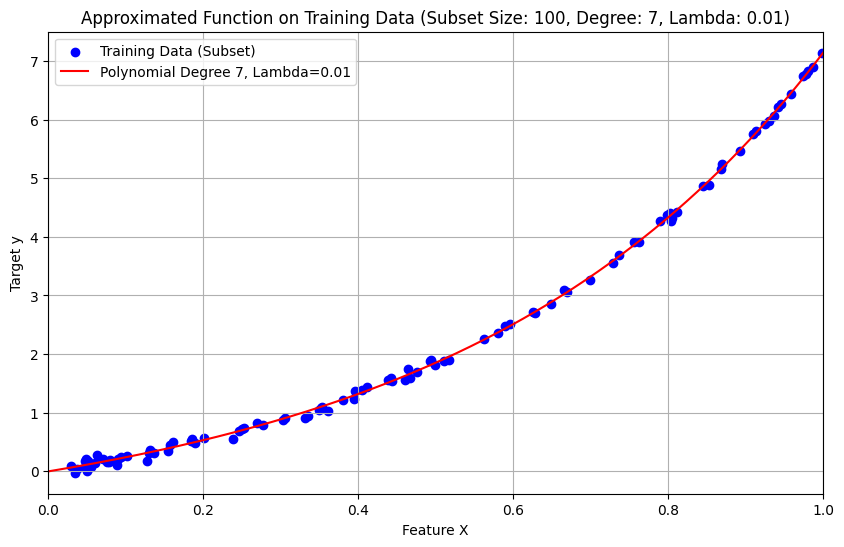

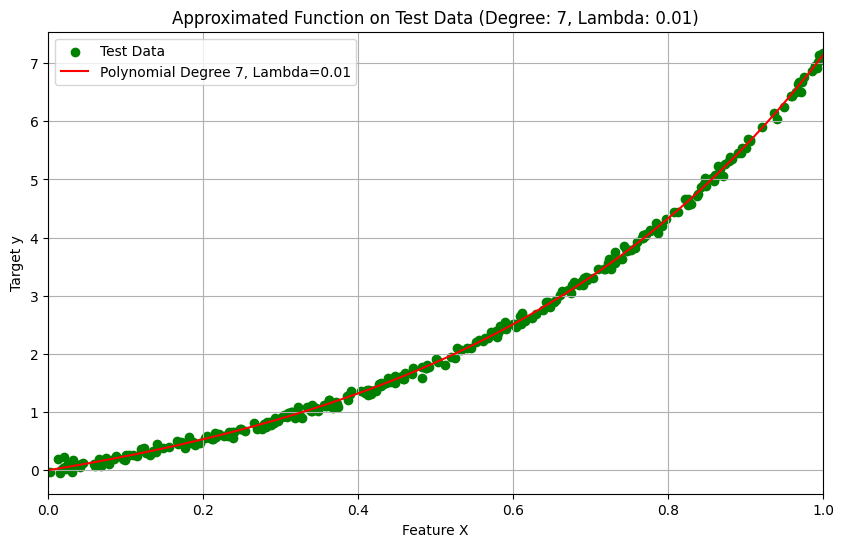


Weights for Subset Size: 100, Degree: 7, Lambda: 0.1
Weight for x^0: 0.0017655109741576303
Weight for x^1: 2.2544828324196593
Weight for x^2: 1.904517452610729
Weight for x^3: 1.3476623193021846
Weight for x^4: 0.8738169051590637
Weight for x^5: 0.5102293677590206
Weight for x^6: 0.23849494321458506
Weight for x^7: 0.0360362948835213


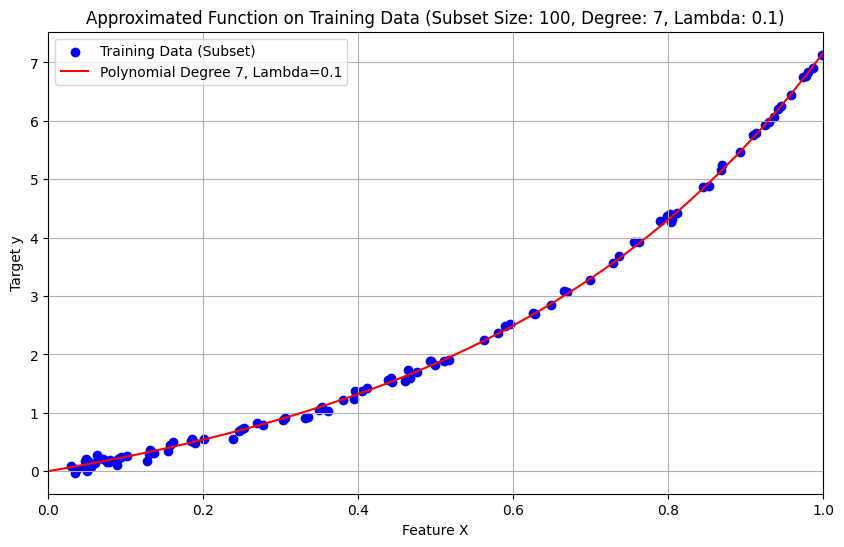

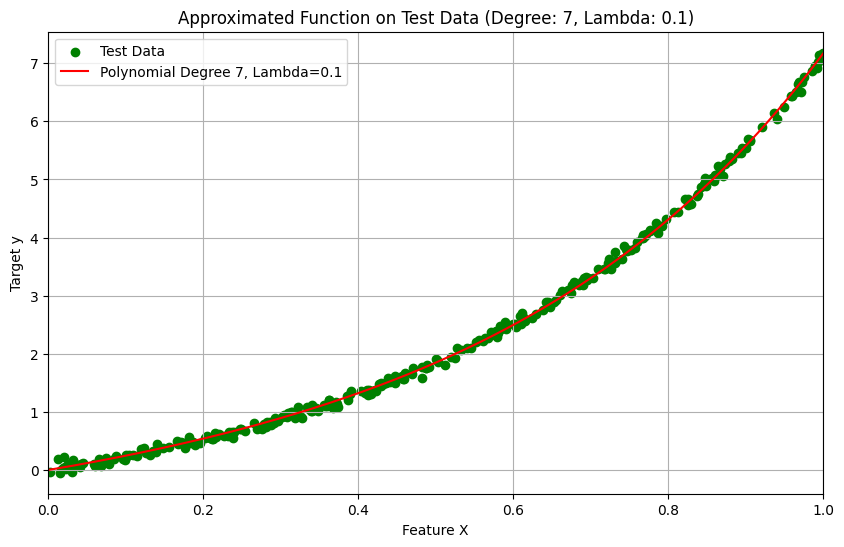


Weights for Subset Size: 100, Degree: 7, Lambda: 0.5
Weight for x^0: 0.053359329845573546
Weight for x^1: 2.1861069146917305
Weight for x^2: 1.7620043871759172
Weight for x^3: 1.2564975202014306
Weight for x^4: 0.8621828773250853
Weight for x^5: 0.5690411926421751
Weight for x^6: 0.3510163625888327
Weight for x^7: 0.18710352082792409


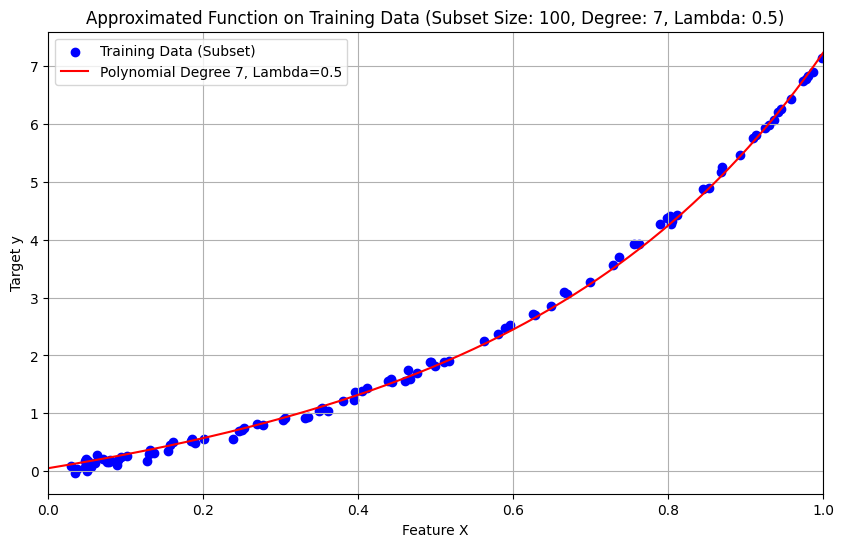

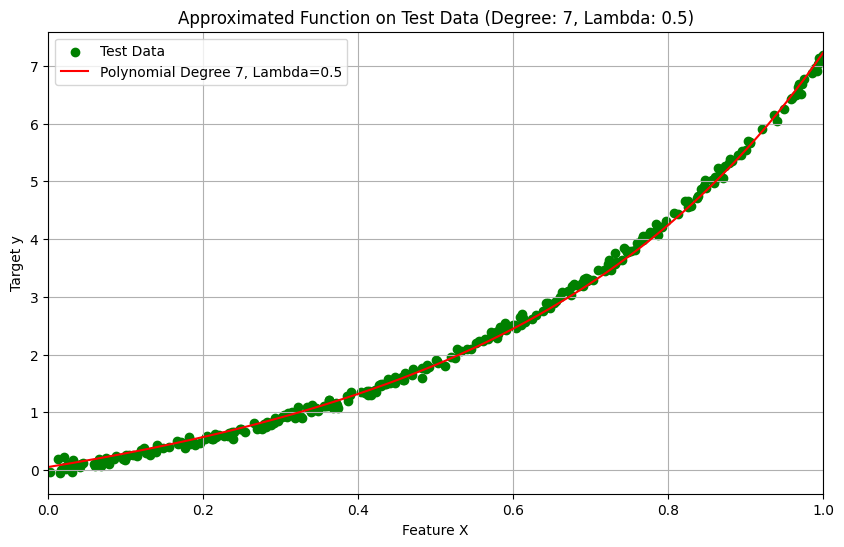


Weights for Subset Size: 100, Degree: 7, Lambda: 1.0
Weight for x^0: 0.112743086697745
Weight for x^1: 2.060967271270614
Weight for x^2: 1.6673984371194568
Weight for x^3: 1.2178416737427262
Weight for x^4: 0.872979840672161
Weight for x^5: 0.6181329607141053
Weight for x^6: 0.42852930918642085
Weight for x^7: 0.2853777947231603


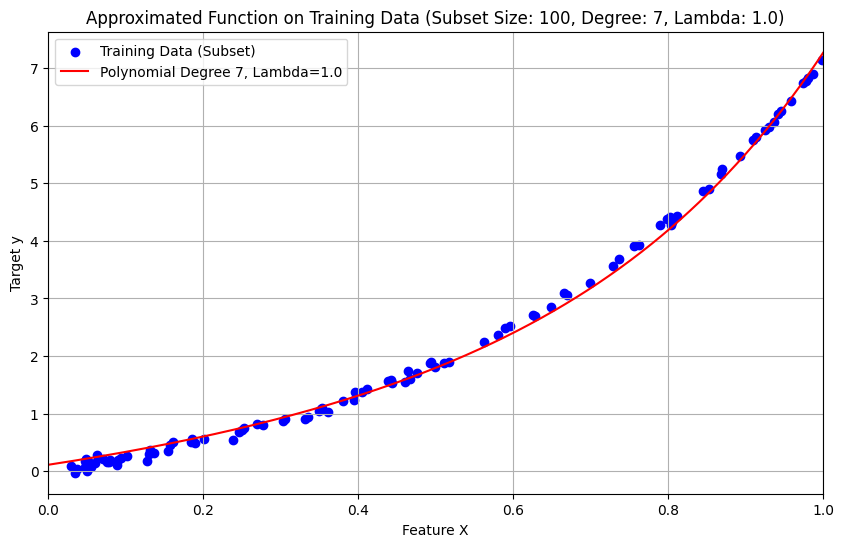

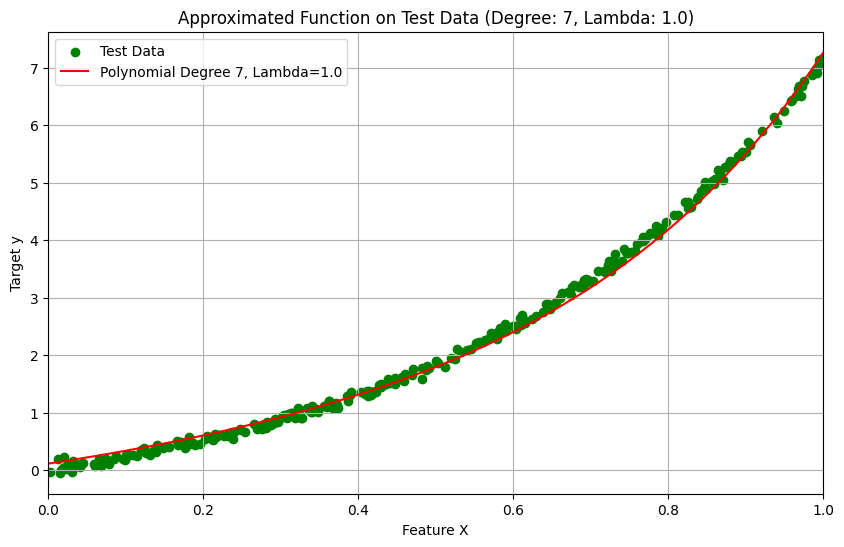


Weights for Subset Size: 100, Degree: 8, Lambda: 0.0
Weight for x^0: 0.03731332211329819
Weight for x^1: -0.014132570544335985
Weight for x^2: 39.221548646103734
Weight for x^3: -264.5313654837444
Weight for x^4: 964.993993564565
Weight for x^5: -1926.131505622451
Weight for x^6: 2154.885797476089
Weight for x^7: -1265.3389660568344
Weight for x^8: 304.0328170867914


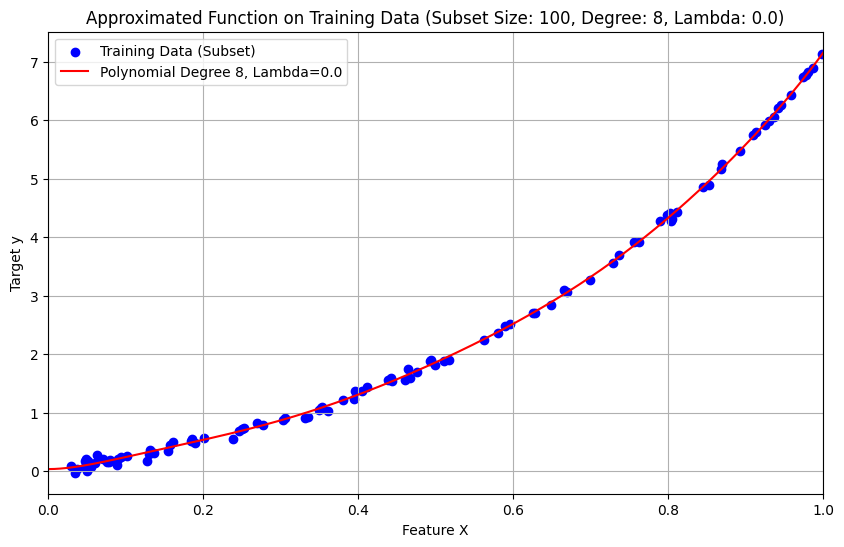

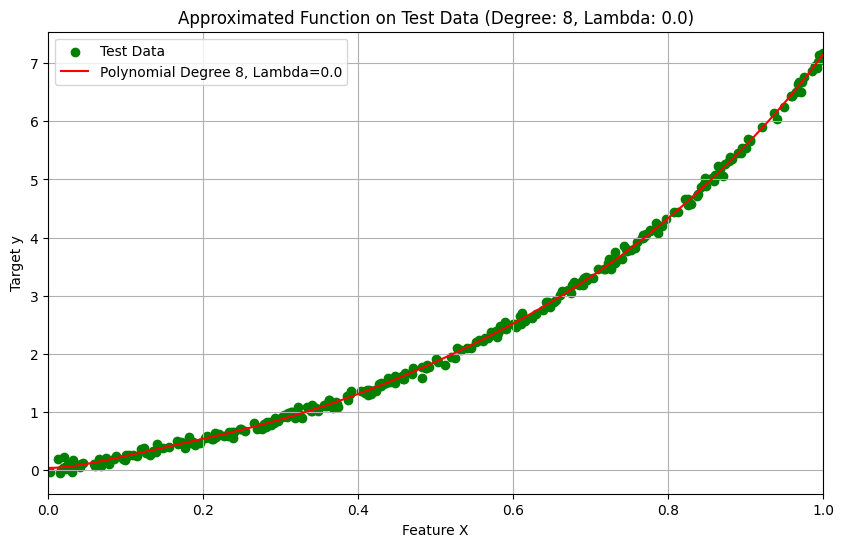


Weights for Subset Size: 100, Degree: 8, Lambda: 0.01
Weight for x^0: -0.0025852973126170085
Weight for x^1: 2.1958342597396086
Weight for x^2: 2.0310713298040795
Weight for x^3: 1.4304477137719178
Weight for x^4: 0.853604106833657
Weight for x^5: 0.4394708847814025
Weight for x^6: 0.18205382991938807
Weight for x^7: 0.03939453602847429
Weight for x^8: -0.02749858332322753


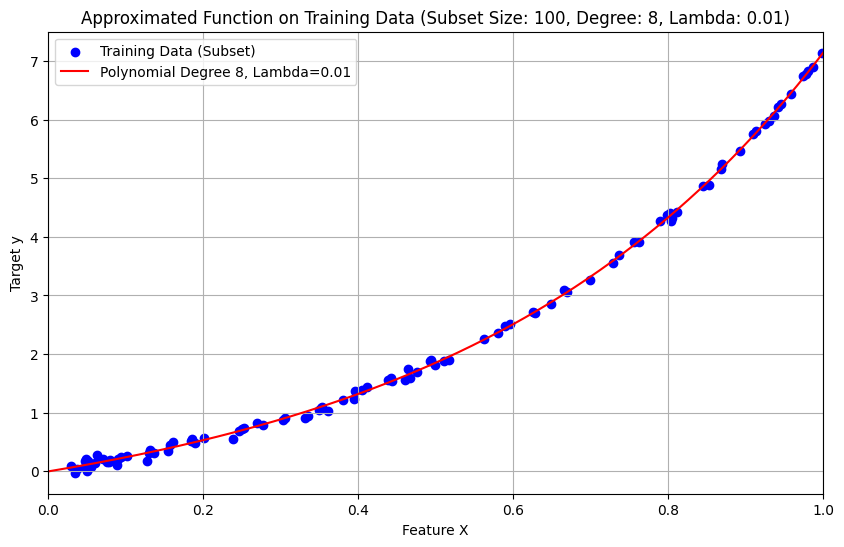

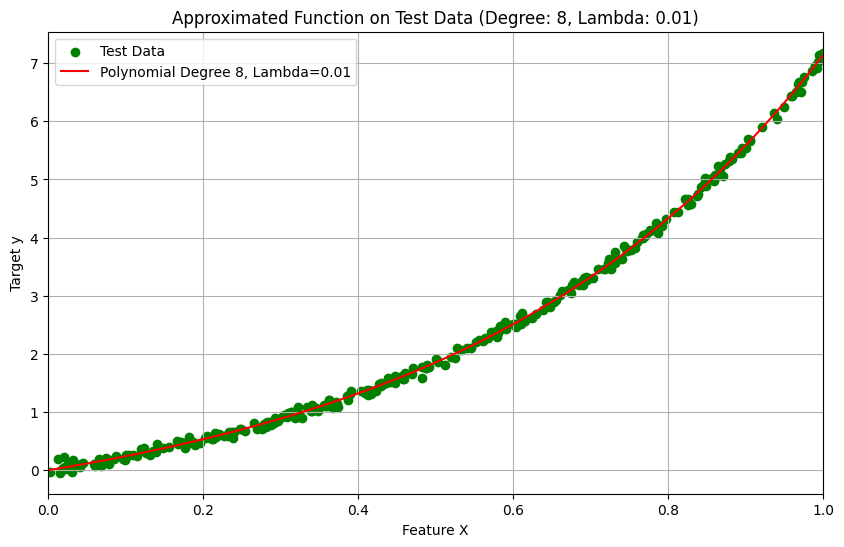


Weights for Subset Size: 100, Degree: 8, Lambda: 0.1
Weight for x^0: 0.001959867312380126
Weight for x^1: 2.2562333565191497
Weight for x^2: 1.8953942688289123
Weight for x^3: 1.3416621074383703
Weight for x^4: 0.8773879705304857
Weight for x^5: 0.5251315753118576
Weight for x^6: 0.26441851825493723
Weight for x^7: 0.07188146492771723
Weight for x^8: -0.071038739752424


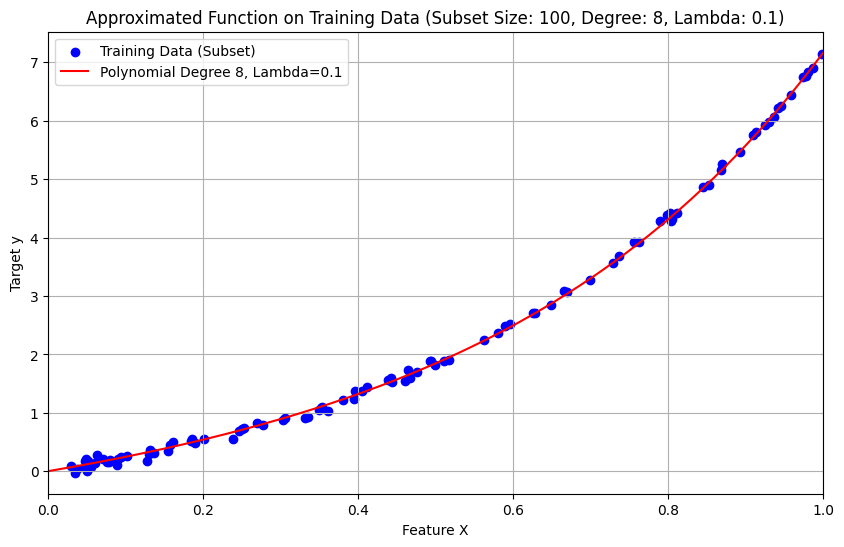

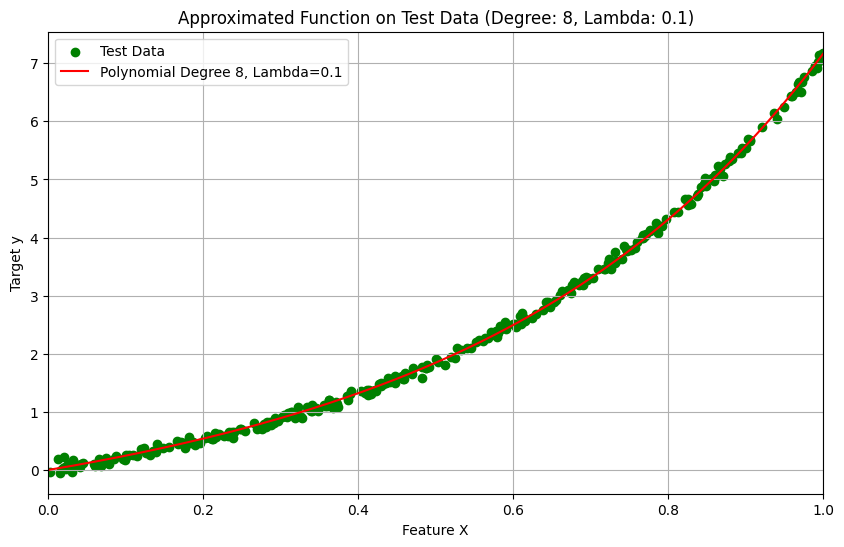


Weights for Subset Size: 100, Degree: 8, Lambda: 0.5
Weight for x^0: 0.05292108421334932
Weight for x^1: 2.1890620949135293
Weight for x^2: 1.7641502022645554
Weight for x^3: 1.2549411194441178
Weight for x^4: 0.8564525458814615
Weight for x^5: 0.5595182523329553
Weight for x^6: 0.3382973172617355
Weight for x^7: 0.17177957473409228
Weight for x^8: 0.04494555993828145


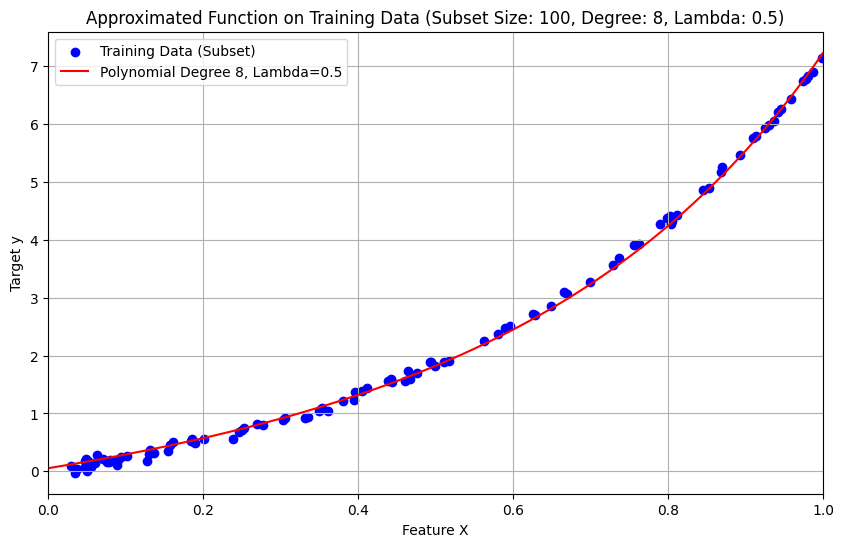

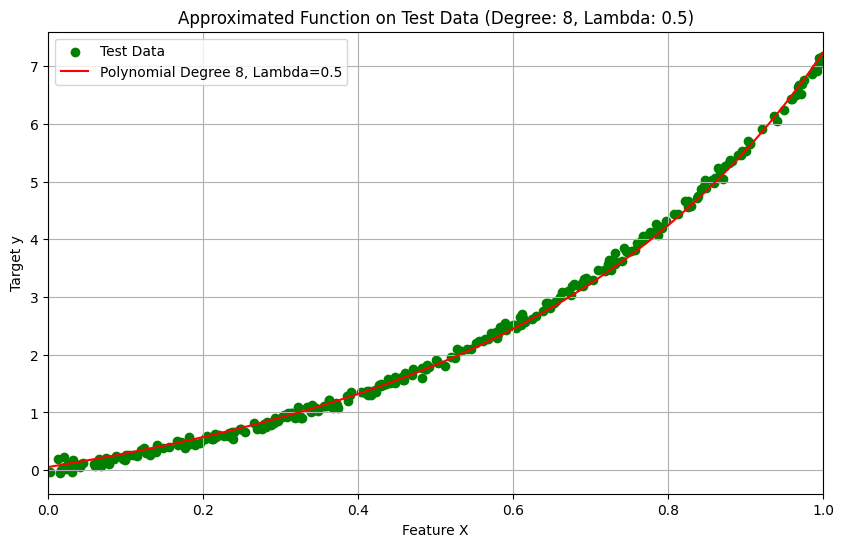


Weights for Subset Size: 100, Degree: 8, Lambda: 1.0
Weight for x^0: 0.11207874072556127
Weight for x^1: 2.0702640605951004
Weight for x^2: 1.6689083032536143
Weight for x^3: 1.2086845111070514
Weight for x^4: 0.8541398194495294
Weight for x^5: 0.591352496040705
Weight for x^6: 0.3954793120848116
Weight for x^7: 0.24746553883432829
Weight for x^8: 0.13403339456583413


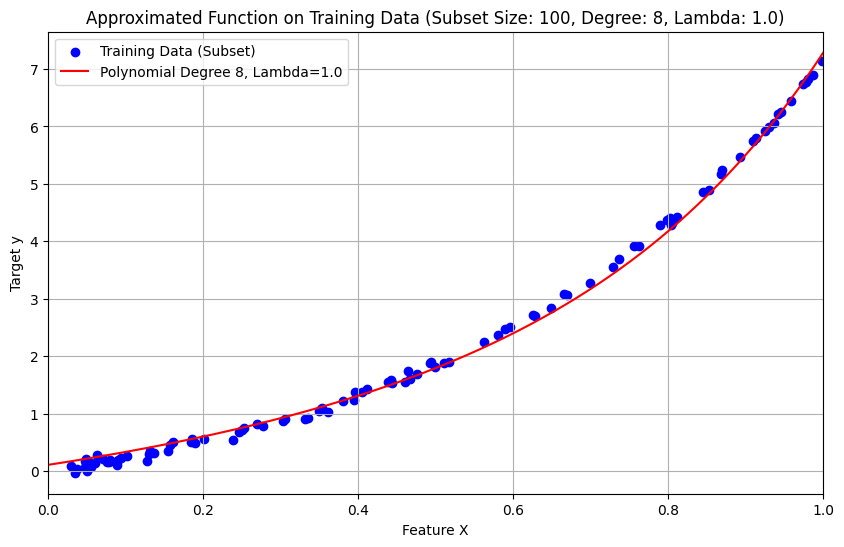

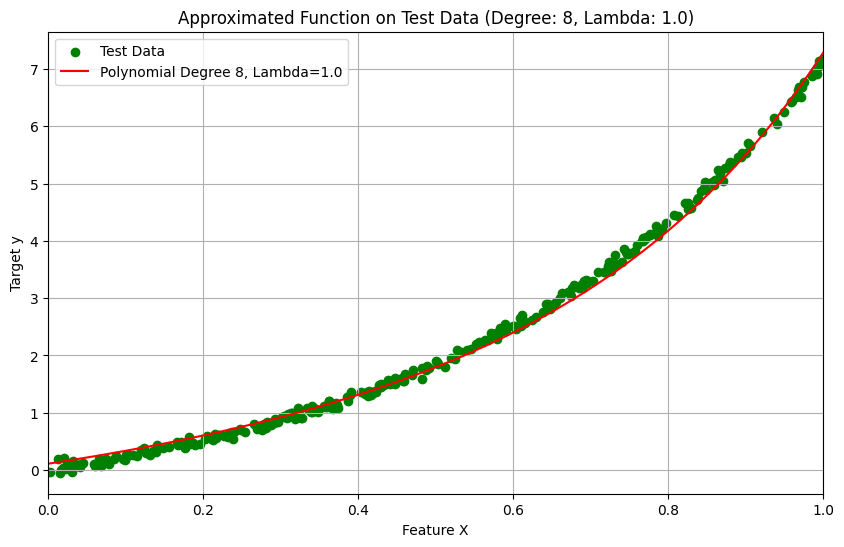


Weights for Subset Size: 100, Degree: 9, Lambda: 0.0
Weight for x^0: 0.018282341949717278
Weight for x^1: 0.916623608263907
Weight for x^2: 23.221251049094086
Weight for x^3: -132.77222856159597
Weight for x^4: 368.13508102768236
Weight for x^5: -332.5950131062939
Weight for x^6: -413.9138773999306
Weight for x^7: 1189.1518943139863
Weight for x^8: -974.5932378479439
Weight for x^9: 279.5905457891227


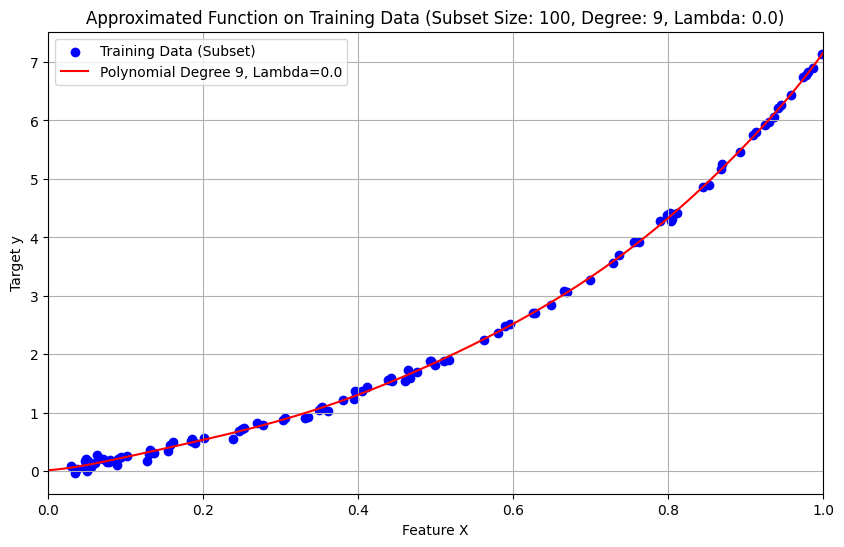

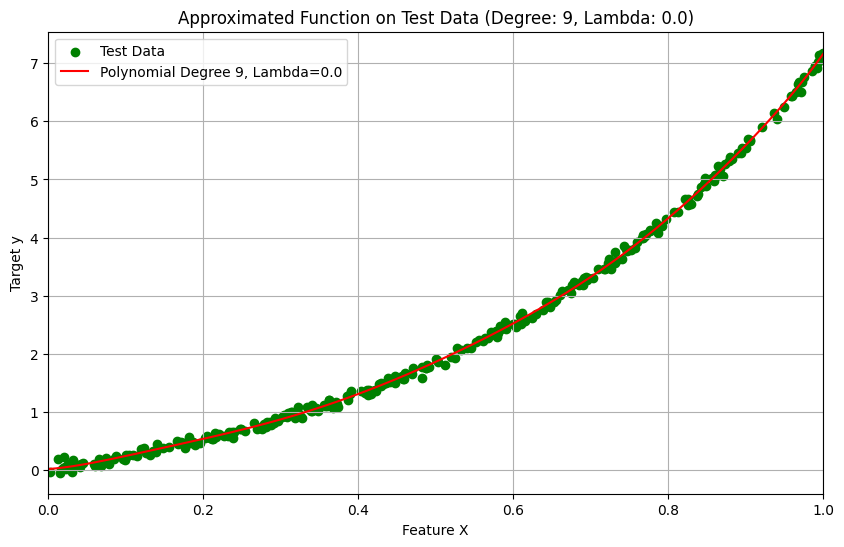


Weights for Subset Size: 100, Degree: 9, Lambda: 0.01
Weight for x^0: -0.0026688951474439656
Weight for x^1: 2.196566616193428
Weight for x^2: 2.0317279436143334
Weight for x^3: 1.4273661479828228
Weight for x^4: 0.8498414495174362
Weight for x^5: 0.4383647138266114
Weight for x^6: 0.18582136036132293
Weight for x^7: 0.04921215630274851
Weight for x^8: -0.011176958281784862
Weight for x^9: -0.02379294219665142


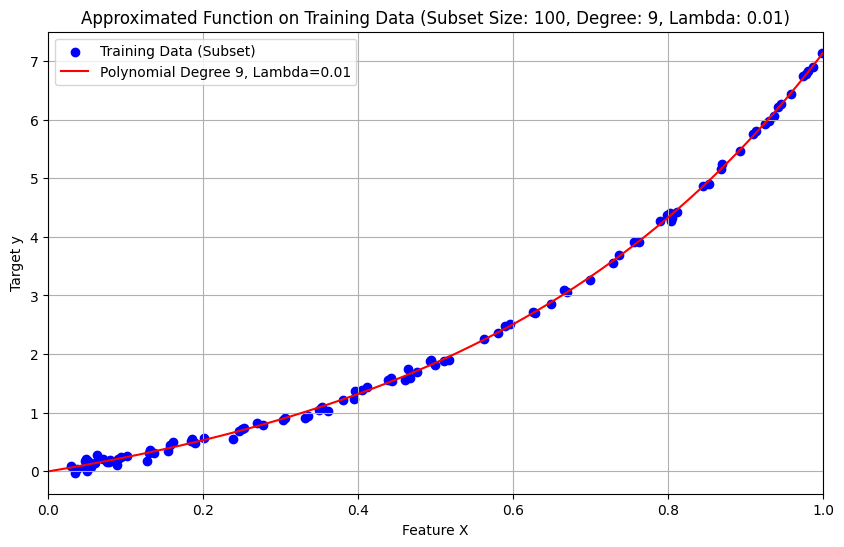

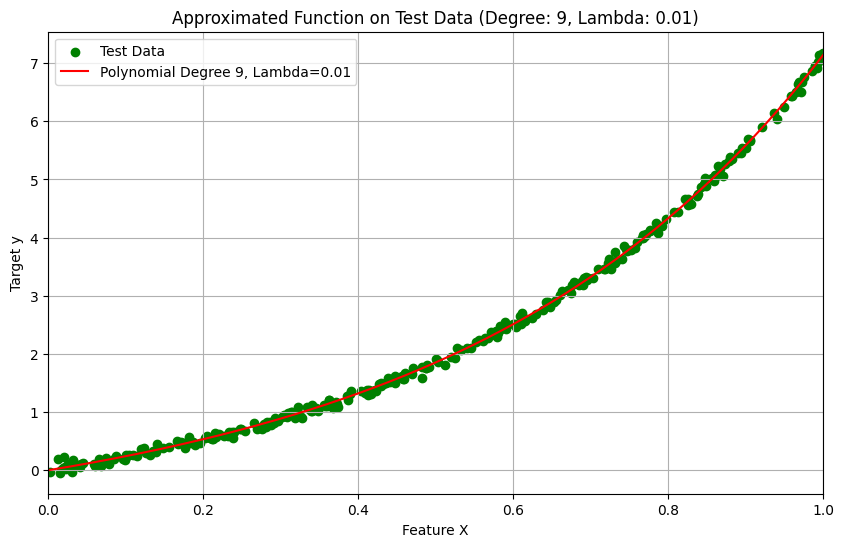


Weights for Subset Size: 100, Degree: 9, Lambda: 0.1
Weight for x^0: 0.002000192490933293
Weight for x^1: 2.2606019709177465
Weight for x^2: 1.883411587117624
Weight for x^3: 1.330178470171061
Weight for x^4: 0.8758948251345601
Weight for x^5: 0.5372244739291042
Weight for x^6: 0.29068400288138635
Weight for x^7: 0.11154285184668639
Weight for x^8: -0.01929729549638968
Weight for x^9: -0.11544758489578702


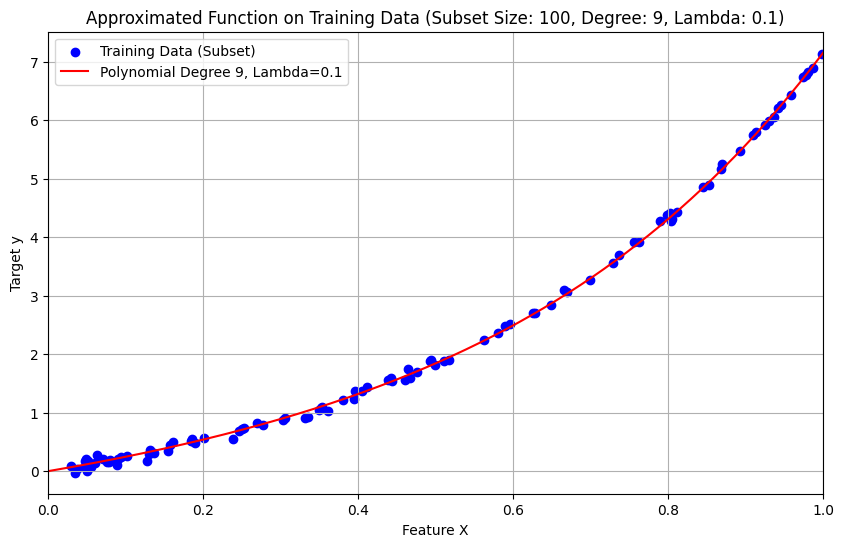

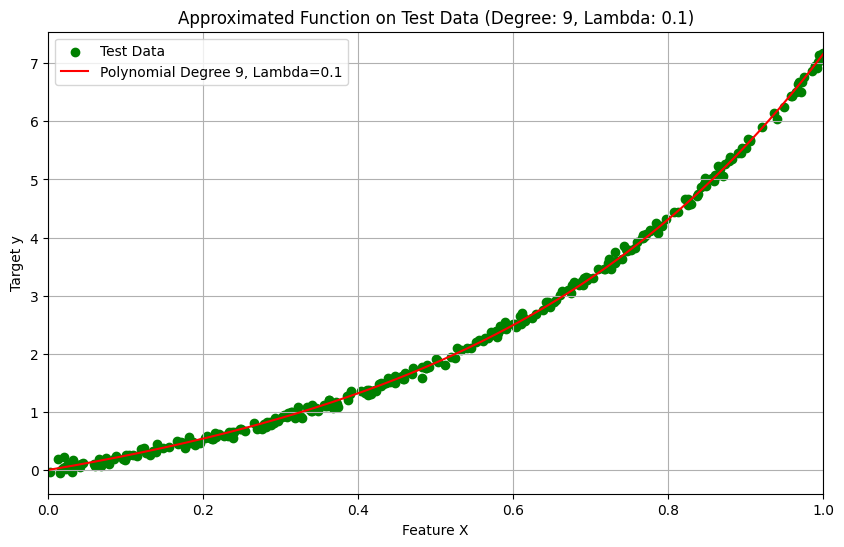


Weights for Subset Size: 100, Degree: 9, Lambda: 0.5
Weight for x^0: 0.053269461611676124
Weight for x^1: 2.1872531475350105
Weight for x^2: 1.7619287049311207
Weight for x^3: 1.254894697209363
Weight for x^4: 0.8592971607270286
Weight for x^5: 0.565183455463867
Weight for x^6: 0.3464529738688899
Weight for x^7: 0.18204161408331945
Weight for x^8: 0.0569511115118912
Weight for x^9: -0.03927288110099577


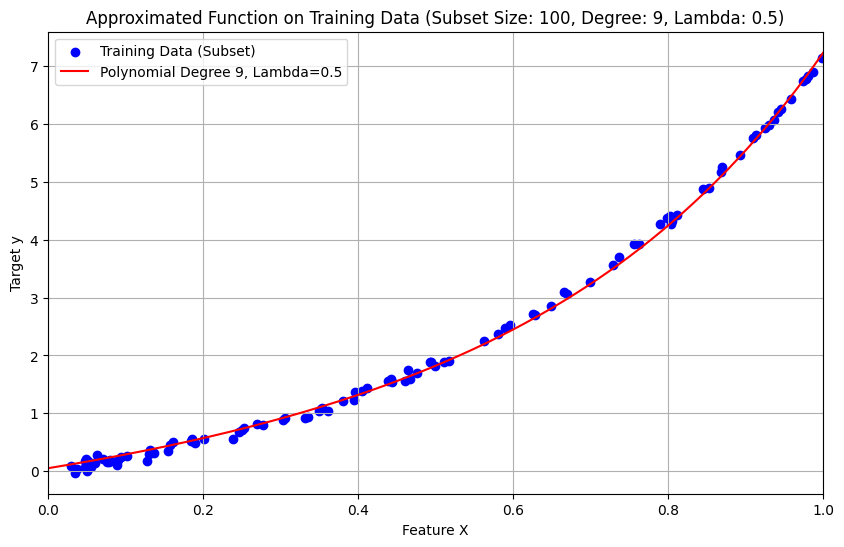

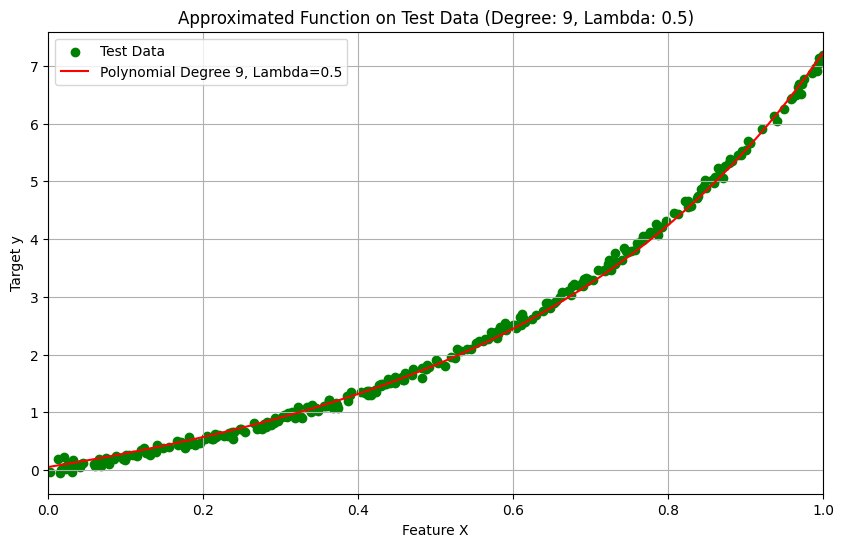


Weights for Subset Size: 100, Degree: 9, Lambda: 1.0
Weight for x^0: 0.11185325420925138
Weight for x^1: 2.072377810957655
Weight for x^2: 1.6698727212939328
Weight for x^3: 1.20746817741188
Weight for x^4: 0.8507369261992853
Weight for x^5: 0.586048906554157
Weight for x^6: 0.3886082774980515
Weight for x^7: 0.2393324453249464
Weight for x^8: 0.12489730355450332
Weight for x^9: 0.036091780017301296


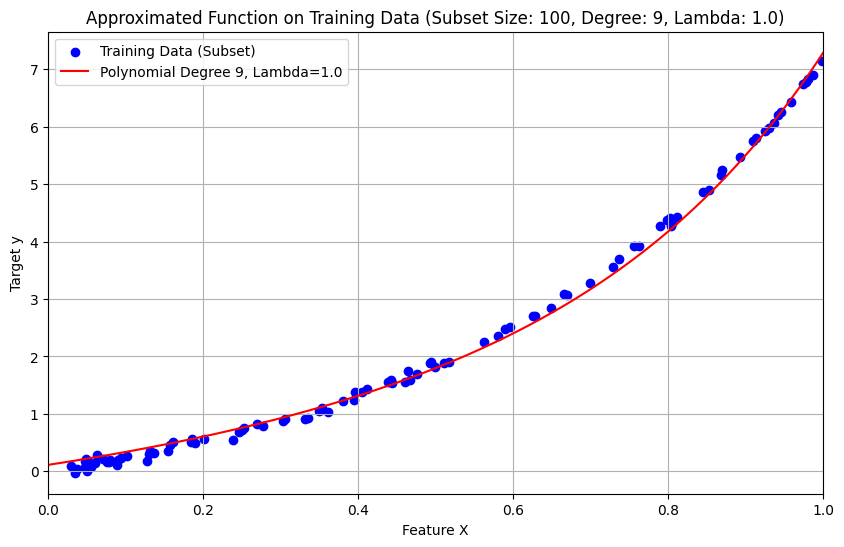

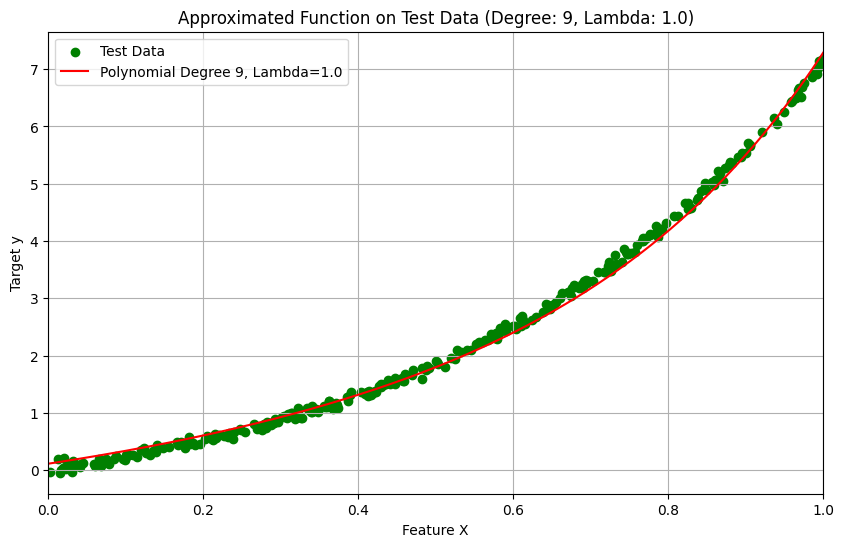


Weights for Subset Size: 700, Degree: 2, Lambda: 0.0
Weight for x^0: 0.20198725465892786
Weight for x^1: -0.11400745986855111
Weight for x^2: 6.752085947725133


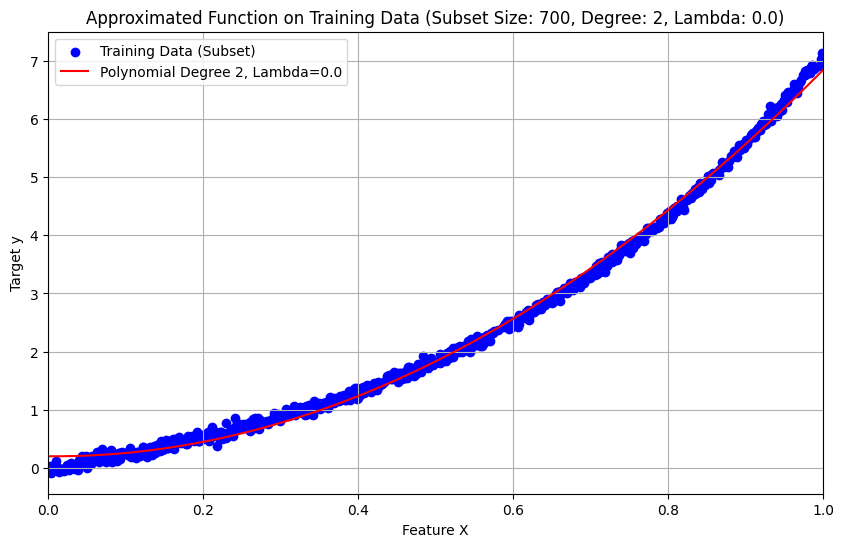

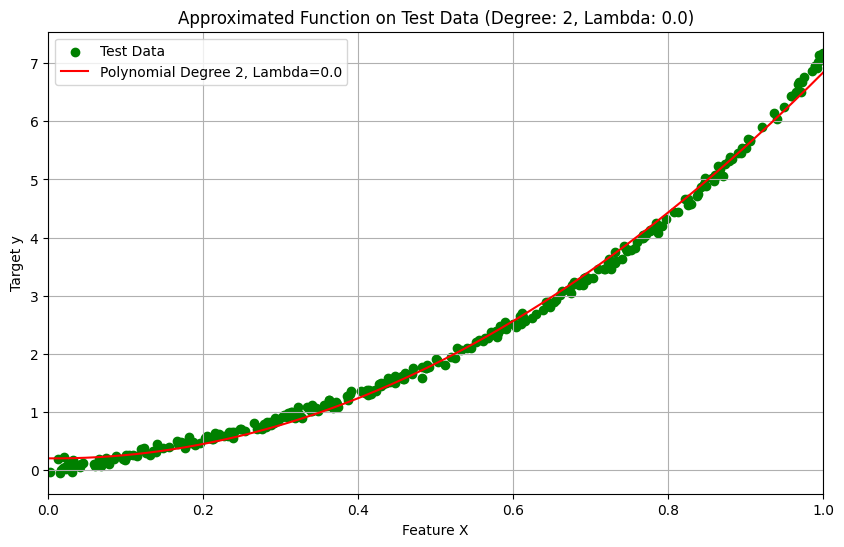


Weights for Subset Size: 700, Degree: 2, Lambda: 0.01
Weight for x^0: 0.1990754614017891
Weight for x^1: -0.0963669315605168
Weight for x^2: 6.734441180686969


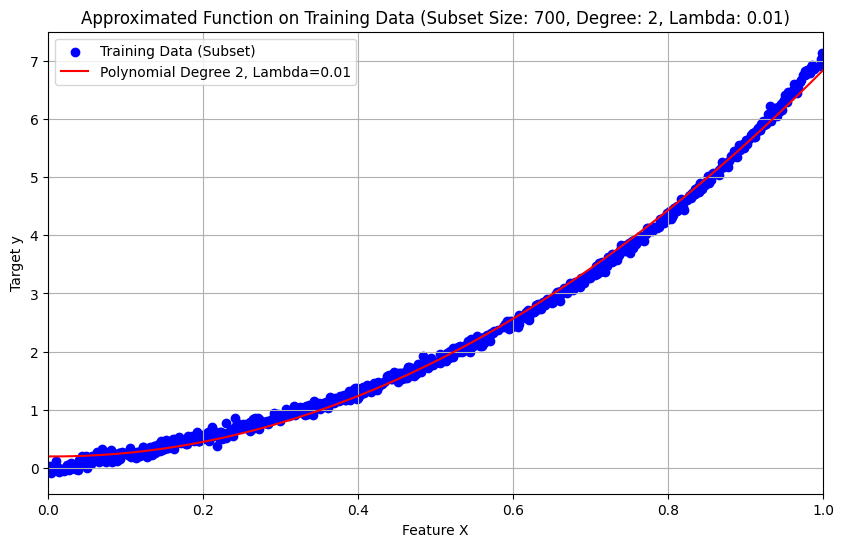

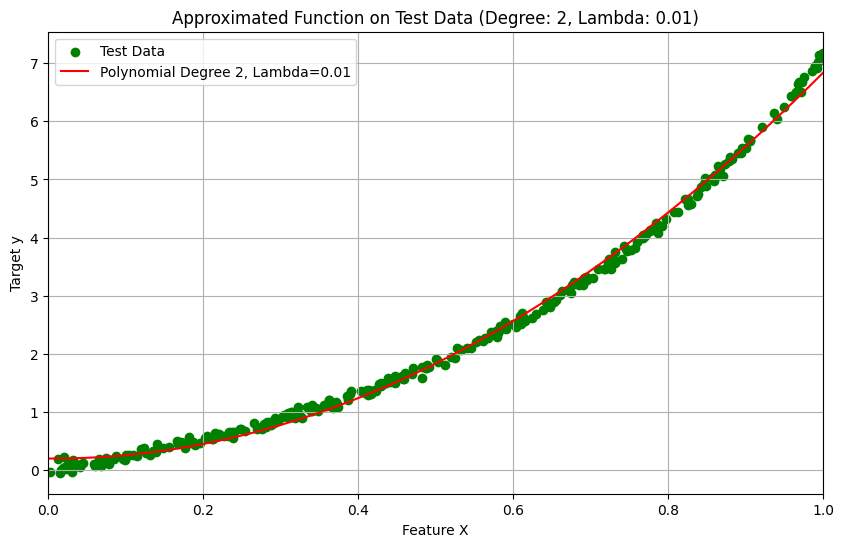


Weights for Subset Size: 700, Degree: 2, Lambda: 0.1
Weight for x^0: 0.17429704508224897
Weight for x^1: 0.05428998444175643
Weight for x^2: 6.58348864558489


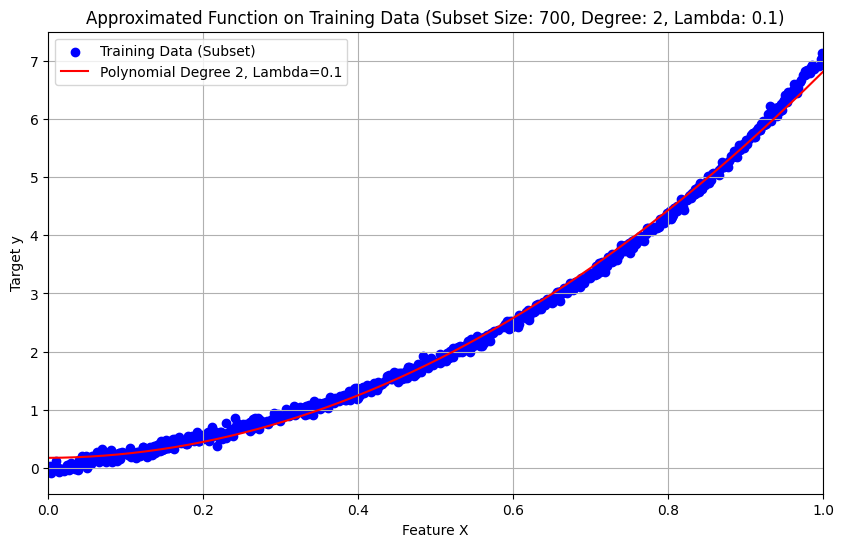

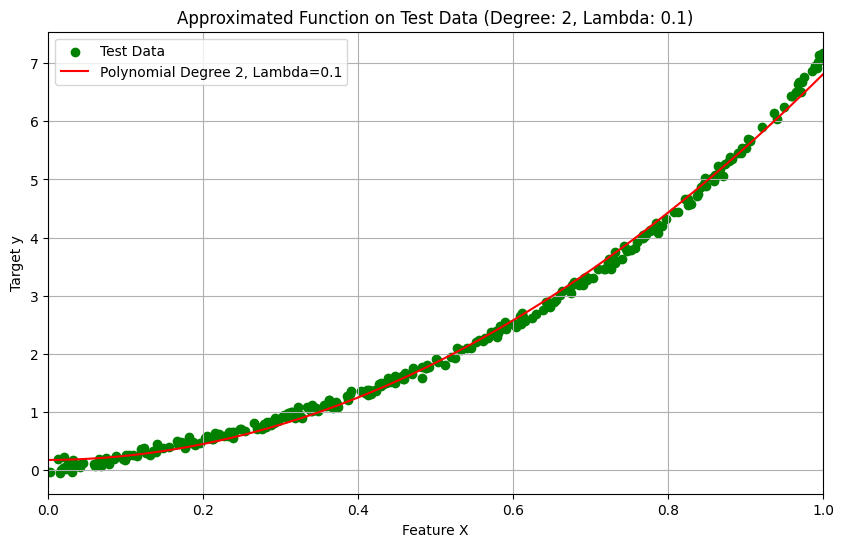


Weights for Subset Size: 700, Degree: 2, Lambda: 0.5
Weight for x^0: 0.0887384391523654
Weight for x^1: 0.5843027294981893
Weight for x^2: 6.047755531496274


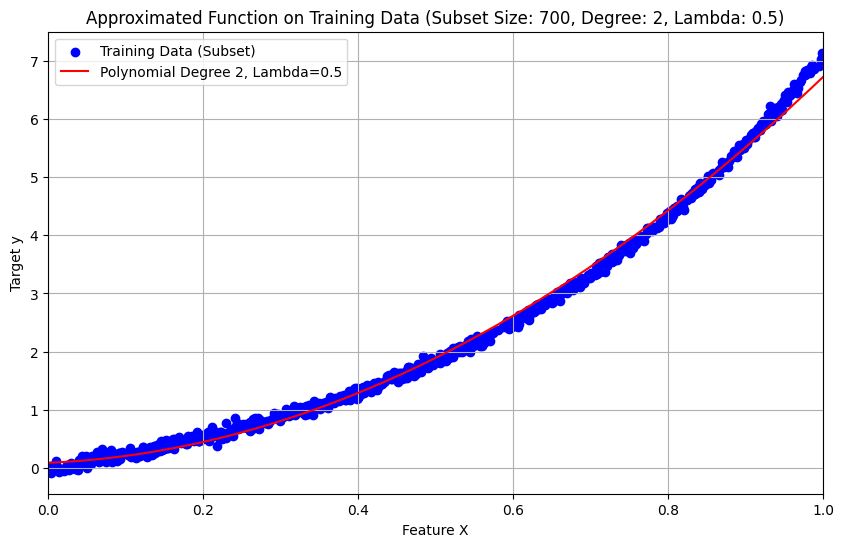

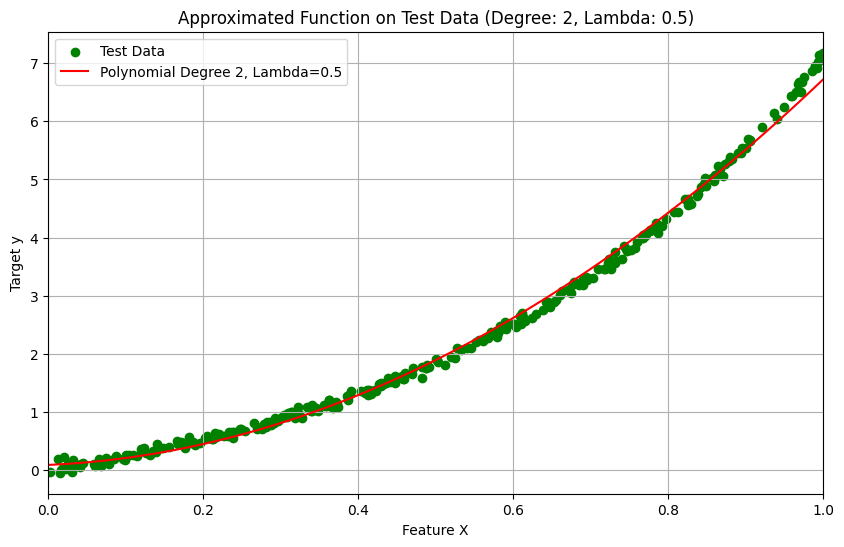


Weights for Subset Size: 700, Degree: 2, Lambda: 1.0
Weight for x^0: 0.018808414686306896
Weight for x^1: 1.0362990758652033
Weight for x^2: 5.582058083948457


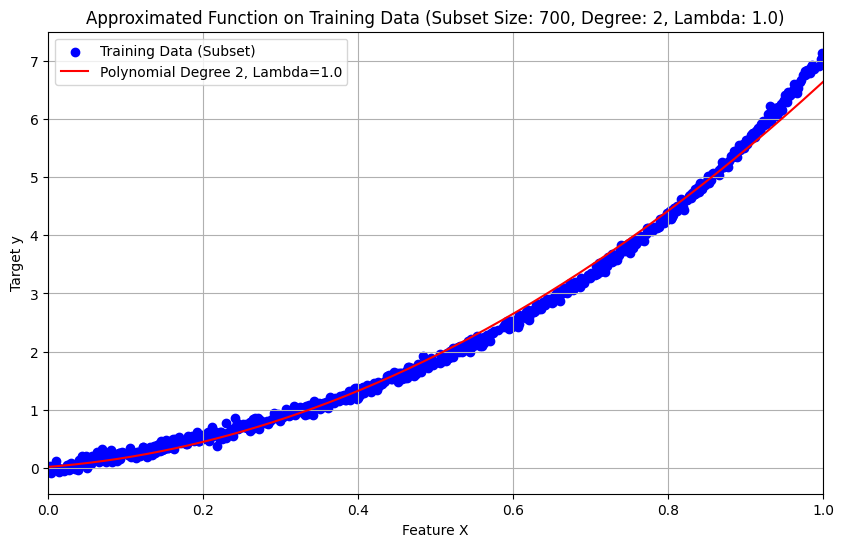

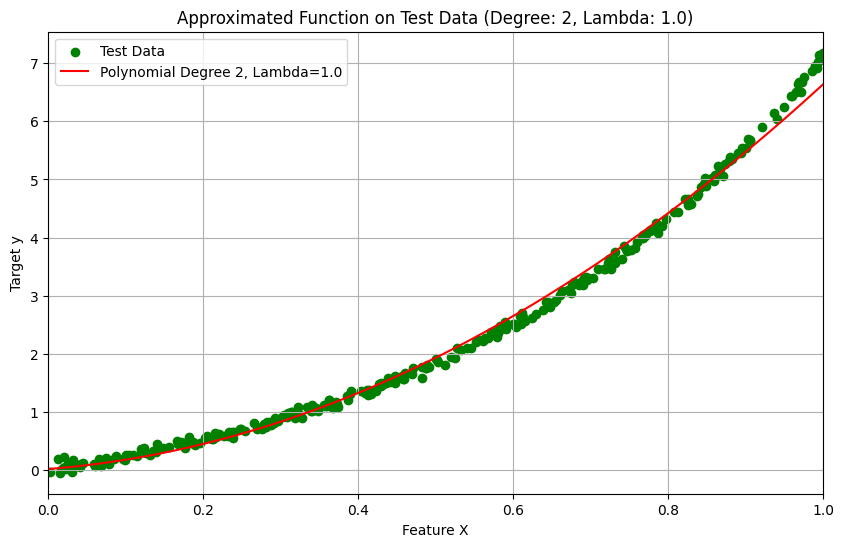


Weights for Subset Size: 700, Degree: 3, Lambda: 0.0
Weight for x^0: -0.038378446320566584
Weight for x^1: 2.8040480955093297
Weight for x^2: -0.5626530884168218
Weight for x^3: 4.883141770703459


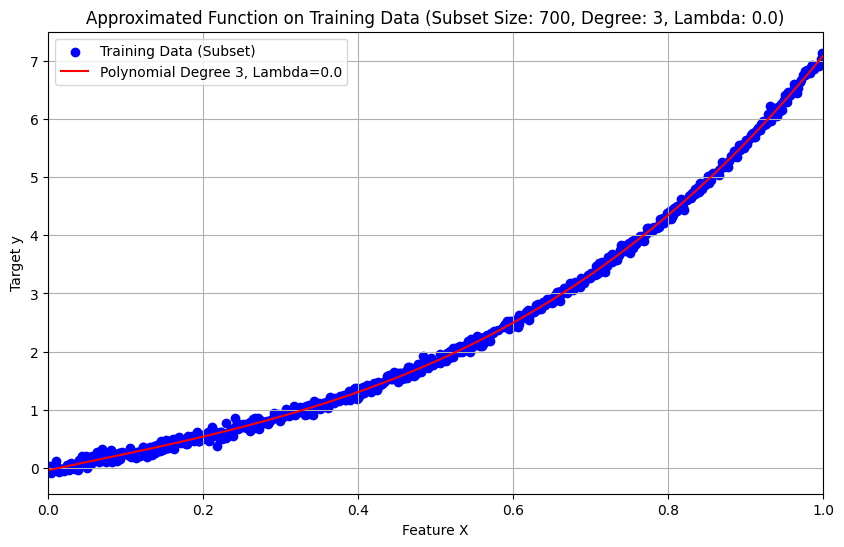

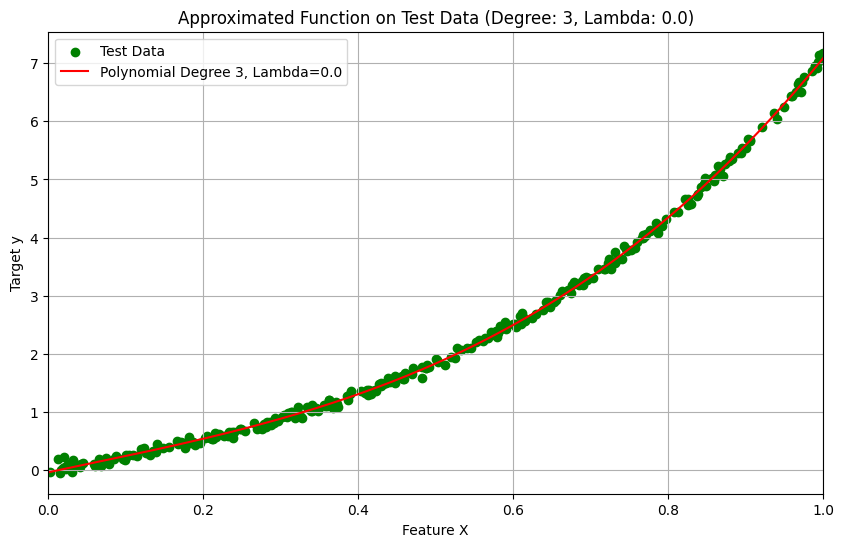


Weights for Subset Size: 700, Degree: 3, Lambda: 0.01
Weight for x^0: -0.023828700512603312
Weight for x^1: 2.6367975829868664
Weight for x^2: -0.15529031555841202
Weight for x^3: 4.615985457431112


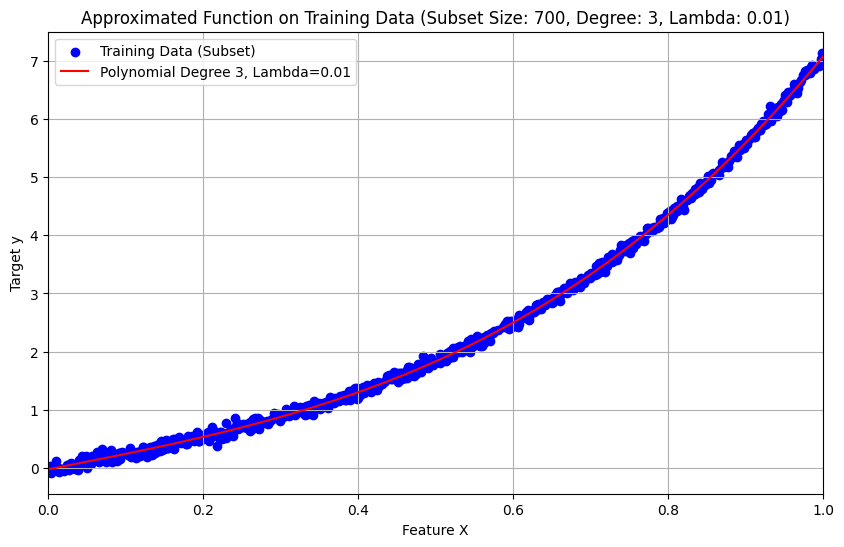

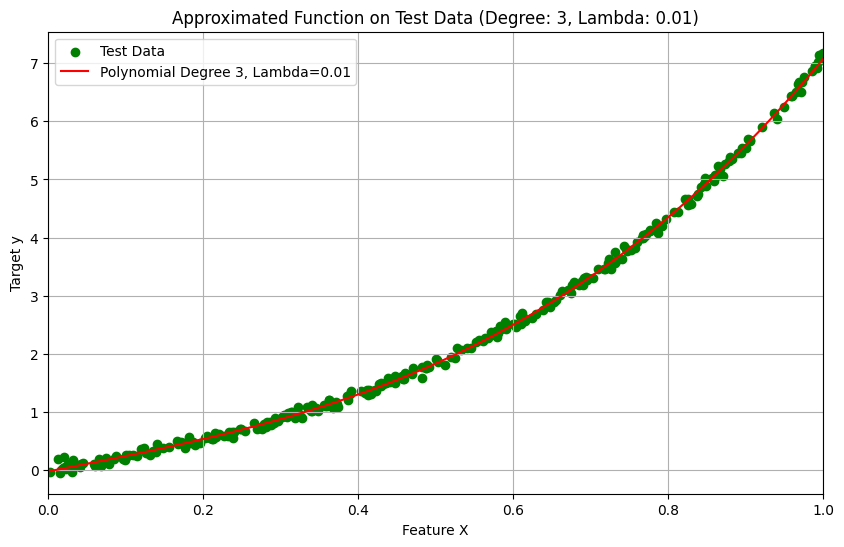


Weights for Subset Size: 700, Degree: 3, Lambda: 0.1
Weight for x^0: 0.026790619385082082
Weight for x^1: 2.0493376898085462
Weight for x^2: 1.2917080315642002
Weight for x^3: 3.65806892313602


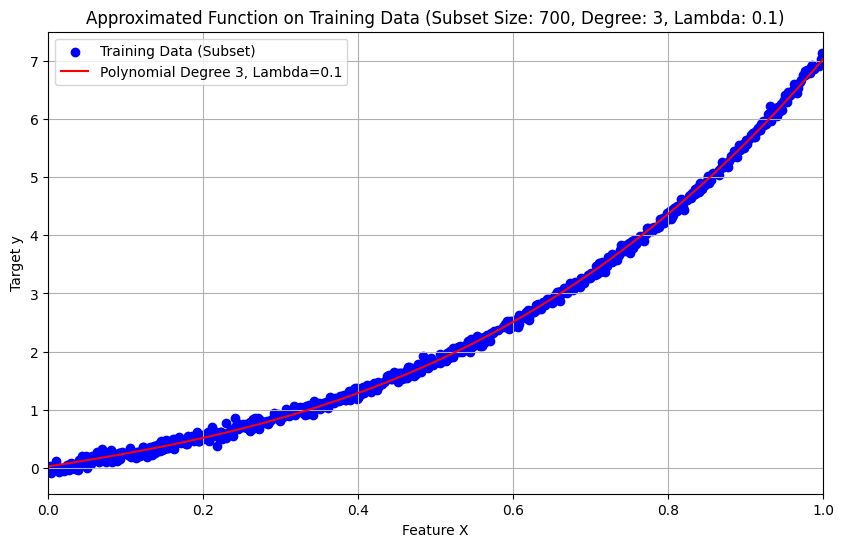

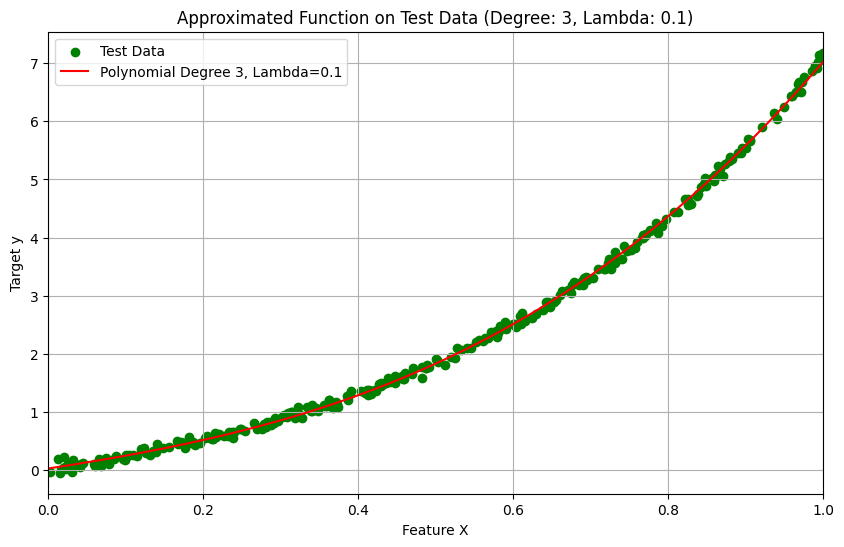


Weights for Subset Size: 700, Degree: 3, Lambda: 0.5
Weight for x^0: 0.050708924647120394
Weight for x^1: 1.7437366350784944
Weight for x^2: 2.1373380426154105
Weight for x^3: 3.045888202470174


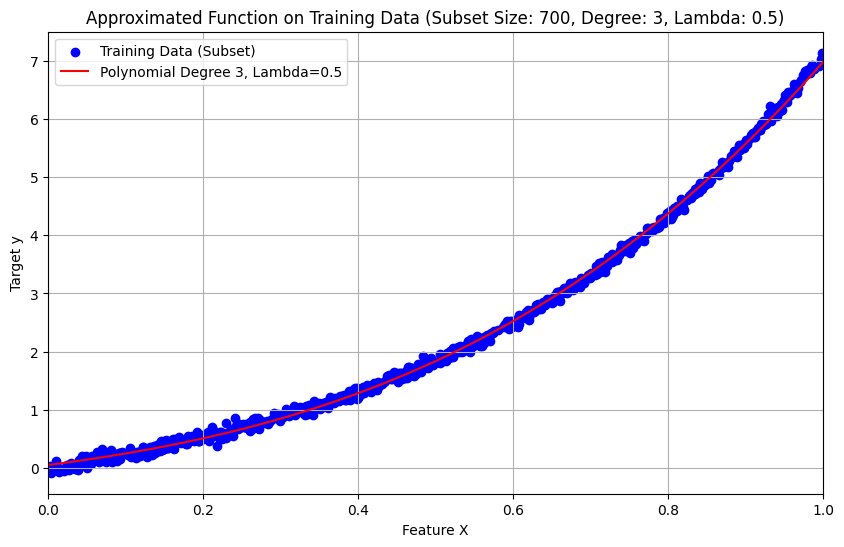

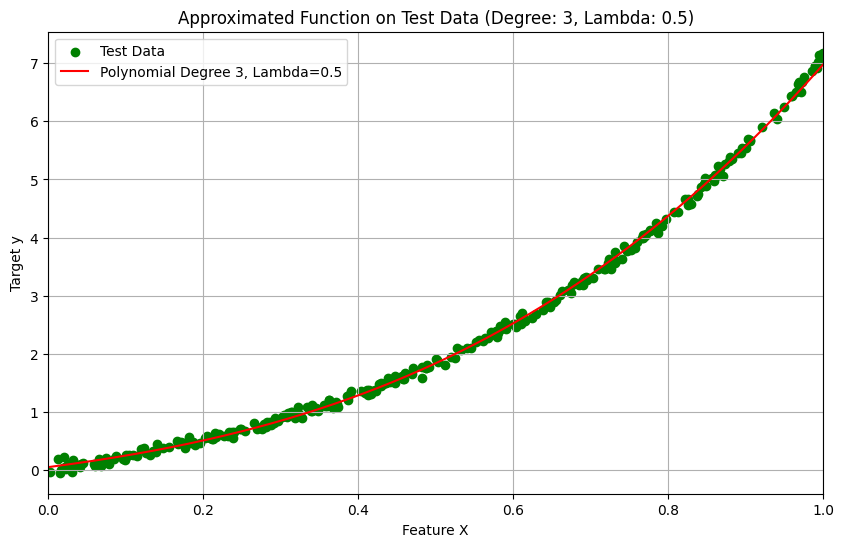


Weights for Subset Size: 700, Degree: 3, Lambda: 1.0
Weight for x^0: 0.050221758895750764
Weight for x^1: 1.7263629396961022
Weight for x^2: 2.2888447000906993
Weight for x^3: 2.880976298064718


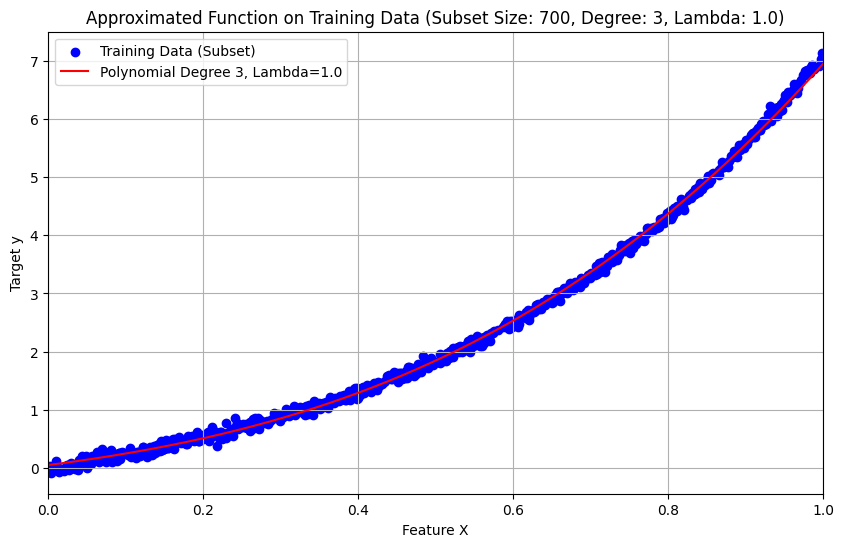

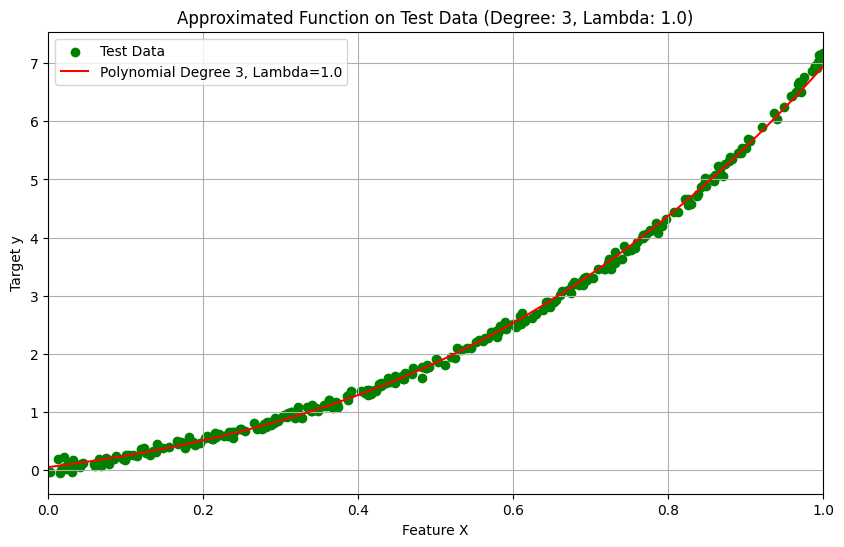


Weights for Subset Size: 700, Degree: 4, Lambda: 0.0
Weight for x^0: -0.013838205333691057
Weight for x^1: 2.31147088060308
Weight for x^2: 1.6703074093971881
Weight for x^3: 1.385044902508355
Weight for x^4: 1.7604248840377925


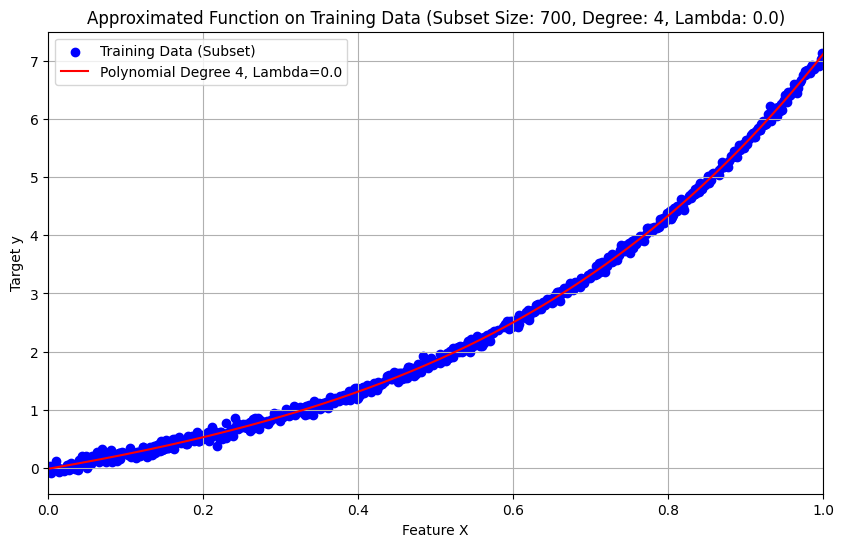

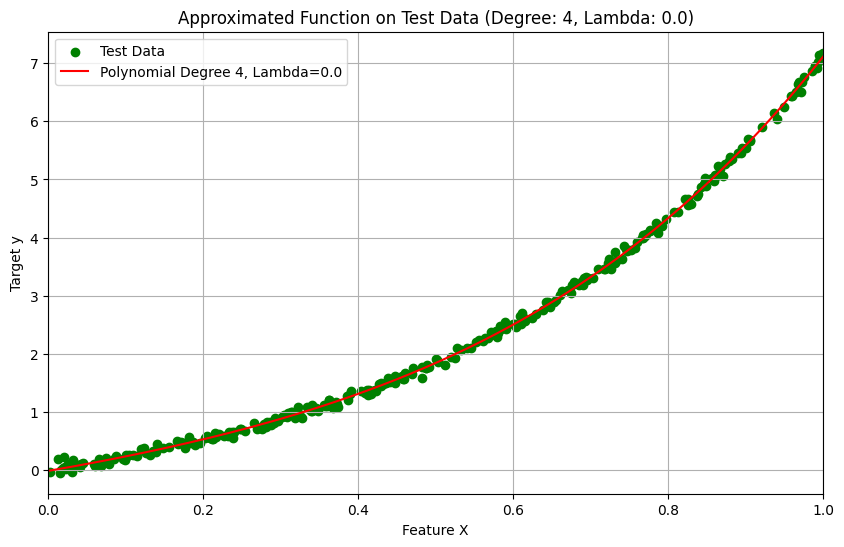


Weights for Subset Size: 700, Degree: 4, Lambda: 0.01
Weight for x^0: -0.01334364116025264
Weight for x^1: 2.3168149930339355
Weight for x^2: 1.6143796218847137
Weight for x^3: 1.5017141482324017
Weight for x^4: 1.6919063241859564


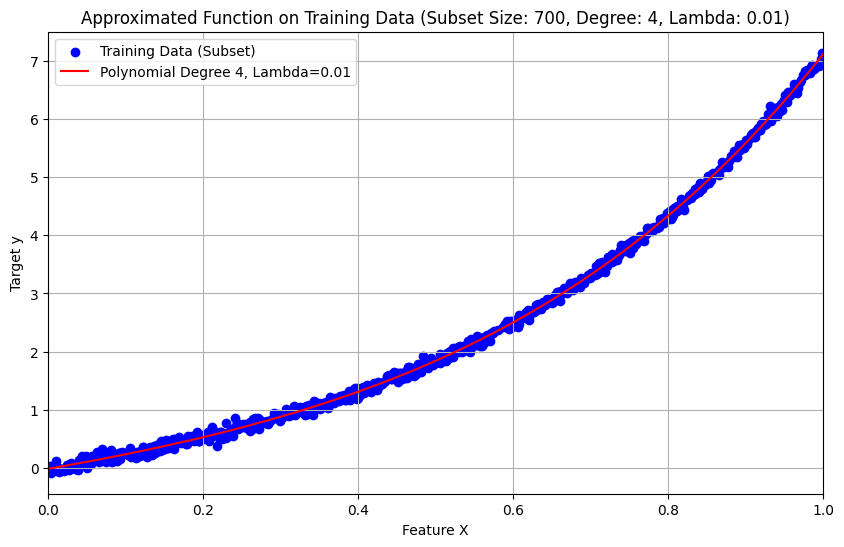

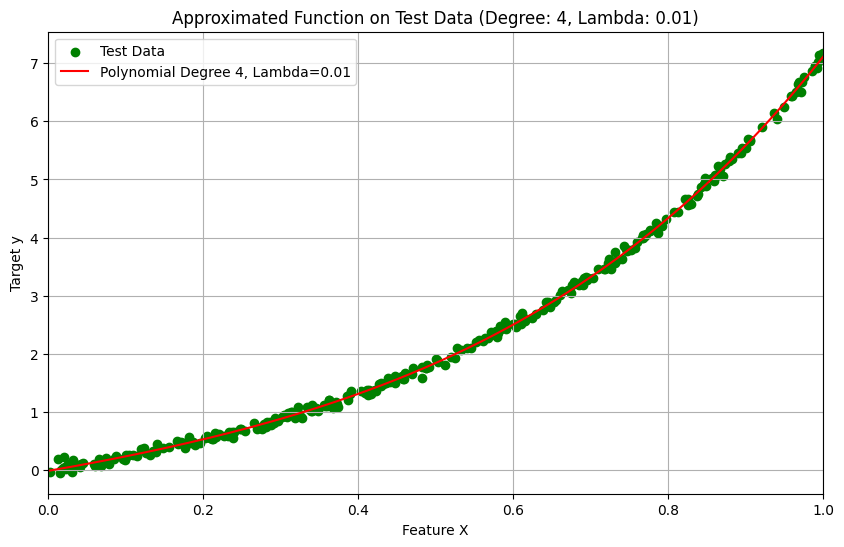


Weights for Subset Size: 700, Degree: 4, Lambda: 0.1
Weight for x^0: -0.004592772914830923
Weight for x^1: 2.2504004568979097
Weight for x^2: 1.7005460299542843
Weight for x^3: 1.5598213434937136
Weight for x^4: 1.597666701284752


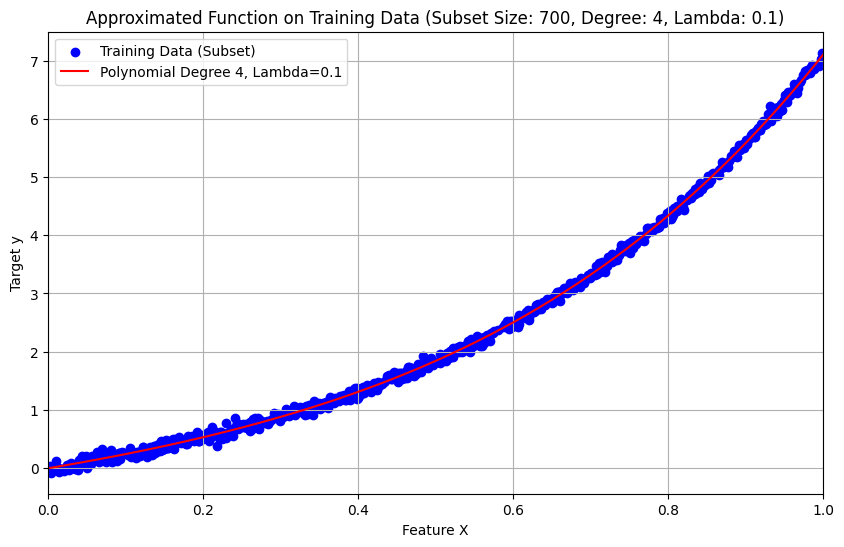

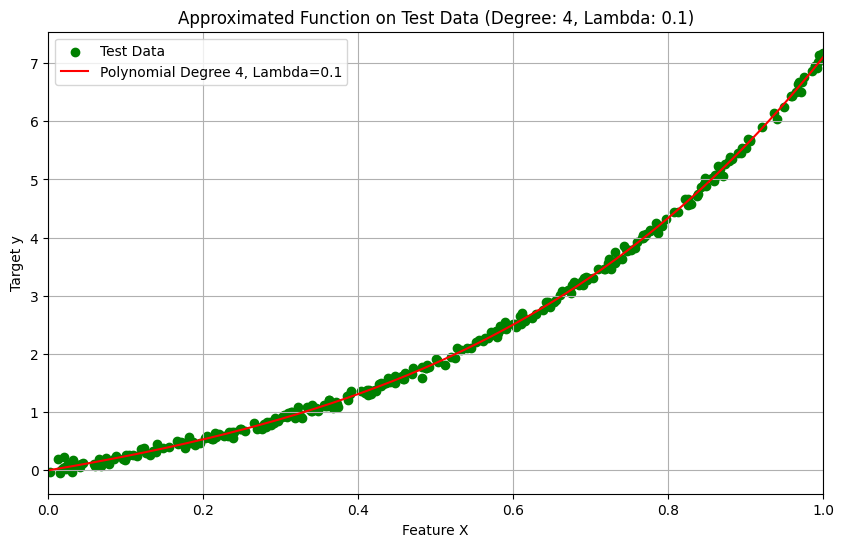


Weights for Subset Size: 700, Degree: 4, Lambda: 0.5
Weight for x^0: 0.013127673651522401
Weight for x^1: 2.1442707756212216
Weight for x^2: 1.831676662362267
Weight for x^3: 1.612643981050799
Weight for x^4: 1.4893815589566335


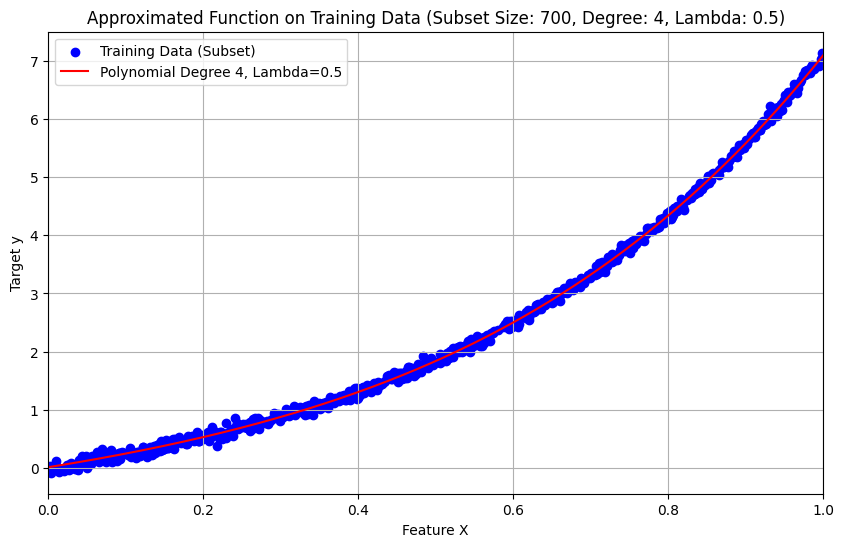

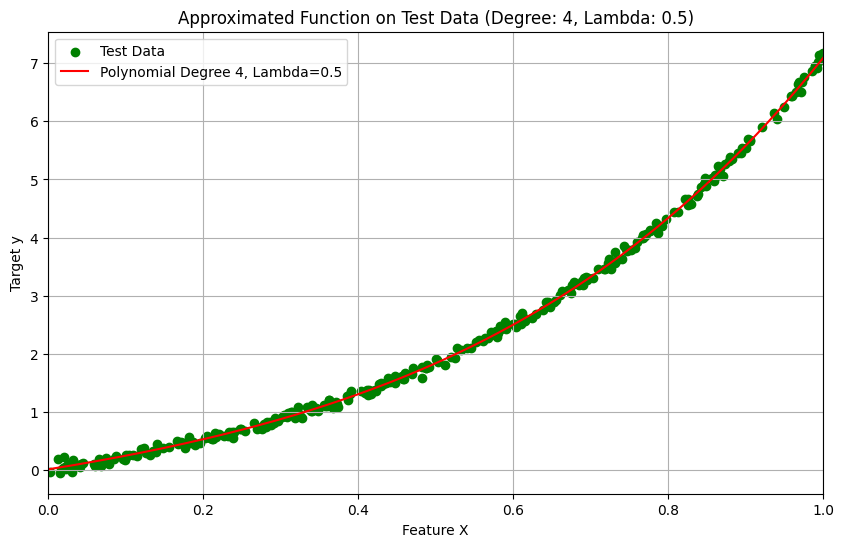


Weights for Subset Size: 700, Degree: 4, Lambda: 1.0
Weight for x^0: 0.02584159637827892
Weight for x^1: 2.0961589324666776
Weight for x^2: 1.8683673996906442
Weight for x^3: 1.630962938615459
Weight for x^4: 1.4617967336742228


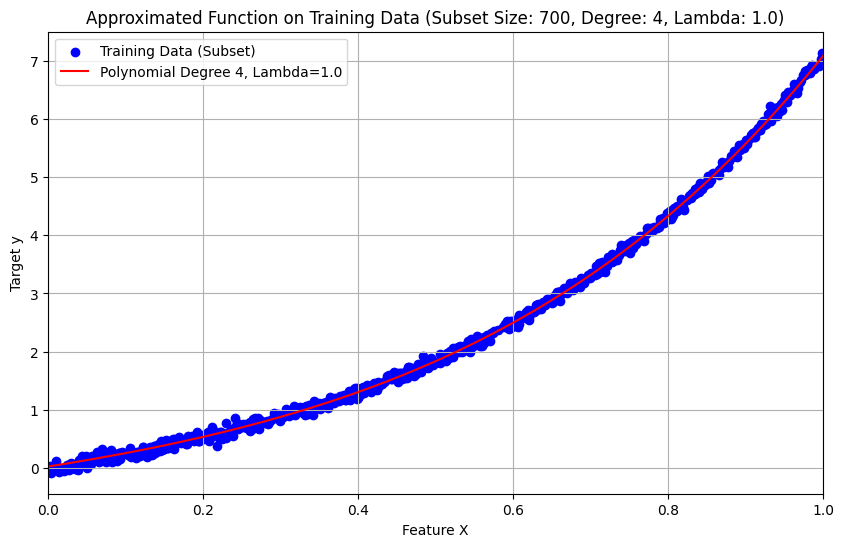

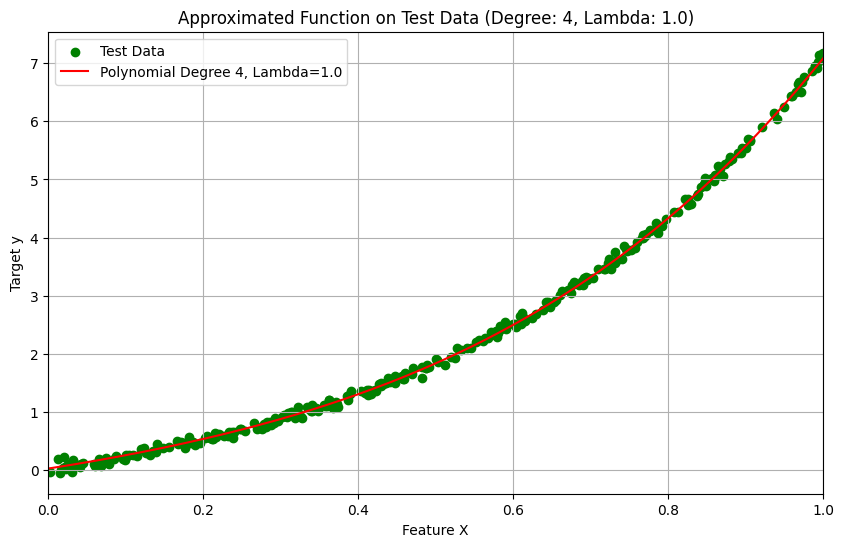


Weights for Subset Size: 700, Degree: 5, Lambda: 0.0
Weight for x^0: -0.017975243900784303
Weight for x^1: 2.4384025934607254
Weight for x^2: 0.7652678006488317
Weight for x^3: 3.8269935188735684
Weight for x^4: -1.0102648168903565
Weight for x^5: 1.1160443862026983


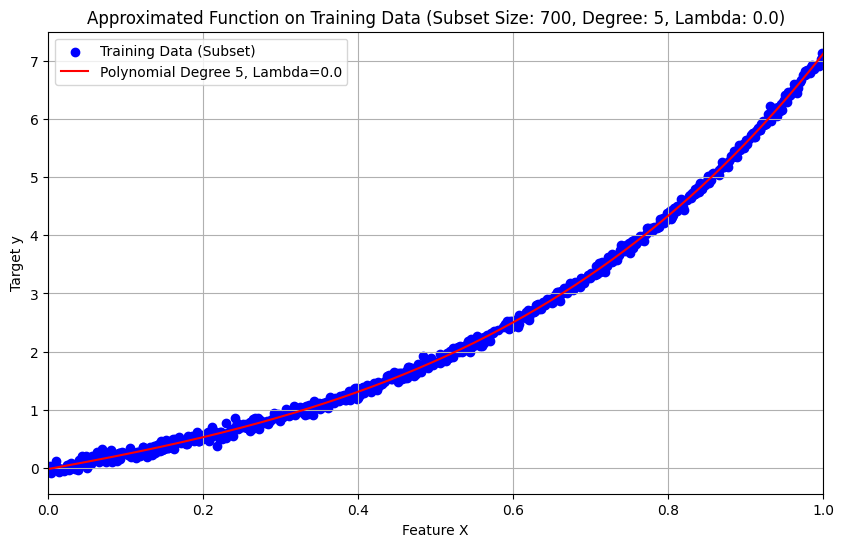

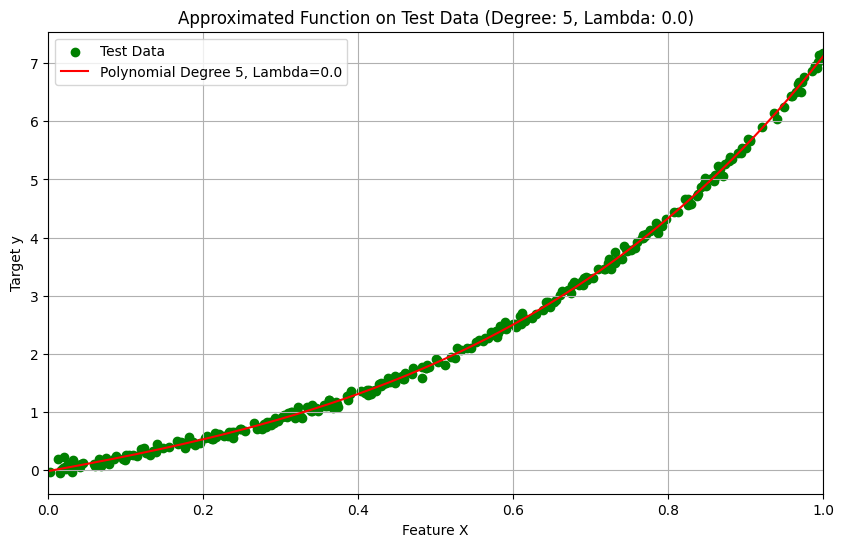


Weights for Subset Size: 700, Degree: 5, Lambda: 0.01
Weight for x^0: -0.00980192595355515
Weight for x^1: 2.257595314108367
Weight for x^2: 1.7736720543290607
Weight for x^3: 1.6131092220243897
Weight for x^4: 1.080834207533599
Weight for x^5: 0.40422251674178783


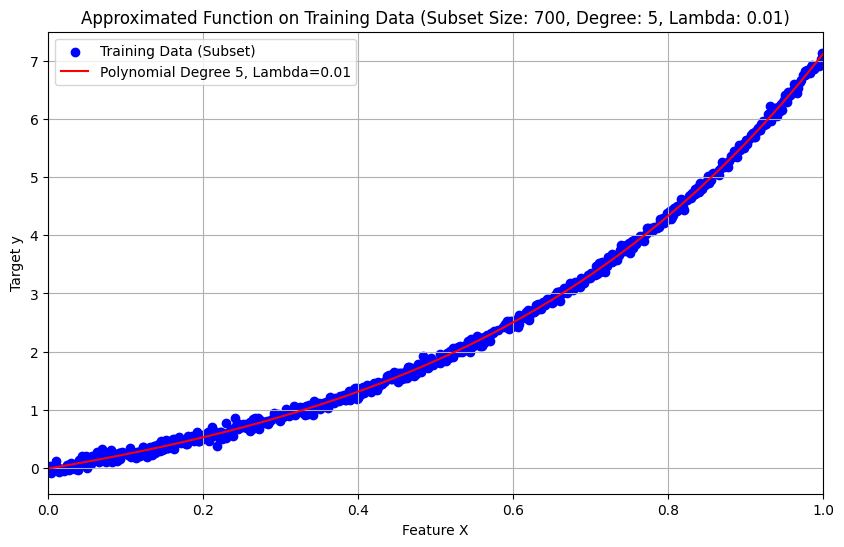

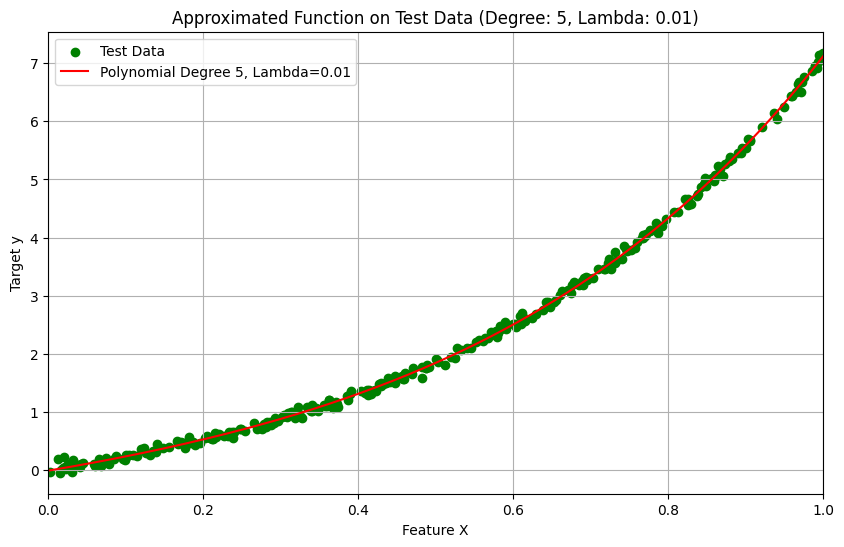


Weights for Subset Size: 700, Degree: 5, Lambda: 0.1
Weight for x^0: -0.006491501244229019
Weight for x^1: 2.2207727378763167
Weight for x^2: 1.923979556086707
Weight for x^3: 1.4543363220832584
Weight for x^4: 0.977204260151815
Weight for x^5: 0.5568998780337495


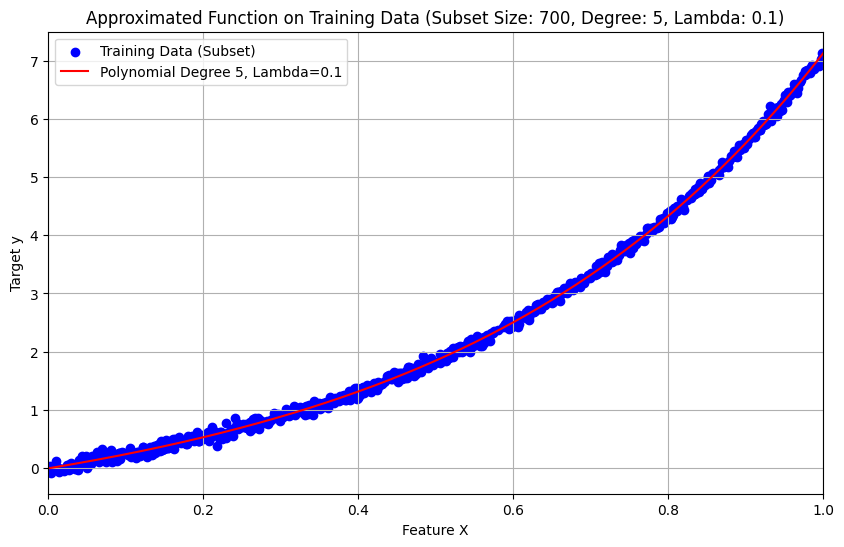

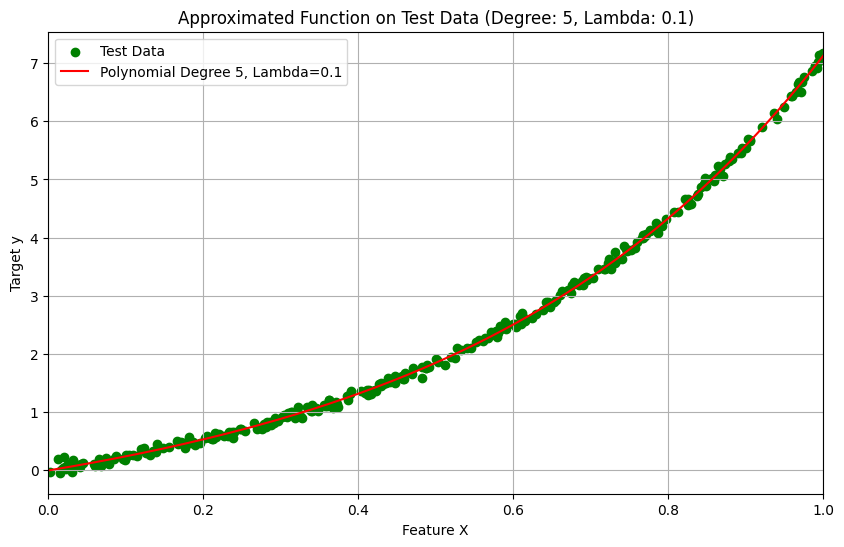


Weights for Subset Size: 700, Degree: 5, Lambda: 0.5
Weight for x^0: 0.0006100887849385827
Weight for x^1: 2.2276055107280843
Weight for x^2: 1.8925495549571445
Weight for x^3: 1.3978701351722693
Weight for x^4: 0.9749613210226798
Weight for x^5: 0.6441408077998535


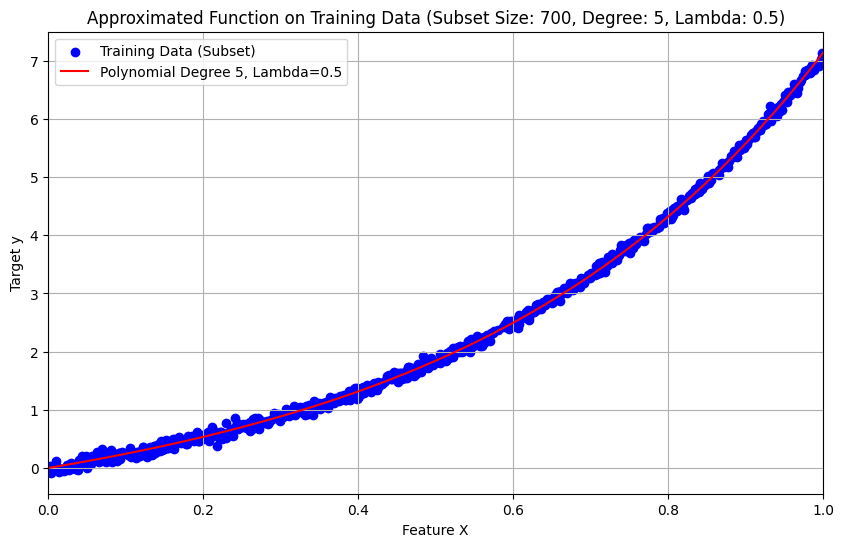

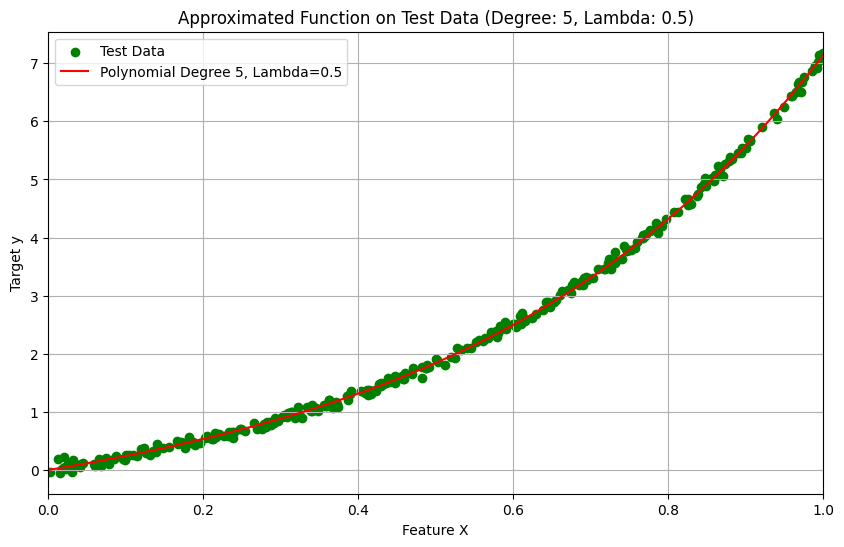


Weights for Subset Size: 700, Degree: 5, Lambda: 1.0
Weight for x^0: 0.012391894876021442
Weight for x^1: 2.2128676328428667
Weight for x^2: 1.8612241143891894
Weight for x^3: 1.3812716358820936
Weight for x^4: 0.9881960988478645
Weight for x^5: 0.6891318189643197


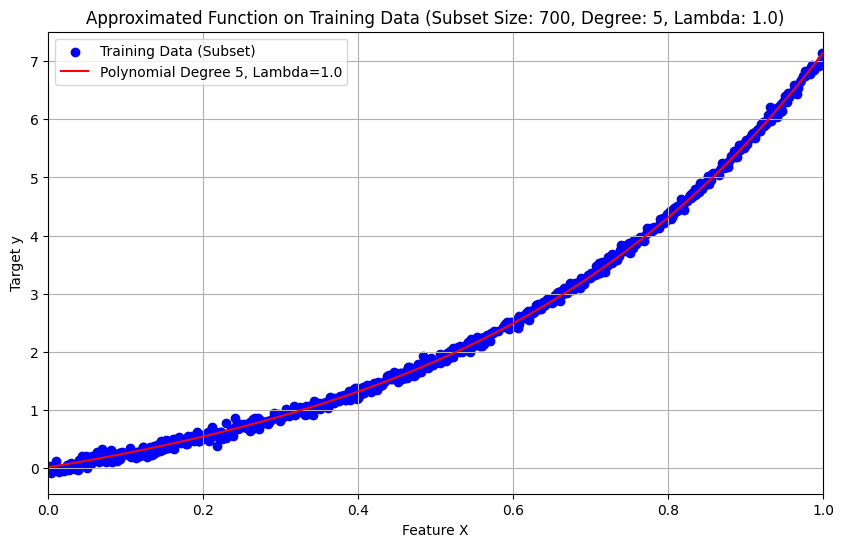

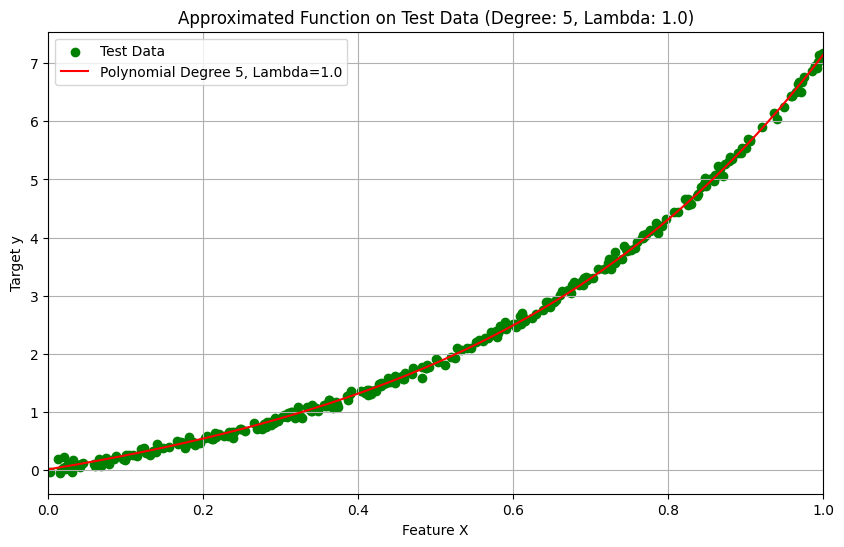


Weights for Subset Size: 700, Degree: 6, Lambda: 0.0
Weight for x^0: -0.015471948378676319
Weight for x^1: 2.329286698056012
Weight for x^2: 1.875496704033344
Weight for x^3: -0.6574460259959392
Weight for x^4: 7.4565651890588756
Weight for x^5: -6.377522110292363
Weight for x^6: 2.510820325987685


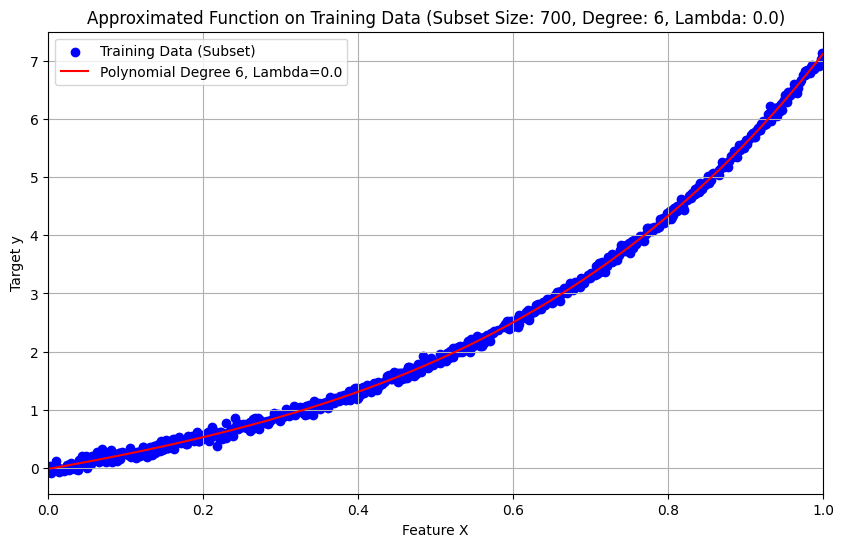

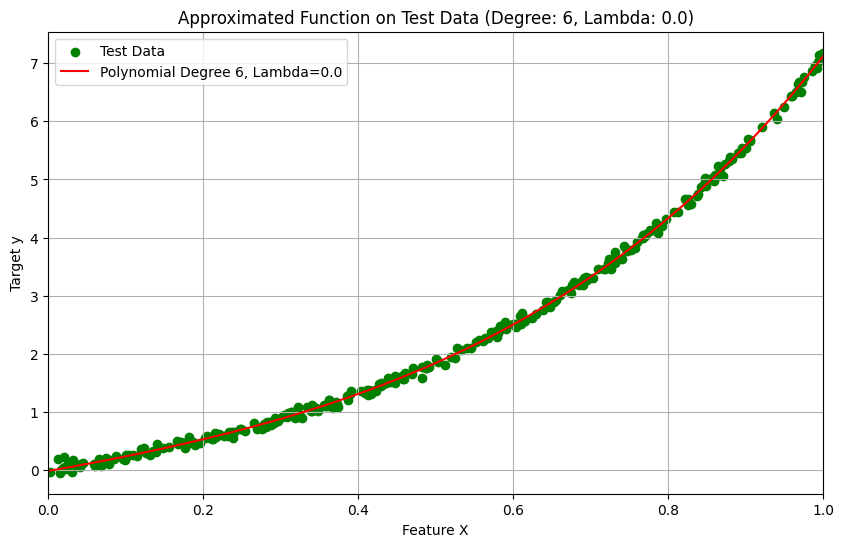


Weights for Subset Size: 700, Degree: 6, Lambda: 0.01
Weight for x^0: -0.010089011107573105
Weight for x^1: 2.260572907866634
Weight for x^2: 1.775225430300522
Weight for x^3: 1.5856035550520586
Weight for x^4: 1.0834538767150288
Weight for x^5: 0.480896172037438
Weight for x^6: -0.057048842107718545


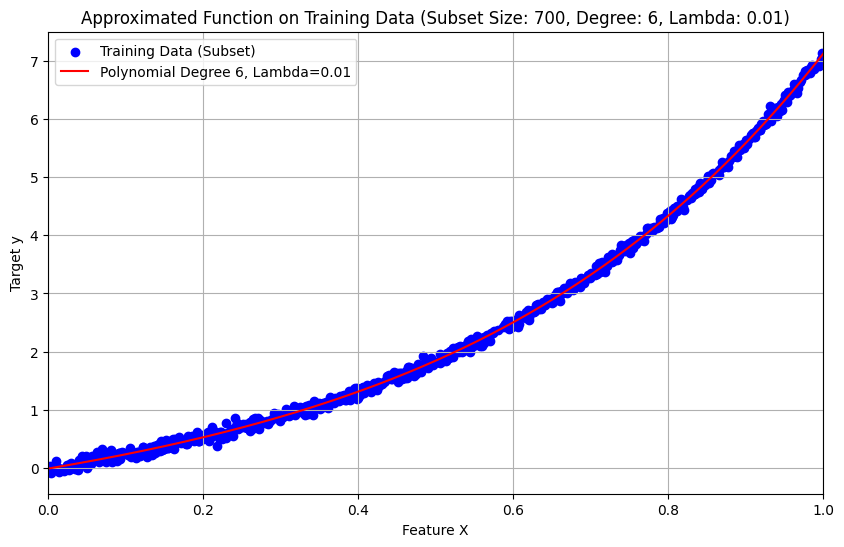

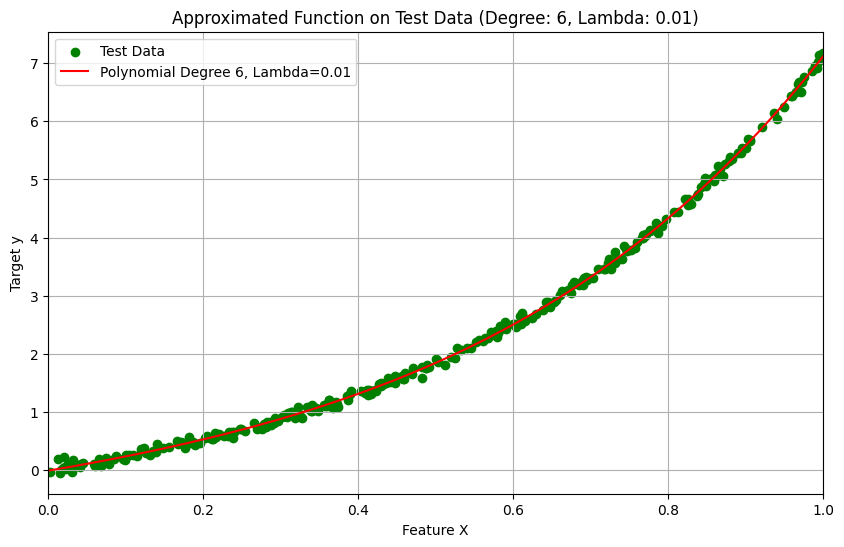


Weights for Subset Size: 700, Degree: 6, Lambda: 0.1
Weight for x^0: -0.006194191482889617
Weight for x^1: 2.2126849302481686
Weight for x^2: 1.9482959964496225
Weight for x^3: 1.4650988472195439
Weight for x^4: 0.9472204692794796
Weight for x^5: 0.47786293241563704
Weight for x^6: 0.0849485175609622


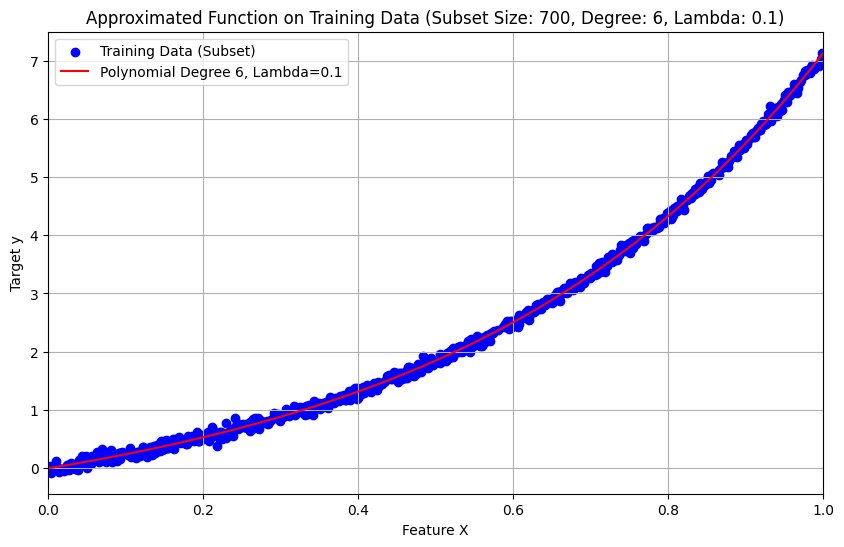

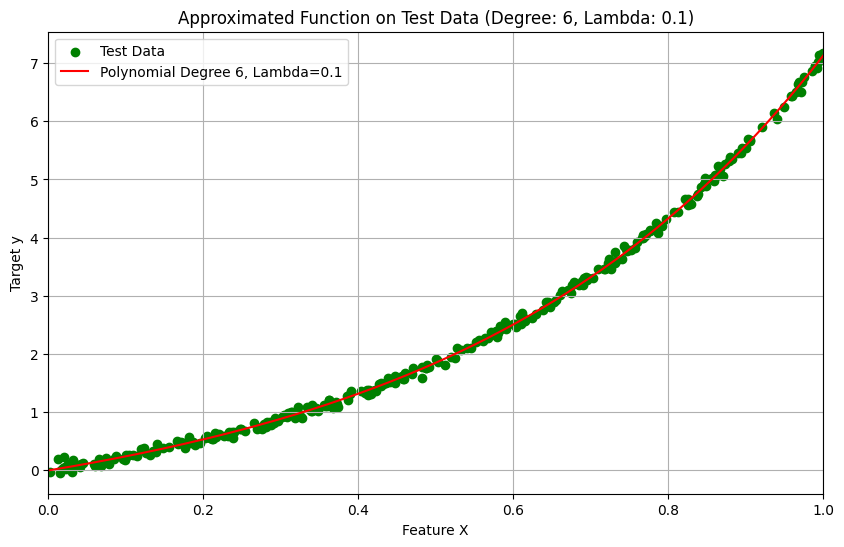


Weights for Subset Size: 700, Degree: 6, Lambda: 0.5
Weight for x^0: -0.0017420572622858378
Weight for x^1: 2.2351651456223465
Weight for x^2: 1.925784789680768
Weight for x^3: 1.3858471707214315
Weight for x^4: 0.8986957433199478
Weight for x^5: 0.5062952197974226
Weight for x^6: 0.20159094240481343


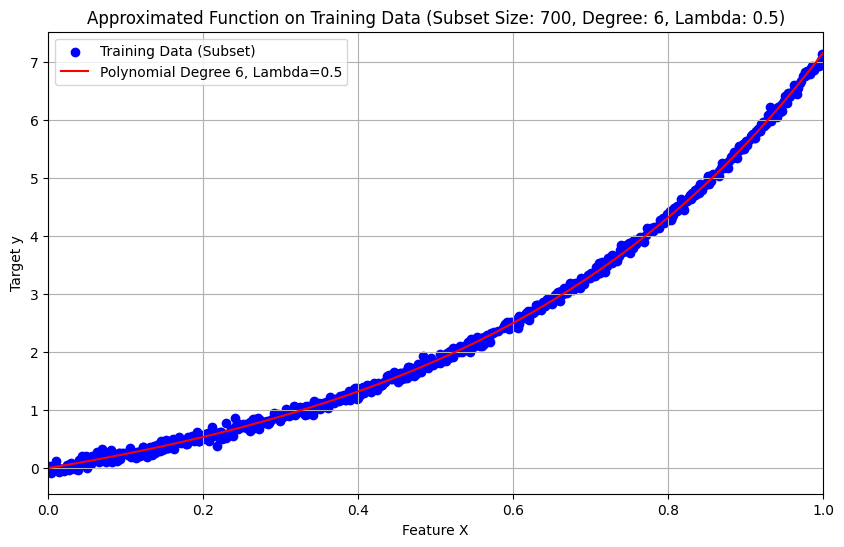

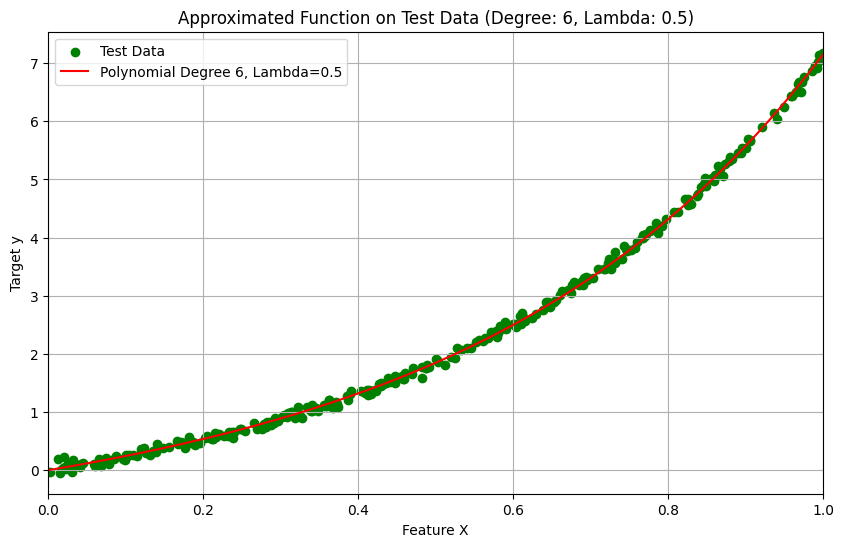


Weights for Subset Size: 700, Degree: 6, Lambda: 1.0
Weight for x^0: 0.008136079757085874
Weight for x^1: 2.2379206644853515
Weight for x^2: 1.8839936399964485
Weight for x^3: 1.3477178765506463
Weight for x^4: 0.8904837843002179
Weight for x^5: 0.5349505566539693
Weight for x^6: 0.265145230812291


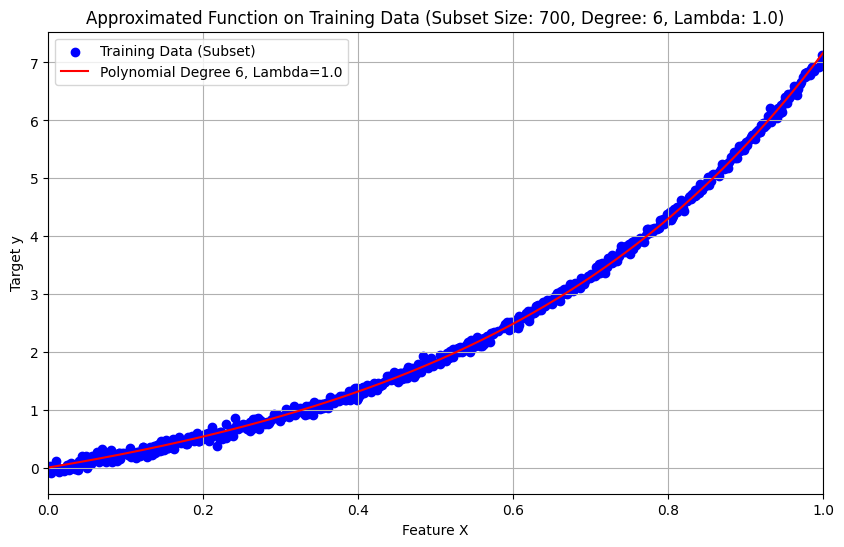

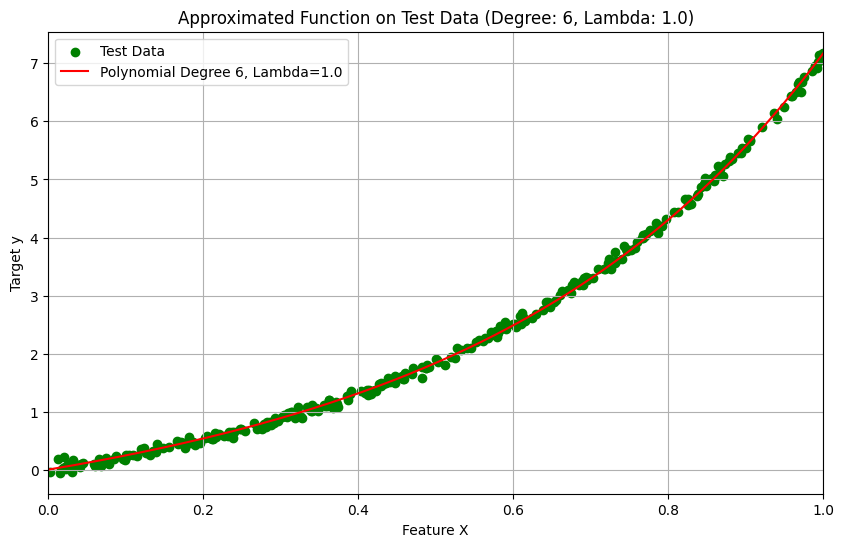


Weights for Subset Size: 700, Degree: 7, Lambda: 0.0
Weight for x^0: -0.01847174044666628
Weight for x^1: 2.5075824664030377
Weight for x^2: -0.5868832502787807
Weight for x^3: 13.212997272743669
Weight for x^4: -31.056306389062662
Weight for x^5: 49.48792203058606
Weight for x^6: -38.07710910113987
Weight for x^7: 11.656200209176614


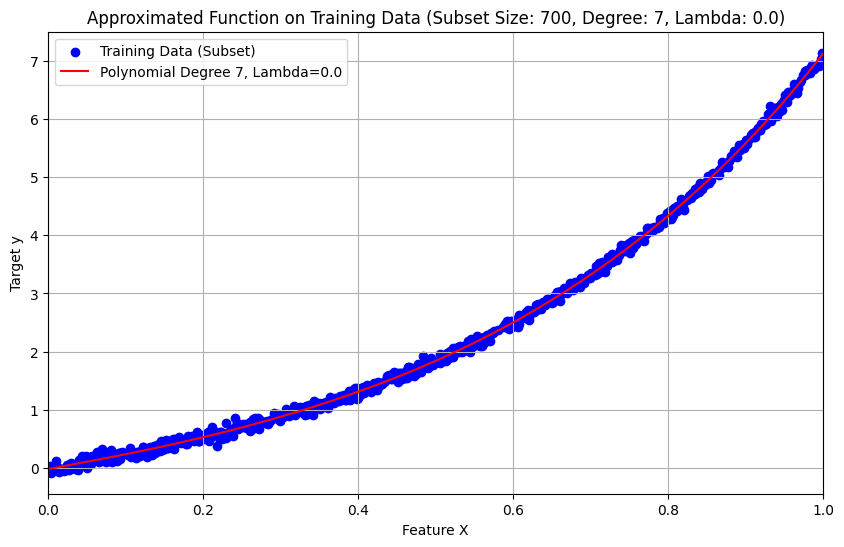

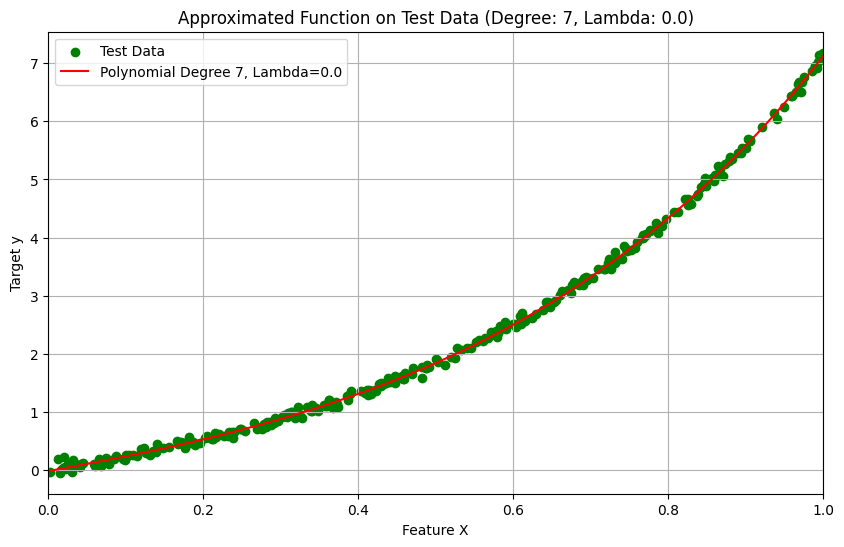


Weights for Subset Size: 700, Degree: 7, Lambda: 0.01
Weight for x^0: -0.010312167239019841
Weight for x^1: 2.259573903066564
Weight for x^2: 1.8005760617977211
Weight for x^3: 1.5397426734774764
Weight for x^4: 1.0397062623170716
Weight for x^5: 0.5184925008198176
Weight for x^6: 0.11157349258595035
Weight for x^7: -0.14302066833213306


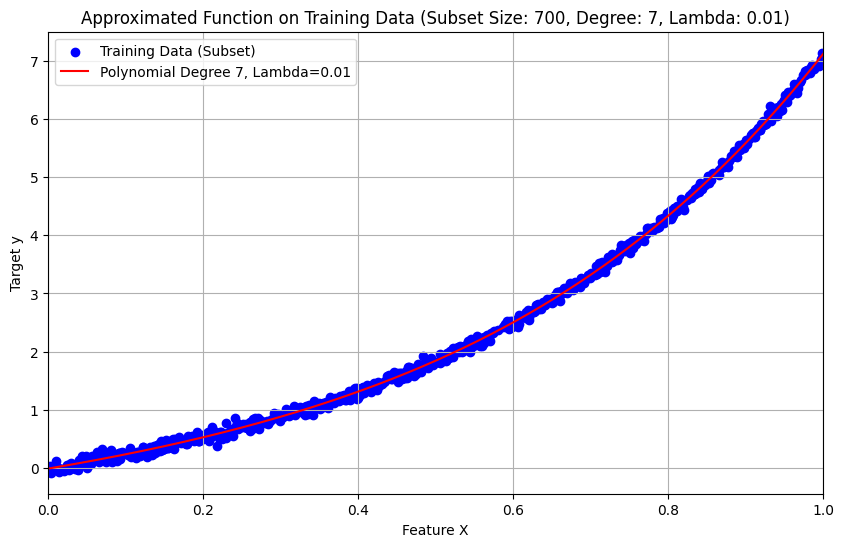

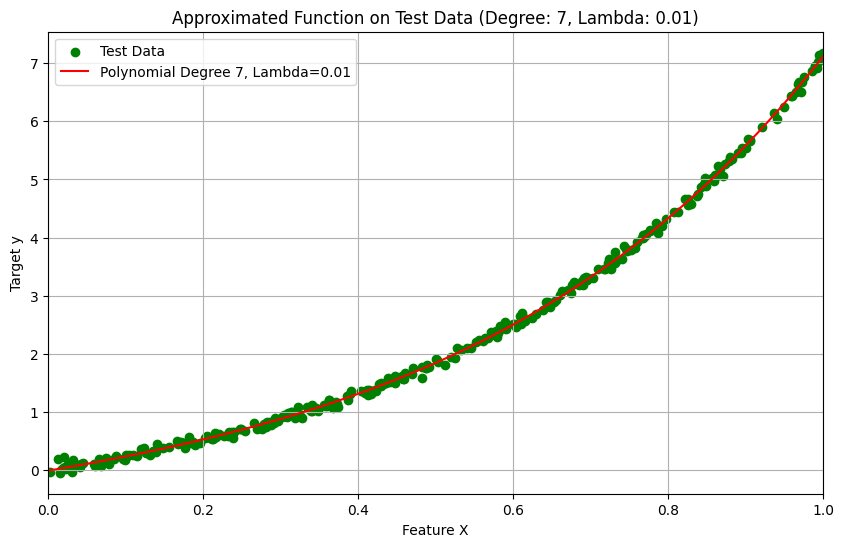


Weights for Subset Size: 700, Degree: 7, Lambda: 0.1
Weight for x^0: -0.006792494057926948
Weight for x^1: 2.2220237830912604
Weight for x^2: 1.9313953373109445
Weight for x^3: 1.4448679935473159
Weight for x^4: 0.9510587591107721
Weight for x^5: 0.5197602980027509
Weight for x^6: 0.1689708241423104
Weight for x^7: -0.10521282665544524


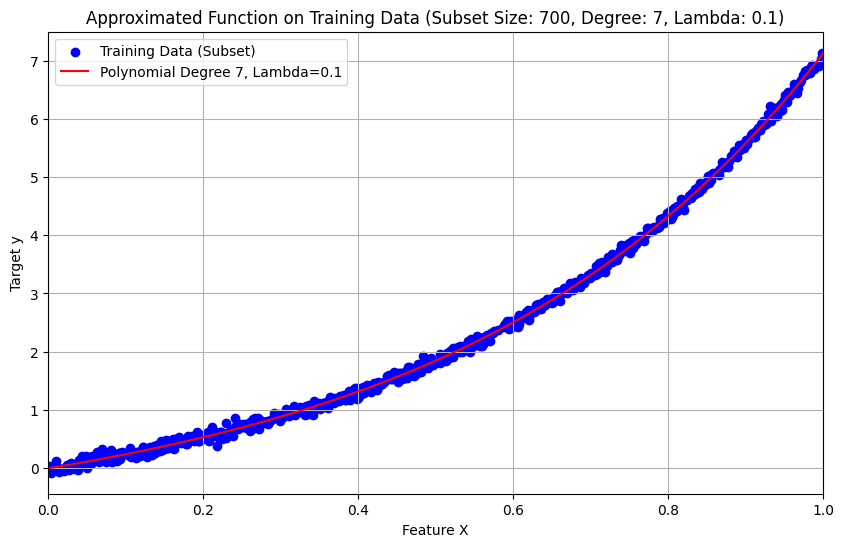

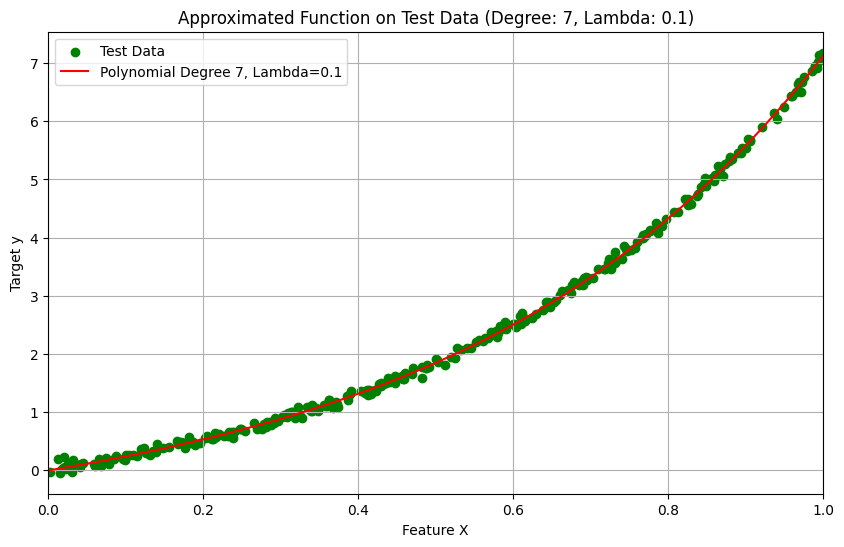


Weights for Subset Size: 700, Degree: 7, Lambda: 0.5
Weight for x^0: -0.001641998968991173
Weight for x^1: 2.235397478823552
Weight for x^2: 1.9229642035374526
Weight for x^3: 1.384846917313446
Weight for x^4: 0.9014482348864135
Weight for x^5: 0.5131230609961565
Weight for x^6: 0.21216405465061064
Weight for x^7: -0.01784917884074259


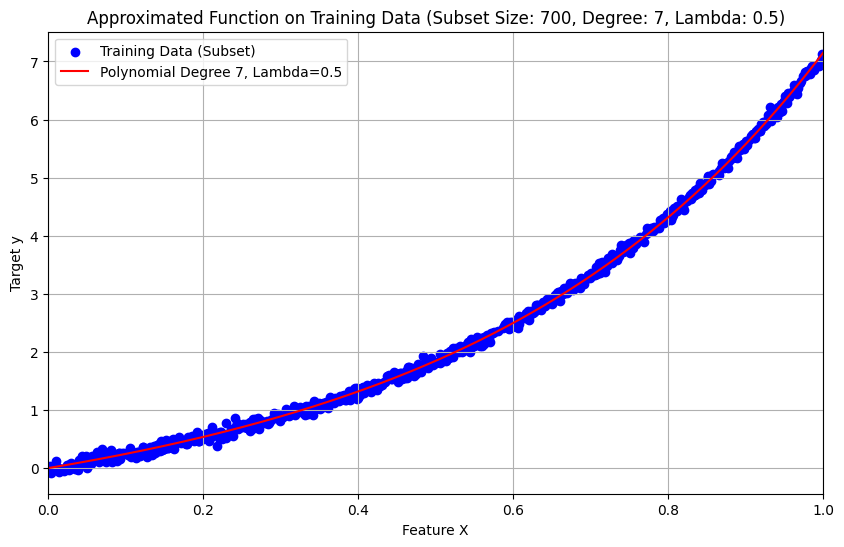

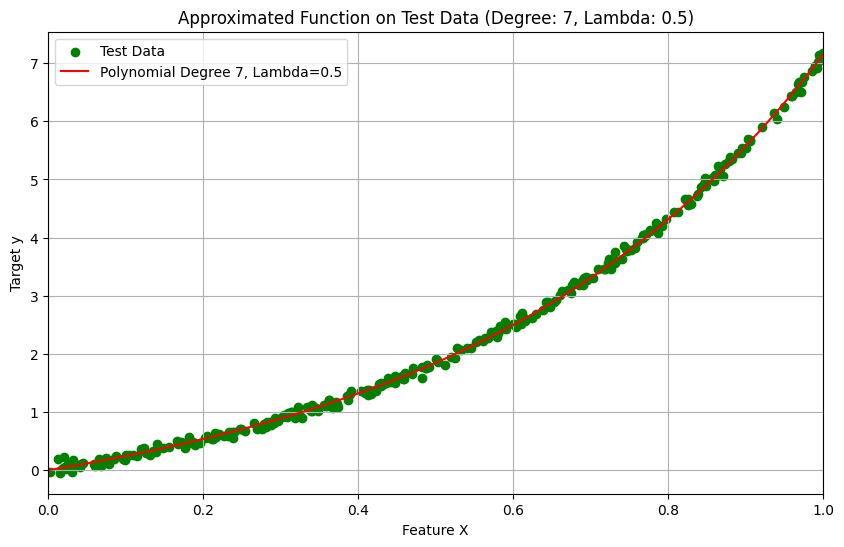


Weights for Subset Size: 700, Degree: 7, Lambda: 1.0
Weight for x^0: 0.007700446312613319
Weight for x^1: 2.2394929679357443
Weight for x^2: 1.888200144821359
Weight for x^3: 1.3473568027331153
Weight for x^4: 0.8834786026867039
Weight for x^5: 0.5214430066722474
Weight for x^6: 0.24601105658139627
Weight for x^7: 0.03792207692793003


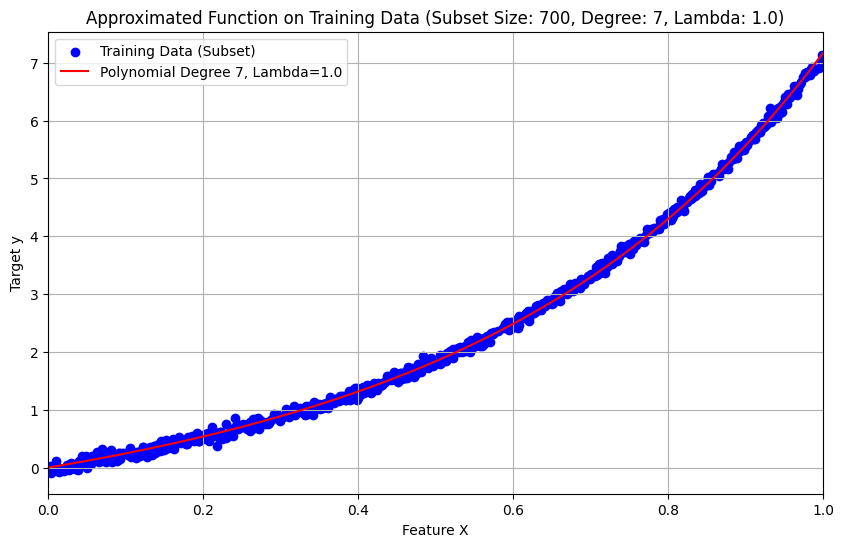

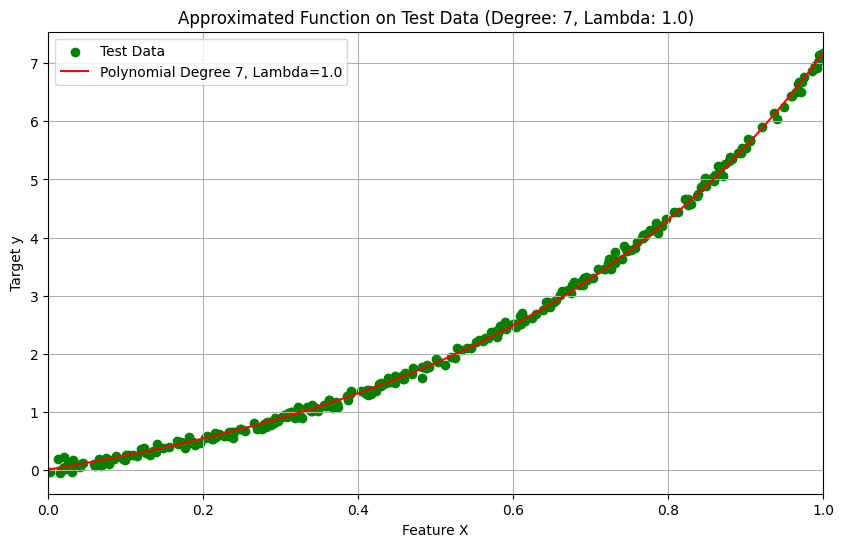


Weights for Subset Size: 700, Degree: 8, Lambda: 0.0
Weight for x^0: -0.027792384227702444
Weight for x^1: 3.2369312694407486
Weight for x^2: -13.693510703123815
Weight for x^3: 110.72562673350325
Weight for x^4: -400.0625485333663
Weight for x^5: 821.894853083183
Weight for x^6: -943.5669270041
Weight for x^7: 568.2235077145823
Weight for x^8: -139.61770252341415


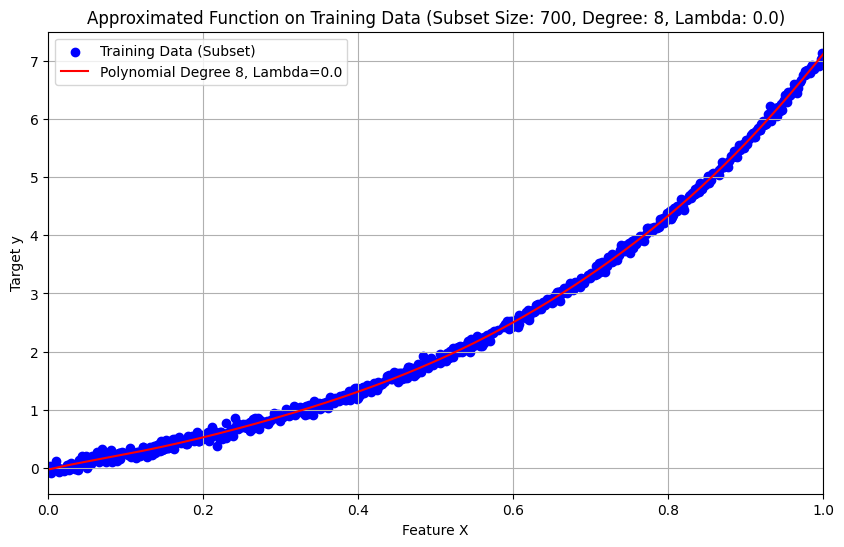

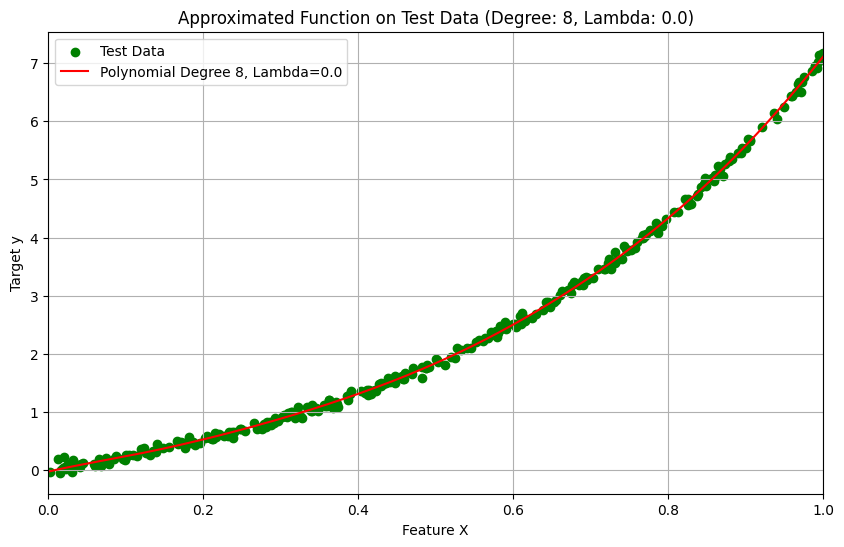


Weights for Subset Size: 700, Degree: 8, Lambda: 0.01
Weight for x^0: -0.010264799640909334
Weight for x^1: 2.2565422355708384
Weight for x^2: 1.8183908886034634
Weight for x^3: 1.5258254265116407
Weight for x^4: 1.0108875582365318
Weight for x^5: 0.5077346744165142
Weight for x^6: 0.14576688154579018
Weight for x^7: -0.04713656287456049
Weight for x^8: -0.09280286166099203


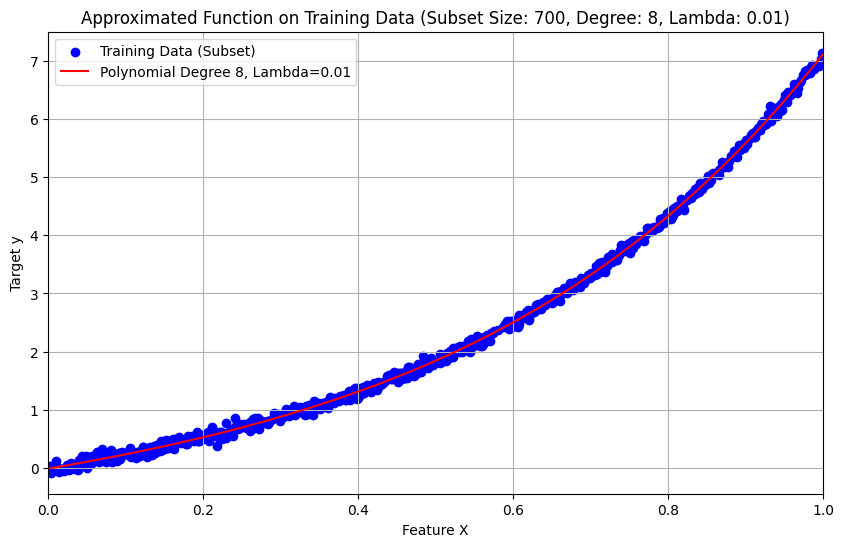

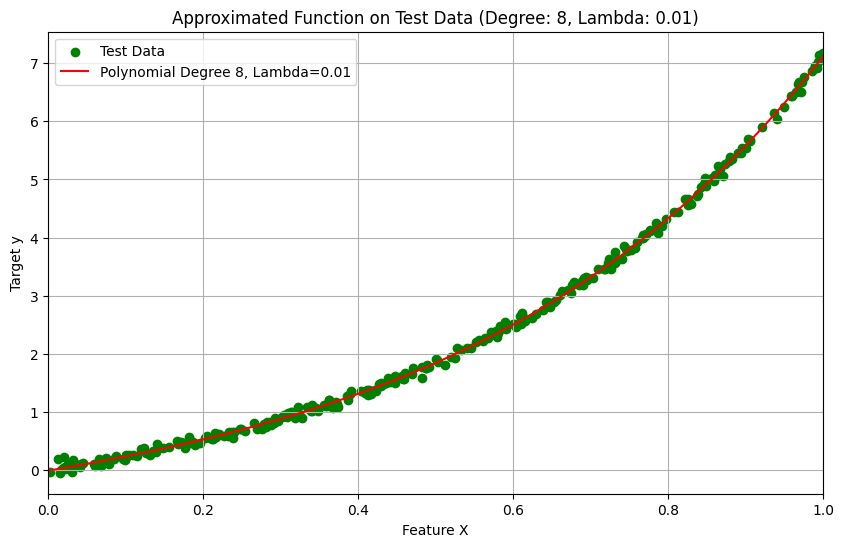


Weights for Subset Size: 700, Degree: 8, Lambda: 0.1
Weight for x^0: -0.007690154508029897
Weight for x^1: 2.23266652032057
Weight for x^2: 1.921099489874241
Weight for x^3: 1.41721922004504
Weight for x^4: 0.9365285229659116
Weight for x^5: 0.539551765080395
Weight for x^6: 0.2331180254618134
Weight for x^7: 0.005872124979753072
Weight for x^8: -0.15794262136047288


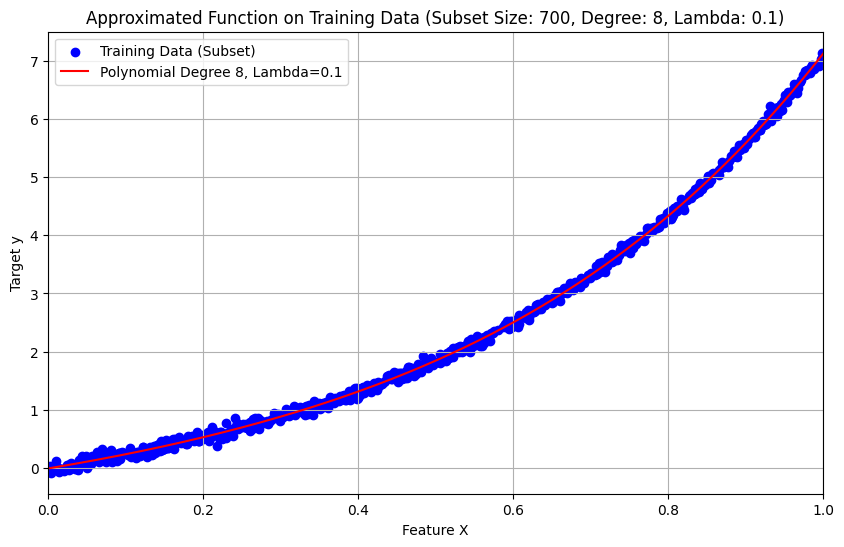

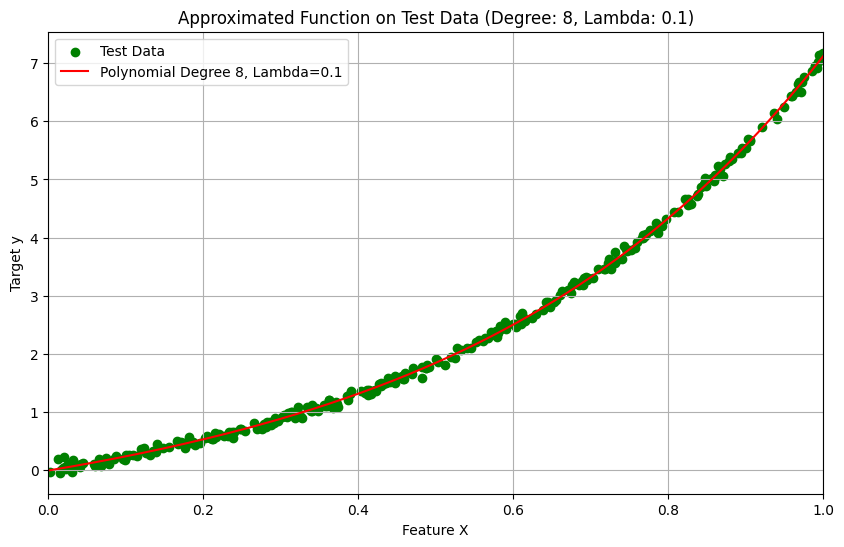


Weights for Subset Size: 700, Degree: 8, Lambda: 0.5
Weight for x^0: -0.0014634289758187885
Weight for x^1: 2.2397624967229643
Weight for x^2: 1.9079713566731535
Weight for x^3: 1.3733342456992483
Weight for x^4: 0.9054904365580834
Weight for x^5: 0.5366649620826102
Weight for x^6: 0.25512711568150015
Weight for x^7: 0.042745780567268105
Weight for x^8: -0.11673133448127315


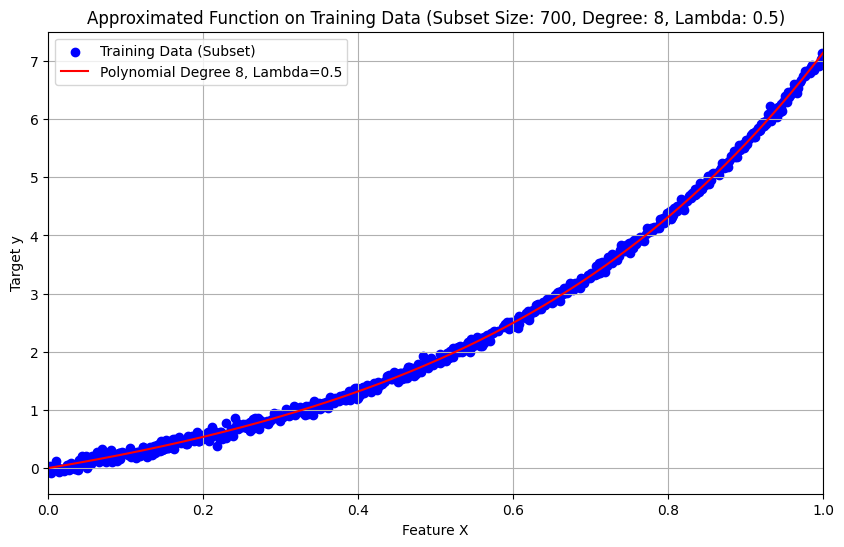

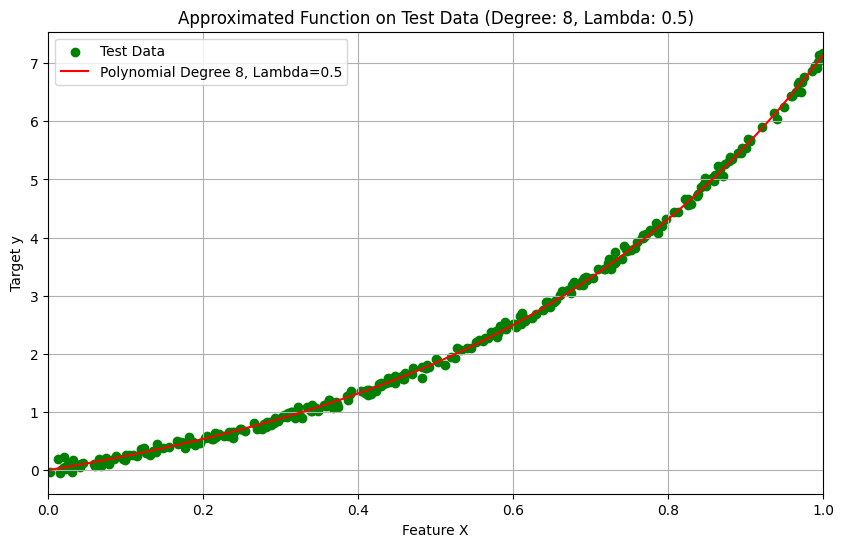


Weights for Subset Size: 700, Degree: 8, Lambda: 1.0
Weight for x^0: 0.008277715754741313
Weight for x^1: 2.238925689565224
Weight for x^2: 1.8798803974799236
Weight for x^3: 1.343728706783112
Weight for x^4: 0.8894483840549912
Weight for x^5: 0.5378826063644734
Weight for x^6: 0.2721446158712864
Weight for x^7: 0.07242452014405375
Weight for x^8: -0.0776632401291204


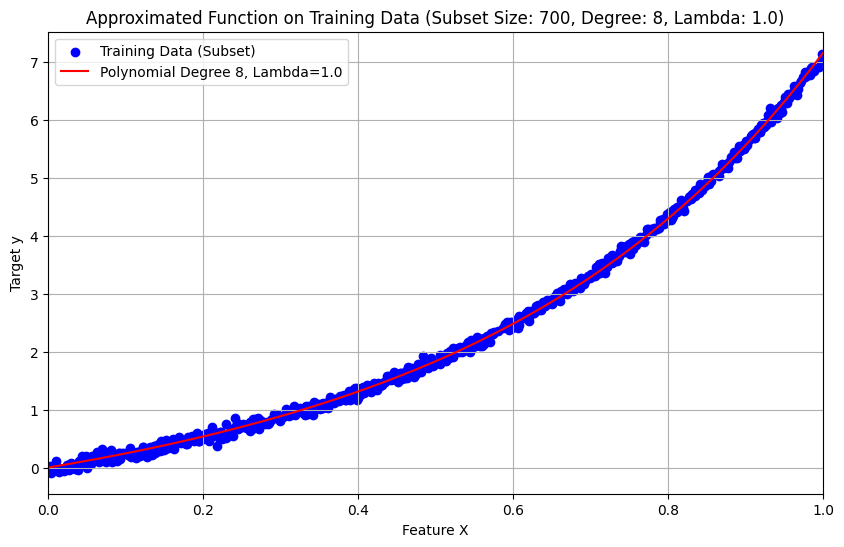

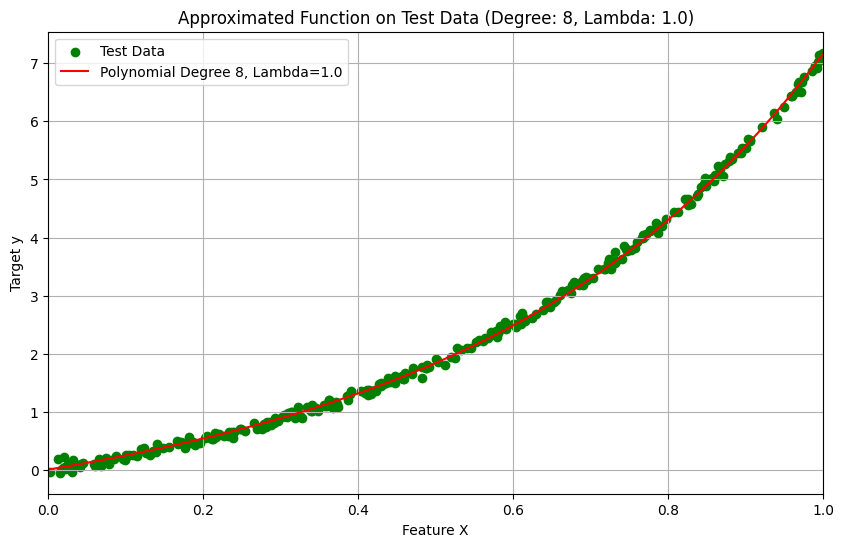


Weights for Subset Size: 700, Degree: 9, Lambda: 0.0
Weight for x^0: -0.026206118797414808
Weight for x^1: 3.077530972057448
Weight for x^2: -10.067969006769415
Weight for x^3: 76.26724649599416
Weight for x^4: -230.04493146367793
Weight for x^5: 341.64248967998765
Weight for x^6: -137.65194748855635
Weight for x^7: -225.65892285603098
Weight for x^8: 284.1262503066365
Weight for x^9: -94.55355984944302


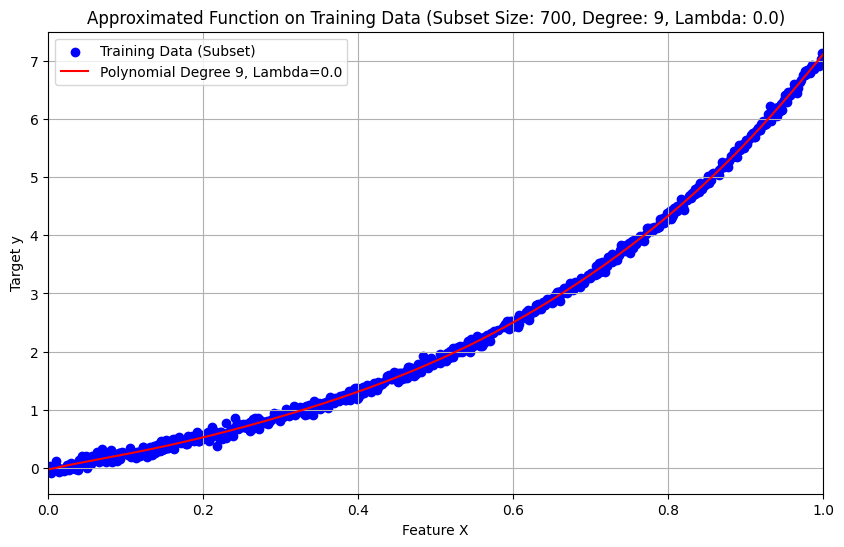

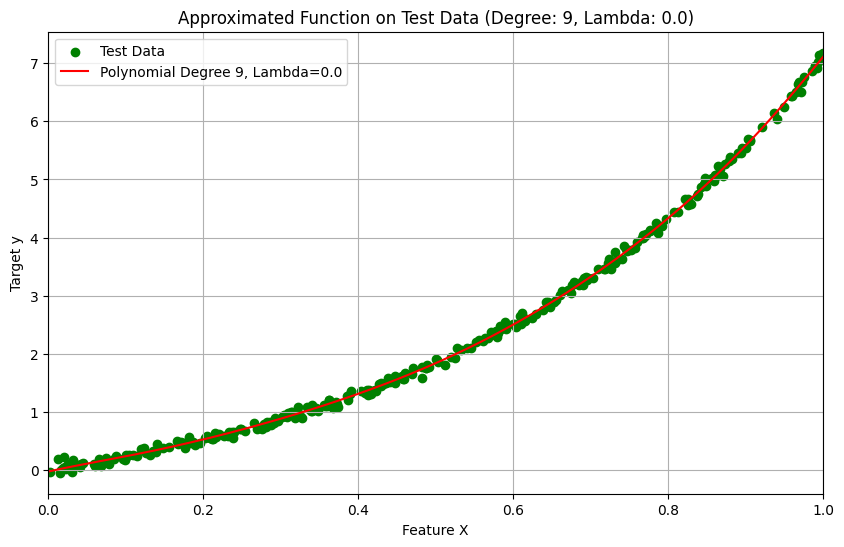


Weights for Subset Size: 700, Degree: 9, Lambda: 0.01
Weight for x^0: -0.010247100458373844
Weight for x^1: 2.2560836090698895
Weight for x^2: 1.820215443244498
Weight for x^3: 1.5254725899671924
Weight for x^4: 1.008239083393611
Weight for x^5: 0.5051715478881427
Weight for x^6: 0.14589840884104166
Weight for x^7: -0.042307536833463166
Weight for x^8: -0.08200480566880027
Weight for x^9: -0.011747626475155794


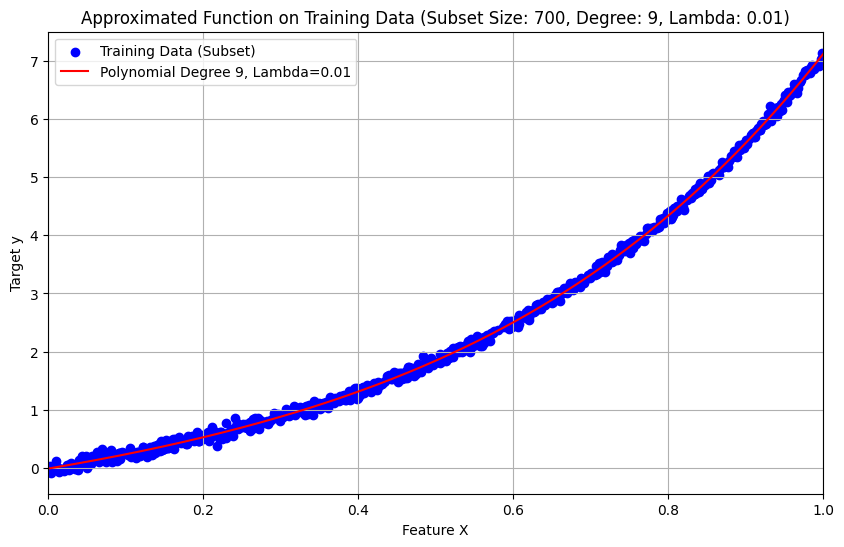

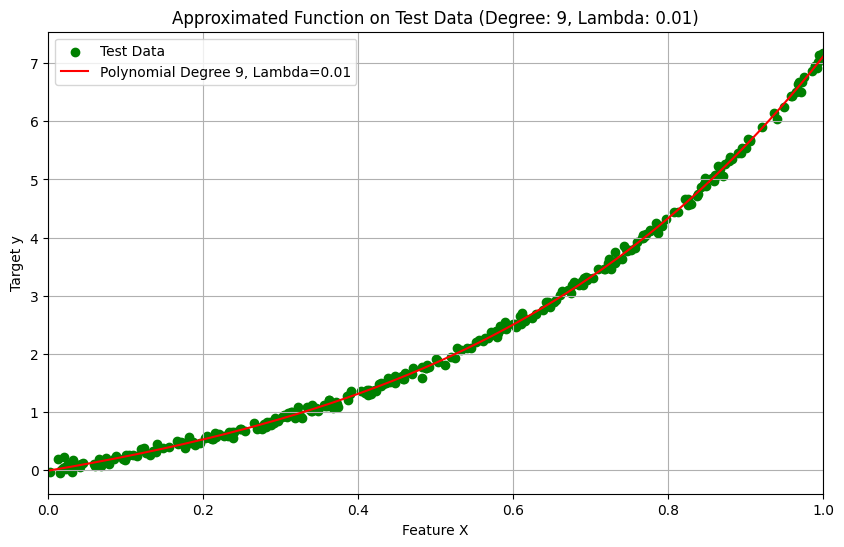


Weights for Subset Size: 700, Degree: 9, Lambda: 0.1
Weight for x^0: -0.008393174575545278
Weight for x^1: 2.2391938396748734
Weight for x^2: 1.9208376507965468
Weight for x^3: 1.3975172418050854
Weight for x^4: 0.9168242861173729
Weight for x^5: 0.5375301866113995
Weight for x^6: 0.25931253168733065
Weight for x^7: 0.06499601824498139
Weight for x^8: -0.06494382701640025
Weight for x^9: -0.14763228323202937


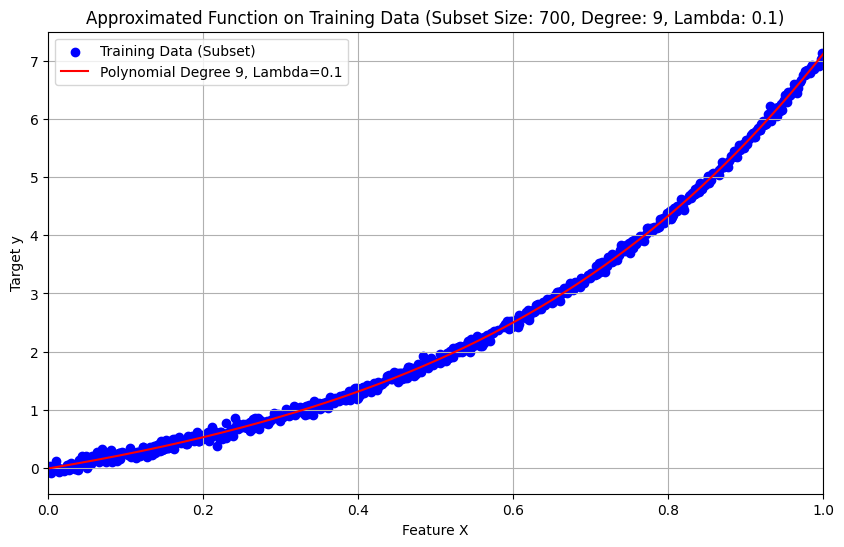

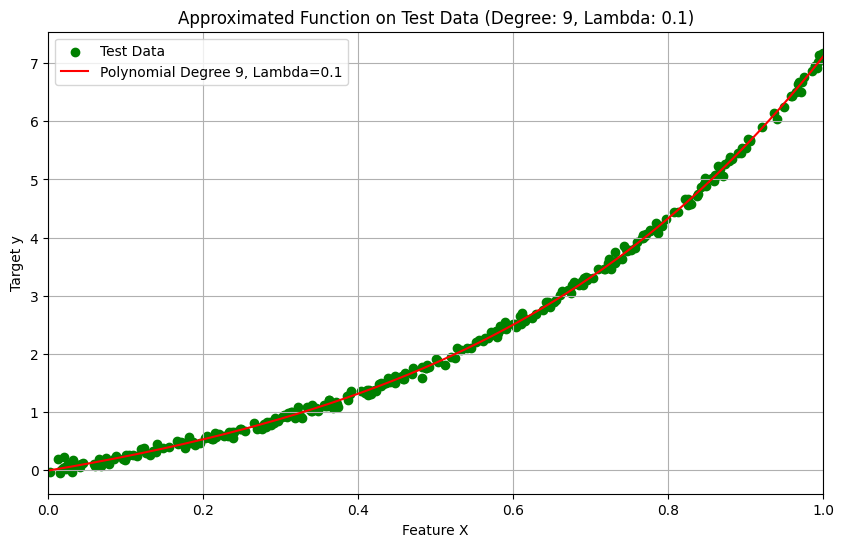


Weights for Subset Size: 700, Degree: 9, Lambda: 0.5
Weight for x^0: -0.0016163080079227721
Weight for x^1: 2.246841143602138
Weight for x^2: 1.8934987050722174
Weight for x^3: 1.3570923545131934
Weight for x^4: 0.9012543314353757
Weight for x^5: 0.5505573595626151
Weight for x^6: 0.2887157838733896
Weight for x^7: 0.09529540049888524
Weight for x^8: -0.046983434598846865
Weight for x^9: -0.15140562693143217


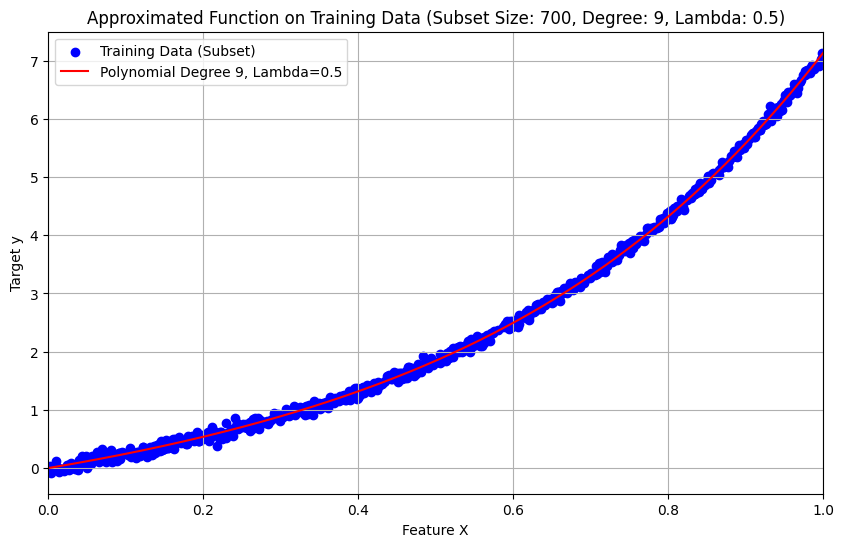

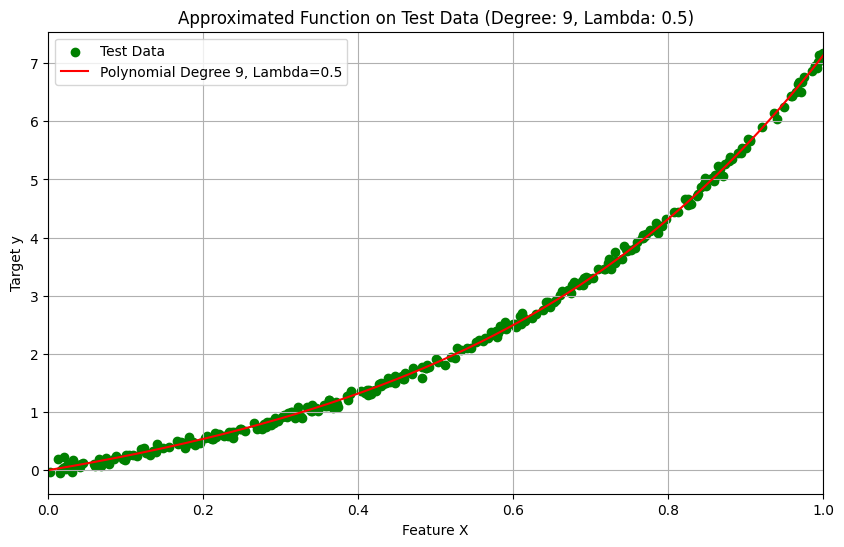


Weights for Subset Size: 700, Degree: 9, Lambda: 1.0
Weight for x^0: 0.008831074336415124
Weight for x^1: 2.2406607319729486
Weight for x^2: 1.8678216949387862
Weight for x^3: 1.334499176096191
Weight for x^4: 0.89123028142149
Weight for x^5: 0.5532241221586482
Weight for x^6: 0.30091179667454115
Weight for x^7: 0.11336650099995048
Weight for x^8: -0.026163520327794648
Weight for x^9: -0.13018466846105306


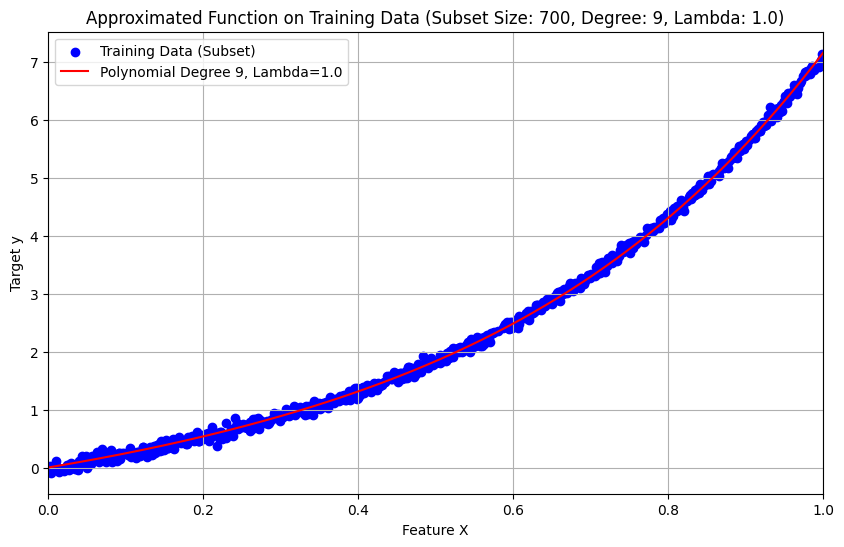

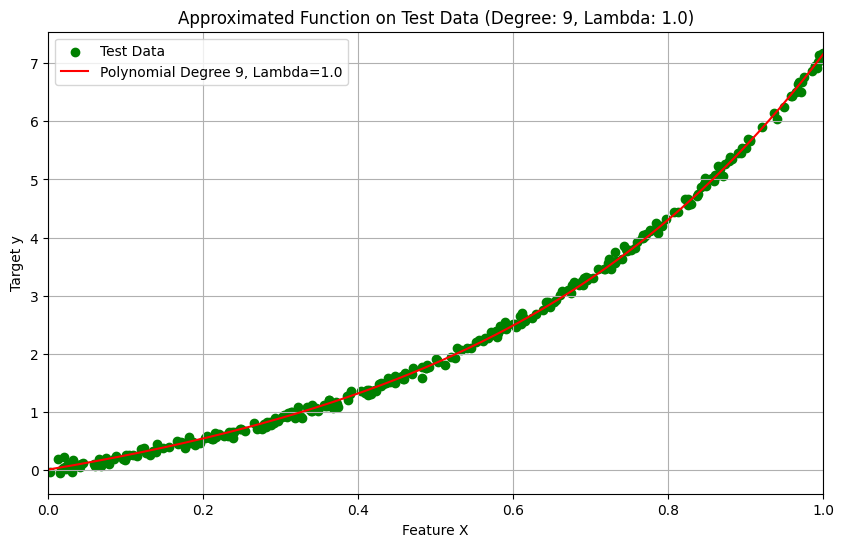

In [10]:
# Define parameters
subset_sizes = [10, 50, 100, 700]  # Different training sizes
degrees = [2, 3, 4, 5, 6, 7, 8, 9]  # Degrees for complexity
lambda_values = [0.0, 0.01, 0.1, 0.5, 1.0]  # Regularization parameters

for subset_size in subset_sizes:
    for degree in degrees:
        for lambda_reg in lambda_values:
            plot_approximated_function_with_weights(X_train, y_train, X_test, y_test, subset_size, degree, lambda_reg)


Training the Final Model

In [11]:
# Expand features with the best degree
X_train_poly_best = polynomial_features(X_train, best_degree)
X_test_poly_best = polynomial_features(X_test, best_degree)

# Train Ridge Regression with the best lambda
weights_final = ridge_regression(X_train_poly_best, y_train, best_lambda)
print(f"\nFinal model weights (Degree: {best_degree}, Lambda: {best_lambda}):")
print(weights_final)


Final model weights (Degree: 6, Lambda: 0.0):
[-0.01547195  2.3292867   1.8754967  -0.65744603  7.45656519 -6.37752211
  2.51082033]


Evaluating the Model

In [12]:
# Predictions on training set
y_train_pred = X_train_poly_best @ weights_final

# Prediction on test set
y_test_pred = X_test_poly_best @ weights_final

# Compute MSE
mse_train = mean_squared_error(y_train, y_train_pred)
mse_test = mean_squared_error(y_test, y_test_pred)

print(f"\nTraining MSE: {mse_train:.4f}")
print(f"Test MSE: {mse_test:.4f}")


Training MSE: 0.0032
Test MSE: 0.0030


Visualizing the Results

a) Plotting the Polynomial Fit on Training Data

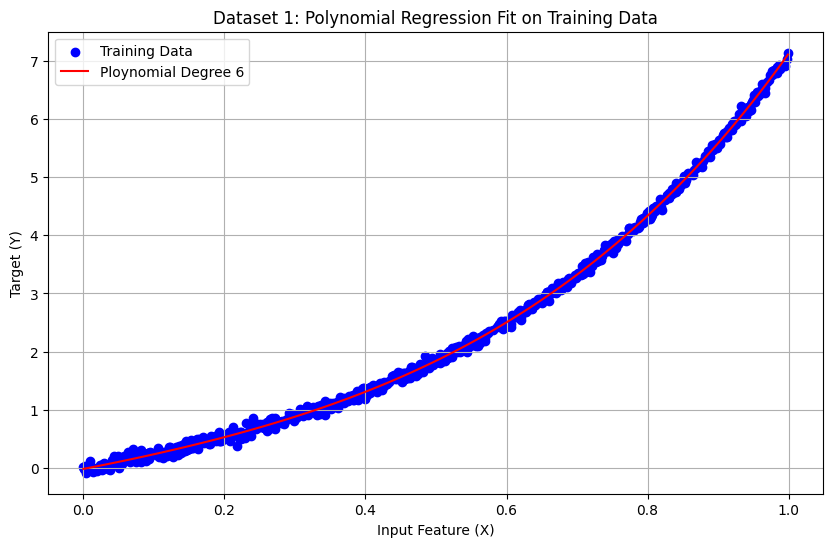

In [13]:
# Create a range of X values for plotting the polynomial curve
X_plot = np.linspace(X_train.min(), X_train.max(), 100).reshape(-1, 1)
X_plot_poly = polynomial_features(X_plot, best_degree)
y_plot = X_plot_poly @ weights_final

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_train, y_train, color='blue', label='Training Data')
plt.plot(X_plot, y_plot, color='red', label=f'Ploynomial Degree {best_degree}')
plt.title('Dataset 1: Polynomial Regression Fit on Training Data')
plt.xlabel('Input Feature (X)')
plt.ylabel('Target (Y)')
plt.legend()
plt.grid(True)
plt.show()

b) Plotting the Polynomial Fit on Test Data

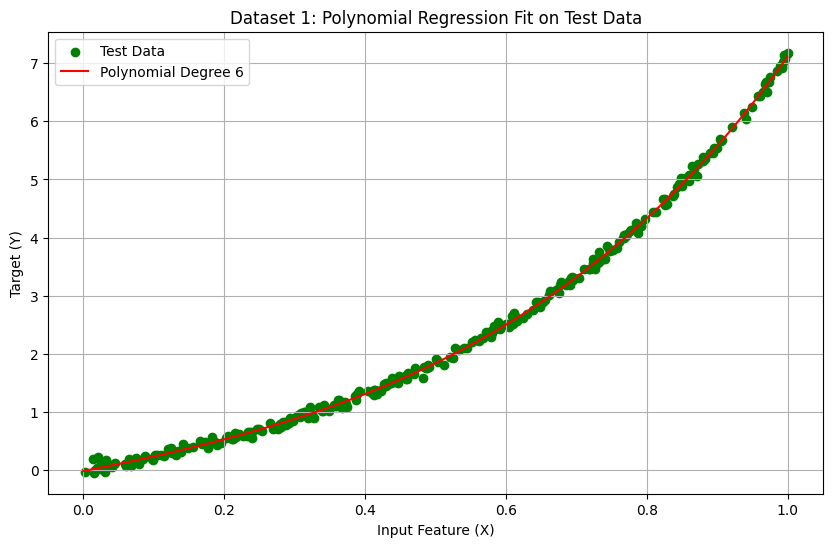

In [14]:
# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_test, y_test, color='green', label='Test Data')
plt.plot(X_plot, y_plot, color='red', label=f'Polynomial Degree {best_degree}')
plt.title('Dataset 1: Polynomial Regression Fit on Test Data')
plt.xlabel('Input Feature (X)')
plt.ylabel('Target (Y)')
plt.legend()
plt.grid(True)
plt.show()

In [15]:
def plot_mse_non_regularized_separate(degrees, subset_sizes, mse_results_non_reg):
    """
    Plot MSE vs. Polynomial Degree for Non-Regularized Models with separate graphs for each training subset size.

    Parameters:
    - degrees: List of polynomial degrees.
    - subset_sizes: List of training subset sizes.
    - mse_results_non_reg: Dictionary with subset_size as keys and list of MSEs as values.
    """
    for subset_size in subset_sizes:
        plt.figure(figsize=(10, 6))
        plt.plot(degrees, mse_results_non_reg[subset_size], marker='o', linestyle='-', color='blue')
        plt.title(f'MSE vs. Polynomial Degree (Non-Regularized) - Subset Size {subset_size}', fontsize=16)
        plt.xlabel('Polynomial Degree', fontsize=14)
        plt.ylabel('Mean Squared Error (MSE)', fontsize=14)
        plt.xticks(degrees)
        plt.grid(True)
        plt.tight_layout()
        plt.show()


In [16]:
def plot_mse_non_regularized(degrees, subset_sizes, mse_train, mse_test):
    """
    Plot Training and Test MSE vs. Polynomial Degree for Non-Regularized Models.

    Parameters:
    - degrees: List of polynomial degrees.
    - subset_sizes: List of training subset sizes.
    - mse_train: Dictionary with subset_size as keys and list of training MSEs as values.
    - mse_test: Dictionary with subset_size as keys and list of test MSEs as values.
    """
    for subset_size in subset_sizes:
        plt.figure(figsize=(10, 6))
        plt.plot(degrees, mse_train[subset_size], marker='o', linestyle='-', color='blue', label='Training MSE')
        plt.plot(degrees, mse_test[subset_size], marker='x', linestyle='--', color='red', label='Test MSE')
        plt.title(f'MSE vs. Polynomial Degree (Non-Regularized) - Subset Size {subset_size}', fontsize=16)
        plt.xlabel('Polynomial Degree', fontsize=14)
        plt.ylabel('Mean Squared Error (MSE)', fontsize=14)
        plt.xticks(degrees)
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()


In [17]:
def plot_mse_regularized(degrees, subset_sizes, lambda_regs, mse_train_reg, mse_test_reg):
    """
    Plot Training and Test MSE vs. Polynomial Degree for Regularized Models.

    Parameters:
    - degrees: List of polynomial degrees.
    - subset_sizes: List of training subset sizes.
    - lambda_regs: List of lambda values.
    - mse_train_reg: Nested dictionary with lambda_reg as keys and subset_size as subkeys mapping to training MSE lists.
    - mse_test_reg: Nested dictionary with lambda_reg as keys and subset_size as subkeys mapping to test MSE lists.
    """
    colors = ['green', 'purple', 'orange', 'brown', 'cyan']  # Extend as needed
    for subset_size in subset_sizes:
        plt.figure(figsize=(10, 6))
        for idx, lambda_reg in enumerate(lambda_regs):
            if lambda_reg == 0.0:
                continue  # Skip non-regularized
            plt.plot(degrees, mse_train_reg[lambda_reg][subset_size], 
                     marker='o', linestyle='-', color=colors[idx % len(colors)], 
                     label=f'Training MSE (Lambda={lambda_reg})')
            plt.plot(degrees, mse_test_reg[lambda_reg][subset_size], 
                     marker='x', linestyle='--', color=colors[idx % len(colors)], 
                     label=f'Test MSE (Lambda={lambda_reg})')
        plt.title(f'MSE vs. Polynomial Degree (Regularized) - Subset Size {subset_size}', fontsize=16)
        plt.xlabel('Polynomial Degree', fontsize=14)
        plt.ylabel('Mean Squared Error (MSE)', fontsize=14)
        plt.xticks(degrees)
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()


In [18]:
def plot_combined_mse_both(degrees, subset_size, lambda_regs, mse_train_reg, mse_test_reg, mse_train_non_reg, mse_test_non_reg):
    """
    Plot both Non-Regularized and Regularized Training and Test MSE vs. Polynomial Degree for a specific subset size.

    Parameters:
    - degrees: List of polynomial degrees.
    - subset_size: Specific training subset size to plot.
    - lambda_regs: List of lambda values.
    - mse_train_reg: Nested dictionary with lambda_reg as keys and subset_size as subkeys mapping to training MSE lists.
    - mse_test_reg: Nested dictionary with lambda_reg as keys and subset_size as subkeys mapping to test MSE lists.
    - mse_train_non_reg: Dictionary with subset_size as keys and list of training MSEs as values.
    - mse_test_non_reg: Dictionary with subset_size as keys and list of test MSEs as values.
    """
    plt.figure(figsize=(10, 6))
    
    # Plot Non-Regularized MSEs
    plt.plot(degrees, mse_train_non_reg[subset_size], marker='o', linestyle='-', color='black', label='Training MSE (Non-Regularized)')
    plt.plot(degrees, mse_test_non_reg[subset_size], marker='x', linestyle='--', color='gray', label='Test MSE (Non-Regularized)')
    
    # Plot Regularized MSEs
    colors = ['green', 'purple', 'orange', 'brown', 'cyan']  # Extend as needed
    for idx, lambda_reg in enumerate(lambda_regs):
        if lambda_reg == 0.0:
            continue  # Skip non-regularized
        plt.plot(degrees, mse_train_reg[lambda_reg][subset_size], 
                 marker='o', linestyle='-', color=colors[idx % len(colors)], 
                 label=f'Training MSE (Lambda={lambda_reg})')
        plt.plot(degrees, mse_test_reg[lambda_reg][subset_size], 
                 marker='x', linestyle='--', color=colors[idx % len(colors)], 
                 label=f'Test MSE (Lambda={lambda_reg})')
    
    plt.title(f'Combined MSE vs. Polynomial Degree - Subset Size {subset_size}', fontsize=16)
    plt.xlabel('Polynomial Degree', fontsize=14)
    plt.ylabel('Mean Squared Error (MSE)', fontsize=14)
    plt.xticks(degrees)
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [19]:
# Define the training subset sizes
subset_sizes = [10, 50, 100, 700]

# Initialize dictionaries to store MSE results
mse_results_non_reg_train = {subset_size: [] for subset_size in subset_sizes}
mse_results_non_reg_test = {subset_size: [] for subset_size in subset_sizes}

mse_results_reg_train = {lambda_reg: {subset_size: [] for subset_size in subset_sizes} 
                         for lambda_reg in lambda_regs if lambda_reg != 0.0}
mse_results_reg_test = {lambda_reg: {subset_size: [] for subset_size in subset_sizes} 
                        for lambda_reg in lambda_regs if lambda_reg != 0.0}


for subset_size in subset_sizes:
    # Select the subset from the training data
    X_train_subset = X_train[:subset_size]
    y_train_subset = y_train[:subset_size]
    
    for degree in degrees:
        # Expand features
        X_train_poly = polynomial_features(X_train_subset, degree)
        X_test_poly = polynomial_features(X_test, degree)
        
        for lambda_reg in lambda_regs:
            # Train Ridge Regression model
            weights = ridge_regression(X_train_poly, y_train_subset, lambda_reg)
            
            # Predict on training set
            y_pred_train = X_train_poly @ weights
            mse_train = mean_squared_error(y_train_subset, y_pred_train)
            
            # Predict on test set
            y_pred_test = X_test_poly @ weights
            mse_test = mean_squared_error(y_test, y_pred_test)
            
            # Store MSEs
            if lambda_reg == 0.0:
                mse_results_non_reg_train[subset_size].append(mse_train)
                mse_results_non_reg_test[subset_size].append(mse_test)
                print(f"Non-Regularized | Subset Size: {subset_size}, Degree: {degree}, Training MSE: {mse_train:.4f}, Test MSE: {mse_test:.4f}")
            else:
                mse_results_reg_train[lambda_reg][subset_size].append(mse_train)
                mse_results_reg_test[lambda_reg][subset_size].append(mse_test)
                print(f"Regularized (Lambda={lambda_reg}) | Subset Size: {subset_size}, Degree: {degree}, Training MSE: {mse_train:.4f}, Test MSE: {mse_test:.4f}")



Non-Regularized | Subset Size: 10, Degree: 2, Training MSE: 0.0066, Test MSE: 0.0144
Regularized (Lambda=0.01) | Subset Size: 10, Degree: 2, Training MSE: 0.0130, Test MSE: 0.0138
Regularized (Lambda=0.1) | Subset Size: 10, Degree: 2, Training MSE: 0.0689, Test MSE: 0.0483
Regularized (Lambda=0.5) | Subset Size: 10, Degree: 2, Training MSE: 0.2737, Test MSE: 0.1875
Regularized (Lambda=1.0) | Subset Size: 10, Degree: 2, Training MSE: 0.5683, Test MSE: 0.4057
Non-Regularized | Subset Size: 10, Degree: 3, Training MSE: 0.0016, Test MSE: 0.0039
Regularized (Lambda=0.01) | Subset Size: 10, Degree: 3, Training MSE: 0.0020, Test MSE: 0.0046
Regularized (Lambda=0.1) | Subset Size: 10, Degree: 3, Training MSE: 0.0096, Test MSE: 0.0078
Regularized (Lambda=0.5) | Subset Size: 10, Degree: 3, Training MSE: 0.0992, Test MSE: 0.0727
Regularized (Lambda=1.0) | Subset Size: 10, Degree: 3, Training MSE: 0.2643, Test MSE: 0.1964
Non-Regularized | Subset Size: 10, Degree: 4, Training MSE: 0.0009, Test MSE

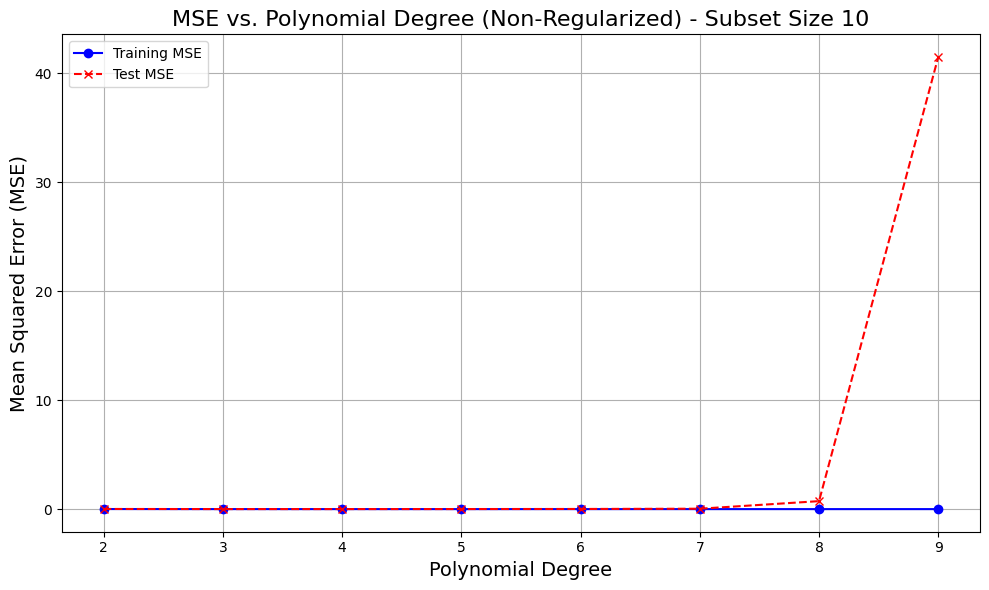

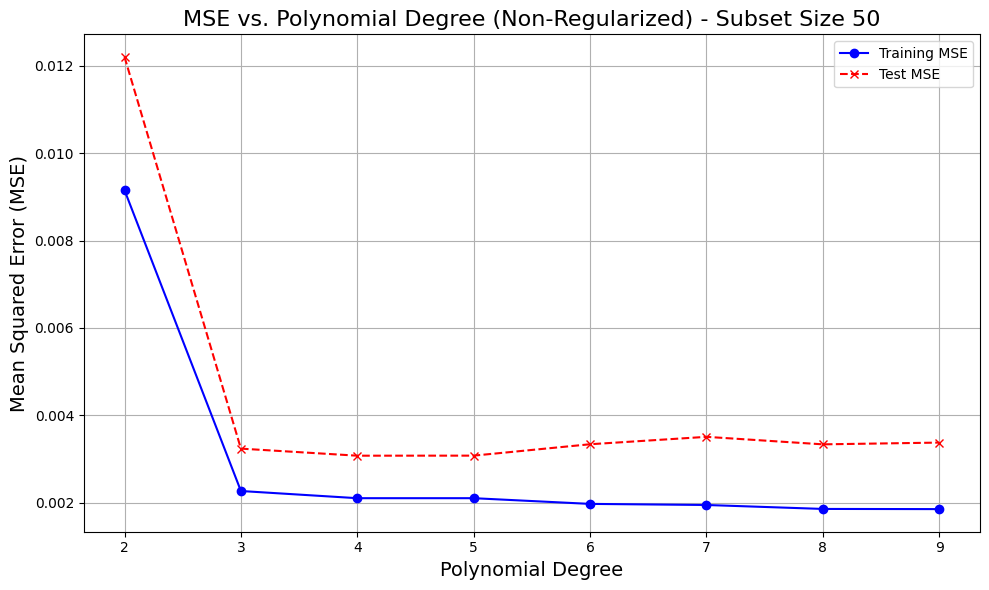

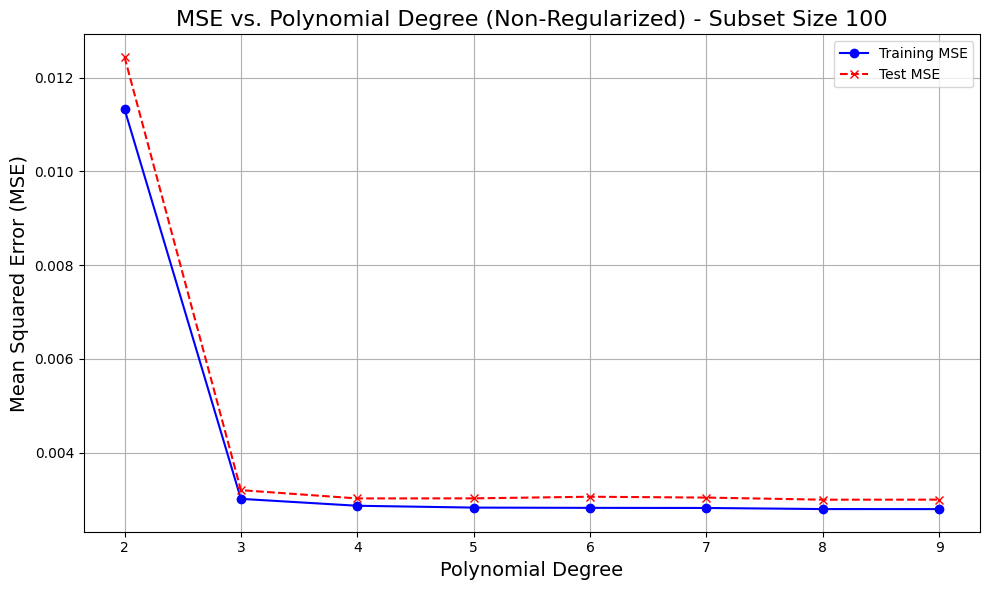

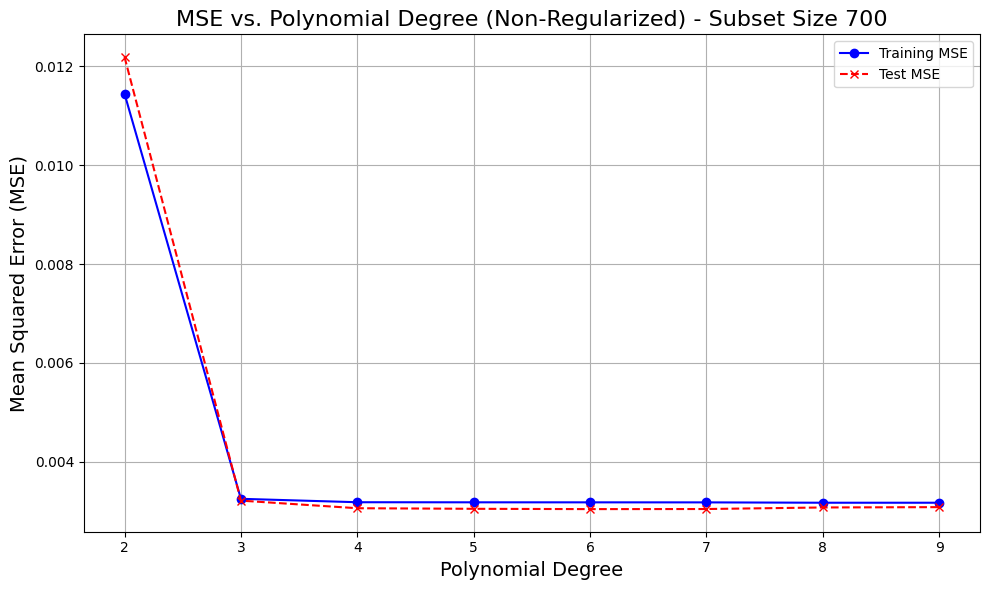

In [20]:
# Assuming mse_results_non_reg is structured as {subset_size: [mse_degree2, mse_degree3, ..., mse_degree9]}
plot_mse_non_regularized(degrees, subset_sizes, mse_results_non_reg_train, mse_results_non_reg_test)

In [21]:
def plot_mse_regularized_separate(degrees, subset_sizes, lambda_regularized, mse_results_reg):
    """
    Plot MSE vs. Polynomial Degree for Regularized Models with separate lines for each lambda and subset size.
    
    Parameters:
    - degrees: List of polynomial degrees.
    - subset_sizes: List of training subset sizes.
    - lambda_regularized: List of lambda values.
    - mse_results_reg: Nested dictionary with lambda as keys and subset_size as subkeys.
    """
    num_subset = len(subset_sizes)
    num_cols = 2
    num_rows = int(np.ceil(num_subset / num_cols))
    
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(14, 6*num_rows))
    axes = axes.flatten()
    
    for idx, subset_size in enumerate(subset_sizes):
        ax = axes[idx]
        for lambda_reg in lambda_regularized:
            # Extract MSE values for current lambda and subset size across degrees
            mse_values = [mse_results_reg[lambda_reg][subset_size][deg - degrees[0]] for deg in degrees]
            ax.plot(degrees, mse_values, marker='o', label=f'Lambda {lambda_reg}')
        
        ax.set_title(f'Regularized Models | Subset Size {subset_size}', fontsize=16)
        ax.set_xlabel('Polynomial Degree', fontsize=14)
        ax.set_ylabel('Mean Squared Error (MSE)', fontsize=14)
        ax.legend(title='Lambda Values')
        ax.set_xticks(degrees)
        ax.grid(True)
    
    # If there are unused subplots, hide them
    for j in range(idx+1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.tight_layout()
    plt.show()


In [22]:
def plot_mse_regularized_separate_per_lambda_subset_size(
    degrees, 
    subset_sizes, 
    lambda_regs, 
    mse_train_reg, 
    mse_test_reg,
):
    
    # Define colors and markers for clarity
    color_train = 'blue'
    color_test = 'red'
    marker_train = 'o'
    marker_test = 'x'
    
    for subset_size in subset_sizes:
        for lambda_reg in lambda_regs:
            # Check if the current combination has MSE data
            if (lambda_reg not in mse_train_reg or 
                subset_size not in mse_train_reg[lambda_reg] or
                subset_size not in mse_test_reg[lambda_reg]):
                print(f"Warning: No data for Lambda={lambda_reg} and Subset Size={subset_size}. Skipping.")
                continue
            
            training_mse = mse_train_reg[lambda_reg][subset_size]
            test_mse = mse_test_reg[lambda_reg][subset_size]
            
            # Create a new figure for each combination
            plt.figure(figsize=(10, 6))
            
            # Plot Training MSE
            plt.plot(degrees, training_mse, linestyle='-', color=color_train, marker=marker_train, 
                     label='Training MSE')
            
            # Plot Test MSE
            plt.plot(degrees, test_mse, linestyle='--', color=color_test, marker=marker_test, 
                     label='Test MSE')
            
            # Customize the plot
            plt.title(f'MSE vs. Polynomial Degree\nSubset Size: {subset_size}, Lambda: {lambda_reg}', fontsize=16)
            plt.xlabel('Polynomial Degree', fontsize=14)
            plt.ylabel('Mean Squared Error (MSE)', fontsize=14)
            plt.xticks(degrees)
            plt.legend()
            plt.grid(True)
            plt.tight_layout()
            
            # Display the plot
            plt.show()


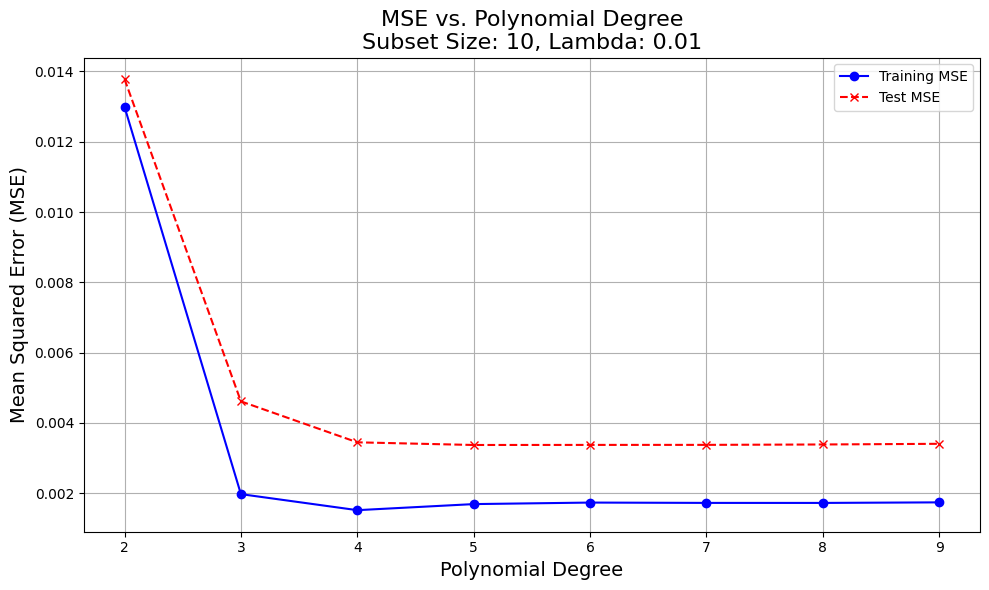

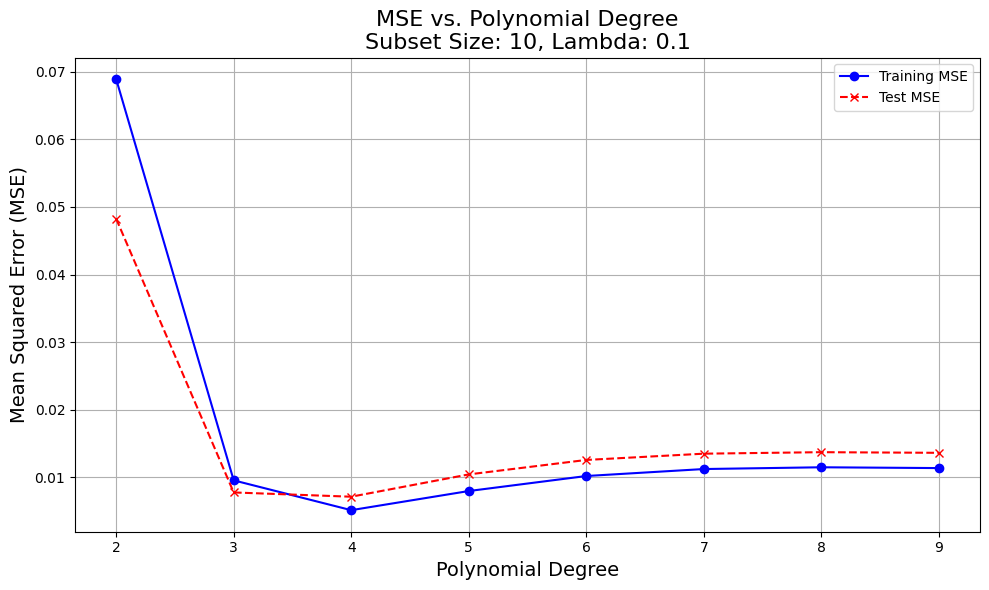

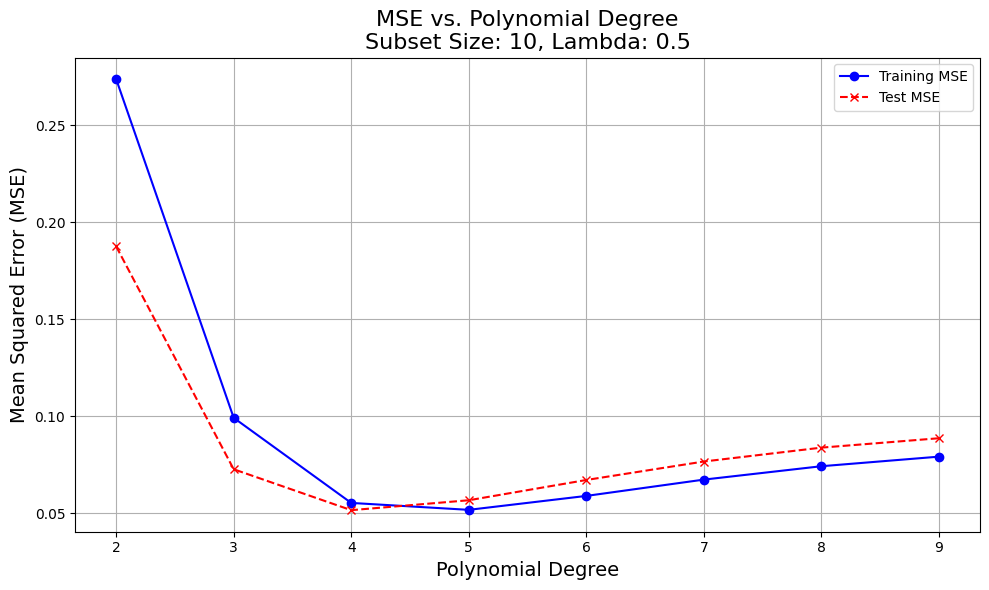

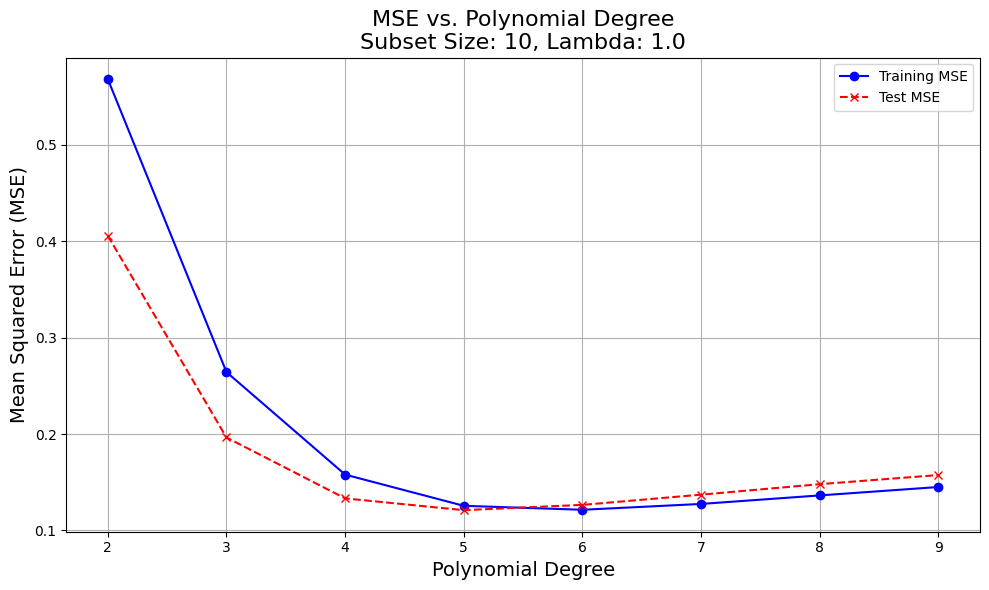

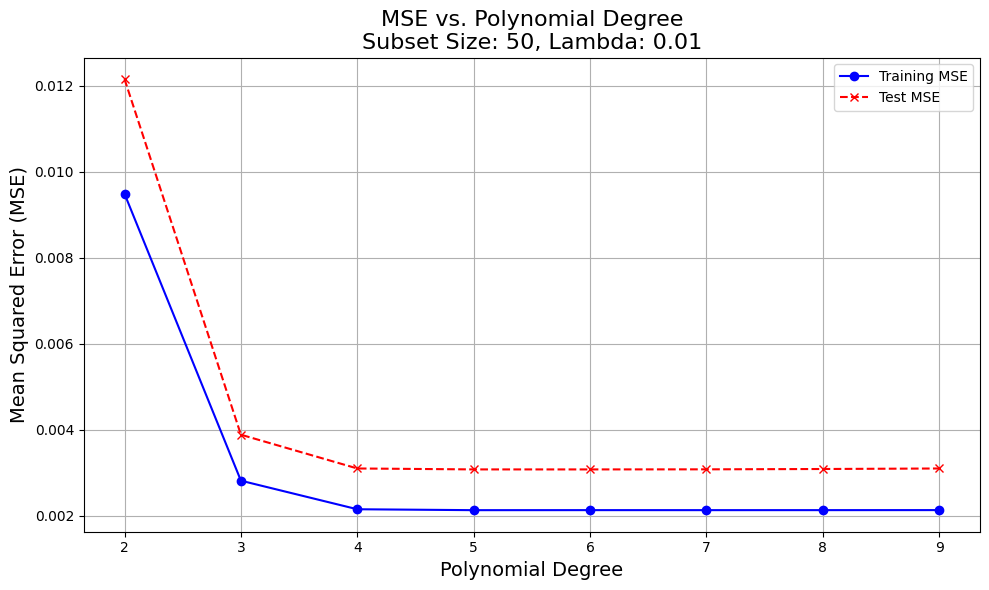

...

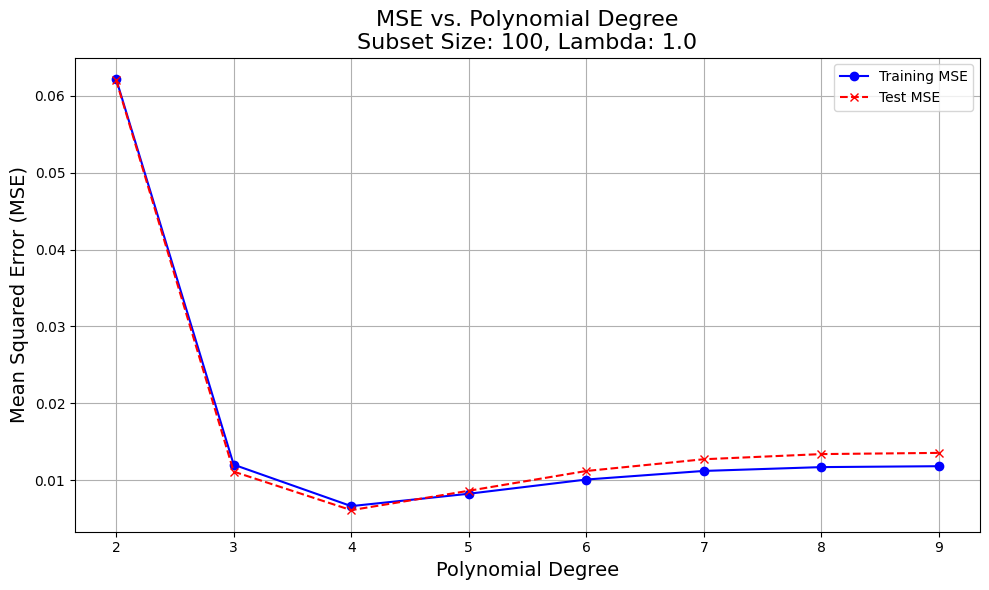

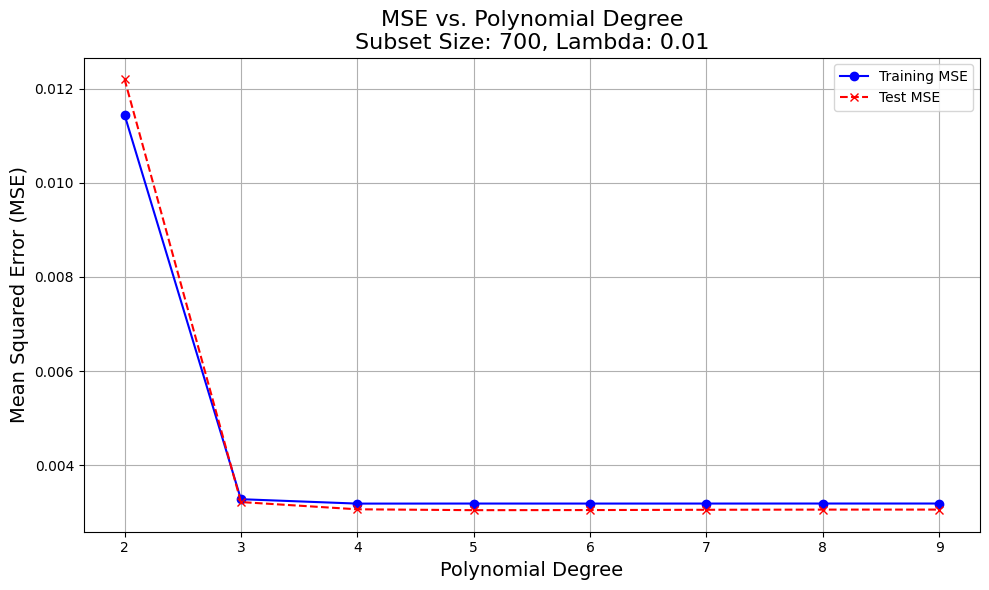

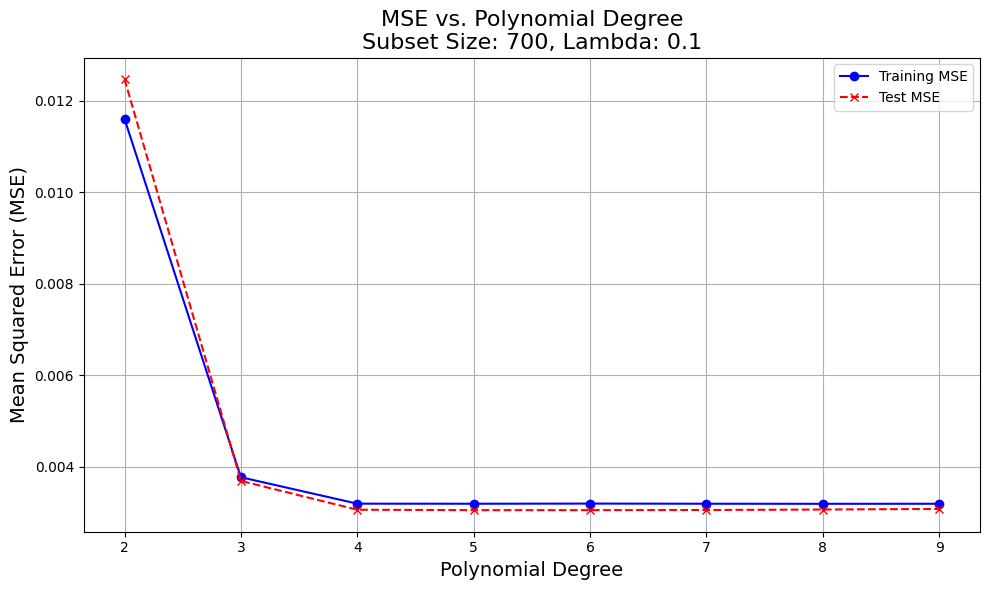

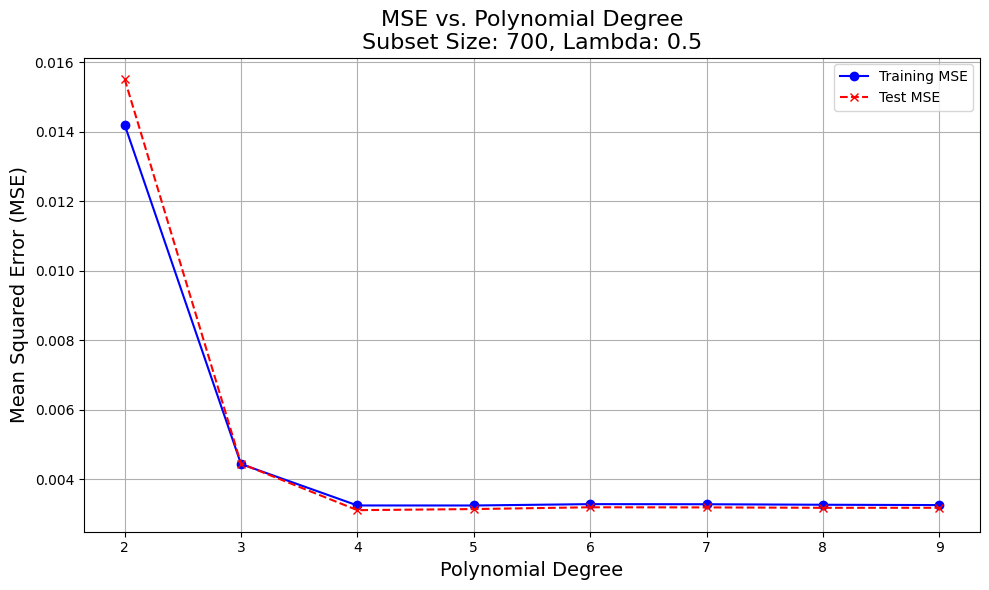

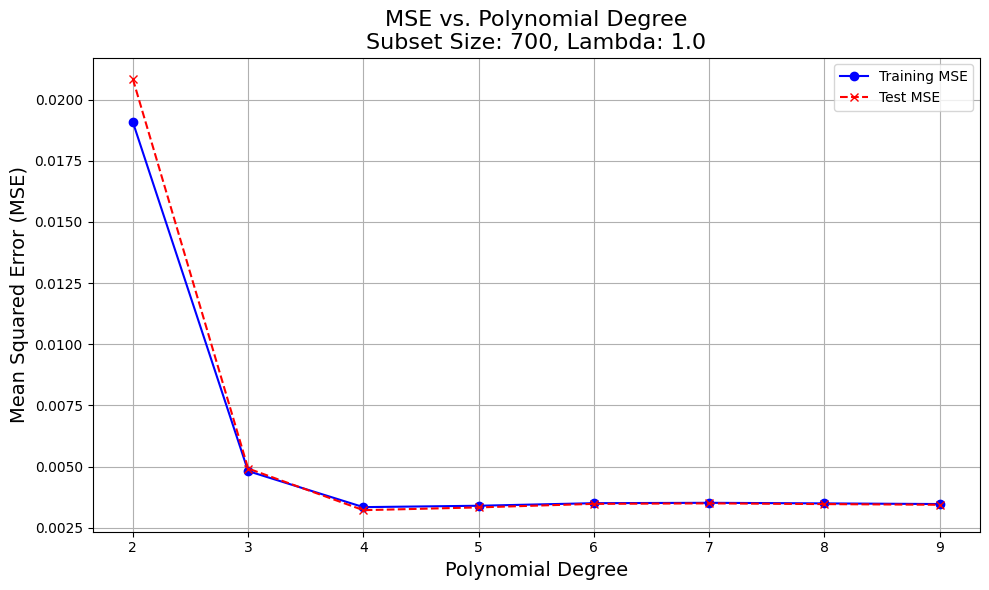

In [23]:
# Call the new plotting function
plot_mse_regularized_separate_per_lambda_subset_size(
    degrees=degrees, 
    subset_sizes=subset_sizes,
    lambda_regs=lambda_regs,  
    mse_train_reg=mse_results_reg_train, 
    mse_test_reg=mse_results_reg_test
)


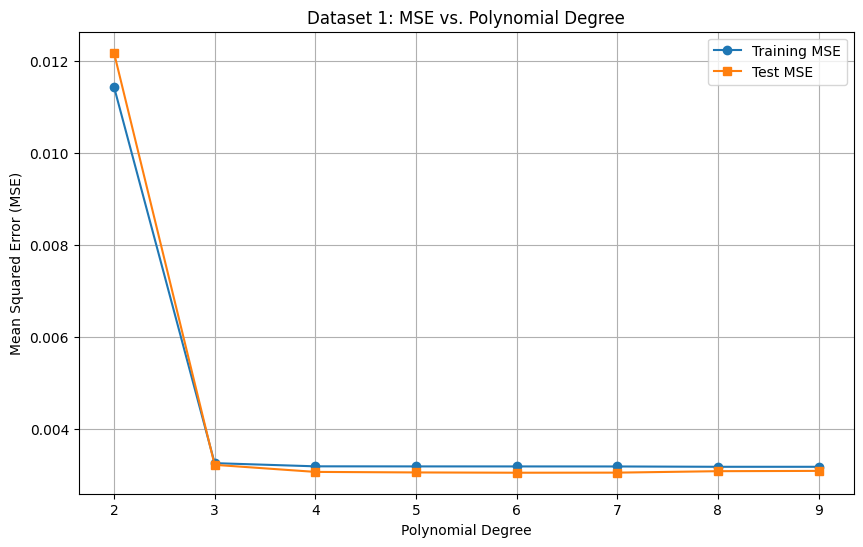

In [24]:
# Initialize lists to store MSE values
mse_train_list = []
mse_test_list = []

# Define a range of degrees to evaluate
degrees_plot = list(range(2, 10))

for degree in degrees_plot:
    # Expand features
    X_train_poly_temp = polynomial_features(X_train, degree)
    X_test_poly_temp = polynomial_features(X_test, degree)

    # Train Ridge Regression with the best lambda
    weights_temp = ridge_regression(X_train_poly_temp, y_train, best_lambda)

    # Predictions
    y_train_pred_temp = X_train_poly_temp @ weights_temp
    y_test_pred_temp = X_test_poly_temp @ weights_temp

    # Compute MSE
    mse_train_temp = mean_squared_error(y_train, y_train_pred_temp)
    mse_test_temp = mean_squared_error(y_test, y_test_pred_temp)

    mse_train_list.append(mse_train_temp)
    mse_test_list.append(mse_test_temp)

# Plot MSE vs. Degree
plt.figure(figsize=(10, 6))
plt.plot(degrees_plot, mse_train_list, marker='o', label='Training MSE')
plt.plot(degrees_plot, mse_test_list, marker='s', label='Test MSE')
plt.title('Dataset 1: MSE vs. Polynomial Degree')
plt.xlabel('Polynomial Degree')
plt.ylabel('Mean Squared Error (MSE)')
plt.xticks(degrees_plot)
plt.legend()
plt.grid(True)
plt.show()

d) Scatter Plot: Actual vs. Predicted Targets

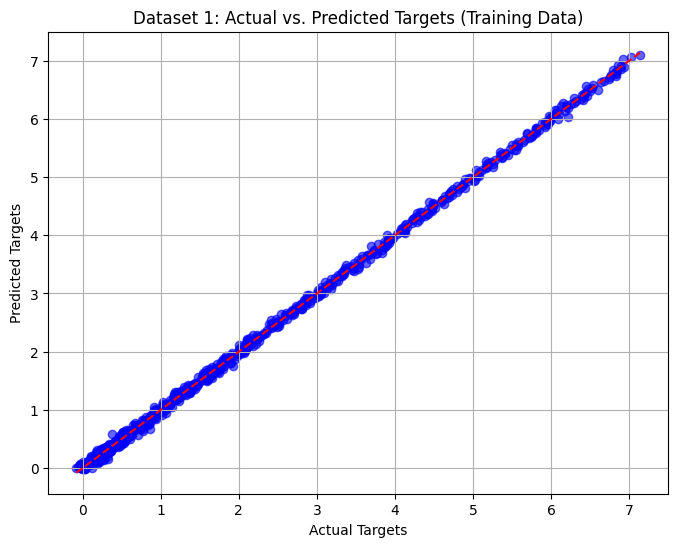

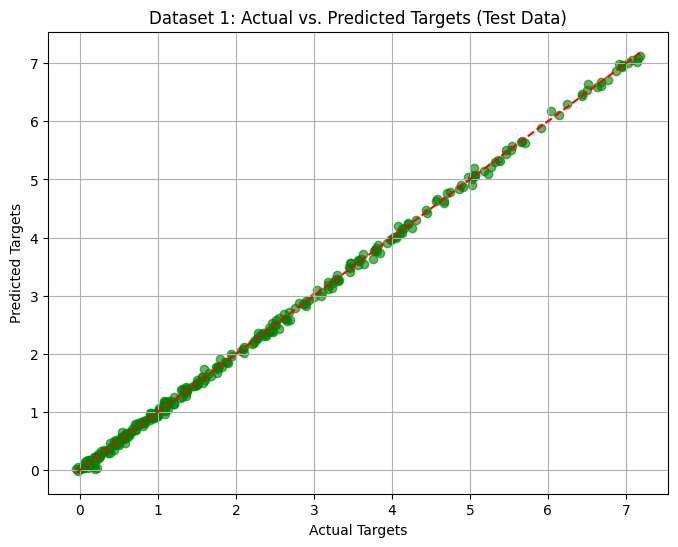

In [25]:
# Training Data
plt.figure(figsize=(8, 6))
plt.scatter(y_train, y_train_pred, color='blue', alpha=0.6)
plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'r--')
plt.title('Dataset 1: Actual vs. Predicted Targets (Training Data)')
plt.xlabel('Actual Targets')
plt.ylabel('Predicted Targets')
plt.grid(True)
plt.show()

# Test Data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred, color='green', alpha=0.6)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.title('Dataset 1: Actual vs. Predicted Targets (Test Data)')
plt.xlabel('Actual Targets')
plt.ylabel('Predicted Targets')
plt.grid(True)
plt.show()


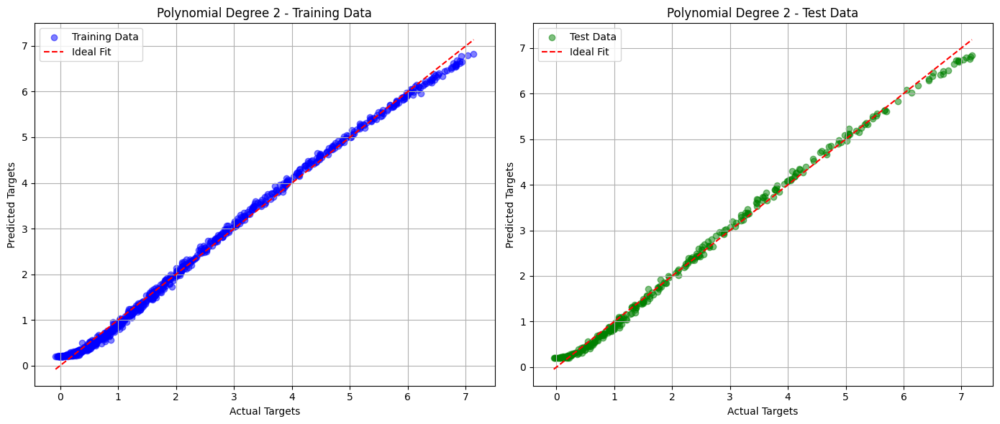

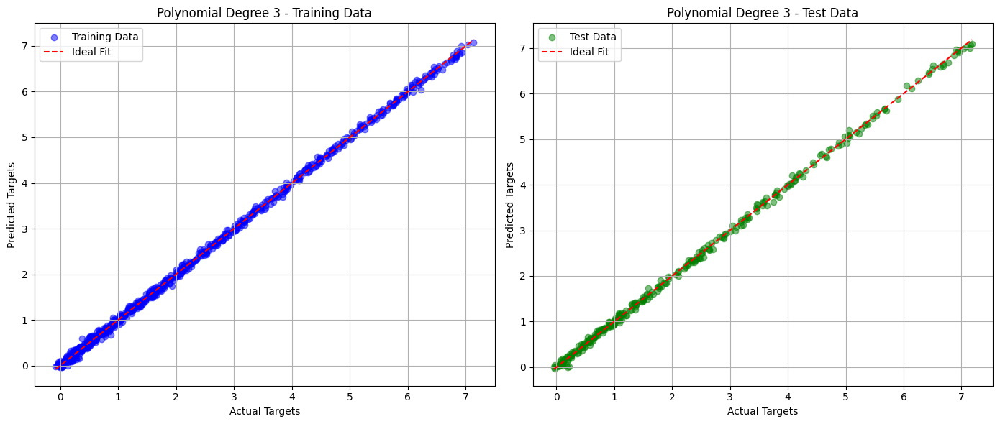

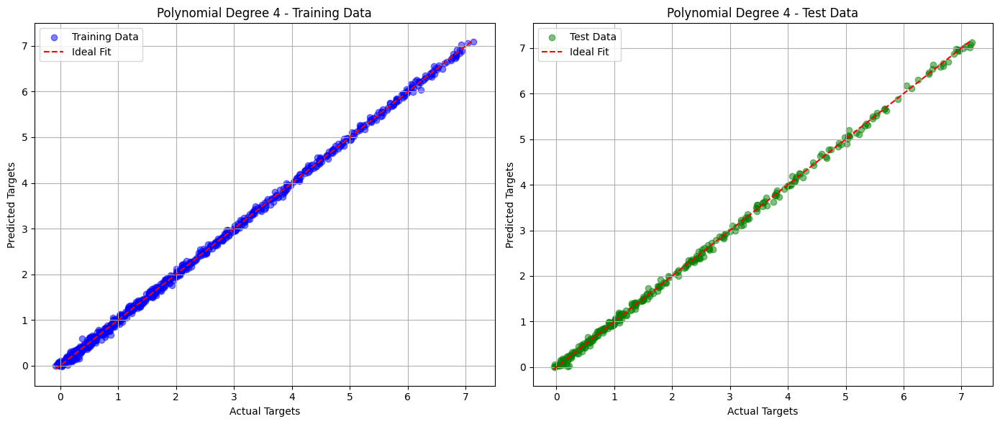

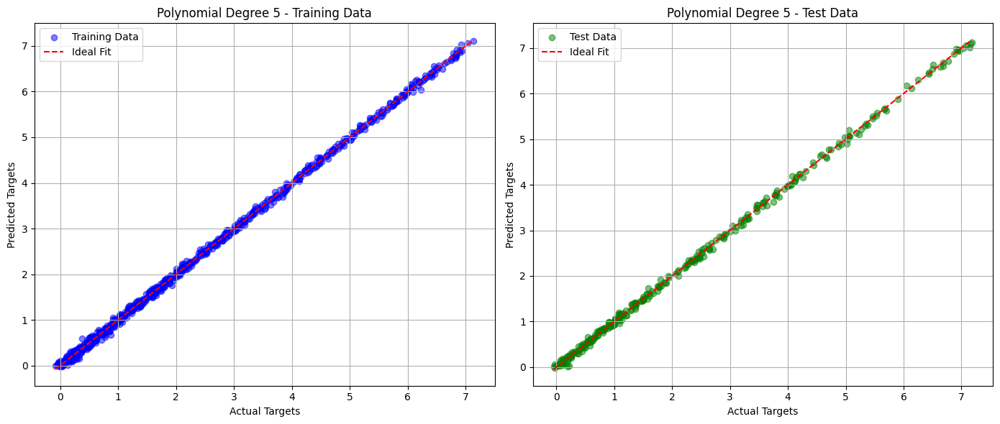

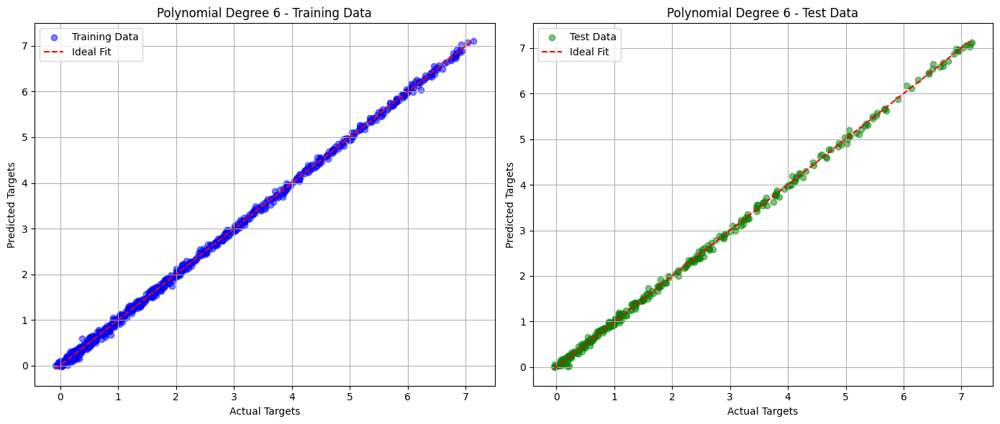

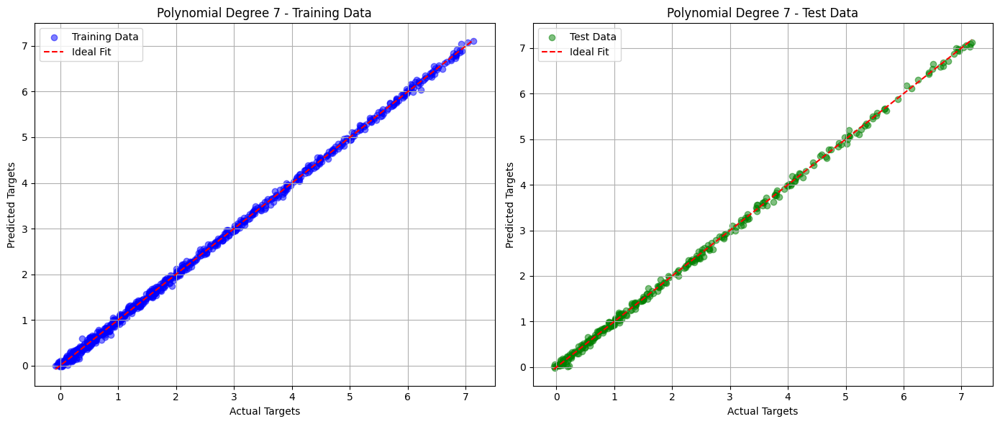

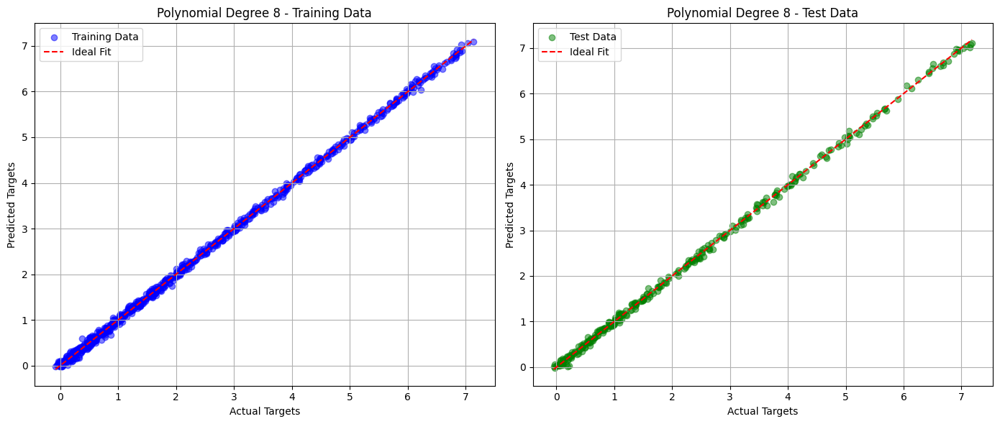

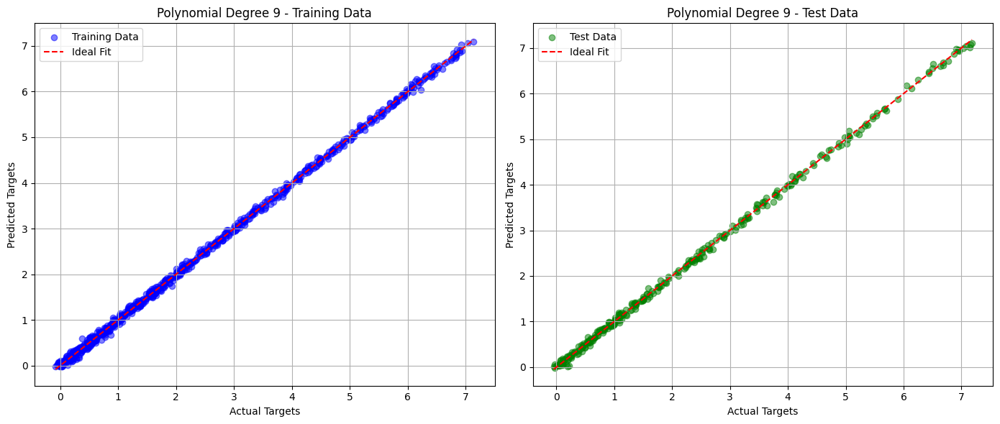

In [26]:
# Define the range of polynomial degrees
degrees_plot = list(range(2, 10))  # Degrees 2 to 9

# Initialize a figure for each degree
for degree in degrees_plot:
    # Expand features for training and test sets
    X_train_poly_temp = polynomial_features(X_train, degree)
    X_test_poly_temp = polynomial_features(X_test, degree)
    
    # Train Ridge Regression with the best lambda
    weights_temp = ridge_regression(X_train_poly_temp, y_train, best_lambda)
    
    # Predict on training and test sets
    y_train_pred_temp = X_train_poly_temp @ weights_temp
    y_test_pred_temp = X_test_poly_temp @ weights_temp
    
    # Plot Actual vs Predicted for Training Data
    plt.figure(figsize=(14, 6))
    
    plt.subplot(1, 2, 1)
    plt.scatter(y_train, y_train_pred_temp, color='blue', alpha=0.5, label='Training Data')
    plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'r--', label='Ideal Fit')
    plt.title(f'Polynomial Degree {degree} - Training Data')
    plt.xlabel('Actual Targets')
    plt.ylabel('Predicted Targets')
    plt.legend()
    plt.grid(True)
    
    # Plot Actual vs Predicted for Test Data
    plt.subplot(1, 2, 2)
    plt.scatter(y_test, y_test_pred_temp, color='green', alpha=0.5, label='Test Data')
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', label='Ideal Fit')
    plt.title(f'Polynomial Degree {degree} - Test Data')
    plt.xlabel('Actual Targets')
    plt.ylabel('Predicted Targets')
    plt.legend()
    plt.grid(True)
    
    plt.tight_layout()
    plt.show()


In [27]:

def plot_approximated_functions(
    ax,  # Axes object to plot on
    X_train_subset, 
    y_train_subset, 
    degree, 
    lambda_regs, 
    subset_size, 
    X_plot, 
    y_test, 
    color_test='green'
):
    
    """
    Plot the training data subset and the fitted polynomial regression curves before and after regularization.
    
    Parameters:
    - ax: Matplotlib Axes object to plot on.
    - X_train_subset: Training feature subset (N, 1).
    - y_train_subset: Training target subset (N,).
    - degree: Polynomial degree.
    - lambda_regs: List of lambda values for regularization (e.g., [0.0, 0.1]).
    - subset_size: Size of the training subset.
    - X_plot: Range of X values for plotting the regression curve.
    - y_test: Test target values for reference.
    - color_test: Color for the test data points.
    """

    # Scatter plot of the training subset
    ax.scatter(X_train_subset, y_train_subset, color='blue', label=f'Training Data (n={subset_size})', alpha=0.6)
    
    # Scatter plot of the test data for reference
    ax.scatter(X_test, y_test, color=color_test, label='Test Data', alpha=0.3)
    
    # Iterate over each lambda value
    for lambda_reg in lambda_regs:
        # Expand features for training subset
        X_train_poly_subset = polynomial_features(X_train_subset, degree)
        
        # Train Ridge Regression model
        weights = ridge_regression(X_train_poly_subset, y_train_subset, lambda_reg)
        
        # Expand features for plotting
        X_plot_poly = polynomial_features(X_plot, degree)
        y_plot = X_plot_poly @ weights
        
        # Determine line style based on regularization
        if lambda_reg == 0.0:
            label = f'Lambda {lambda_reg} (Non-Regularized)'
            ax.plot(X_plot, y_plot, color='red', label=label, linewidth=2)
        else:
            label = f'Lambda {lambda_reg} (Regularized)'
            ax.plot(X_plot, y_plot, label=label, linestyle='--')
    
    ax.set_title(f'Degree {degree} | Subset Size {subset_size}')
    ax.set_xlabel('Input Feature (X)')
    ax.set_ylabel('Target Variable (y)')
    ax.legend()
    ax.grid(True)


In [28]:
# Define the range of polynomial degrees
degrees = list(range(2, 10))  # Degrees 2 to 9

# Define the training subset sizes
subset_sizes = [10, 50, 100, X_train.shape[0]]  # 10, 50, 100, 700

# Define the regularization parameters for comparison
lambda_non_reg = 0.0
lambda_reg = 0.1  # You can adjust this value as needed

# Generate a dense range of X values for plotting regression curves
X_plot = np.linspace(X.min(), X.max(), 500).reshape(-1, 1)


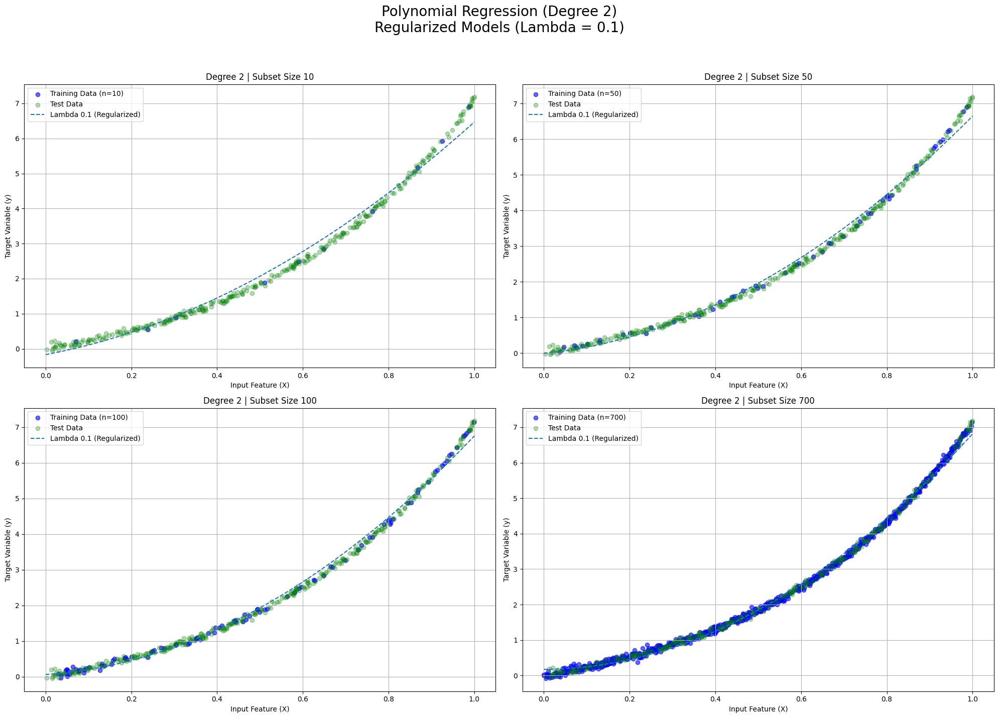

Displayed Regularized plots for Degree 2


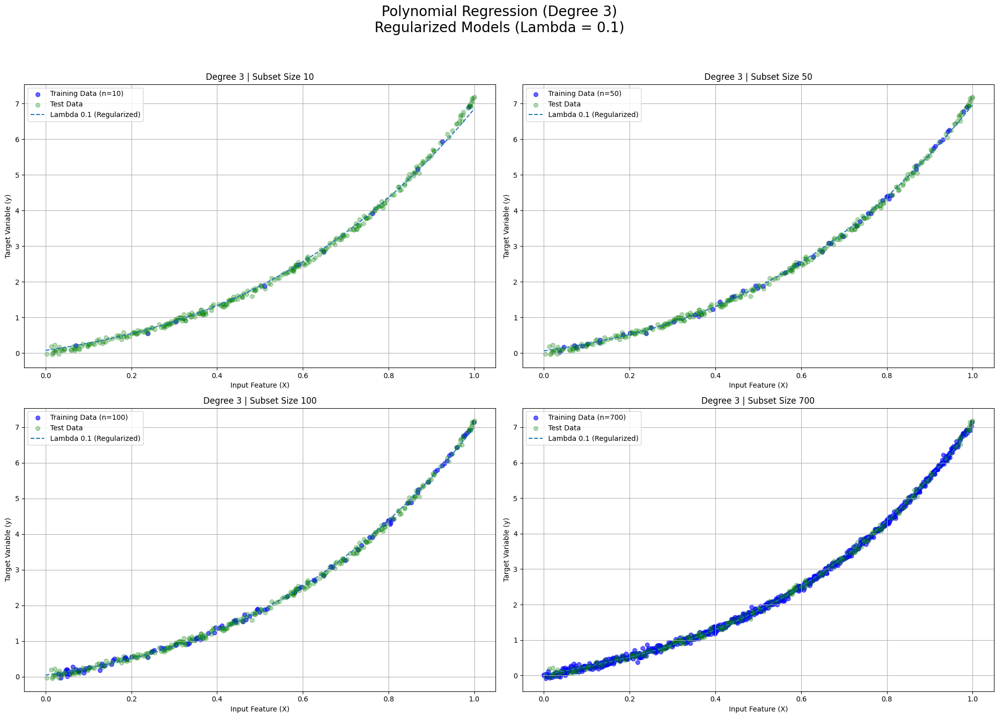

Displayed Regularized plots for Degree 3


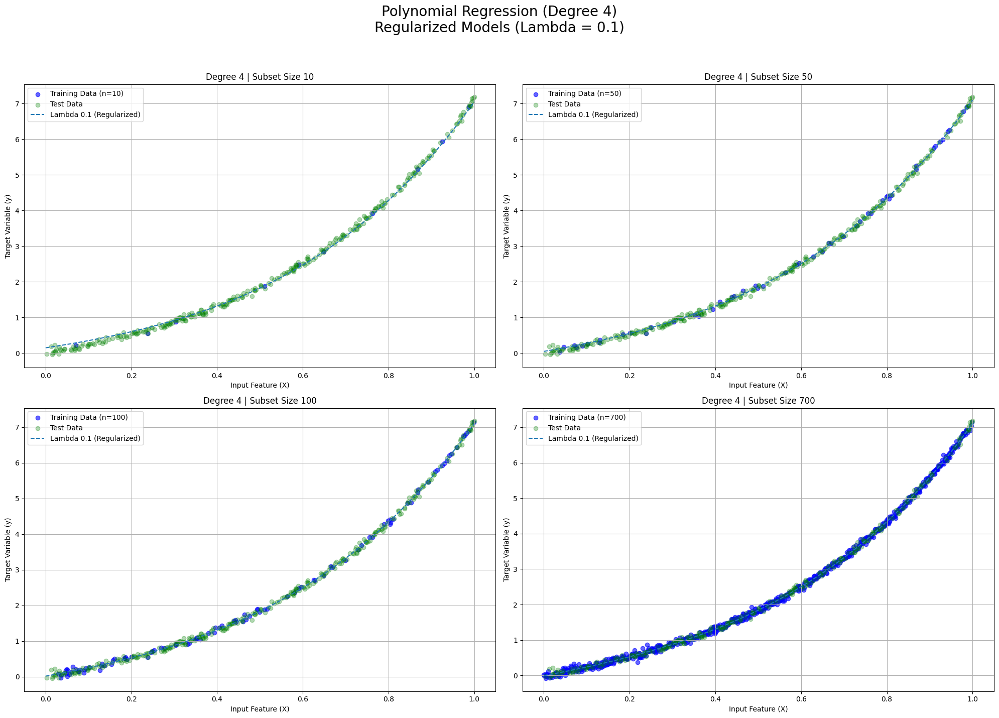

Displayed Regularized plots for Degree 4


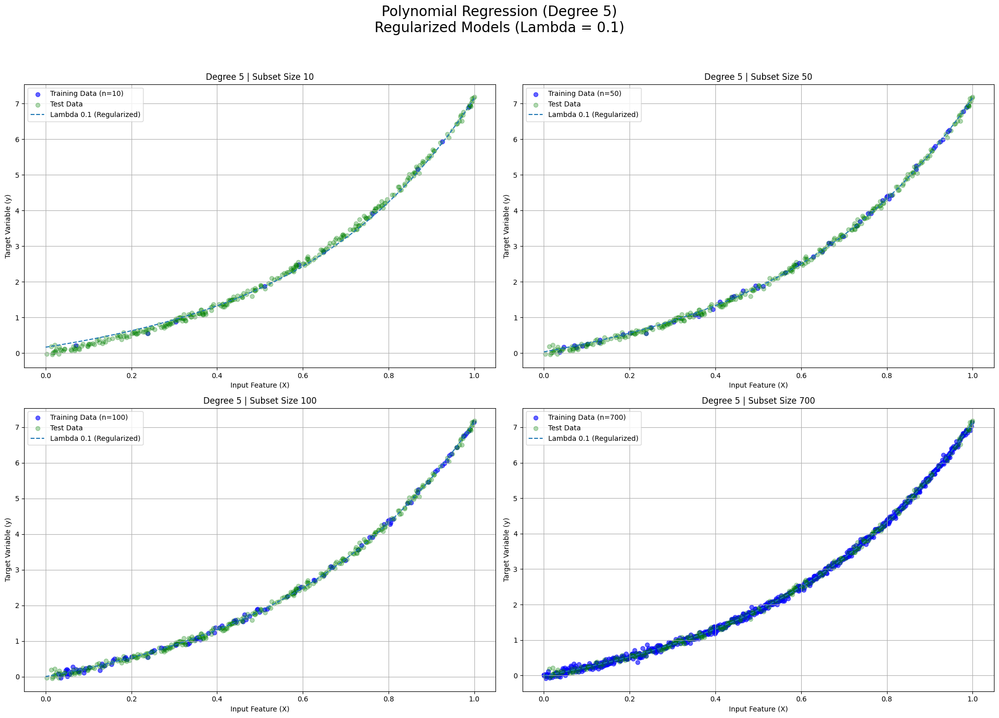

Displayed Regularized plots for Degree 5


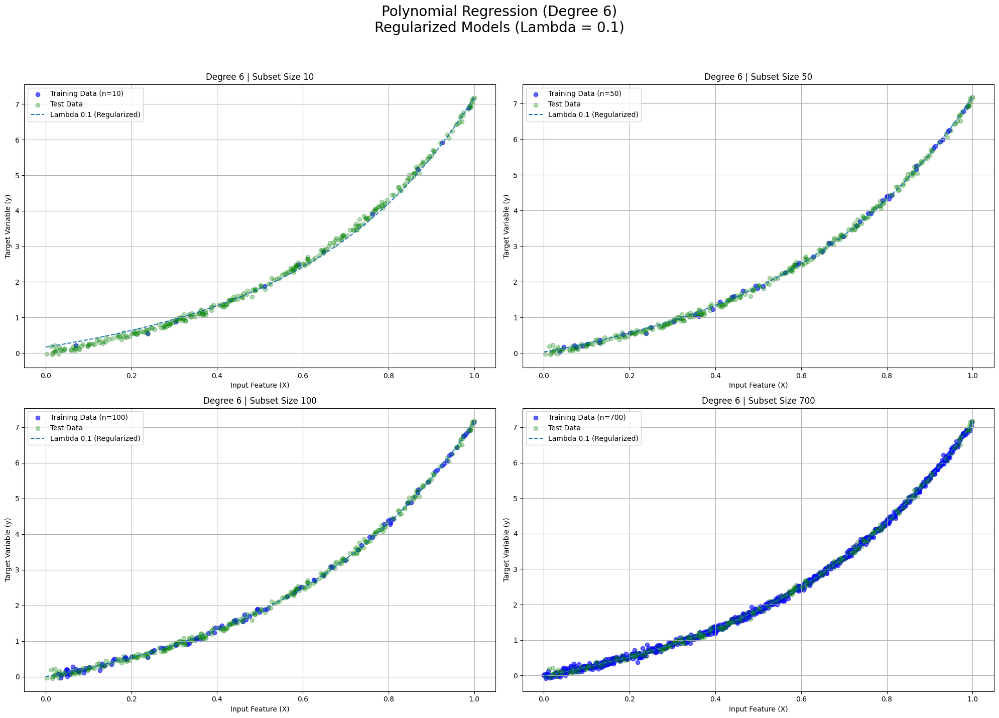

Displayed Regularized plots for Degree 6


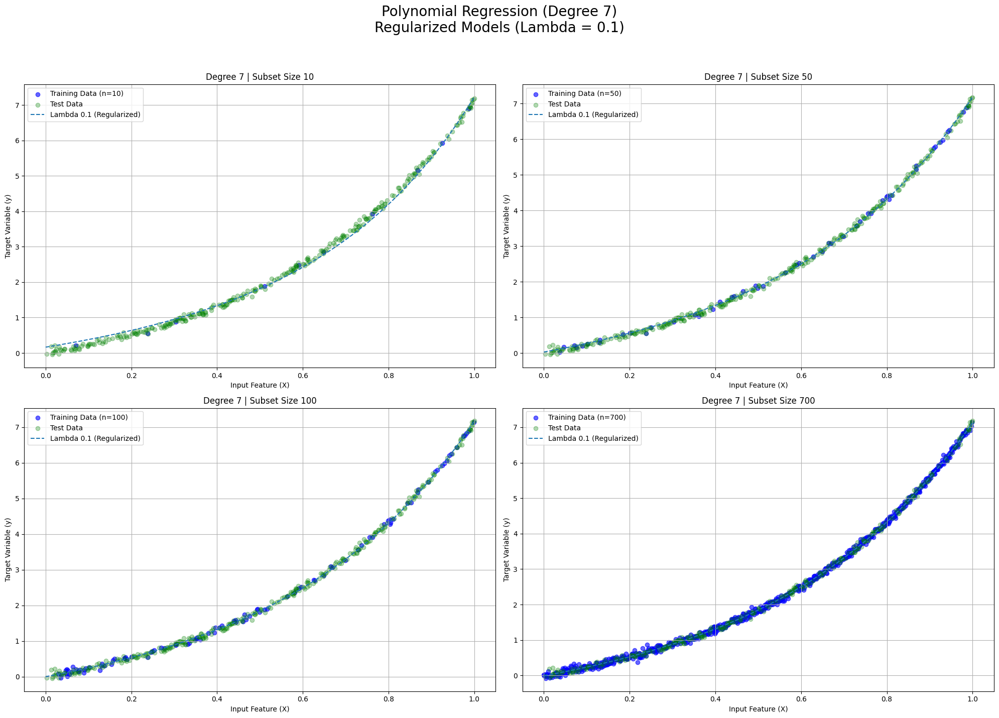

Displayed Regularized plots for Degree 7


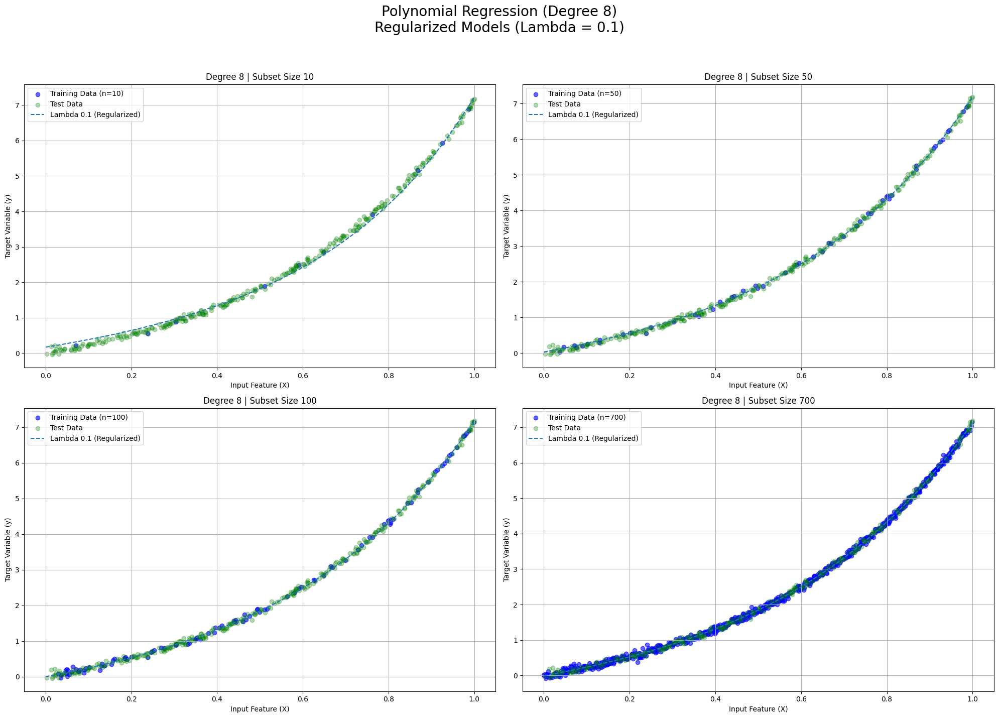

Displayed Regularized plots for Degree 8


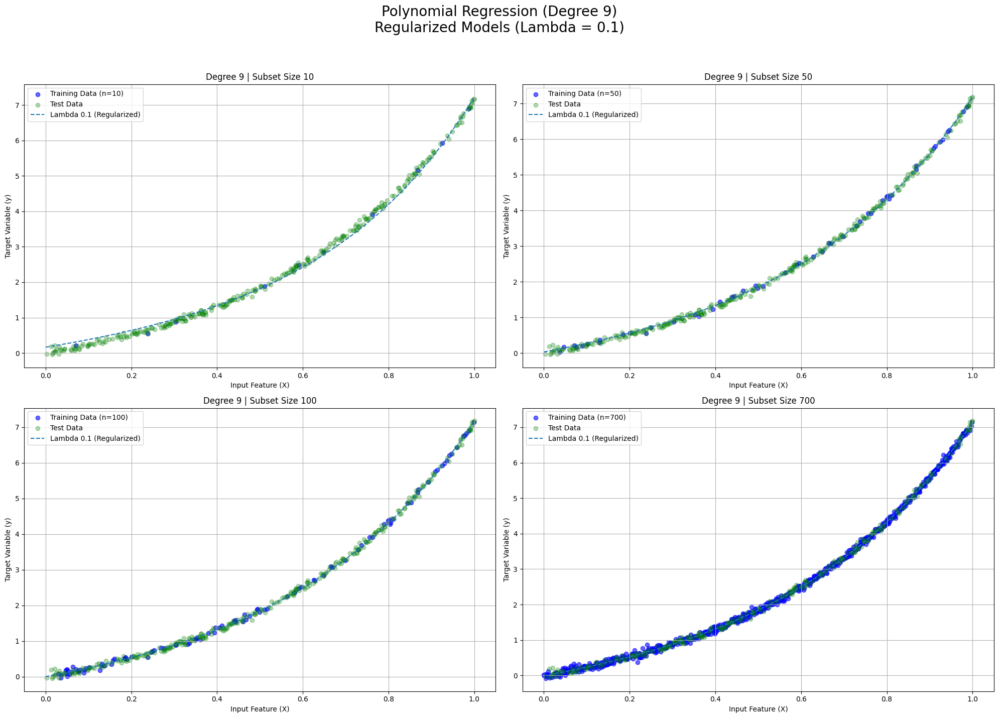

Displayed Regularized plots for Degree 9


In [29]:
# Iterate over each degree
for degree in degrees:
    # Create a figure with multiple subplots for different subset sizes
    fig, axes = plt.subplots(2, 2, figsize=(20, 15))
    fig.suptitle(f'Polynomial Regression (Degree {degree})\nRegularized Models (Lambda = {lambda_reg})', fontsize=20)
    
    # Flatten the axes array for easy iteration
    axes = axes.flatten()
    
    # Iterate over each subset size and corresponding subplot axis
    for idx, (subset_size, ax) in enumerate(zip(subset_sizes, axes)):
        # Select the first 'subset_size' samples from the training data
        X_train_subset = X_train[:subset_size]
        y_train_subset = y_train[:subset_size]
        
        # Plot the regularized model on the current subplot
        plot_approximated_functions(
            ax=ax,
            X_train_subset=X_train_subset,
            y_train_subset=y_train_subset,
            degree=degree,
            lambda_regs=[lambda_reg],  # Only regularized
            subset_size=subset_size,
            X_plot=X_plot,
            y_test=y_test,
            color_test='green'
        )
    
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout to accommodate the suptitle
    plt.show()
    print(f"Displayed Regularized plots for Degree {degree}")


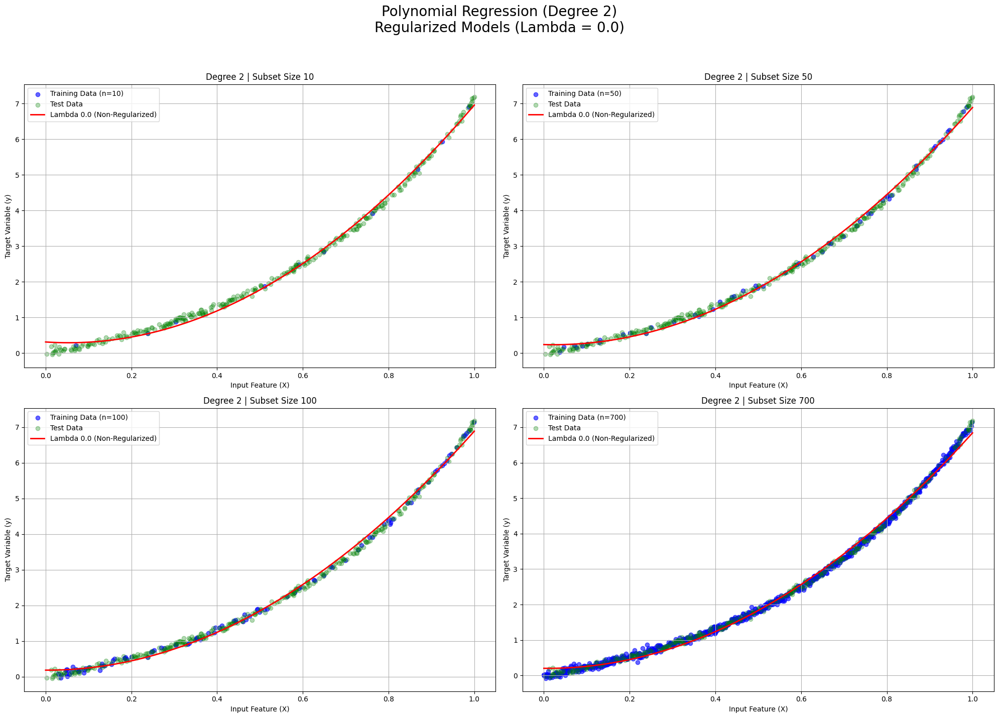

Displayed Regularized plots for Degree 2


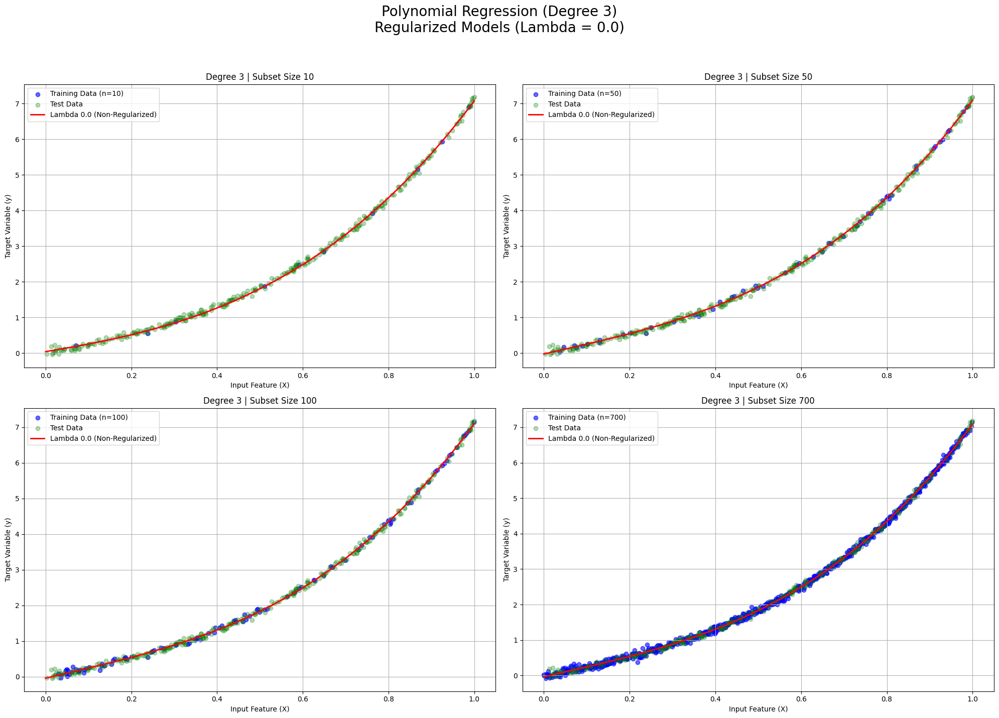

Displayed Regularized plots for Degree 3


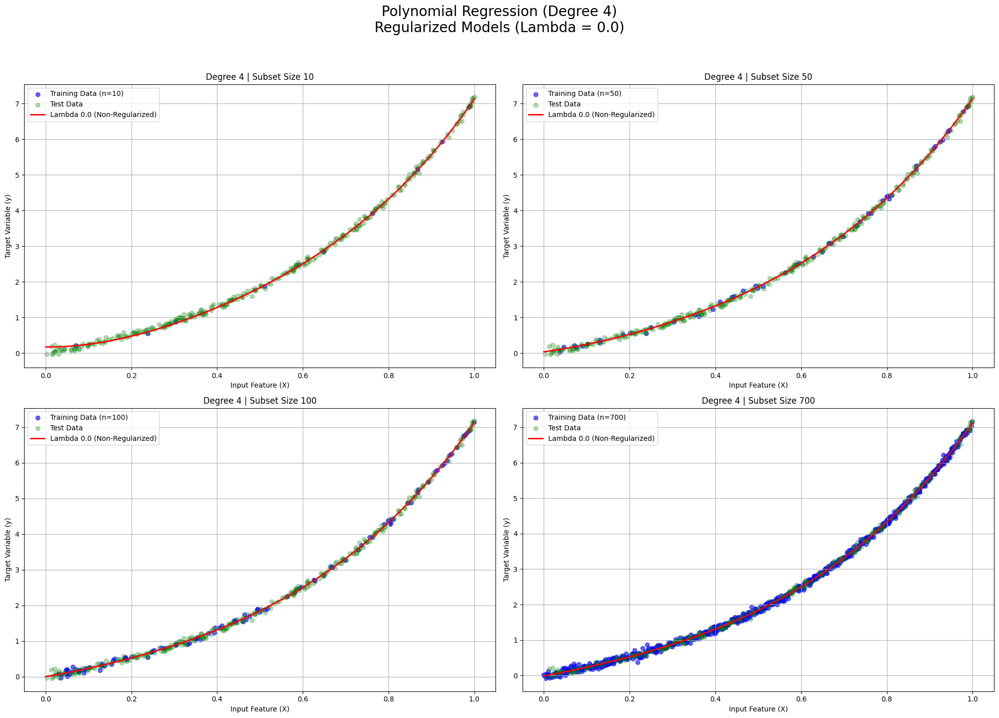

Displayed Regularized plots for Degree 4


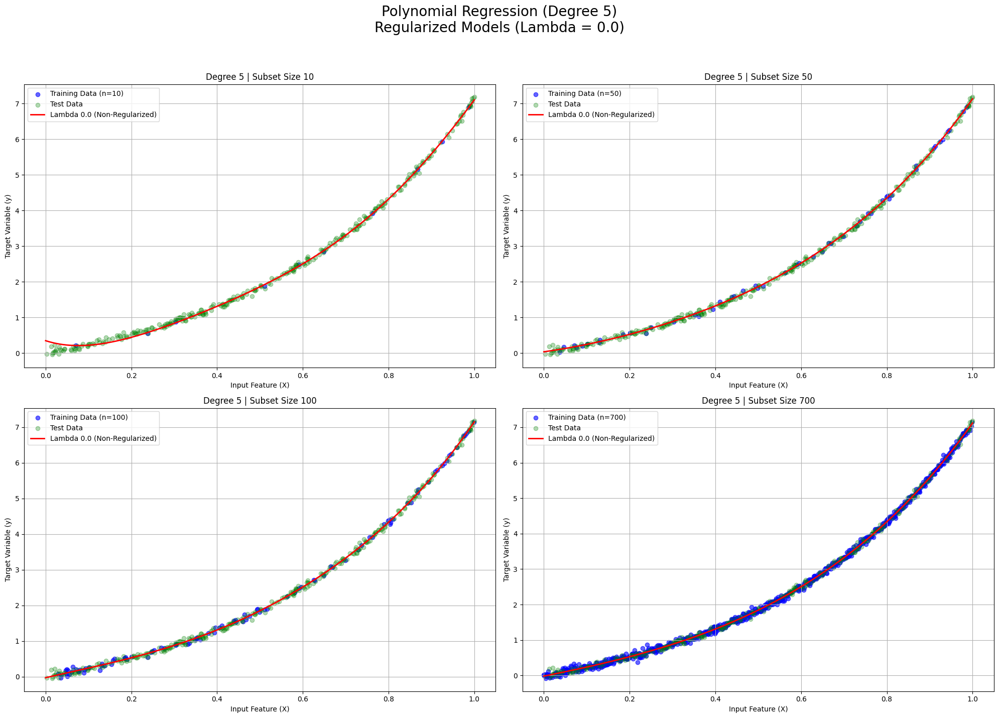

Displayed Regularized plots for Degree 5


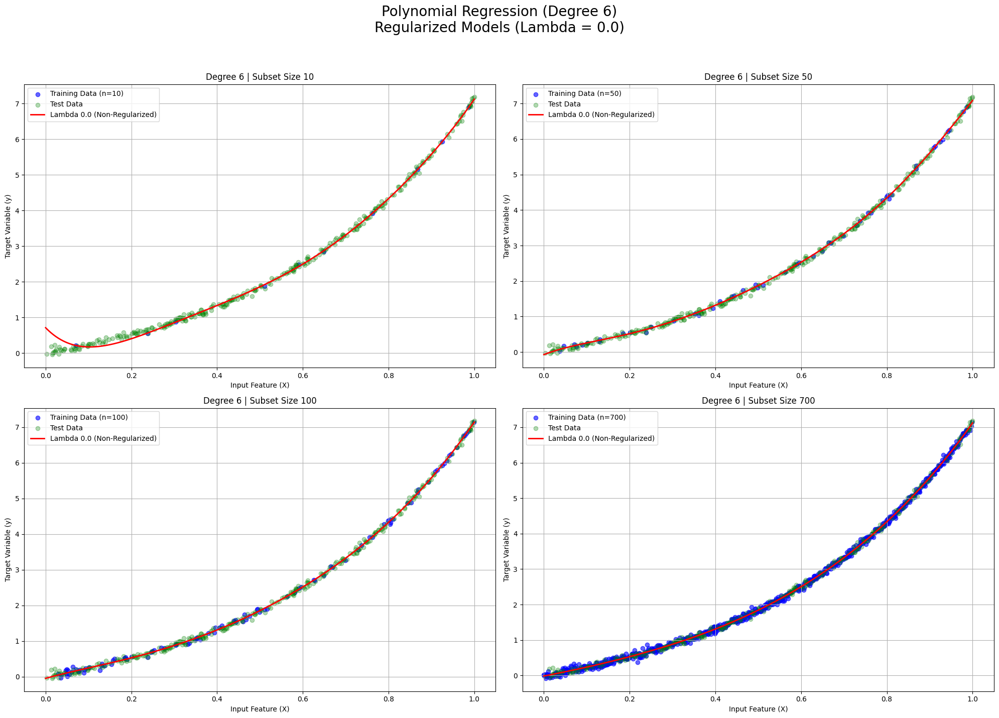

Displayed Regularized plots for Degree 6


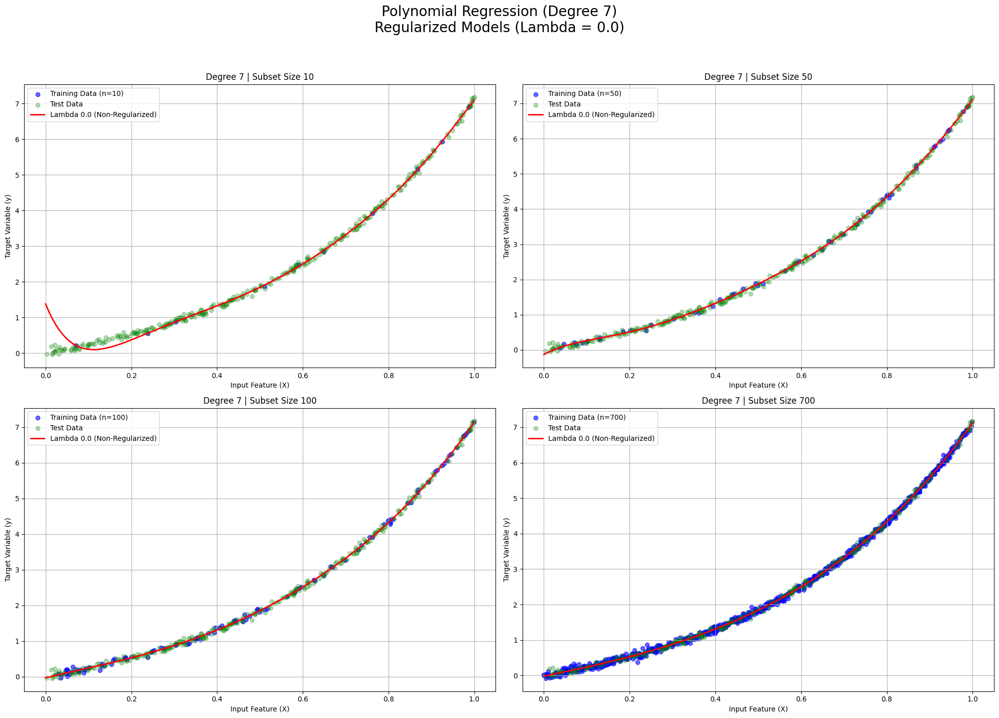

Displayed Regularized plots for Degree 7


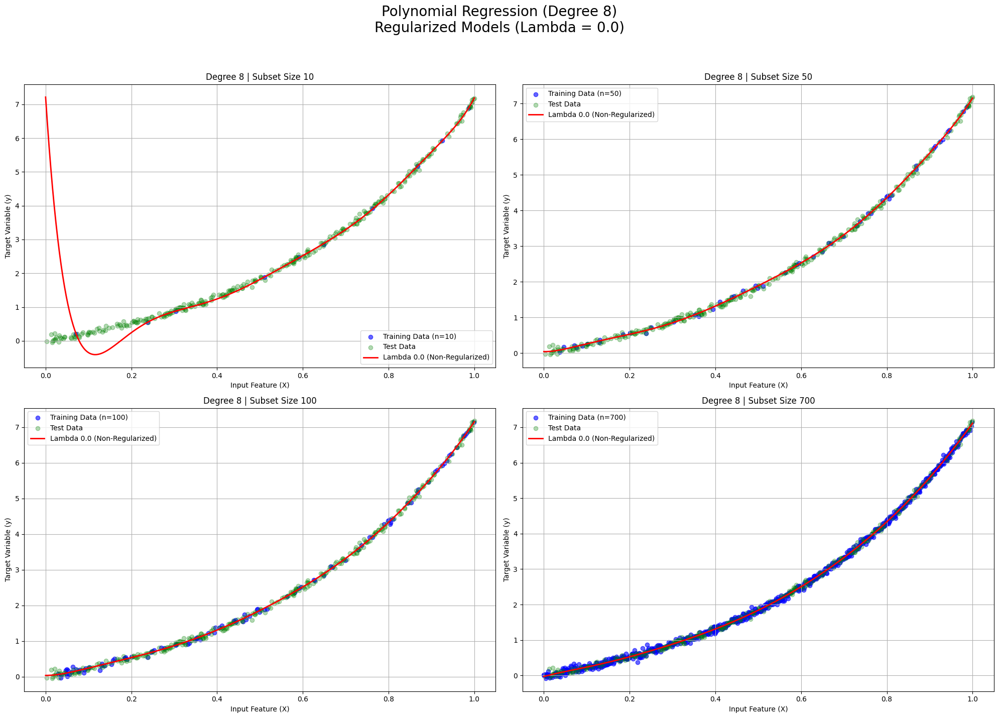

Displayed Regularized plots for Degree 8


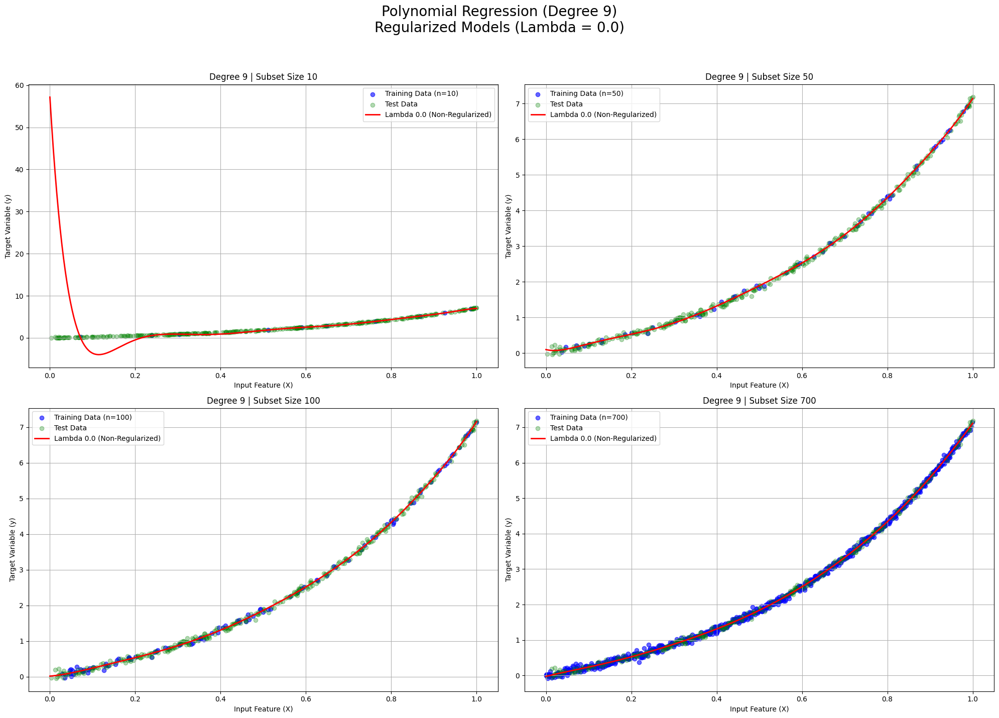

Displayed Regularized plots for Degree 9


In [30]:
lambda_reg01 = 0.0
# Iterate over each degree
for degree in degrees:
    # Create a figure with multiple subplots for different subset sizes
    fig, axes = plt.subplots(2, 2, figsize=(20, 15))
    fig.suptitle(f'Polynomial Regression (Degree {degree})\nRegularized Models (Lambda = {lambda_reg01})', fontsize=20)
    
    # Flatten the axes array for easy iteration
    axes = axes.flatten()
    
    # Iterate over each subset size and corresponding subplot axis
    for idx, (subset_size, ax) in enumerate(zip(subset_sizes, axes)):
        # Select the first 'subset_size' samples from the training data
        X_train_subset = X_train[:subset_size]
        y_train_subset = y_train[:subset_size]
        
        # Plot the regularized model on the current subplot
        plot_approximated_functions(
            ax=ax,
            X_train_subset=X_train_subset,
            y_train_subset=y_train_subset,
            degree=degree,
            lambda_regs=[lambda_reg01],  # Only regularized
            subset_size=subset_size,
            X_plot=X_plot,
            y_test=y_test,
            color_test='green'
        )
    
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout to accommodate the suptitle
    plt.show()
    print(f"Displayed Regularized plots for Degree {degree}")


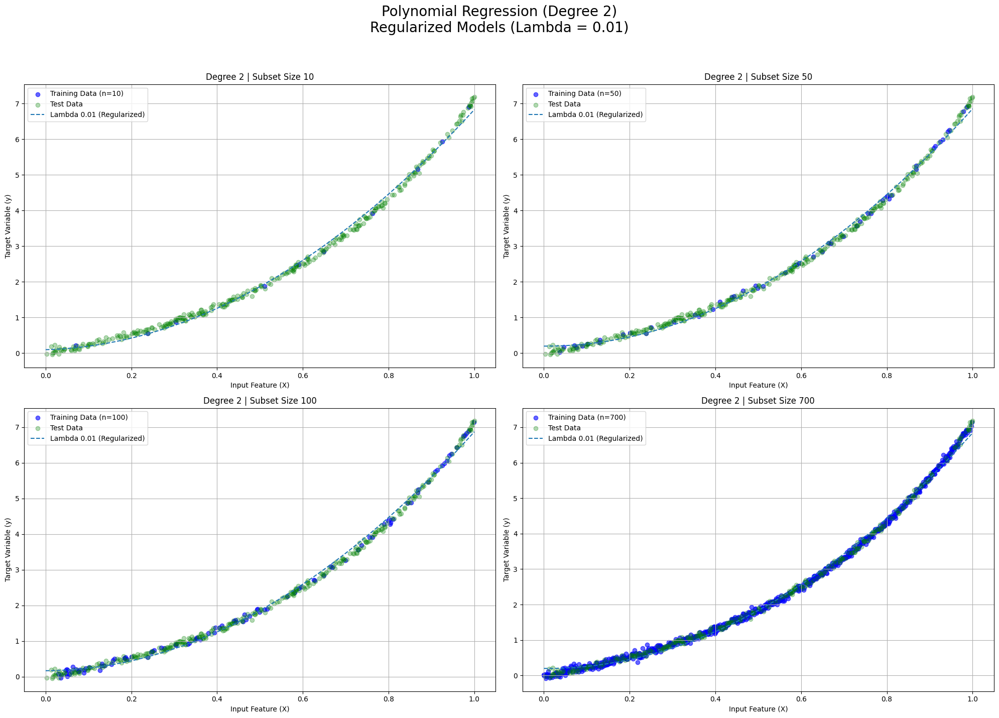

Displayed Regularized plots for Degree 2


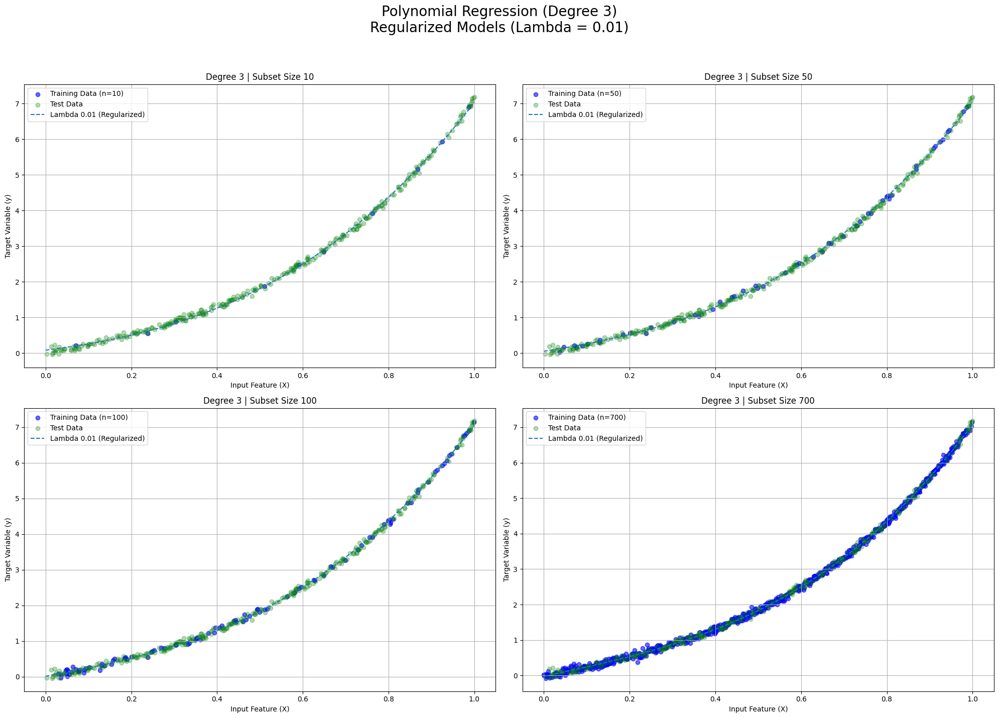

Displayed Regularized plots for Degree 3


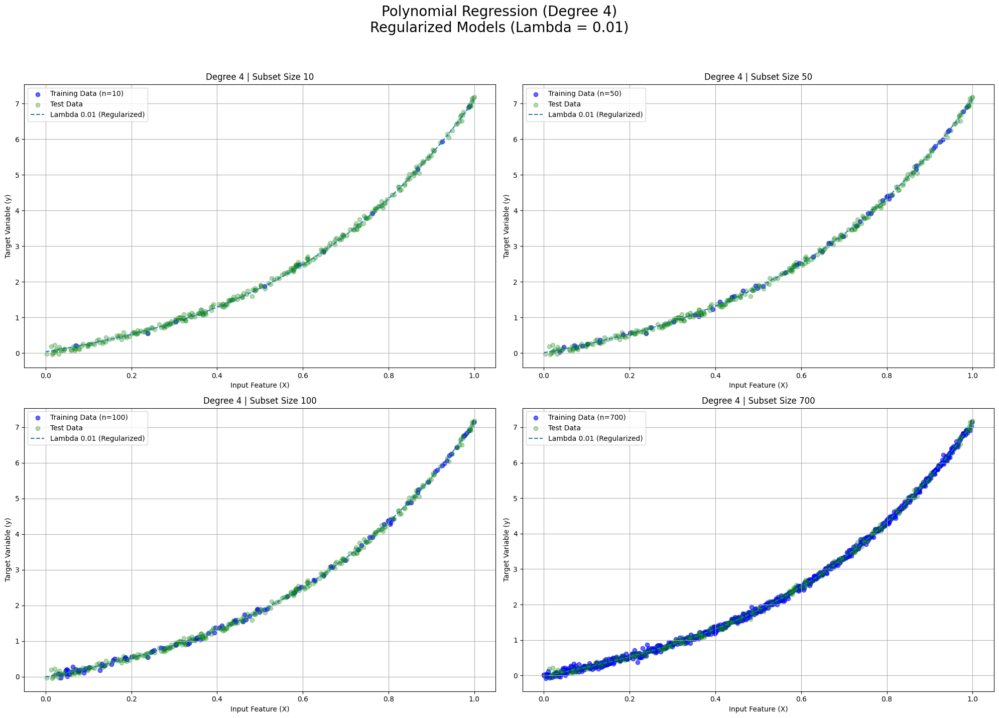

Displayed Regularized plots for Degree 4


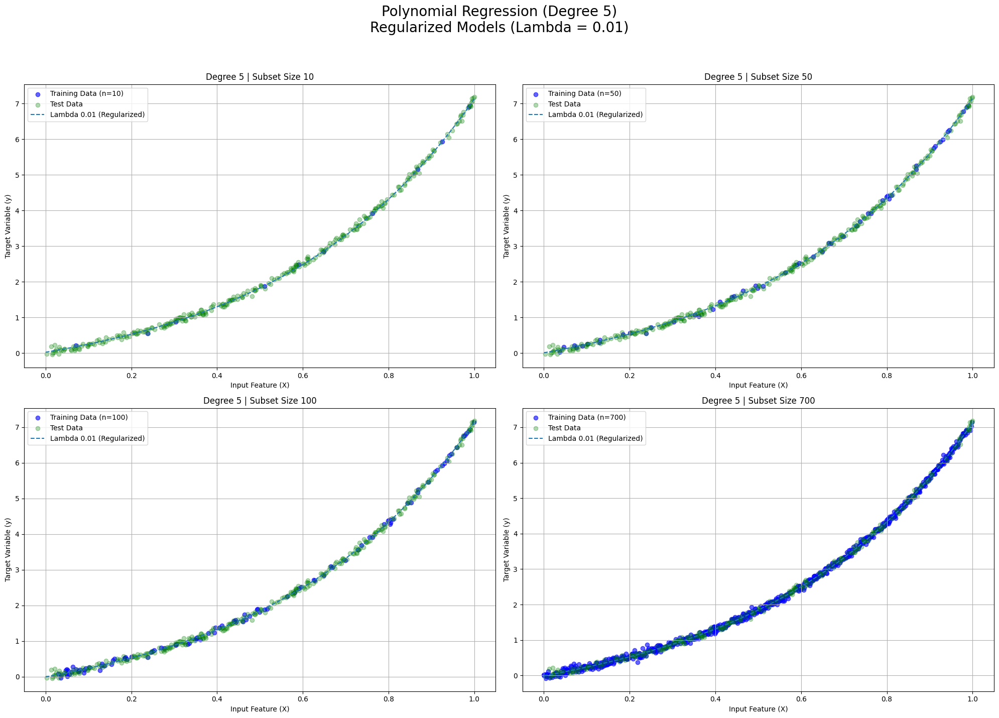

Displayed Regularized plots for Degree 5


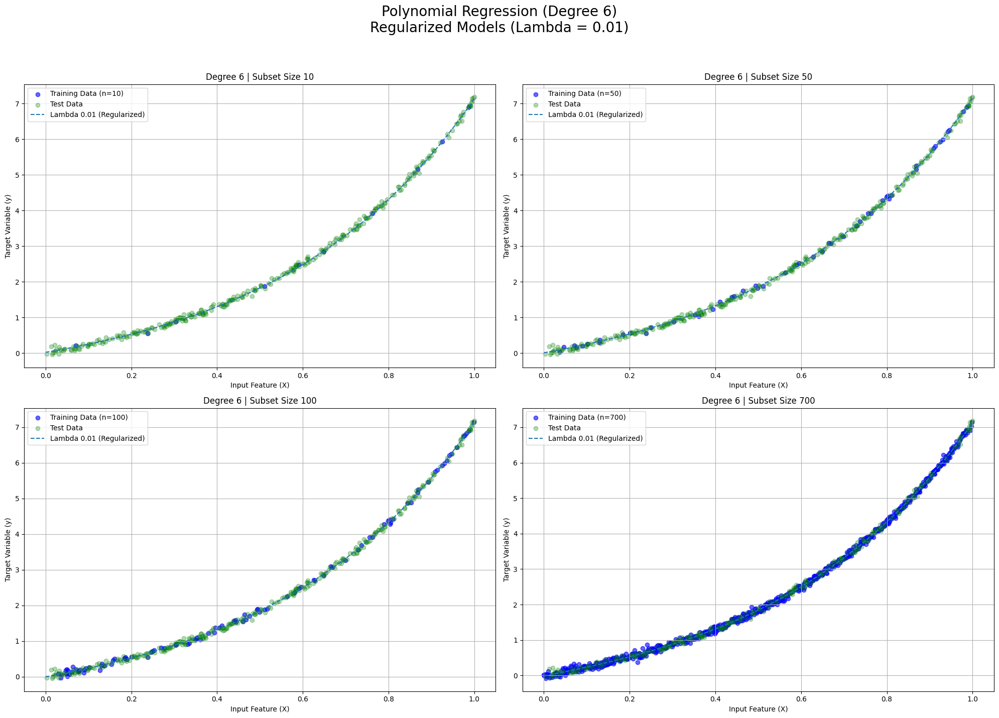

Displayed Regularized plots for Degree 6


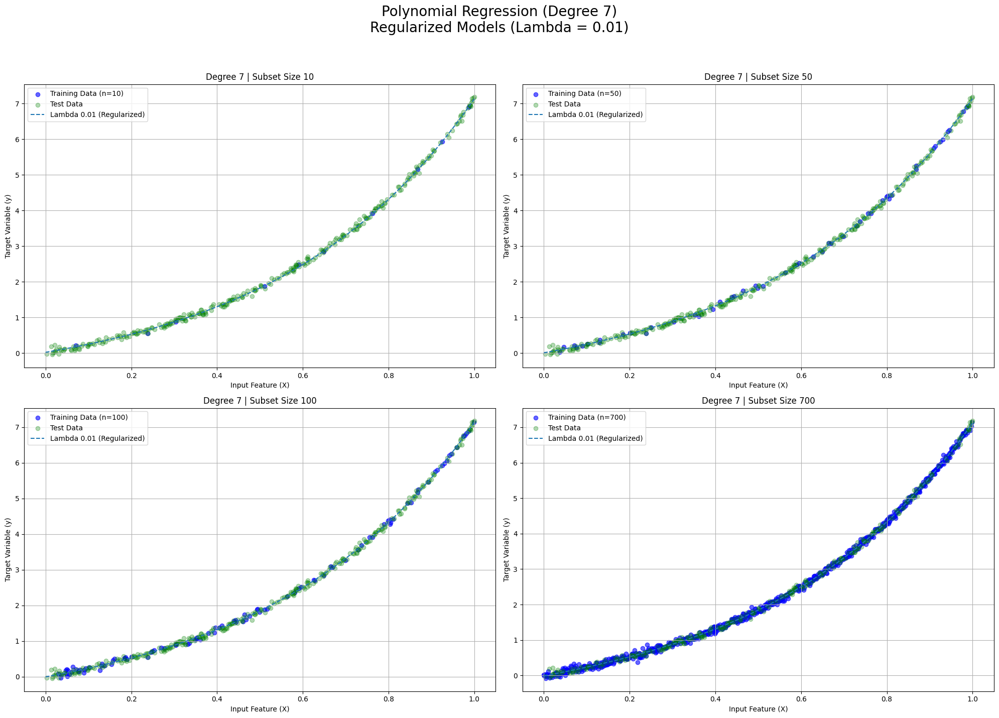

Displayed Regularized plots for Degree 7


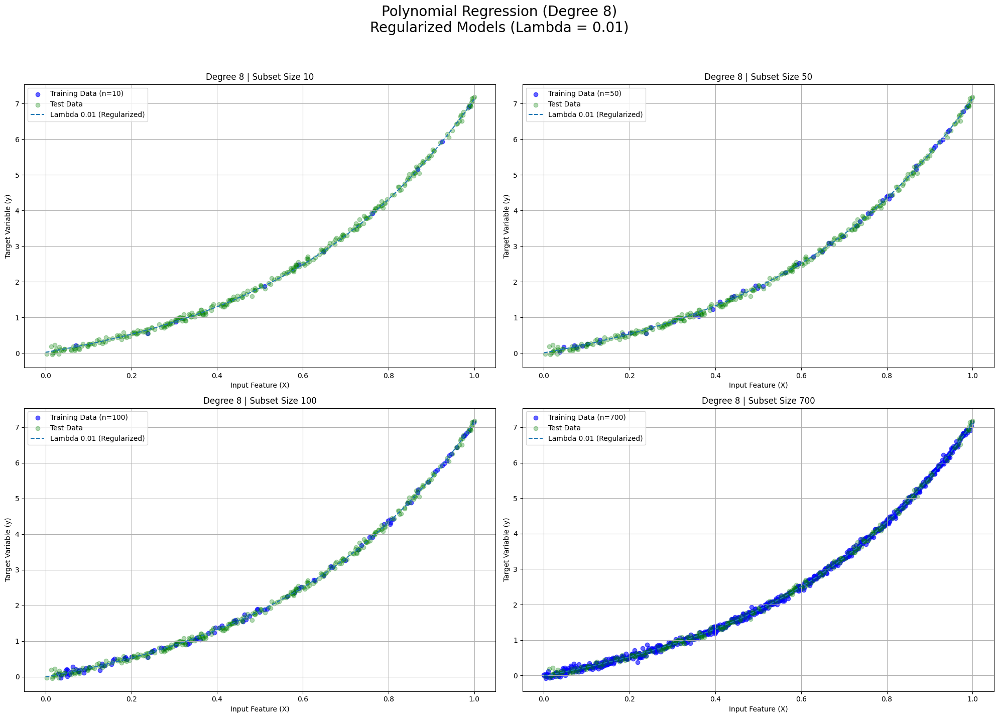

Displayed Regularized plots for Degree 8


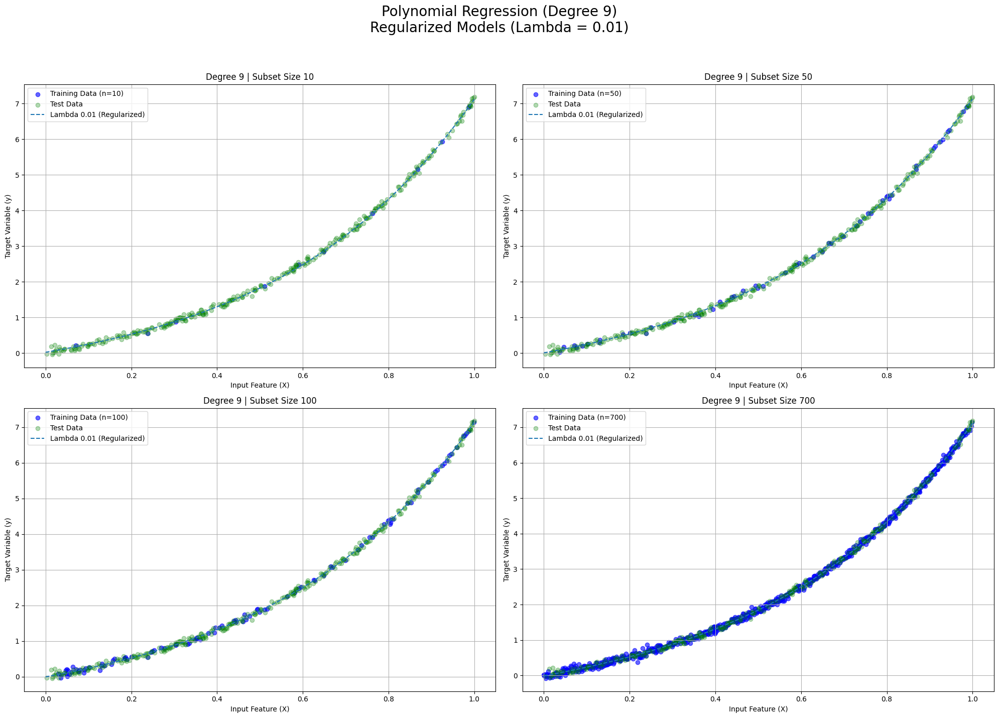

Displayed Regularized plots for Degree 9


In [31]:
lambda_reg01 = 0.01
# Iterate over each degree
for degree in degrees:
    # Create a figure with multiple subplots for different subset sizes
    fig, axes = plt.subplots(2, 2, figsize=(20, 15))
    fig.suptitle(f'Polynomial Regression (Degree {degree})\nRegularized Models (Lambda = {lambda_reg01})', fontsize=20)
    
    # Flatten the axes array for easy iteration
    axes = axes.flatten()
    
    # Iterate over each subset size and corresponding subplot axis
    for idx, (subset_size, ax) in enumerate(zip(subset_sizes, axes)):
        # Select the first 'subset_size' samples from the training data
        X_train_subset = X_train[:subset_size]
        y_train_subset = y_train[:subset_size]
        
        # Plot the regularized model on the current subplot
        plot_approximated_functions(
            ax=ax,
            X_train_subset=X_train_subset,
            y_train_subset=y_train_subset,
            degree=degree,
            lambda_regs=[lambda_reg01],  # Only regularized
            subset_size=subset_size,
            X_plot=X_plot,
            y_test=y_test,
            color_test='green'
        )
    
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout to accommodate the suptitle
    plt.show()
    print(f"Displayed Regularized plots for Degree {degree}")


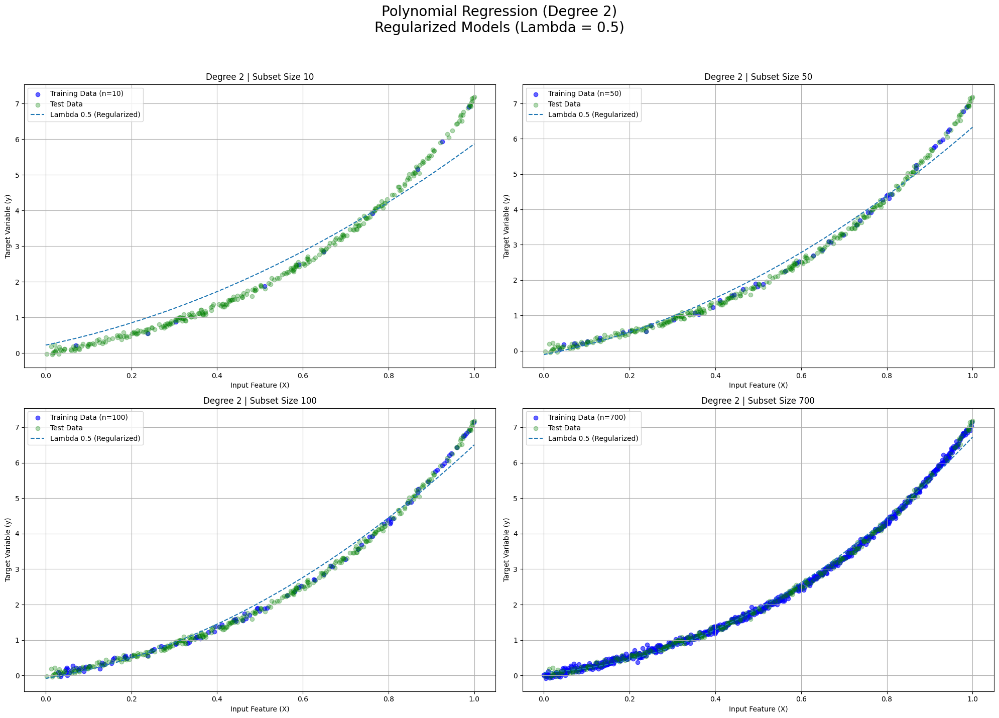

Displayed Regularized plots for Degree 2


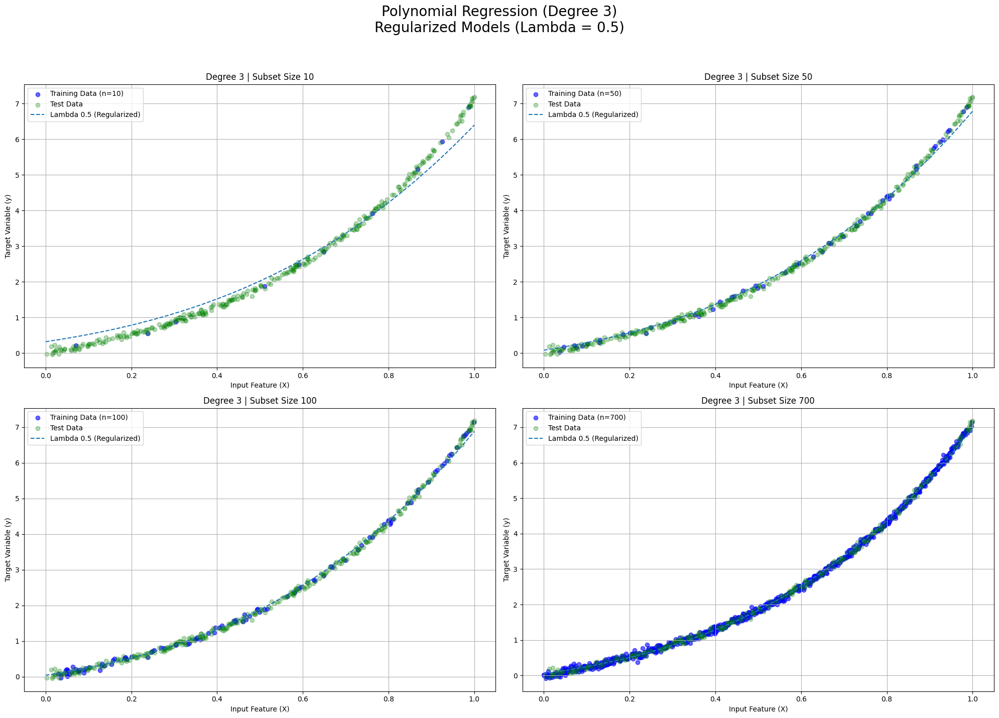

Displayed Regularized plots for Degree 3


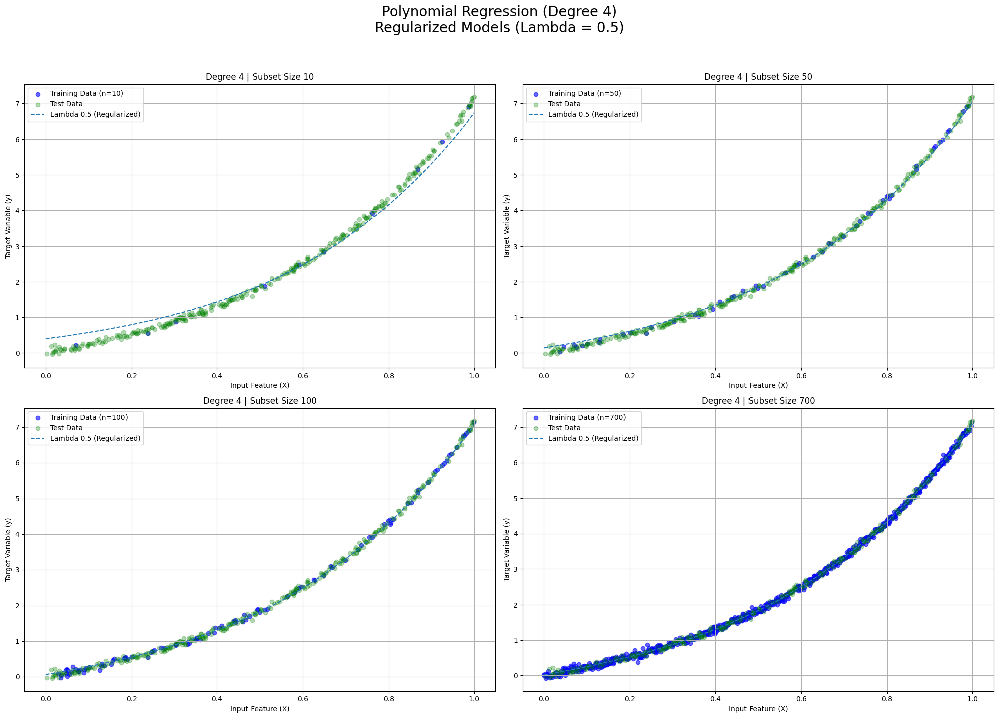

Displayed Regularized plots for Degree 4


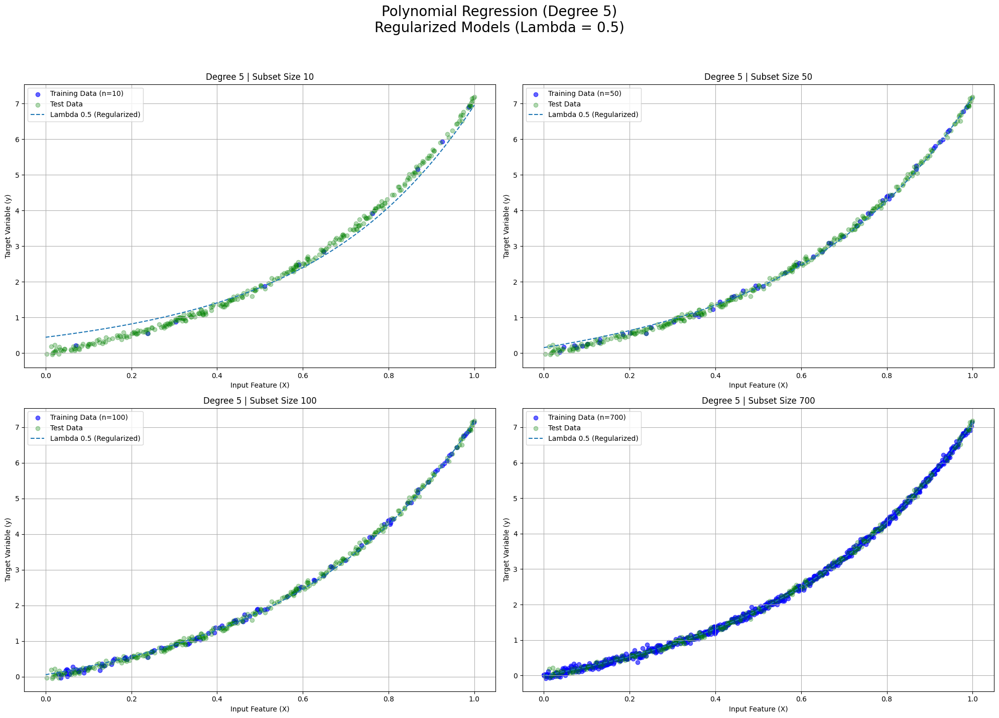

Displayed Regularized plots for Degree 5


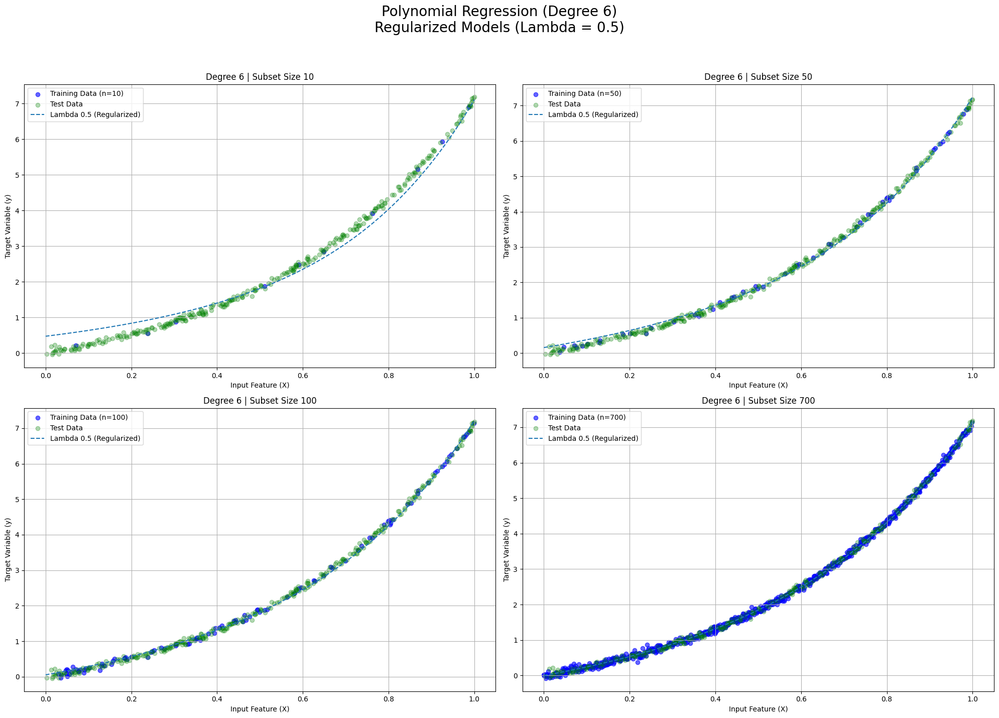

Displayed Regularized plots for Degree 6


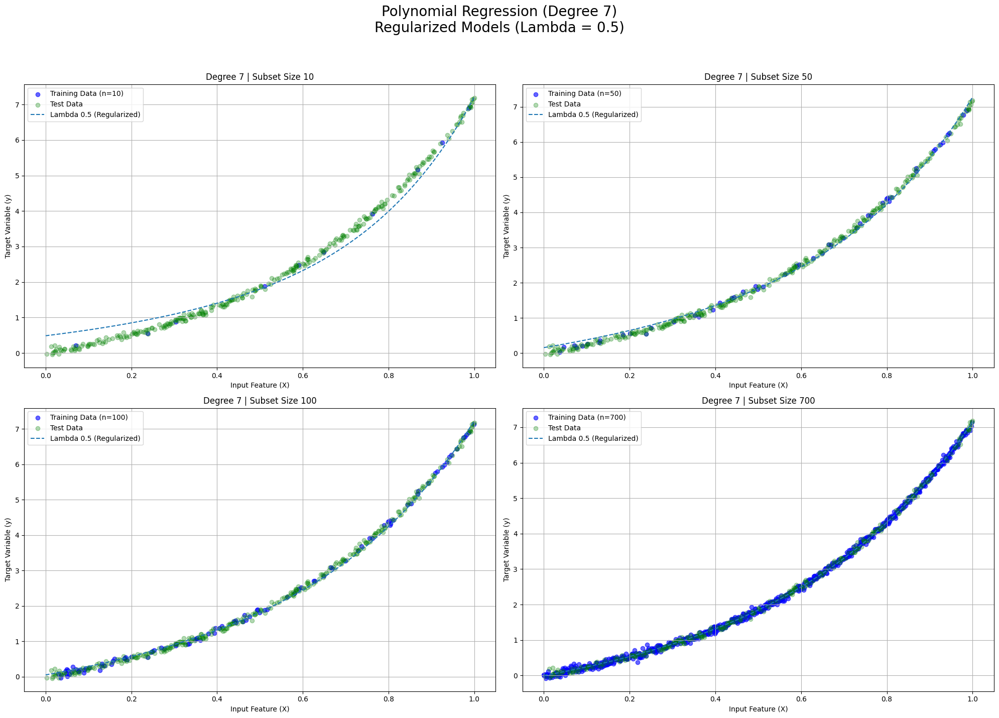

Displayed Regularized plots for Degree 7


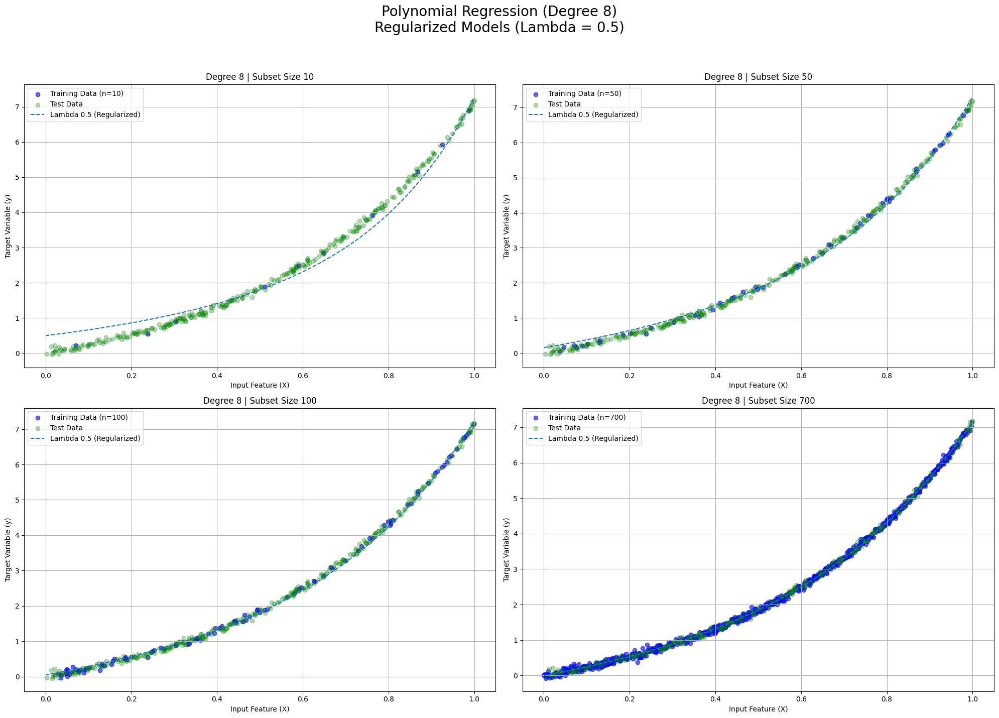

Displayed Regularized plots for Degree 8


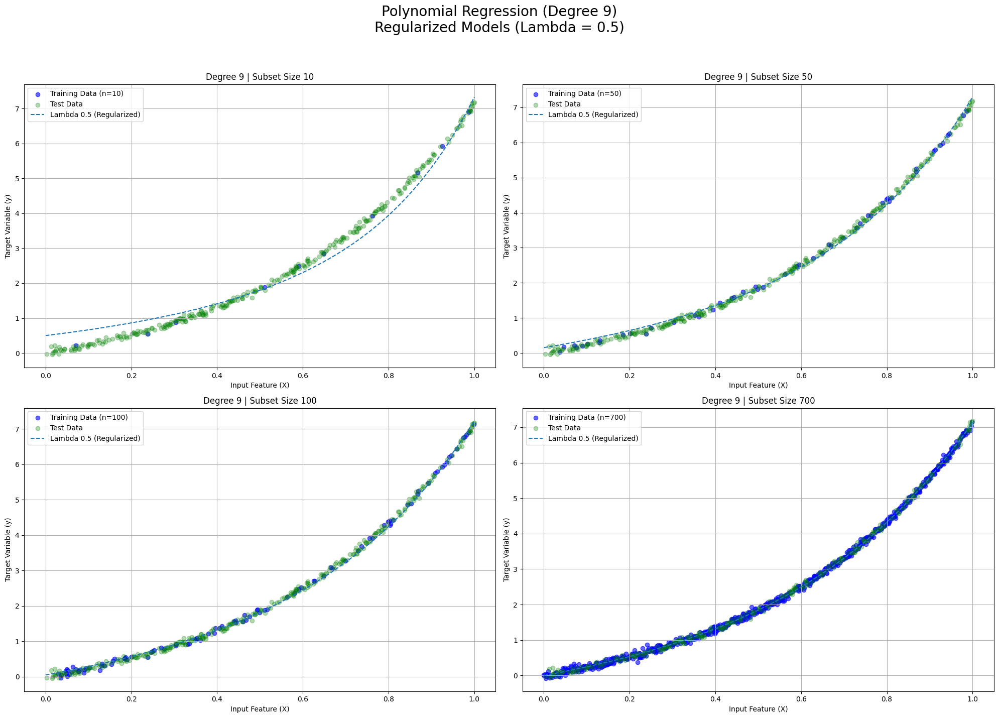

Displayed Regularized plots for Degree 9


In [32]:
lambda_reg1 = 0.5
# Iterate over each degree
for degree in degrees:
    # Create a figure with multiple subplots for different subset sizes
    fig, axes = plt.subplots(2, 2, figsize=(20, 15))
    fig.suptitle(f'Polynomial Regression (Degree {degree})\nRegularized Models (Lambda = {lambda_reg1})', fontsize=20)
    
    # Flatten the axes array for easy iteration
    axes = axes.flatten()
    
    # Iterate over each subset size and corresponding subplot axis
    for idx, (subset_size, ax) in enumerate(zip(subset_sizes, axes)):
        # Select the first 'subset_size' samples from the training data
        X_train_subset = X_train[:subset_size]
        y_train_subset = y_train[:subset_size]
        
        # Plot the regularized model on the current subplot
        plot_approximated_functions(
            ax=ax,
            X_train_subset=X_train_subset,
            y_train_subset=y_train_subset,
            degree=degree,
            lambda_regs=[lambda_reg1],  # Only regularized
            subset_size=subset_size,
            X_plot=X_plot,
            y_test=y_test,
            color_test='green'
        )
    
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout to accommodate the suptitle
    plt.show()
    print(f"Displayed Regularized plots for Degree {degree}")


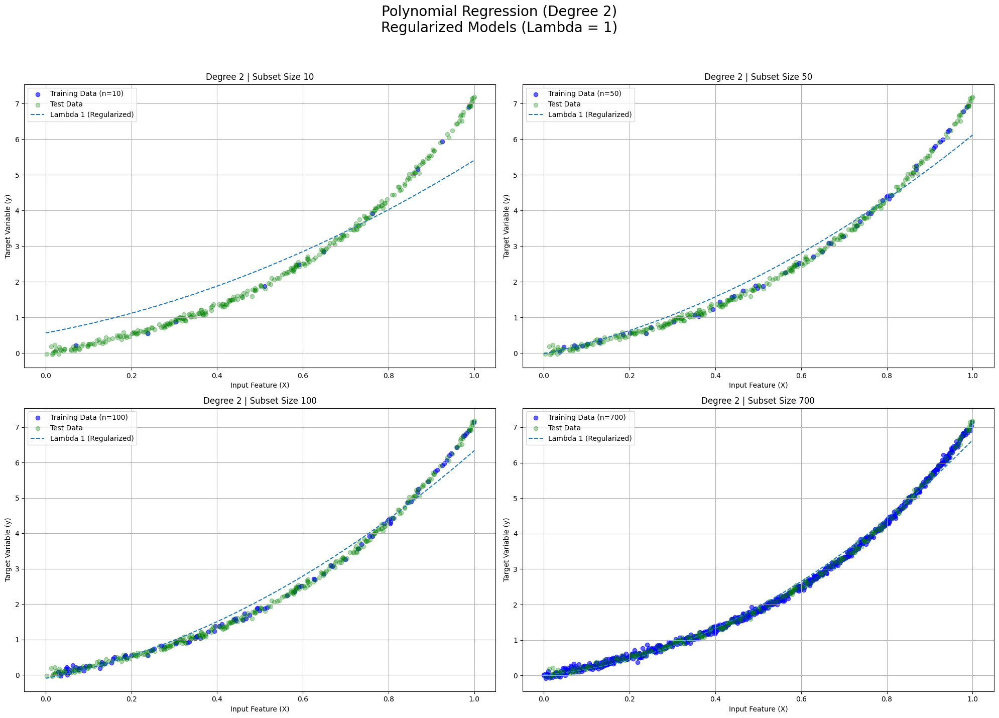

Displayed Regularized plots for Degree 2


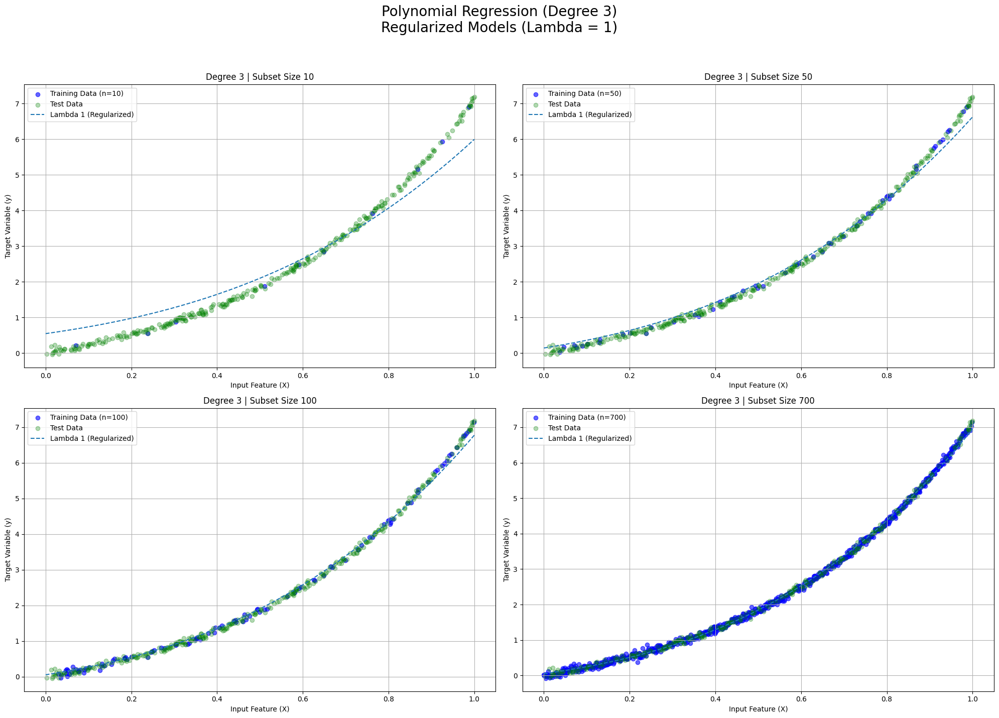

Displayed Regularized plots for Degree 3


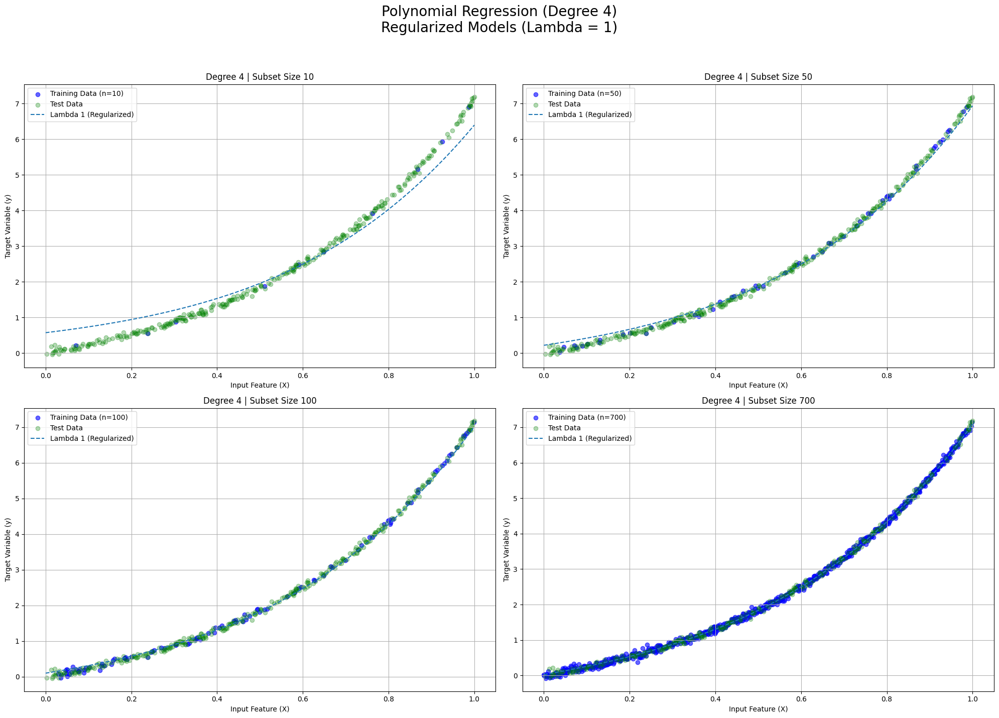

Displayed Regularized plots for Degree 4


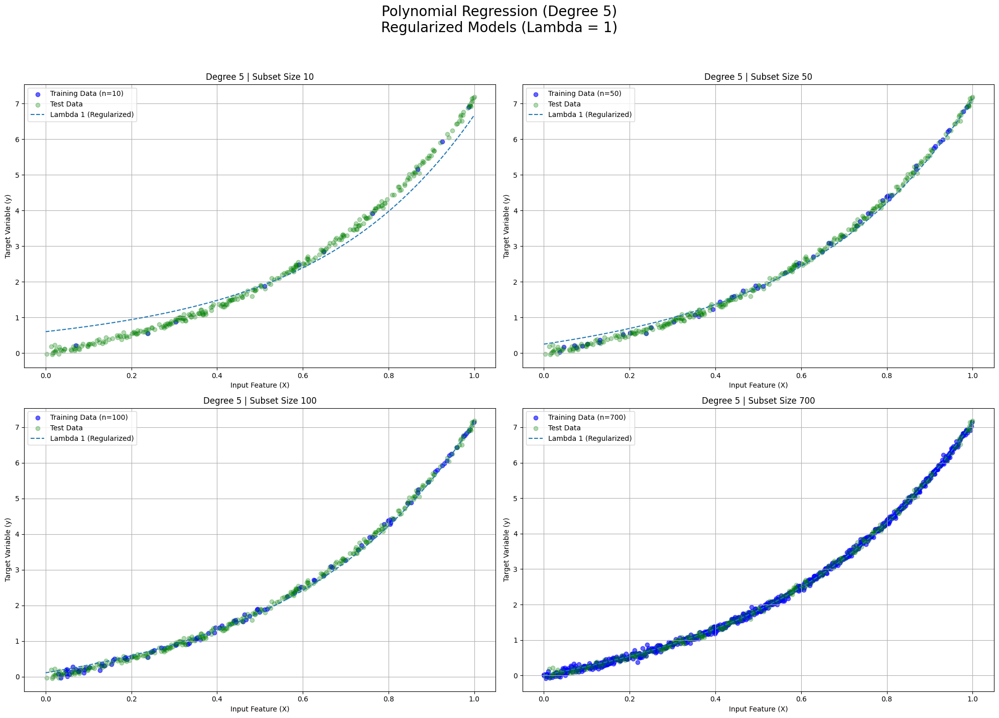

Displayed Regularized plots for Degree 5


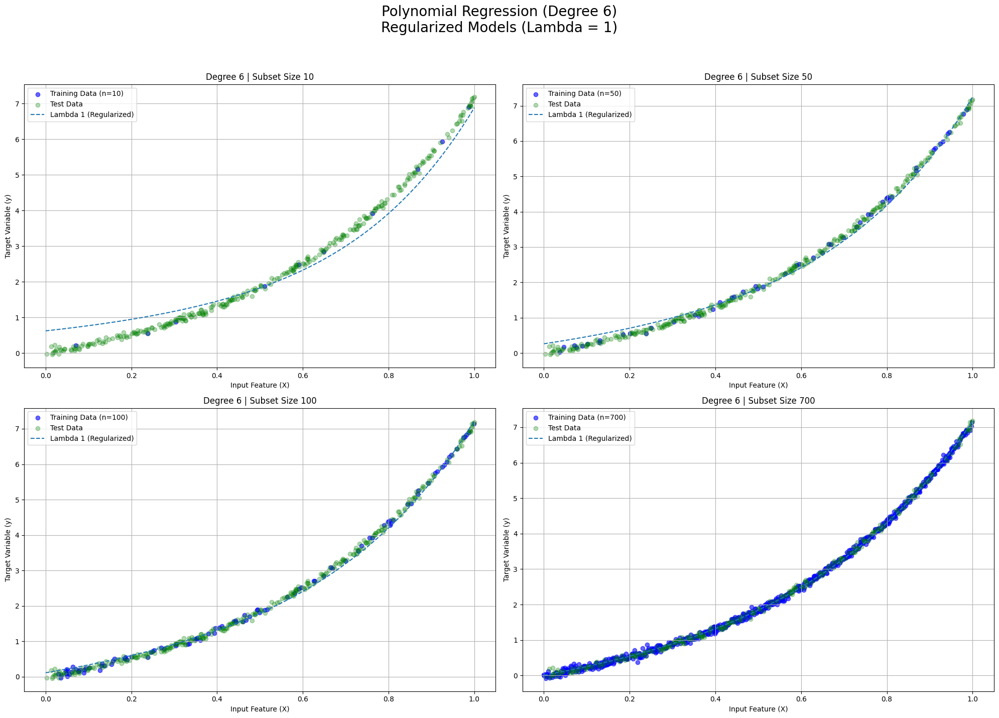

Displayed Regularized plots for Degree 6


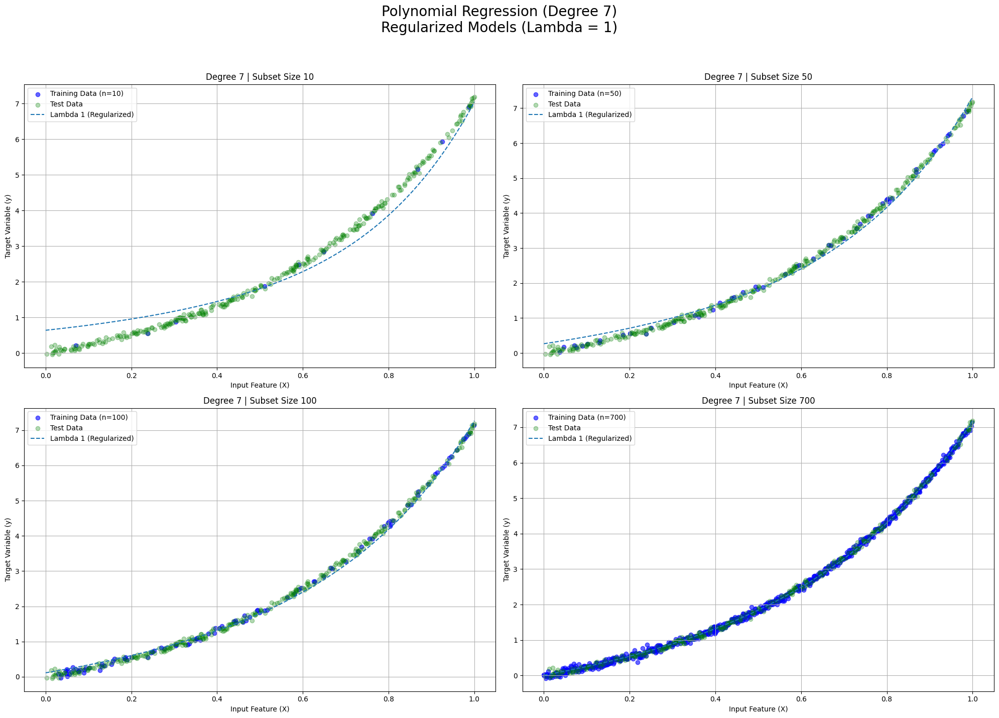

Displayed Regularized plots for Degree 7


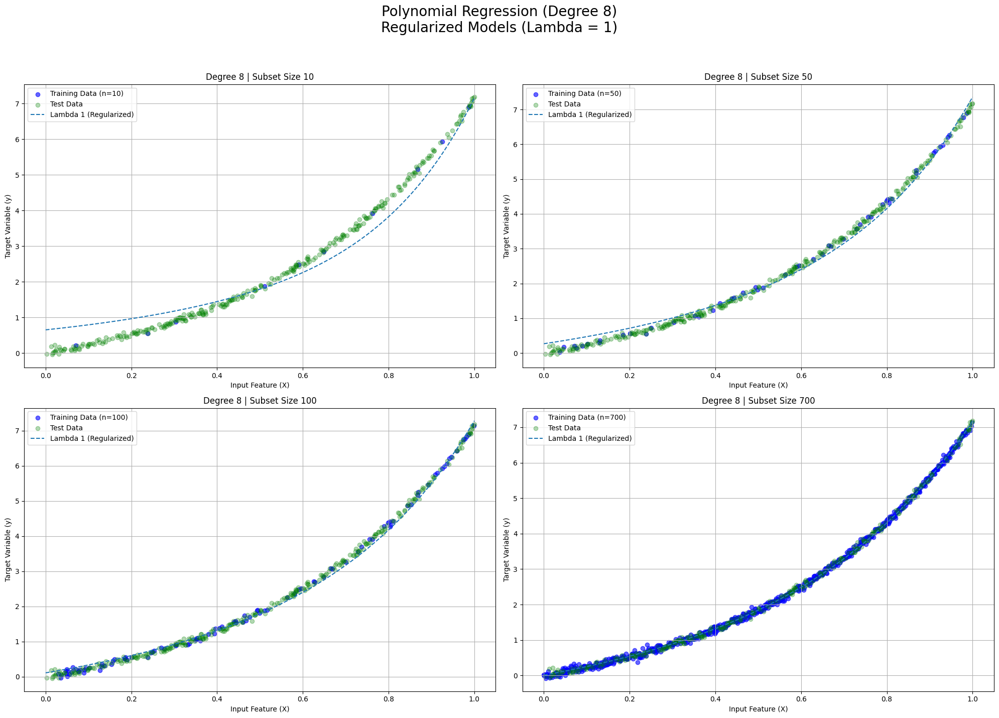

Displayed Regularized plots for Degree 8


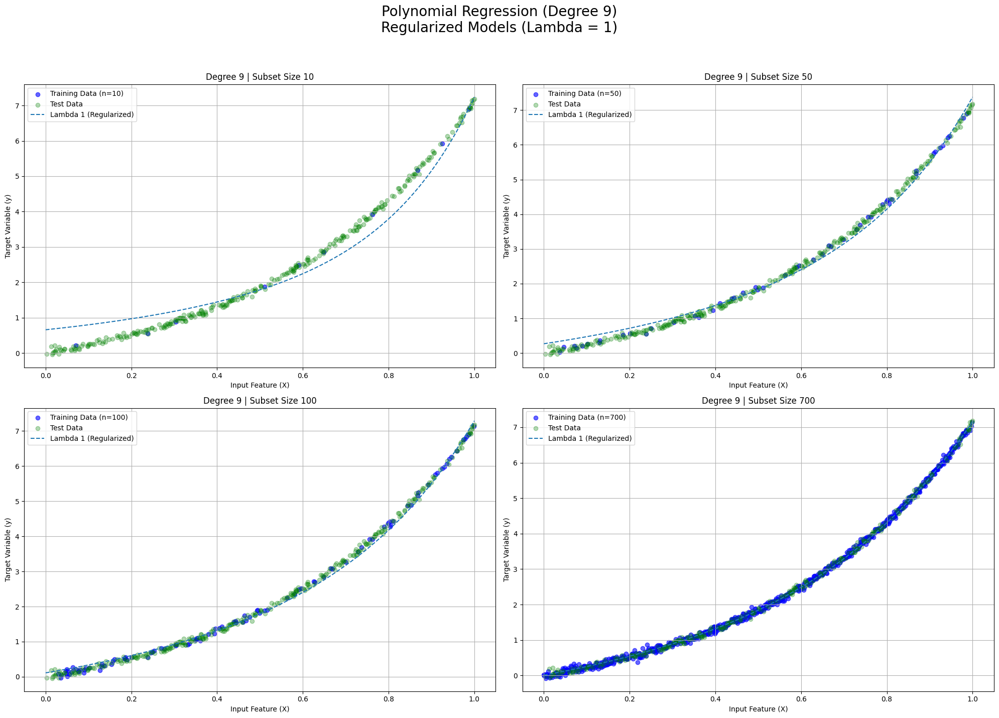

Displayed Regularized plots for Degree 9


In [33]:
lambda_reg1 = 1
# Iterate over each degree
for degree in degrees:
    # Create a figure with multiple subplots for different subset sizes
    fig, axes = plt.subplots(2, 2, figsize=(20, 15))
    fig.suptitle(f'Polynomial Regression (Degree {degree})\nRegularized Models (Lambda = {lambda_reg1})', fontsize=20)
    
    # Flatten the axes array for easy iteration
    axes = axes.flatten()
    
    # Iterate over each subset size and corresponding subplot axis
    for idx, (subset_size, ax) in enumerate(zip(subset_sizes, axes)):
        # Select the first 'subset_size' samples from the training data
        X_train_subset = X_train[:subset_size]
        y_train_subset = y_train[:subset_size]
        
        # Plot the regularized model on the current subplot
        plot_approximated_functions(
            ax=ax,
            X_train_subset=X_train_subset,
            y_train_subset=y_train_subset,
            degree=degree,
            lambda_regs=[lambda_reg1],  # Only regularized
            subset_size=subset_size,
            X_plot=X_plot,
            y_test=y_test,
            color_test='green'
        )
    
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout to accommodate the suptitle
    plt.show()
    print(f"Displayed Regularized plots for Degree {degree}")


In [34]:
import pandas as pd
# Since degrees vary from 2 to 9, the number of weights varies from 3 to 10
# We'll modify the DataFrame to accommodate varying degrees

# Initialize an empty list to store records
weight_records = []

# Iterate over each degree and lambda
for degree in degrees:
    # Expand features for training data
    X_train_poly = polynomial_features(X_train, degree)
    
    for lambda_reg in lambda_regs:
        # Train Ridge Regression model
        weights = ridge_regression(X_train_poly, y_train, lambda_reg)
        
        # Create a dictionary to store degree, lambda, and weights
        weight_record = {
            'Degree': degree,
            'Lambda': lambda_reg
        }
        # Add weights to the record
        for i, w in enumerate(weights):
            weight_record[f'Weight_{i}'] = w
        # Append the record to the list
        weight_records.append(weight_record)

# Convert the list of records to a DataFrame
weights_df = pd.DataFrame(weight_records)

# Display the weights DataFrame
print("\nModel Weights for Each Degree and Lambda Combination:")
print(weights_df)



Model Weights for Each Degree and Lambda Combination:
    Degree  Lambda  Weight_0  Weight_1   Weight_2    Weight_3    Weight_4  \
0        2    0.00  0.201987 -0.114007   6.752086         NaN         NaN   
1        2    0.01  0.199075 -0.096367   6.734441         NaN         NaN   
2        2    0.10  0.174297  0.054290   6.583489         NaN         NaN   
3        2    0.50  0.088738  0.584303   6.047756         NaN         NaN   
4        2    1.00  0.018808  1.036299   5.582058         NaN         NaN   
5        3    0.00 -0.038378  2.804048  -0.562653    4.883142         NaN   
6        3    0.01 -0.023829  2.636798  -0.155290    4.615985         NaN   
7        3    0.10  0.026791  2.049338   1.291708    3.658069         NaN   
8        3    0.50  0.050709  1.743737   2.137338    3.045888         NaN   
9        3    1.00  0.050222  1.726363   2.288845    2.880976         NaN   
10       4    0.00 -0.013838  2.311471   1.670307    1.385045    1.760425   
11       4    0.01 -0